# Tentang DATA

In [ ]:
!pip install mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import mne #library untuk pemrosesan sinyal elektroensefalografi (EEG)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 61.9 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/TA

Mounted at /content/drive
/content/drive/MyDrive/TA


# DATA 1 (chb01_01) tidak epilepsi
Akurasi = 0.961

In [ ]:
file1 = "/content/drive/MyDrive/TA/EDF/chb01_01.edf"
data1 = mne.io.read_raw_edf(file1) # membaca file edf dan menyimpannya di data
data1

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-3-86e1eeffb7f0>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data1 = mne.io.read_raw_edf(file1) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_01.edf, 23 x 921600 (3600.0 s), ~23 KiB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data1.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data1.ch_names  # Mendapatkan nama channel

In [ ]:
data

array([[-1.45934066e-04,  1.95360195e-07,  1.95360195e-07, ...,
        -1.15262515e-05, -2.93040293e-06,  1.93406593e-05],
       [-1.04517705e-04,  1.95360195e-07,  1.95360195e-07, ...,
         2.36385836e-05,  2.75457875e-05,  3.06715507e-05],
       [-4.27838828e-05,  1.95360195e-07,  1.95360195e-07, ...,
         4.86446886e-05,  4.51282051e-05,  3.45787546e-05],
       ...,
       [-2.64713065e-04,  1.95360195e-07,  5.86080586e-07, ...,
         9.76800977e-07, -1.58241758e-05, -2.94993895e-05],
       [ 9.47496947e-05,  1.95360195e-07,  1.95360195e-07, ...,
        -7.22832723e-06, -1.03540904e-05, -1.34798535e-05],
       [ 4.47374847e-05,  1.95360195e-07,  1.95360195e-07, ...,
         1.69963370e-05,  2.24664225e-05,  2.63736264e-05]])

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df1 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df1['Time'] = times  # Menambahkan kolom waktu
df1.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.459341e-04,-1.045177e-04,-4.278388e-05,-3.301587e-05,-1.709402e-04,-1.107692e-04,1.191697e-05,-5.645910e-05,-1.392918e-04,-1.367521e-06,...,4.473748e-05,7.482295e-05,-1.060806e-04,8.459096e-05,4.317460e-05,-5.724054e-05,-2.647131e-04,9.474969e-05,4.473748e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,1.758242e-06,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-2.148962e-06,1.953602e-07,1.953602e-07,0.015625


In [ ]:
channels = data1.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df1.shape) #23 baris dan 921600 kolom

(921600, 24)


In [ ]:
# Menampilkan statistik deskriptif untuk semua kolom (numerik dan non-numerik)
df1.describe(include='all')


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.639330e-07,2.050663e-07,1.659710e-07,1.868416e-07,2.250700e-07,1.820971e-07,1.997359e-07,2.171165e-07,2.339697e-07,2.068995e-07,...,1.466037e-07,1.955874e-07,2.097460e-07,1.878943e-07,2.247494e-07,1.907399e-07,2.514203e-07,2.302562e-07,1.466037e-07,1799.998047
std,7.176667e-05,4.385677e-05,2.699449e-05,1.858883e-05,7.085890e-05,2.660528e-05,1.971165e-05,2.243784e-05,5.902582e-05,2.370618e-05,...,2.767340e-05,2.833496e-05,2.217445e-05,2.089261e-05,2.699449e-05,3.126672e-05,5.455252e-05,3.000683e-05,2.767340e-05,1039.231048
min,-8.070330e-04,-7.265446e-04,-5.444689e-04,-4.495238e-04,-8.824420e-04,-4.319414e-04,-4.170940e-04,-2.010256e-04,-5.636142e-04,-2.627595e-04,...,-6.269109e-04,-4.749206e-04,-1.994628e-04,-1.951648e-04,-5.882295e-04,-5.483761e-04,-6.065934e-04,-4.456166e-04,-6.269109e-04,0.000000
25%,-2.402930e-05,-1.699634e-05,-1.347985e-05,-1.074481e-05,-2.637363e-05,-1.465201e-05,-1.035409e-05,-1.347985e-05,-2.402930e-05,-1.347985e-05,...,-1.387057e-05,-1.465201e-05,-1.308913e-05,-1.269841e-05,-1.387057e-05,-1.347985e-05,-2.051282e-05,-1.269841e-05,-1.387057e-05,899.999023
50%,-1.367521e-06,1.953602e-07,1.953602e-07,5.860806e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,...,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,-1.953602e-07,-1.953602e-07,5.860806e-07,1799.998047
75%,1.973138e-05,1.699634e-05,1.426129e-05,1.152625e-05,2.285714e-05,1.504274e-05,1.074481e-05,1.426129e-05,2.051282e-05,1.347985e-05,...,1.504274e-05,1.582418e-05,1.308913e-05,1.308913e-05,1.387057e-05,1.426129e-05,2.168498e-05,1.269841e-05,1.504274e-05,2699.997070
max,1.037949e-03,5.495482e-04,5.886203e-04,2.061050e-04,7.921856e-04,4.022466e-04,5.366545e-04,2.299389e-04,7.007570e-04,2.354090e-04,...,3.647375e-04,6.206593e-04,1.498413e-04,2.486935e-04,5.448596e-04,7.640537e-04,6.300366e-04,4.706227e-04,3.647375e-04,3599.996094


In [ ]:
df1.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.639330e-07,2.050663e-07,1.659710e-07,1.868416e-07,2.250700e-07,1.820971e-07,1.997359e-07,2.171165e-07,2.339697e-07,2.068995e-07,...,1.466037e-07,1.955874e-07,2.097460e-07,1.878943e-07,2.247494e-07,1.907399e-07,2.514203e-07,2.302562e-07,1.466037e-07,1799.998047
std,7.176667e-05,4.385677e-05,2.699449e-05,1.858883e-05,7.085890e-05,2.660528e-05,1.971165e-05,2.243784e-05,5.902582e-05,2.370618e-05,...,2.767340e-05,2.833496e-05,2.217445e-05,2.089261e-05,2.699449e-05,3.126672e-05,5.455252e-05,3.000683e-05,2.767340e-05,1039.231048
min,-8.070330e-04,-7.265446e-04,-5.444689e-04,-4.495238e-04,-8.824420e-04,-4.319414e-04,-4.170940e-04,-2.010256e-04,-5.636142e-04,-2.627595e-04,...,-6.269109e-04,-4.749206e-04,-1.994628e-04,-1.951648e-04,-5.882295e-04,-5.483761e-04,-6.065934e-04,-4.456166e-04,-6.269109e-04,0.000000
25%,-2.402930e-05,-1.699634e-05,-1.347985e-05,-1.074481e-05,-2.637363e-05,-1.465201e-05,-1.035409e-05,-1.347985e-05,-2.402930e-05,-1.347985e-05,...,-1.387057e-05,-1.465201e-05,-1.308913e-05,-1.269841e-05,-1.387057e-05,-1.347985e-05,-2.051282e-05,-1.269841e-05,-1.387057e-05,899.999023
50%,-1.367521e-06,1.953602e-07,1.953602e-07,5.860806e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,...,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,-1.953602e-07,-1.953602e-07,5.860806e-07,1799.998047
75%,1.973138e-05,1.699634e-05,1.426129e-05,1.152625e-05,2.285714e-05,1.504274e-05,1.074481e-05,1.426129e-05,2.051282e-05,1.347985e-05,...,1.504274e-05,1.582418e-05,1.308913e-05,1.308913e-05,1.387057e-05,1.426129e-05,2.168498e-05,1.269841e-05,1.504274e-05,2699.997070
max,1.037949e-03,5.495482e-04,5.886203e-04,2.061050e-04,7.921856e-04,4.022466e-04,5.366545e-04,2.299389e-04,7.007570e-04,2.354090e-04,...,3.647375e-04,6.206593e-04,1.498413e-04,2.486935e-04,5.448596e-04,7.640537e-04,6.300366e-04,4.706227e-04,3.647375e-04,3599.996094


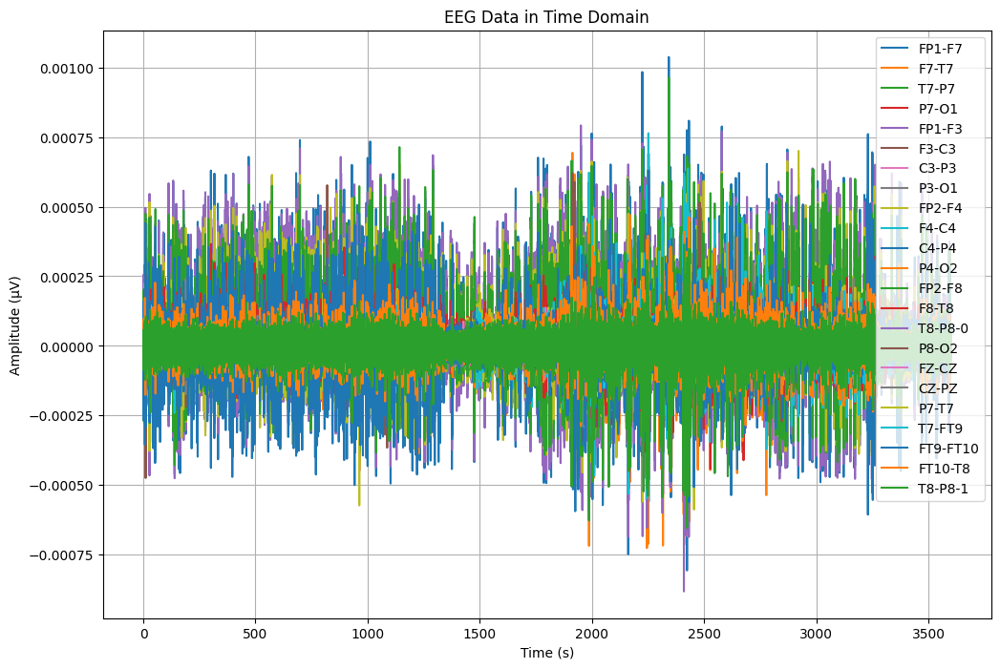

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df1['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df1[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

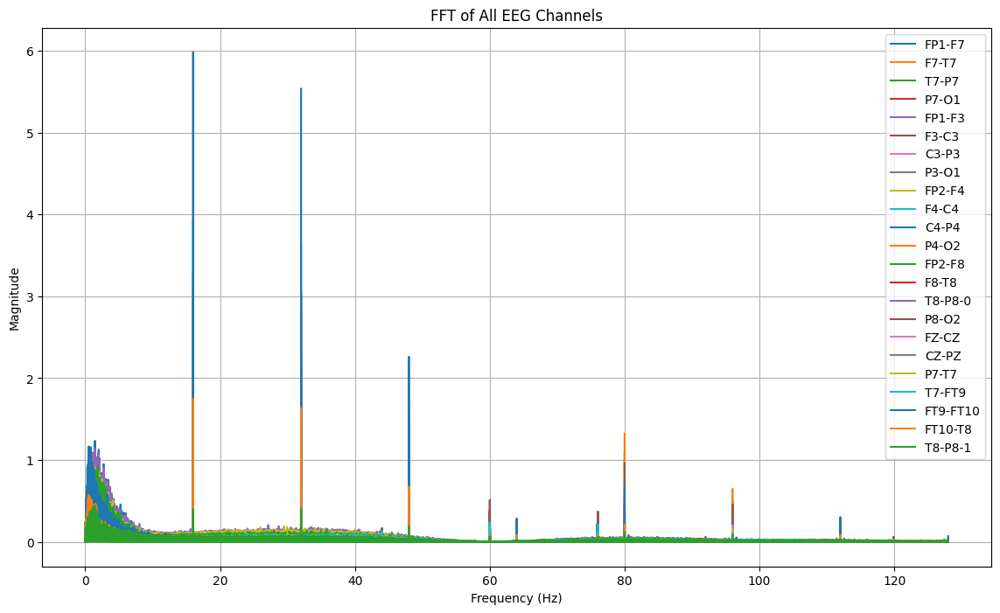

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df1[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/bukan epilepsi.csv"
df1.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_13.csv


In [ ]:
dataTA1 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_13.csv")
dataTA1

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,-3.965812e-05,-5.333333e-05,-4.942613e-05,1.013919e-04,-1.631258e-04,-7.833944e-05,-9.572650e-06,6.505495e-05,-4.395604e-05,...,-5.294261e-05,2.910867e-05,-1.334310e-04,-6.700855e-05,5.372405e-05,-5.958486e-05,-8.849817e-05,3.614164e-05,-5.294261e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.758242e-06,-9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-6.661783e-05,6.192918e-05,-7.599512e-05,5.294261e-05,-4.395604e-05,9.572650e-06,3.321123e-06,3.711844e-06,-7.794872e-05,1.758242e-06,...,4.708181e-05,3.145299e-05,6.349206e-05,-4.043956e-05,7.638584e-05,-3.965812e-05,9.768010e-07,-3.536020e-05,4.708181e-05,3599.980469
921596,-6.935287e-05,7.638584e-05,-1.314774e-04,9.162393e-05,-5.020757e-05,4.493284e-06,7.619048e-06,5.665446e-06,-7.794872e-05,-2.539683e-06,...,1.973138e-05,3.028083e-05,6.349206e-05,-3.965812e-05,1.318681e-04,-4.200244e-05,2.148962e-06,-2.246642e-05,1.973138e-05,3599.984375
921597,-7.443223e-05,-4.884005e-06,-8.771673e-05,1.349939e-04,-5.606838e-05,1.953602e-07,9.181929e-06,1.387057e-05,-7.404151e-05,-5.665446e-06,...,5.333333e-05,3.809524e-05,6.153846e-05,-3.496947e-05,8.810745e-05,2.910867e-05,5.274725e-06,-5.411477e-05,5.333333e-05,3599.988281
921598,-7.169719e-05,-2.090354e-05,-7.619048e-06,6.818071e-05,-5.411477e-05,1.367521e-06,1.308913e-05,6.056166e-06,-6.935287e-05,-2.539683e-06,...,5.255189e-05,5.333333e-05,5.919414e-05,-3.848596e-05,8.009768e-06,3.575092e-05,-1.953602e-07,-5.411477e-05,5.255189e-05,3599.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA1[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA1[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA1[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data1, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: F3-C3, Max Frequency: 1.19 Hz, Magnitude: 1.761195, Time: 1148.261719 s
Channel: F7-T7, Max Frequency: 0.90 Hz, Magnitude: 1.569781, Time: 1193.691406 s
Channel: FP1-F3, Max Frequency: 1.78 Hz, Magnitude: 1.488424, Time: 1165.964844 s
Channel: F4-C4, Max Frequency: 1.94 Hz, Magnitude: 1.361550, Time: 1122.894531 s
Channel: FT9-FT10, Max Frequency: 1.47 Hz, Magnitude: 1.361519, Time: 1156.460938 s
Channel: P7-O1, Max Frequency: 1.93 Hz, Magnitude: 1.329667, Time: 1139.246094 s
Channel: FZ-CZ, Max Frequency: 1.25 Hz, Magnitude: 1.316148, Time: 1122.058594 s
Channel: P3-O1, Max Frequency: 0.97 Hz, Magnitude: 1.297437, Time: 1088.500000 s
Channel: FP2-F4, Max Frequency: 1.67 Hz, Magnitude: 1.208834, Time: 1095.398438 s
Channel: T7-P7, Max Frequency: 1.25 Hz, Magnitude: 1.205981, Time: 1239.550781 s
Channel: P7-T7, Max Frequency: 1.25 Hz, Magnitude: 1.205981, Time: 1239.550781 s
Channel: T7-FT9, Max Freq

In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA1[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA1[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz


# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA1[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data1, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 1.42 Hz, Magnitude: 1.003392, Time: 1088.500000 s
Channel: P3-O1, Max Frequency: 0.97 Hz, Magnitude: 1.297437, Time: 1088.500000 s
Channel: FP2-F4, Max Frequency: 1.67 Hz, Magnitude: 1.208834, Time: 1095.398438 s
Channel: P4-O2, Max Frequency: 1.42 Hz, Magnitude: 1.119024, Time: 1115.199219 s
Channel: T8-P8-0, Max Frequency: 0.98 Hz, Magnitude: 0.975898, Time: 1119.421875 s
Channel: T8-P8-1, Max Frequency: 0.98 Hz, Magnitude: 0.975898, Time: 1119.421875 s
Channel: FZ-CZ, Max Frequency: 1.25 Hz, Magnitude: 1.316148, Time: 1122.058594 s
Channel: F4-C4, Max Frequency: 1.94 Hz, Magnitude: 1.361550, Time: 1122.894531 s
Channel: F8-T8, Max Frequency: 1.38 Hz, Magnitude: 1.084825, Time: 1123.195312 s
Channel: FT10-T8, Max Frequency: 1.15 Hz, Magnitude: 0.770020, Time: 1123.199219 s
Channel: P7-O1, Max Frequency: 1.93 Hz, Magnitude: 1.329667, Time: 1139.24

In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 968   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1359    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut = dataTA1.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_13.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA1 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_13.csv")
TA1.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000046,0.000129,0.000028,-0.000206,-1.953602e-07,0.000023,0.000048,-0.000072,-0.000069,-0.000024,...,-0.000002,-0.000050,-0.000108,-0.000007,-0.000028,-0.000062,-0.000119,-1.738706e-05,-0.000002,968.000000
1,0.000047,0.000129,0.000034,-0.000209,9.768010e-07,0.000028,0.000042,-0.000069,-0.000066,-0.000028,...,-0.000008,-0.000045,-0.000103,-0.000012,-0.000033,-0.000063,-0.000118,-1.582418e-05,-0.000008,968.003906
2,0.000044,0.000129,0.000038,-0.000209,1.367521e-06,0.000033,0.000035,-0.000066,-0.000065,-0.000030,...,-0.000012,-0.000042,-0.000104,-0.000015,-0.000038,-0.000079,-0.000115,-1.953602e-07,-0.000012,968.007812
3,0.000044,0.000129,0.000044,-0.000212,9.768010e-07,0.000038,0.000029,-0.000063,-0.000057,-0.000032,...,-0.000011,-0.000041,-0.000102,-0.000020,-0.000043,-0.000071,-0.000119,-4.493284e-06,-0.000011,968.011719
4,0.000044,0.000125,0.000046,-0.000210,1.953602e-07,0.000040,0.000023,-0.000058,-0.000052,-0.000033,...,-0.000010,-0.000038,-0.000097,-0.000020,-0.000046,-0.000055,-0.000122,-1.934066e-05,-0.000010,968.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA1.shape

(100096, 24)

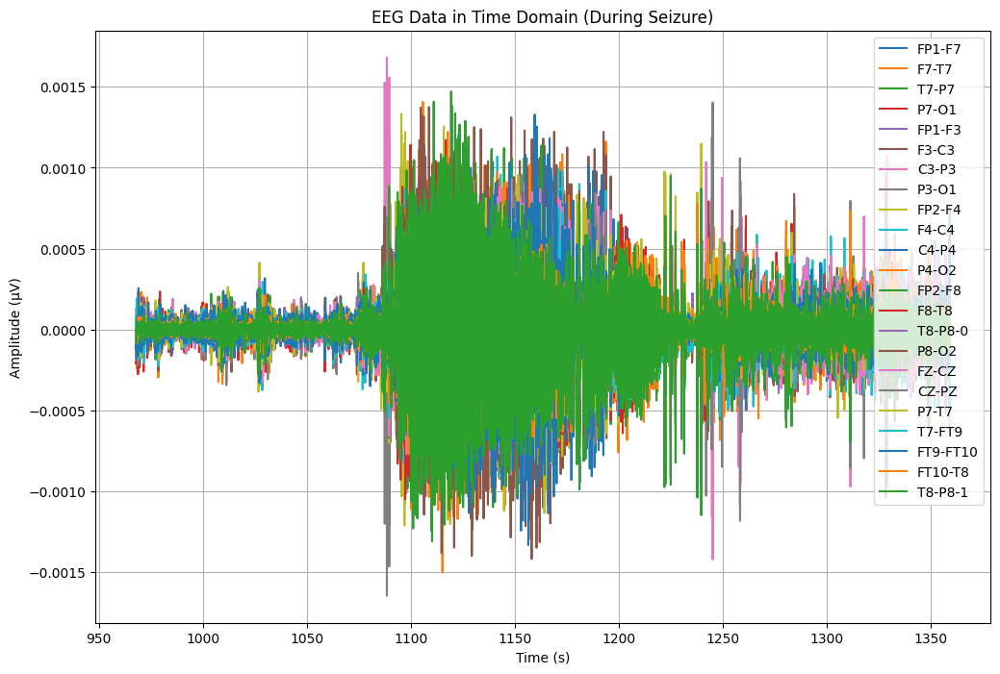

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA1['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA1.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA1[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


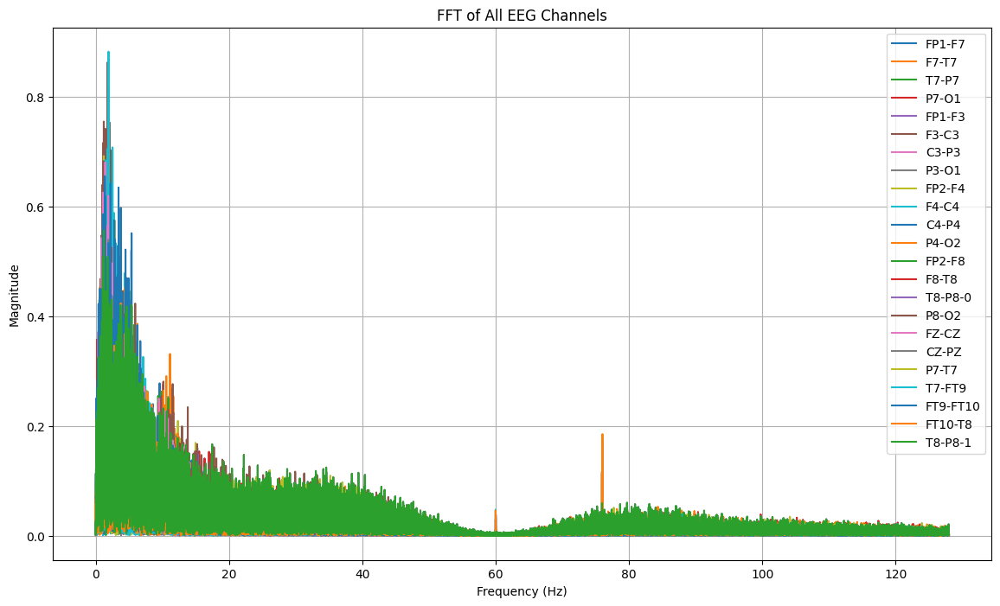

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA1[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1088:
        return "tidak kejang"
    elif 1088 <= row['Time'] < 1239:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_1 = TA1.copy()
TA_1['seizure'] = TA_1.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_1[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  968.000000  tidak kejang  0.000046  0.000129  0.000028 -0.000206   
1  968.003906  tidak kejang  0.000047  0.000129  0.000034 -0.000209   
2  968.007812  tidak kejang  0.000044  0.000129  0.000038 -0.000209   
3  968.011719  tidak kejang  0.000044  0.000129  0.000044 -0.000212   
4  968.015625  tidak kejang  0.000044  0.000125  0.000046 -0.000210   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -1.953602e-07  0.000023  0.000048 -0.000072  ... -0.000018 -0.000002   
1  9.768010e-07  0.000028  0.000042 -0.000069  ... -0.000018 -0.000008   
2  1.367521e-06  0.000033  0.000035 -0.000066  ... -0.000018 -0.000012   
3  9.768010e-07  0.000038  0.000029 -0.000063  ... -0.000015 -0.000011   
4  1.953602e-07  0.000040  0.000023 -0.000058  ... -0.000016 -0.000010   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10       FT10-T8  \
0 -0.000050 -0.000108 -0.000007 -0.000028 -0.0000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_1['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,38656


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_1)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 391.0 detik


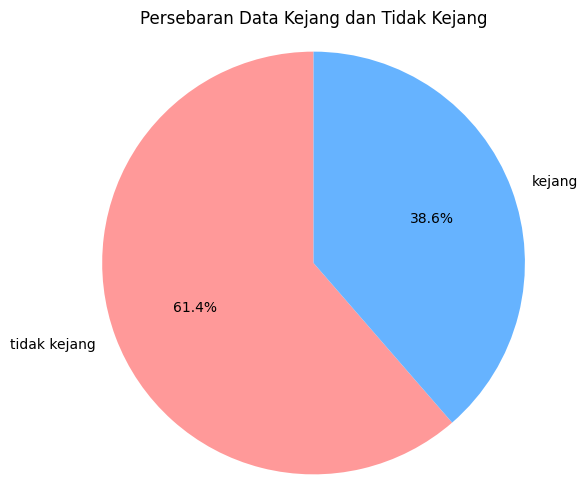

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_1['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_1.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb05_13.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_1.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_1['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.97      0.93      0.95      7779
tidak kejang       0.95      0.98      0.97     12241

    accuracy                           0.96     20020
   macro avg       0.96      0.96      0.96     20020
weighted avg       0.96      0.96      0.96     20020

Akurasi: 0.9612887112887113
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.93      0.95      7779
tidak kejang       0.95      0.98      0.97     12241

    accuracy                           0.96     20020
   macro avg       0.96      0.96      0.96     20020
weighted avg       0.96      0.96      0.96     20020



In [ ]:
# Menentukan fitur (X) dan label (y)
X = TA_1.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_1['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.97      0.92      0.95     11657
tidak kejang       0.95      0.98      0.97     18372

    accuracy                           0.96     30029
   macro avg       0.96      0.95      0.96     30029
weighted avg       0.96      0.96      0.96     30029

Akurasi: 0.9601385327516734
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.92      0.95     11657
tidak kejang       0.95      0.98      0.97     18372

    accuracy                           0.96     30029
   macro avg       0.96      0.95      0.96     30029
weighted avg       0.96      0.96      0.96     30029



# DATA 1 (chb05_13)
Akurasi = 0.961

In [ ]:
file1 = "/content/drive/MyDrive/TA/EDF/chb05_13.edf"
data1 = mne.io.read_raw_edf(file1) # membaca file edf dan menyimpannya di data
data1

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_13.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-6-eba94003e4ce>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data1 = mne.io.read_raw_edf(file1) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_13.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data1.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data1.ch_names  # Mendapatkan nama channel

In [ ]:
data

array([[-7.22832723e-06,  1.95360195e-07,  1.95360195e-07, ...,
        -7.44322344e-05, -7.16971917e-05, -7.09157509e-05],
       [-3.96581197e-05,  1.95360195e-07,  1.95360195e-07, ...,
        -4.88400488e-06, -2.09035409e-05, -4.12210012e-05],
       [-5.33333333e-05,  1.95360195e-07,  1.95360195e-07, ...,
        -8.77167277e-05, -7.61904762e-06,  7.13064713e-05],
       ...,
       [-8.84981685e-05,  1.95360195e-07,  1.95360195e-07, ...,
         5.27472527e-06, -1.95360195e-07, -1.75824176e-06],
       [ 3.61416361e-05,  1.95360195e-07,  1.95360195e-07, ...,
        -5.41147741e-05, -5.41147741e-05, -7.24786325e-05],
       [-5.29426129e-05,  1.95360195e-07,  1.95360195e-07, ...,
         5.33333333e-05,  5.25518926e-05,  4.12210012e-05]])

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df1 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df1['Time'] = times  # Menambahkan kolom waktu
df1.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,-3.965812e-05,-5.333333e-05,-4.942613e-05,1.013919e-04,-1.631258e-04,-7.833944e-05,-9.572650e-06,6.505495e-05,-4.395604e-05,...,-5.294261e-05,2.910867e-05,-1.334310e-04,-6.700855e-05,5.372405e-05,-5.958486e-05,-8.849817e-05,3.614164e-05,-5.294261e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.758242e-06,-9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,5.860806e-07,0.015625


In [ ]:
channels = data1.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df1.shape) #23 baris dan 921600 kolom

(921600, 24)


In [ ]:
# Menampilkan statistik deskriptif untuk semua kolom (numerik dan non-numerik)
df1.describe(include='all')


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.044600e-07,1.803487e-07,2.022360e-07,1.632228e-07,2.267632e-07,1.934452e-07,1.775438e-07,1.523916e-07,2.114876e-07,1.937458e-07,...,1.865940e-07,1.822425e-07,2.034726e-07,1.977662e-07,1.884844e-07,1.803822e-07,1.860267e-07,2.018972e-07,1.865940e-07,1799.998047
std,6.868818e-05,9.157041e-05,6.960559e-05,7.611238e-05,7.891207e-05,9.157680e-05,6.233631e-05,7.236429e-05,7.617723e-05,7.449498e-05,...,7.343264e-05,6.901959e-05,7.562751e-05,5.978743e-05,6.960559e-05,6.419684e-05,8.457167e-05,5.332798e-05,7.343264e-05,1039.231048
min,-1.046545e-03,-9.441758e-04,-1.148132e-03,-1.011380e-03,-1.082882e-03,-1.286838e-03,-1.422027e-03,-1.647082e-03,-1.212210e-03,-1.055922e-03,...,-1.309109e-03,-1.418901e-03,-9.047131e-04,-9.027595e-04,-1.135238e-03,-7.519414e-04,-1.333724e-03,-8.984615e-04,-1.309109e-03,0.000000
25%,-3.340659e-05,-4.864469e-05,-3.457875e-05,-4.004884e-05,-4.161172e-05,-4.434676e-05,-2.832723e-05,-3.496947e-05,-3.028083e-05,-2.754579e-05,...,-2.637363e-05,-2.598291e-05,-3.418803e-05,-2.871795e-05,-3.418803e-05,-3.301587e-05,-3.965812e-05,-1.973138e-05,-2.637363e-05,899.999023
50%,1.953602e-07,9.768010e-07,1.953602e-07,1.367521e-06,-9.768010e-07,5.860806e-07,5.860806e-07,2.148962e-06,-1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1799.998047
75%,3.262515e-05,4.903541e-05,3.457875e-05,4.278388e-05,4.004884e-05,4.630037e-05,2.949939e-05,3.731380e-05,3.028083e-05,2.832723e-05,...,2.754579e-05,2.715507e-05,3.496947e-05,2.949939e-05,3.496947e-05,3.418803e-05,4.122100e-05,2.012210e-05,2.754579e-05,2699.997070
max,1.035604e-03,1.161807e-03,1.135629e-03,9.613675e-04,8.414164e-04,1.312234e-03,1.682247e-03,1.403272e-03,1.333333e-03,1.204396e-03,...,1.471258e-03,1.375140e-03,1.048889e-03,8.429792e-04,1.148523e-03,7.519414e-04,1.328254e-03,9.773871e-04,1.471258e-03,3599.996094


In [ ]:
df1.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.044600e-07,1.803487e-07,2.022360e-07,1.632228e-07,2.267632e-07,1.934452e-07,1.775438e-07,1.523916e-07,2.114876e-07,1.937458e-07,...,1.865940e-07,1.822425e-07,2.034726e-07,1.977662e-07,1.884844e-07,1.803822e-07,1.860267e-07,2.018972e-07,1.865940e-07,1799.998047
std,6.868818e-05,9.157041e-05,6.960559e-05,7.611238e-05,7.891207e-05,9.157680e-05,6.233631e-05,7.236429e-05,7.617723e-05,7.449498e-05,...,7.343264e-05,6.901959e-05,7.562751e-05,5.978743e-05,6.960559e-05,6.419684e-05,8.457167e-05,5.332798e-05,7.343264e-05,1039.231048
min,-1.046545e-03,-9.441758e-04,-1.148132e-03,-1.011380e-03,-1.082882e-03,-1.286838e-03,-1.422027e-03,-1.647082e-03,-1.212210e-03,-1.055922e-03,...,-1.309109e-03,-1.418901e-03,-9.047131e-04,-9.027595e-04,-1.135238e-03,-7.519414e-04,-1.333724e-03,-8.984615e-04,-1.309109e-03,0.000000
25%,-3.340659e-05,-4.864469e-05,-3.457875e-05,-4.004884e-05,-4.161172e-05,-4.434676e-05,-2.832723e-05,-3.496947e-05,-3.028083e-05,-2.754579e-05,...,-2.637363e-05,-2.598291e-05,-3.418803e-05,-2.871795e-05,-3.418803e-05,-3.301587e-05,-3.965812e-05,-1.973138e-05,-2.637363e-05,899.999023
50%,1.953602e-07,9.768010e-07,1.953602e-07,1.367521e-06,-9.768010e-07,5.860806e-07,5.860806e-07,2.148962e-06,-1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1799.998047
75%,3.262515e-05,4.903541e-05,3.457875e-05,4.278388e-05,4.004884e-05,4.630037e-05,2.949939e-05,3.731380e-05,3.028083e-05,2.832723e-05,...,2.754579e-05,2.715507e-05,3.496947e-05,2.949939e-05,3.496947e-05,3.418803e-05,4.122100e-05,2.012210e-05,2.754579e-05,2699.997070
max,1.035604e-03,1.161807e-03,1.135629e-03,9.613675e-04,8.414164e-04,1.312234e-03,1.682247e-03,1.403272e-03,1.333333e-03,1.204396e-03,...,1.471258e-03,1.375140e-03,1.048889e-03,8.429792e-04,1.148523e-03,7.519414e-04,1.328254e-03,9.773871e-04,1.471258e-03,3599.996094


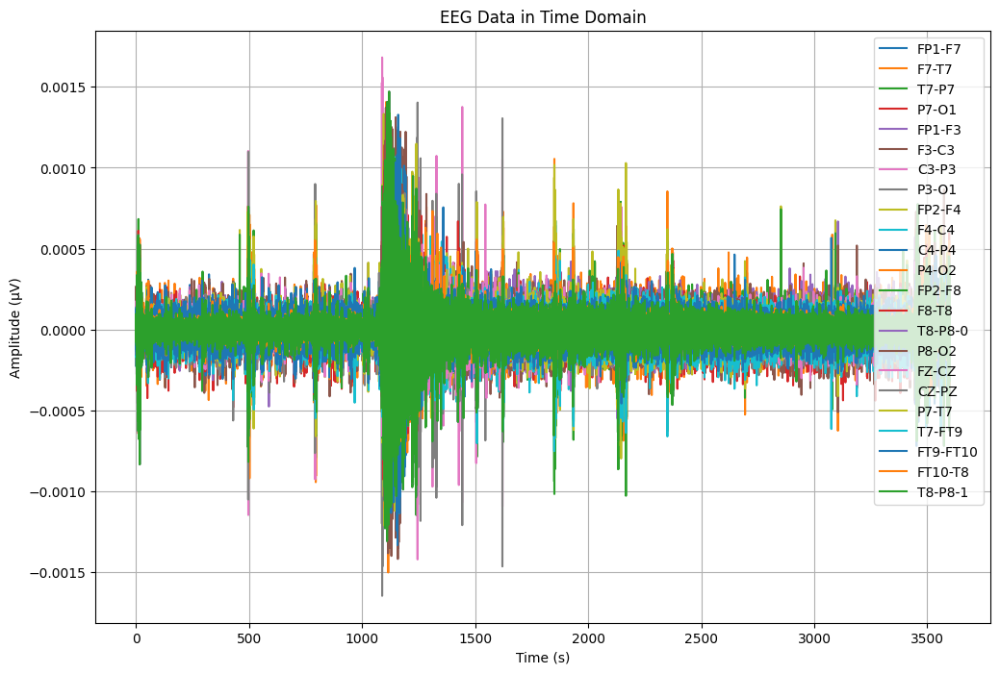

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df1['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df1[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

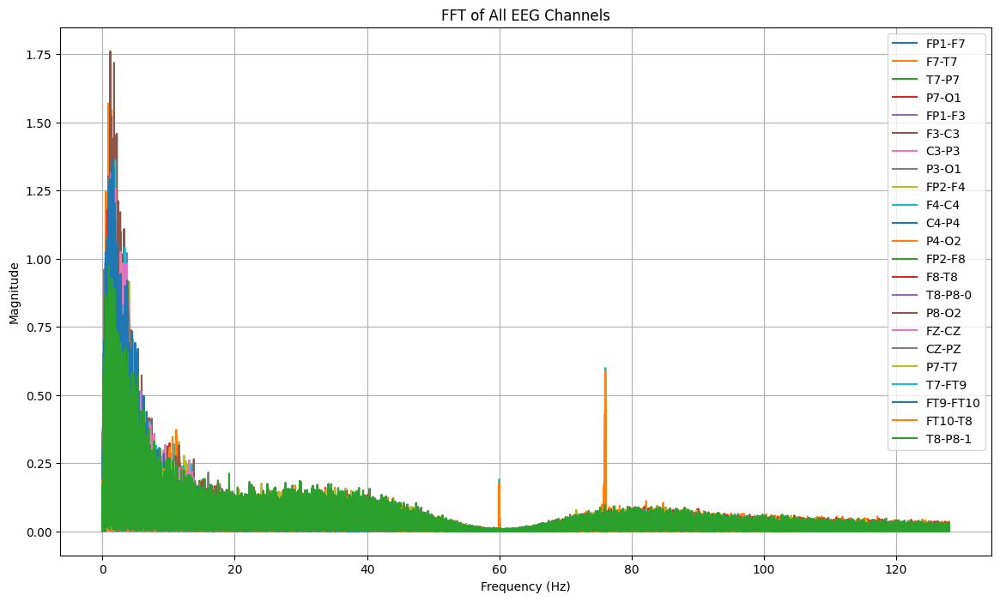

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df1[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_13.csv"
df1.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_13.csv


In [ ]:
dataTA1 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_13.csv")
dataTA1

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,-3.965812e-05,-5.333333e-05,-4.942613e-05,1.013919e-04,-1.631258e-04,-7.833944e-05,-9.572650e-06,6.505495e-05,-4.395604e-05,...,-5.294261e-05,2.910867e-05,-1.334310e-04,-6.700855e-05,5.372405e-05,-5.958486e-05,-8.849817e-05,3.614164e-05,-5.294261e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.758242e-06,-9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-6.661783e-05,6.192918e-05,-7.599512e-05,5.294261e-05,-4.395604e-05,9.572650e-06,3.321123e-06,3.711844e-06,-7.794872e-05,1.758242e-06,...,4.708181e-05,3.145299e-05,6.349206e-05,-4.043956e-05,7.638584e-05,-3.965812e-05,9.768010e-07,-3.536020e-05,4.708181e-05,3599.980469
921596,-6.935287e-05,7.638584e-05,-1.314774e-04,9.162393e-05,-5.020757e-05,4.493284e-06,7.619048e-06,5.665446e-06,-7.794872e-05,-2.539683e-06,...,1.973138e-05,3.028083e-05,6.349206e-05,-3.965812e-05,1.318681e-04,-4.200244e-05,2.148962e-06,-2.246642e-05,1.973138e-05,3599.984375
921597,-7.443223e-05,-4.884005e-06,-8.771673e-05,1.349939e-04,-5.606838e-05,1.953602e-07,9.181929e-06,1.387057e-05,-7.404151e-05,-5.665446e-06,...,5.333333e-05,3.809524e-05,6.153846e-05,-3.496947e-05,8.810745e-05,2.910867e-05,5.274725e-06,-5.411477e-05,5.333333e-05,3599.988281
921598,-7.169719e-05,-2.090354e-05,-7.619048e-06,6.818071e-05,-5.411477e-05,1.367521e-06,1.308913e-05,6.056166e-06,-6.935287e-05,-2.539683e-06,...,5.255189e-05,5.333333e-05,5.919414e-05,-3.848596e-05,8.009768e-06,3.575092e-05,-1.953602e-07,-5.411477e-05,5.255189e-05,3599.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA1[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA1[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA1[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data1, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: F3-C3, Max Frequency: 1.19 Hz, Magnitude: 1.761195, Time: 1148.261719 s
Channel: F7-T7, Max Frequency: 0.90 Hz, Magnitude: 1.569781, Time: 1193.691406 s
Channel: FP1-F3, Max Frequency: 1.78 Hz, Magnitude: 1.488424, Time: 1165.964844 s
Channel: F4-C4, Max Frequency: 1.94 Hz, Magnitude: 1.361550, Time: 1122.894531 s
Channel: FT9-FT10, Max Frequency: 1.47 Hz, Magnitude: 1.361519, Time: 1156.460938 s
Channel: P7-O1, Max Frequency: 1.93 Hz, Magnitude: 1.329667, Time: 1139.246094 s
Channel: FZ-CZ, Max Frequency: 1.25 Hz, Magnitude: 1.316148, Time: 1122.058594 s
Channel: P3-O1, Max Frequency: 0.97 Hz, Magnitude: 1.297437, Time: 1088.500000 s
Channel: FP2-F4, Max Frequency: 1.67 Hz, Magnitude: 1.208834, Time: 1095.398438 s
Channel: T7-P7, Max Frequency: 1.25 Hz, Magnitude: 1.205981, Time: 1239.550781 s
Channel: P7-T7, Max Frequency: 1.25 Hz, Magnitude: 1.205981, Time: 1239.550781 s
Channel: T7-FT9, Max Freq

In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA1[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA1[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz


# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA1[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data1, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 1.42 Hz, Magnitude: 1.003392, Time: 1088.500000 s
Channel: P3-O1, Max Frequency: 0.97 Hz, Magnitude: 1.297437, Time: 1088.500000 s
Channel: FP2-F4, Max Frequency: 1.67 Hz, Magnitude: 1.208834, Time: 1095.398438 s
Channel: P4-O2, Max Frequency: 1.42 Hz, Magnitude: 1.119024, Time: 1115.199219 s
Channel: T8-P8-0, Max Frequency: 0.98 Hz, Magnitude: 0.975898, Time: 1119.421875 s
Channel: T8-P8-1, Max Frequency: 0.98 Hz, Magnitude: 0.975898, Time: 1119.421875 s
Channel: FZ-CZ, Max Frequency: 1.25 Hz, Magnitude: 1.316148, Time: 1122.058594 s
Channel: F4-C4, Max Frequency: 1.94 Hz, Magnitude: 1.361550, Time: 1122.894531 s
Channel: F8-T8, Max Frequency: 1.38 Hz, Magnitude: 1.084825, Time: 1123.195312 s
Channel: FT10-T8, Max Frequency: 1.15 Hz, Magnitude: 0.770020, Time: 1123.199219 s
Channel: P7-O1, Max Frequency: 1.93 Hz, Magnitude: 1.329667, Time: 1139.24

In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 968   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1359    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut = dataTA1.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_13.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA1 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_13.csv")
TA1.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000046,0.000129,0.000028,-0.000206,-1.953602e-07,0.000023,0.000048,-0.000072,-0.000069,-0.000024,...,-0.000002,-0.000050,-0.000108,-0.000007,-0.000028,-0.000062,-0.000119,-1.738706e-05,-0.000002,968.000000
1,0.000047,0.000129,0.000034,-0.000209,9.768010e-07,0.000028,0.000042,-0.000069,-0.000066,-0.000028,...,-0.000008,-0.000045,-0.000103,-0.000012,-0.000033,-0.000063,-0.000118,-1.582418e-05,-0.000008,968.003906
2,0.000044,0.000129,0.000038,-0.000209,1.367521e-06,0.000033,0.000035,-0.000066,-0.000065,-0.000030,...,-0.000012,-0.000042,-0.000104,-0.000015,-0.000038,-0.000079,-0.000115,-1.953602e-07,-0.000012,968.007812
3,0.000044,0.000129,0.000044,-0.000212,9.768010e-07,0.000038,0.000029,-0.000063,-0.000057,-0.000032,...,-0.000011,-0.000041,-0.000102,-0.000020,-0.000043,-0.000071,-0.000119,-4.493284e-06,-0.000011,968.011719
4,0.000044,0.000125,0.000046,-0.000210,1.953602e-07,0.000040,0.000023,-0.000058,-0.000052,-0.000033,...,-0.000010,-0.000038,-0.000097,-0.000020,-0.000046,-0.000055,-0.000122,-1.934066e-05,-0.000010,968.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA1.shape

(100096, 24)

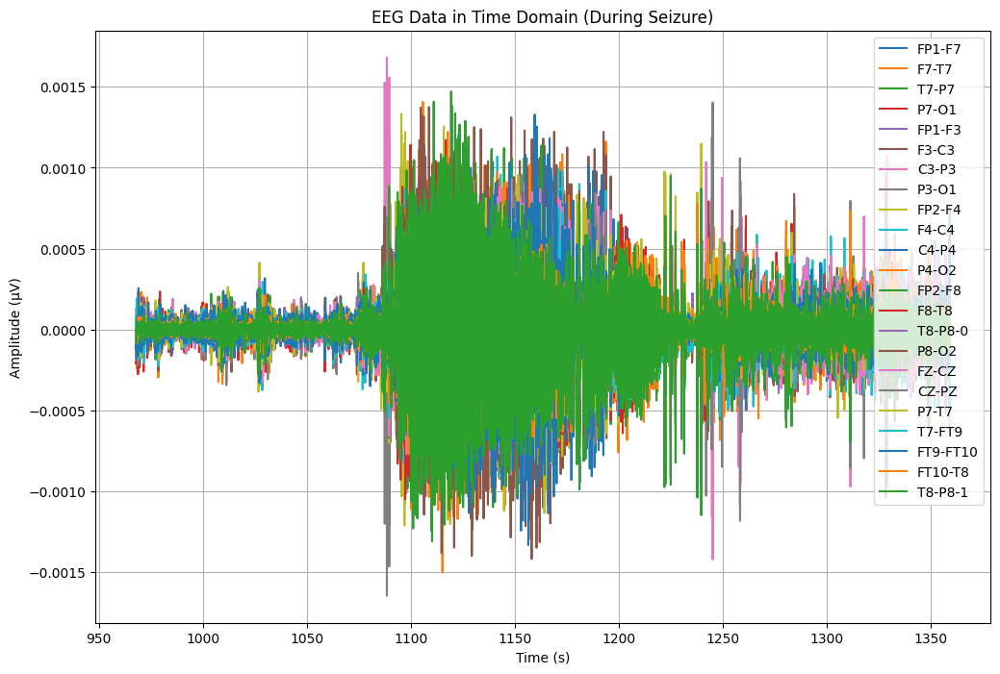

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA1['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA1.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA1[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


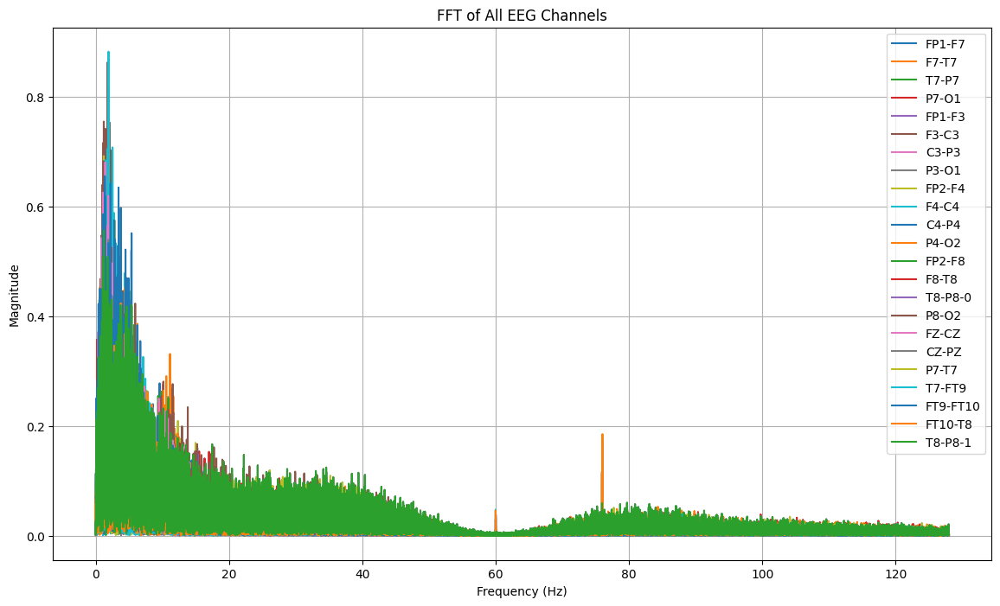

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA1[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1088:
        return "tidak kejang"
    elif 1088 <= row['Time'] < 1239:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_1 = TA1.copy()
TA_1['seizure'] = TA_1.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_1[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  968.000000  tidak kejang  0.000046  0.000129  0.000028 -0.000206   
1  968.003906  tidak kejang  0.000047  0.000129  0.000034 -0.000209   
2  968.007812  tidak kejang  0.000044  0.000129  0.000038 -0.000209   
3  968.011719  tidak kejang  0.000044  0.000129  0.000044 -0.000212   
4  968.015625  tidak kejang  0.000044  0.000125  0.000046 -0.000210   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -1.953602e-07  0.000023  0.000048 -0.000072  ... -0.000018 -0.000002   
1  9.768010e-07  0.000028  0.000042 -0.000069  ... -0.000018 -0.000008   
2  1.367521e-06  0.000033  0.000035 -0.000066  ... -0.000018 -0.000012   
3  9.768010e-07  0.000038  0.000029 -0.000063  ... -0.000015 -0.000011   
4  1.953602e-07  0.000040  0.000023 -0.000058  ... -0.000016 -0.000010   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10       FT10-T8  \
0 -0.000050 -0.000108 -0.000007 -0.000028 -0.0000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_1['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,38656


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_1)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 391.0 detik


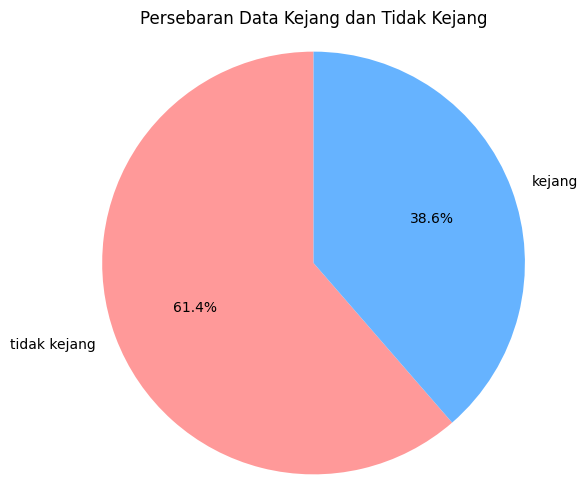

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_1['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_1.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb05_13.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_1.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_1['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.97      0.93      0.95      7779
tidak kejang       0.95      0.98      0.97     12241

    accuracy                           0.96     20020
   macro avg       0.96      0.96      0.96     20020
weighted avg       0.96      0.96      0.96     20020

Akurasi: 0.9612887112887113
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.93      0.95      7779
tidak kejang       0.95      0.98      0.97     12241

    accuracy                           0.96     20020
   macro avg       0.96      0.96      0.96     20020
weighted avg       0.96      0.96      0.96     20020



In [ ]:
# Menentukan fitur (X) dan label (y)
X = TA_1.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_1['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.97      0.92      0.95     11657
tidak kejang       0.95      0.98      0.97     18372

    accuracy                           0.96     30029
   macro avg       0.96      0.95      0.96     30029
weighted avg       0.96      0.96      0.96     30029

Akurasi: 0.9601385327516734
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.92      0.95     11657
tidak kejang       0.95      0.98      0.97     18372

    accuracy                           0.96     30029
   macro avg       0.96      0.95      0.96     30029
weighted avg       0.96      0.96      0.96     30029



# DATA 2 (chb05_16)
Akurasi = 0.974


In [ ]:
# mengimport file edf
file2 = "/content/drive/MyDrive/TA/EDF/chb05_16.edf"
data2 = mne.io.read_raw_edf(file2) # membaca file edf dan menyimpannya di data
data2


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_16.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-32-f98efcf54b85>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data2 = mne.io.read_raw_edf(file2) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_16.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data2.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data2.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data2.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df2 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df2['Time'] = times  # Menambahkan kolom waktu
df2.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.295238e-04,-6.153846e-05,-1.660562e-05,-3.770452e-05,3.965812e-05,-3.184371e-05,-5.665446e-06,1.152625e-05,6.974359e-05,-5.020757e-05,...,8.791209e-06,3.379731e-05,-5.997558e-05,1.504274e-05,1.699634e-05,2.402930e-05,-1.010012e-04,-2.148962e-06,8.791209e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-9.768010e-07,1.953602e-07,0.011719
4,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-1.367521e-06,1.953602e-07,1.758242e-06,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df2.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df2.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.147733e-07,1.973337e-07,1.806743e-07,1.641780e-07,2.197505e-07,1.903371e-07,2.000653e-07,1.633344e-07,1.945106e-07,2.022211e-07,...,1.833617e-07,1.888796e-07,2.048051e-07,1.922437e-07,2.100461e-07,1.867097e-07,1.748296e-07,2.068368e-07,1.833617e-07,1799.998047
std,8.331571e-05,9.427935e-05,6.947073e-05,8.151265e-05,8.547155e-05,9.779073e-05,7.600458e-05,8.847979e-05,7.283248e-05,6.937179e-05,...,6.908791e-05,6.404262e-05,7.621358e-05,5.559944e-05,6.947073e-05,6.815813e-05,9.869685e-05,5.005606e-05,6.908791e-05,1039.231048
min,-1.390379e-03,-1.422808e-03,-1.234481e-03,-1.438437e-03,-1.269255e-03,-1.585348e-03,-1.341148e-03,-1.337631e-03,-1.175482e-03,-1.342711e-03,...,-1.331380e-03,-1.629890e-03,-1.365372e-03,-1.082491e-03,-1.122344e-03,-9.387057e-04,-1.154383e-03,-7.527228e-04,-1.331380e-03,0.000000
25%,-3.731380e-05,-4.864469e-05,-3.496947e-05,-4.239316e-05,-4.122100e-05,-4.590965e-05,-2.989011e-05,-3.926740e-05,-2.871795e-05,-2.598291e-05,...,-2.637363e-05,-2.637363e-05,-3.301587e-05,-2.598291e-05,-3.536020e-05,-3.614164e-05,-4.434676e-05,-2.051282e-05,-2.637363e-05,899.999023
50%,-5.860806e-07,1.953602e-07,1.953602e-07,1.367521e-06,-5.860806e-07,1.953602e-07,1.953602e-07,1.367521e-06,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,9.768010e-07,1.953602e-07,1.953602e-07,1799.998047
75%,3.614164e-05,4.942613e-05,3.575092e-05,4.473748e-05,3.965812e-05,4.747253e-05,3.067155e-05,4.122100e-05,2.871795e-05,2.637363e-05,...,2.715507e-05,2.676435e-05,3.340659e-05,2.676435e-05,3.536020e-05,3.614164e-05,4.669109e-05,2.051282e-05,2.715507e-05,2699.997070
max,1.465788e-03,1.438046e-03,1.122735e-03,1.210647e-03,1.234872e-03,1.517753e-03,1.452112e-03,1.763516e-03,1.209866e-03,1.307937e-03,...,1.254017e-03,1.340757e-03,1.444689e-03,8.636874e-04,1.234872e-03,8.601709e-04,1.450159e-03,8.195360e-04,1.254017e-03,3599.996094


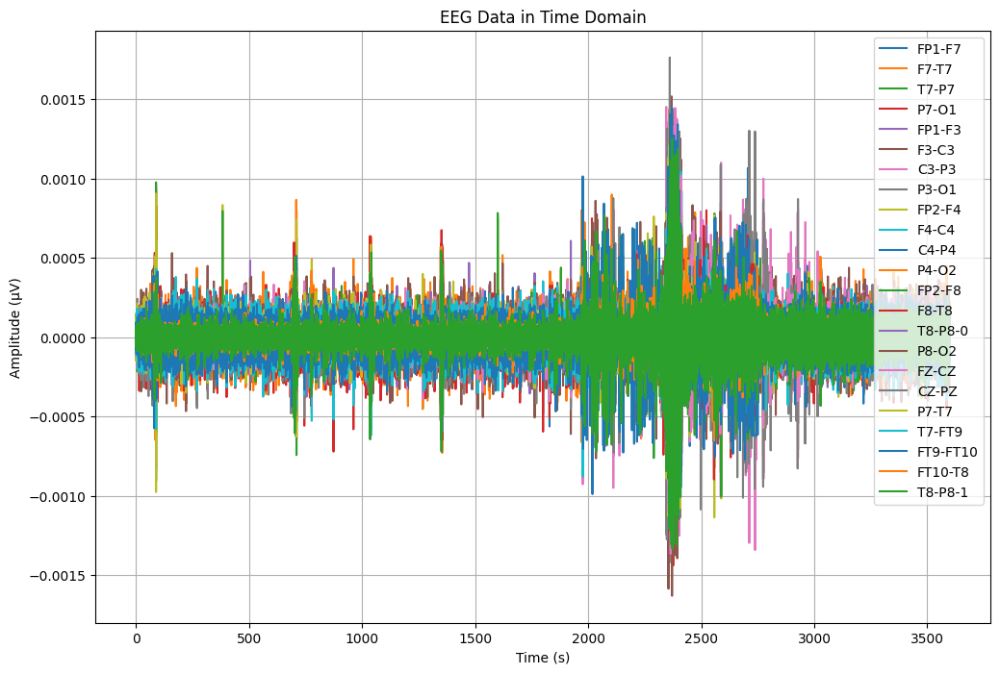

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df2['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df2[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


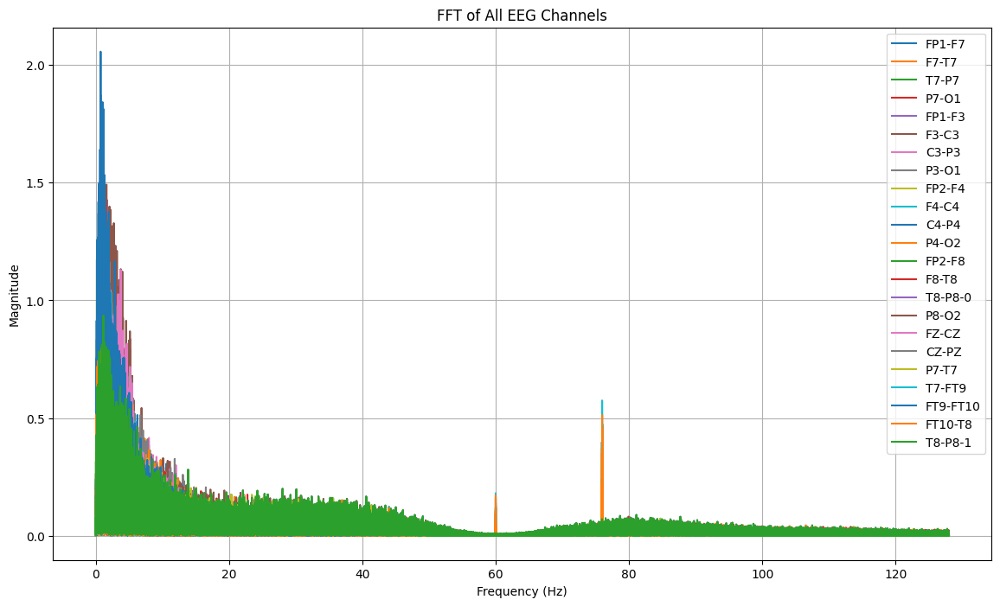

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df2[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_16.csv"
df2.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_16.csv


In [ ]:
#Import Data CSV
dataTA2 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_16.csv")
dataTA2


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.295238e-04,-6.153846e-05,-1.660562e-05,-3.770452e-05,3.965812e-05,-3.184371e-05,-5.665446e-06,1.152625e-05,6.974359e-05,-5.020757e-05,...,8.791209e-06,3.379731e-05,-5.997558e-05,1.504274e-05,1.699634e-05,2.402930e-05,-1.010012e-04,-2.148962e-06,8.791209e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-9.768010e-07,1.953602e-07,0.011719
4,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-1.367521e-06,1.953602e-07,1.758242e-06,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-4.747253e-05,4.004884e-05,5.665446e-06,-5.137973e-05,6.349206e-05,2.832723e-05,9.181929e-06,-1.557021e-04,4.669109e-05,7.873016e-05,...,6.837607e-06,-8.498168e-05,2.832723e-05,-8.810745e-05,-5.274725e-06,-5.098901e-05,5.684982e-05,1.738706e-05,6.837607e-06,3599.980469
921596,-4.942613e-05,2.949939e-05,1.191697e-05,-5.567766e-05,7.091575e-05,1.973138e-05,9.768010e-07,-1.564835e-04,4.473748e-05,7.638584e-05,...,1.269841e-05,-8.420024e-05,2.598291e-05,-9.240537e-05,-1.152625e-05,-3.379731e-05,5.802198e-05,5.860806e-07,1.269841e-05,3599.984375
921597,-4.981685e-05,2.168498e-05,1.582418e-05,-5.841270e-05,7.912088e-05,1.269841e-05,-5.665446e-06,-1.580464e-04,4.161172e-05,7.794872e-05,...,1.738706e-05,-8.302808e-05,2.285714e-05,-9.045177e-05,-1.543346e-05,-4.434676e-05,6.075702e-05,1.308913e-05,1.738706e-05,3599.988281
921598,-4.551893e-05,1.347985e-05,2.129426e-05,-6.310134e-05,8.849817e-05,8.400488e-06,-1.504274e-05,-1.572650e-04,4.278388e-05,7.990232e-05,...,2.324786e-05,-8.224664e-05,2.168498e-05,-9.435897e-05,-2.090354e-05,-4.356532e-05,6.192918e-05,1.894994e-05,2.324786e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA2[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA2[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA2[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data2, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.74 Hz, Magnitude: 2.056949, Time: 2370.316406 s
Channel: F3-C3, Max Frequency: 1.62 Hz, Magnitude: 1.492192, Time: 2355.171875 s
Channel: FP1-F3, Max Frequency: 1.72 Hz, Magnitude: 1.426072, Time: 2387.539062 s
Channel: F7-T7, Max Frequency: 1.23 Hz, Magnitude: 1.416079, Time: 2359.757812 s
Channel: FP1-F7, Max Frequency: 0.78 Hz, Magnitude: 1.411653, Time: 2369.507812 s
Channel: P7-O1, Max Frequency: 1.58 Hz, Magnitude: 1.351388, Time: 2375.929688 s
Channel: FP2-F8, Max Frequency: 1.00 Hz, Magnitude: 1.341561, Time: 2379.664062 s
Channel: P3-O1, Max Frequency: 1.16 Hz, Magnitude: 1.304284, Time: 2360.917969 s
Channel: P7-T7, Max Frequency: 1.07 Hz, Magnitude: 1.294956, Time: 2371.976562 s
Channel: T7-P7, Max Frequency: 1.07 Hz, Magnitude: 1.294956, Time: 2371.976562 s
Channel: C3-P3, Max Frequency: 1.19 Hz, Magnitude: 1.283451, Time: 2345.421875 s
Channel: FZ-CZ, Max Freq

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 1.19 Hz, Magnitude: 1.283451, Time: 2345.421875 s
Channel: F3-C3, Max Frequency: 1.62 Hz, Magnitude: 1.492192, Time: 2355.171875 s
Channel: FP2-F4, Max Frequency: 1.05 Hz, Magnitude: 1.105651, Time: 2358.261719 s
Channel: F7-T7, Max Frequency: 1.23 Hz, Magnitude: 1.416079, Time: 2359.757812 s
Channel: P3-O1, Max Frequency: 1.16 Hz, Magnitude: 1.304284, Time: 2360.917969 s
Channel: F8-T8, Max Frequency: 0.77 Hz, Magnitude: 1.101666, Time: 2366.562500 s
Channel: FP1-F7, Max Frequency: 0.78 Hz, Magnitude: 1.411653, Time: 2369.507812 s
Channel: T7-FT9, Max Frequency: 1.04 Hz, Magnitude: 1.122467, Time: 2370.296875 s
Channel: FT9-FT10, Max Frequency: 0.74 Hz, Magnitude: 2.056949, Time: 2370.316406 s
Channel: P8-O2, Max Frequency: 0.48 Hz, Magnitude: 0.794810, Time: 2370.898438 s
Channel: T7-P7, Max Frequency: 1.07 Hz, Magnitude: 1.294956, Time: 2371.976

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2225   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2519    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut = dataTA2.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_16.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA2 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_16.csv")
TA2.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000111,-0.000045,-0.000060,-0.000086,-0.000039,-0.000018,-0.000026,0.000003,-0.000046,3.711844e-06,...,-0.000132,-0.000023,-0.000055,0.000004,0.000061,0.000149,-0.000386,0.000292,-0.000132,2225.000000
1,0.000132,-0.000063,-0.000078,-0.000078,-0.000039,-0.000028,-0.000031,0.000011,-0.000034,-2.148962e-06,...,0.000038,-0.000005,-0.000057,0.000004,0.000078,0.000117,-0.000337,0.000081,0.000038,2225.003906
2,0.000101,-0.000019,-0.000098,-0.000063,-0.000040,-0.000038,-0.000027,0.000027,-0.000028,-5.860806e-07,...,0.000099,0.000002,-0.000061,0.000002,0.000098,0.000071,-0.000337,0.000051,0.000099,2225.007812
3,0.000087,-0.000009,-0.000095,-0.000061,-0.000044,-0.000043,-0.000021,0.000032,-0.000046,-1.387057e-05,...,0.000076,0.000005,-0.000063,-0.000004,0.000095,0.000066,-0.000321,0.000060,0.000076,2225.011719
4,0.000070,0.000028,-0.000105,-0.000066,-0.000046,-0.000047,-0.000009,0.000028,-0.000042,1.953602e-07,...,0.000055,0.000006,-0.000057,-0.000003,0.000105,0.000027,-0.000282,0.000063,0.000055,2225.015625


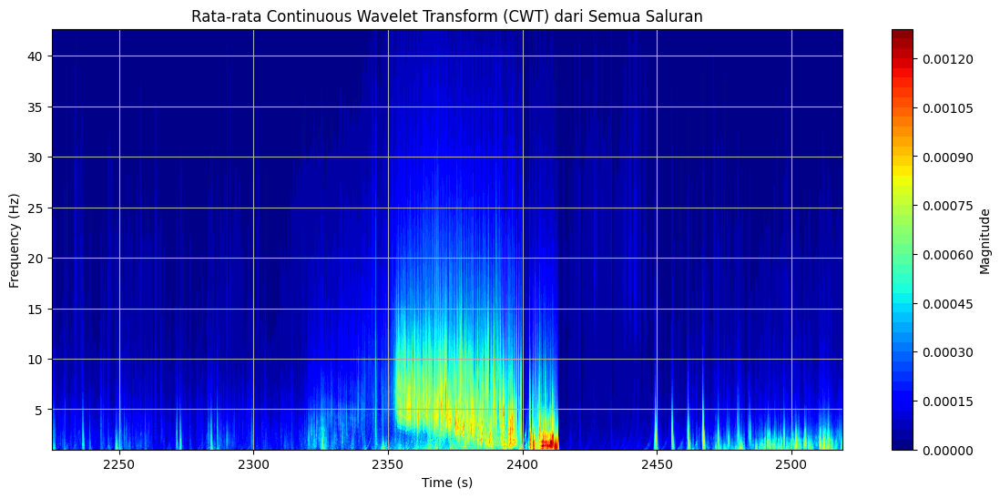

In [ ]:
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Parameter transformasi wavelet
wavelet = 'cmor'  # Contoh wavelet complex Morlet
sampling_rate = 256  # Misal 256 Hz
scales = np.arange(1, 128)  # Skala yang akan digunakan dalam transformasi

# Variabel untuk menyimpan rata-rata koefisien wavelet dari semua saluran
total_coef = None
time = TA2['Time']  # Kolom waktu

for channel in channels:
    signal = TA2[channel].values  # Mengambil sinyal dari saluran EEG

    # Continuous Wavelet Transform (CWT)
    coef, freqs = pywt.cwt(signal, scales, wavelet, sampling_period=1/sampling_rate)

    # Membatasi frekuensi hingga 60 Hz
    freqs = freqs[freqs <= 60]
    coef = coef[:len(freqs), :]

    # Menambahkan koefisien dari setiap saluran
    if total_coef is None:
        total_coef = np.abs(coef)  # Inisialisasi dengan koefisien pertama
    else:
        total_coef += np.abs(coef)  # Menambahkan koefisien dari saluran lainnya

# Rata-rata koefisien dari semua saluran
average_coef = total_coef / len(channels)

# Plotting hasil rata-rata CWT dari semua saluran
plt.figure(figsize=(14, 6))
plt.contourf(time, freqs, average_coef, cmap='jet', levels=50)
plt.title('Rata-rata Continuous Wavelet Transform (CWT) dari Semua Saluran')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Magnitude')
plt.grid(True)
plt.show()


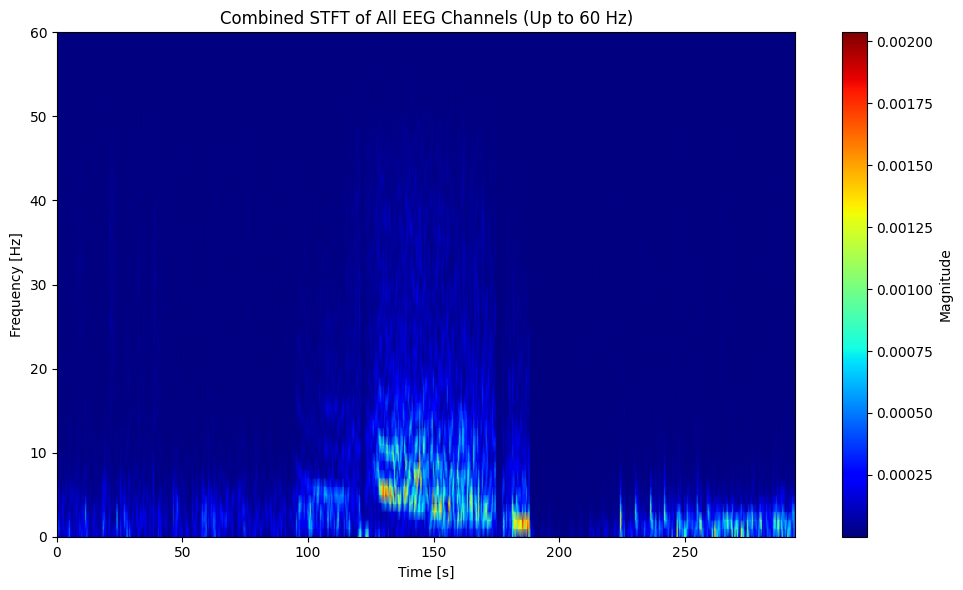

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Inisialisasi sinyal gabungan
combined_signal = np.zeros(len(TA2[channels[0]]))

# Loop melalui setiap saluran dan menambahkan sinyalnya ke sinyal gabungan
for channel in channels:
    signal = TA2[channel].values
    combined_signal += signal  # Menambahkan sinyal setiap saluran

# Menghitung STFT untuk sinyal gabungan
f, t, Zxx = stft(combined_signal, fs=sampling_rate, nperseg=256)

# Membatasi frekuensi hingga 60 Hz
max_freq = 60
freq_mask = f <= max_freq  # Masking frekuensi untuk hanya menampilkan sampai 60 Hz

# Membuat plot gabungan STFT dengan frekuensi sampai 60 Hz
plt.figure(figsize=(10, 6))
plt.pcolormesh(t, f[freq_mask], np.abs(Zxx[freq_mask, :]), shading='gouraud', cmap='jet')

# Memberikan label dan judul pada plot
plt.title('Combined STFT of All EEG Channels (Up to 60 Hz)')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [s]')

# Menambahkan colorbar untuk magnitude
plt.colorbar(label='Magnitude')

# Menampilkan plot
plt.tight_layout()
plt.show()


In [ ]:
# melihat ukuran file yang sudah dipotong
TA2.shape

(75264, 24)

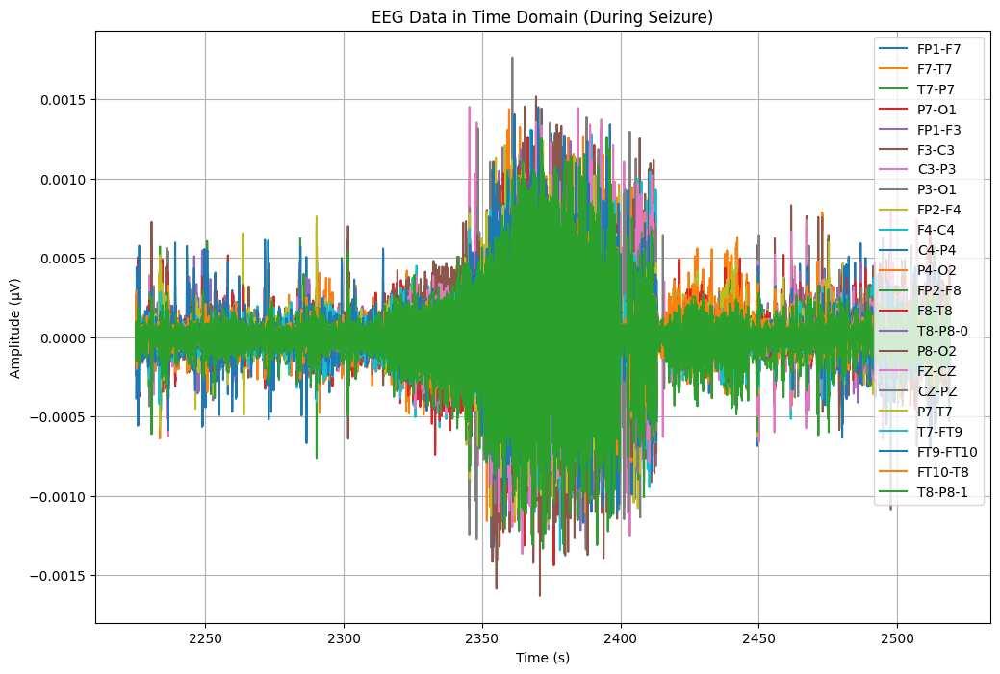

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA2['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA2.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA2[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


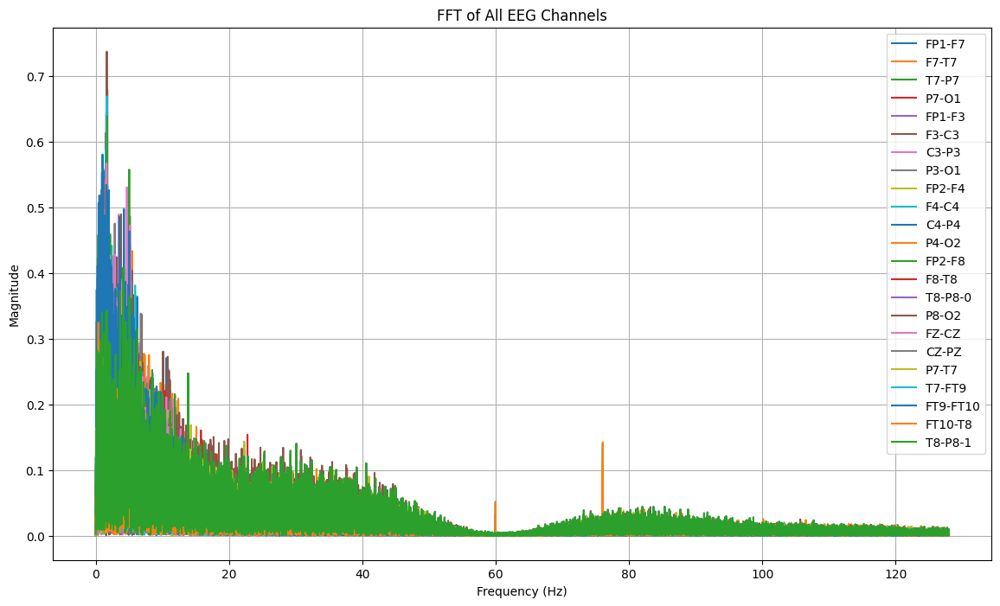

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA2[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2345:
        return "tidak kejang"
    elif 2345 <= row['Time'] < 2399:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_2 = TA2.copy()
TA_2['seizure'] = TA_2.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_2[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2225.000000  tidak kejang  0.000111 -0.000045 -0.000060 -0.000086   
1  2225.003906  tidak kejang  0.000132 -0.000063 -0.000078 -0.000078   
2  2225.007812  tidak kejang  0.000101 -0.000019 -0.000098 -0.000063   
3  2225.011719  tidak kejang  0.000087 -0.000009 -0.000095 -0.000061   
4  2225.015625  tidak kejang  0.000070  0.000028 -0.000105 -0.000066   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000039 -0.000018 -0.000026  0.000003  ...  0.000264 -0.000132 -0.000023   
1 -0.000039 -0.000028 -0.000031  0.000011  ...  0.000144  0.000038 -0.000005   
2 -0.000040 -0.000038 -0.000027  0.000027  ...  0.000073  0.000099  0.000002   
3 -0.000044 -0.000043 -0.000021  0.000032  ...  0.000113  0.000076  0.000005   
4 -0.000046 -0.000047 -0.000009  0.000028  ...  0.000190  0.000055  0.000006   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0 -0.000055 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_2['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,13824


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_2)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 294.0 detik


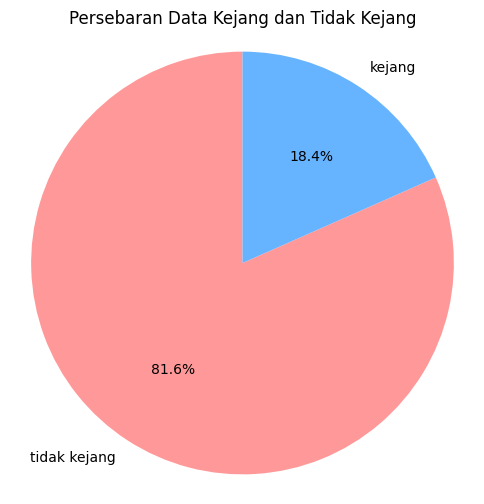

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_2['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_2.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb05_16.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_2.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_2['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.94      0.95      2865
tidak kejang       0.99      0.99      0.99     12188

    accuracy                           0.98     15053
   macro avg       0.97      0.96      0.97     15053
weighted avg       0.98      0.98      0.98     15053

Akurasi: 0.9801368497973826
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.94      0.95      2865
tidak kejang       0.99      0.99      0.99     12188

    accuracy                           0.98     15053
   macro avg       0.97      0.96      0.97     15053
weighted avg       0.98      0.98      0.98     15053



# DATA 3 (chb05_17)
akurasi = 0.961

In [ ]:
# mengimport file edf
file3 = "/content/drive/MyDrive/TA/EDF/chb05_17.edf"
data3 = mne.io.read_raw_edf(file3) # membaca file edf dan menyimpannya di data
data3


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_17.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-52-6fb3f9dd50c1>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data3 = mne.io.read_raw_edf(file3) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_17.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data3.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data3.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data3.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df3 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df3['Time'] = times  # Menambahkan kolom waktu
df3.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.489621e-05,5.665446e-06,1.465201e-05,5.294261e-05,-2.150916e-04,1.963370e-04,-1.017827e-04,1.389011e-04,2.385348e-04,1.308913e-05,...,2.520147e-05,-2.402930e-05,-4.278388e-05,2.129426e-05,-1.426129e-05,-1.025641e-04,9.357753e-05,6.036630e-05,2.520147e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,-5.860806e-07,9.768010e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df3.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df3.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.047424e-07,2.057709e-07,1.746672e-07,1.357885e-07,2.185830e-07,1.711496e-07,1.982529e-07,1.562097e-07,1.936207e-07,1.890784e-07,...,1.636833e-07,1.884141e-07,1.905478e-07,1.894922e-07,2.160532e-07,1.654775e-07,1.911808e-07,2.156445e-07,1.636833e-07,1799.998047
std,8.538011e-05,9.432272e-05,7.291423e-05,7.774539e-05,8.557387e-05,9.124290e-05,7.942061e-05,8.731339e-05,7.501448e-05,6.897427e-05,...,7.486569e-05,6.422872e-05,7.365610e-05,5.401147e-05,7.291423e-05,6.692400e-05,9.454810e-05,5.147112e-05,7.486569e-05,1039.231048
min,-1.487668e-03,-1.080537e-03,-1.419292e-03,-1.302466e-03,-1.391160e-03,-1.373578e-03,-1.321612e-03,-1.632234e-03,-1.344664e-03,-1.193846e-03,...,-1.390379e-03,-1.311453e-03,-1.186813e-03,-9.586325e-04,-1.289963e-03,-1.075849e-03,-1.221587e-03,-8.183639e-04,-1.390379e-03,0.000000
25%,-3.731380e-05,-5.098901e-05,-3.575092e-05,-4.083028e-05,-4.317460e-05,-4.590965e-05,-3.106227e-05,-3.614164e-05,-3.262515e-05,-2.949939e-05,...,-3.145299e-05,-2.832723e-05,-3.536020e-05,-2.793651e-05,-3.614164e-05,-3.457875e-05,-4.512821e-05,-2.246642e-05,-3.145299e-05,899.999023
50%,-1.953602e-07,1.953602e-07,1.953602e-07,2.539683e-06,-5.860806e-07,9.768010e-07,1.953602e-07,2.148962e-06,1.953602e-07,1.953602e-07,...,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,1.953602e-07,-1.953602e-07,5.860806e-07,1799.998047
75%,3.692308e-05,5.137973e-05,3.653236e-05,4.356532e-05,4.278388e-05,4.708181e-05,3.145299e-05,3.848596e-05,3.223443e-05,2.989011e-05,...,3.301587e-05,2.871795e-05,3.575092e-05,2.871795e-05,3.614164e-05,3.653236e-05,4.551893e-05,2.207570e-05,3.301587e-05,2699.997070
max,1.289573e-03,1.465397e-03,1.290354e-03,1.188767e-03,1.148132e-03,1.458364e-03,1.497436e-03,1.302857e-03,1.257924e-03,1.410696e-03,...,1.551355e-03,1.259096e-03,1.427106e-03,7.449084e-04,1.419683e-03,8.629060e-04,1.469304e-03,8.488400e-04,1.551355e-03,3599.996094


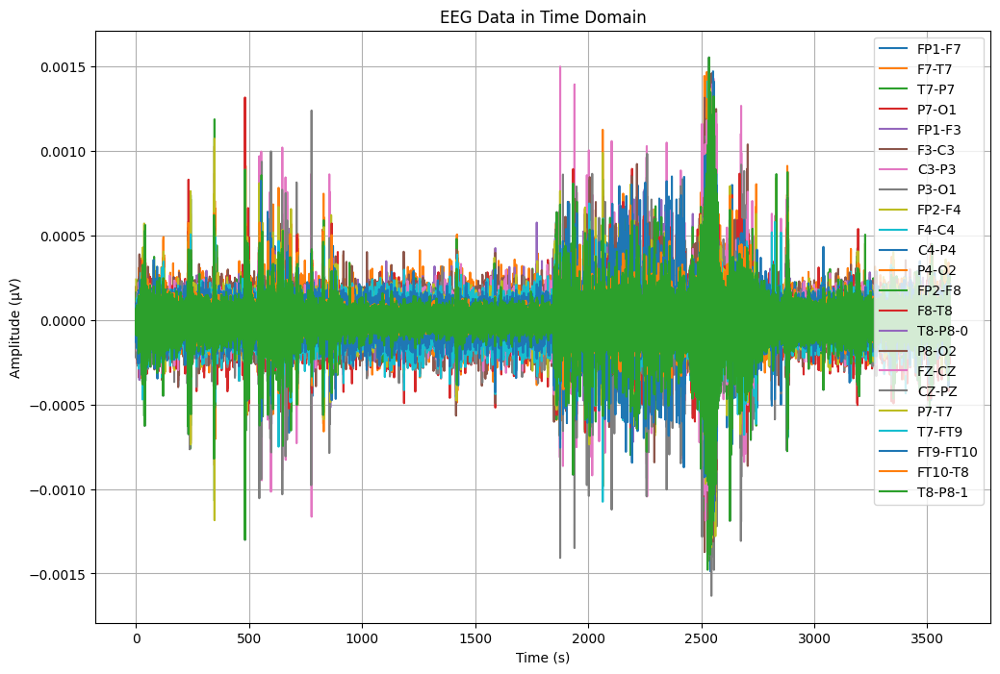

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df3['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df3[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


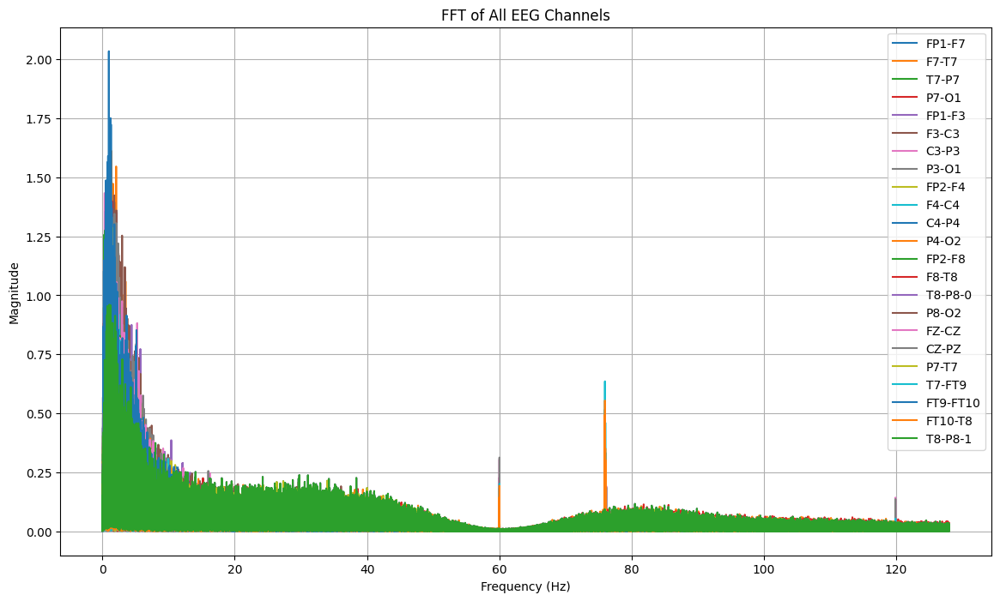

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df3[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_17.csv"
df3.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_17.csv


In [ ]:
#Import Data CSV
dataTA3 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_17.csv")
dataTA3


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.489621e-05,5.665446e-06,1.465201e-05,5.294261e-05,-2.150916e-04,1.963370e-04,-1.017827e-04,1.389011e-04,2.385348e-04,1.308913e-05,...,2.520147e-05,-2.402930e-05,-4.278388e-05,2.129426e-05,-1.426129e-05,-1.025641e-04,9.357753e-05,6.036630e-05,2.520147e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,-5.860806e-07,9.768010e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,2.832723e-05,9.181929e-06,6.446886e-06,-2.832723e-05,-3.223443e-05,5.255189e-05,-1.504274e-05,1.113553e-05,2.793651e-05,5.098901e-05,...,-3.457875e-05,3.301587e-05,2.129426e-05,-4.004884e-05,-6.056166e-06,1.953602e-07,8.400488e-06,-1.191697e-05,-3.457875e-05,3599.980469
921596,2.402930e-05,1.934066e-05,-6.056166e-06,-3.145299e-05,-3.223443e-05,4.903541e-05,-1.347985e-05,2.930403e-06,3.340659e-05,4.200244e-05,...,-5.958486e-05,2.637363e-05,1.504274e-05,-4.473748e-05,6.446886e-06,-4.884005e-06,1.738706e-05,1.758242e-06,-5.958486e-05,3599.984375
921597,1.660562e-05,-2.148962e-06,6.837607e-06,-2.715507e-05,-3.731380e-05,4.239316e-05,-1.465201e-05,4.493284e-06,3.692308e-05,4.122100e-05,...,-3.223443e-05,1.973138e-05,1.621490e-05,-4.864469e-05,-6.446886e-06,2.637363e-05,2.051282e-05,-3.145299e-05,-3.223443e-05,3599.988281
921598,1.230769e-05,-1.426129e-05,6.837607e-06,-1.582418e-05,-3.457875e-05,3.496947e-05,-1.582418e-05,5.274725e-06,4.161172e-05,3.536020e-05,...,-1.738706e-05,2.871795e-05,1.582418e-05,-4.786325e-05,-6.446886e-06,2.285714e-05,2.090354e-05,-3.692308e-05,-1.738706e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA3[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA3[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA3[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data1, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.97 Hz, Magnitude: 2.034359, Time: 2552.613281 s
Channel: F7-T7, Max Frequency: 1.33 Hz, Magnitude: 1.612365, Time: 2525.171875 s
Channel: P7-O1, Max Frequency: 1.23 Hz, Magnitude: 1.476835, Time: 2539.363281 s
Channel: C3-P3, Max Frequency: 0.33 Hz, Magnitude: 1.433202, Time: 1876.148438 s
Channel: F3-C3, Max Frequency: 1.76 Hz, Magnitude: 1.423620, Time: 2546.742188 s
Channel: FP1-F7, Max Frequency: 1.32 Hz, Magnitude: 1.379596, Time: 2541.363281 s
Channel: FP1-F3, Max Frequency: 2.17 Hz, Magnitude: 1.351633, Time: 2539.757812 s
Channel: P3-O1, Max Frequency: 1.81 Hz, Magnitude: 1.345232, Time: 2545.164062 s
Channel: FP2-F4, Max Frequency: 1.46 Hz, Magnitude: 1.286753, Time: 2544.828125 s
Channel: FP2-F8, Max Frequency: 0.41 Hz, Magnitude: 1.275725, Time: 2528.382812 s
Channel: FZ-CZ, Max Frequency: 1.76 Hz, Magnitude: 1.269166, Time: 2554.394531 s
Channel: F8-T8, Max Fre

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F8-T8, Max Frequency: 1.00 Hz, Magnitude: 1.196004, Time: 481.675781 s
Channel: C3-P3, Max Frequency: 0.33 Hz, Magnitude: 1.433202, Time: 1876.148438 s
Channel: T7-FT9, Max Frequency: 1.19 Hz, Magnitude: 1.110401, Time: 2064.250000 s
Channel: F7-T7, Max Frequency: 1.33 Hz, Magnitude: 1.612365, Time: 2525.171875 s
Channel: FP2-F8, Max Frequency: 0.41 Hz, Magnitude: 1.275725, Time: 2528.382812 s
Channel: F4-C4, Max Frequency: 1.39 Hz, Magnitude: 1.016439, Time: 2528.664062 s
Channel: P4-O2, Max Frequency: 1.47 Hz, Magnitude: 0.949000, Time: 2529.328125 s
Channel: T7-P7, Max Frequency: 2.01 Hz, Magnitude: 1.050341, Time: 2534.210938 s
Channel: P7-T7, Max Frequency: 2.01 Hz, Magnitude: 1.050341, Time: 2534.210938 s
Channel: T8-P8-0, Max Frequency: 1.04 Hz, Magnitude: 0.960444, Time: 2534.644531 s
Channel: T8-P8-1, Max Frequency: 1.04 Hz, Magnitude: 0.960444, Time: 2534.6445

In [ ]:
# potong data (potong dulu datanya)
# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2405   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2684    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut3 = dataTA3.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut3.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_17.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA3 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_17.csv")
TA3.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000206,0.000040,-0.000009,-0.000070,0.000099,0.000115,-0.000176,0.000126,0.000079,0.000011,...,-0.000122,0.000113,0.000040,-0.000039,0.000010,0.000060,-0.000128,-0.000024,-0.000122,2405.000000
1,0.000223,0.000065,0.000022,-0.000117,0.000151,0.000092,-0.000222,0.000172,0.000094,0.000044,...,-0.000115,0.000078,0.000030,-0.000037,-0.000022,0.000054,-0.000144,-0.000017,-0.000115,2405.003906
2,0.000208,0.000081,0.000037,-0.000127,0.000179,0.000075,-0.000241,0.000187,0.000071,0.000060,...,-0.000099,0.000050,0.000025,-0.000030,-0.000037,0.000060,-0.000137,-0.000017,-0.000099,2405.007812
3,0.000155,0.000090,0.000049,-0.000128,0.000127,0.000079,-0.000223,0.000182,0.000067,0.000049,...,-0.000085,0.000060,0.000022,-0.000032,-0.000048,0.000036,-0.000143,-0.000022,-0.000085,2405.011719
4,0.000175,0.000082,0.000027,-0.000107,0.000149,0.000056,-0.000130,0.000101,0.000072,0.000014,...,-0.000067,0.000042,0.000018,-0.000039,-0.000026,0.000041,-0.000142,-0.000040,-0.000067,2405.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA3.shape


(71424, 24)

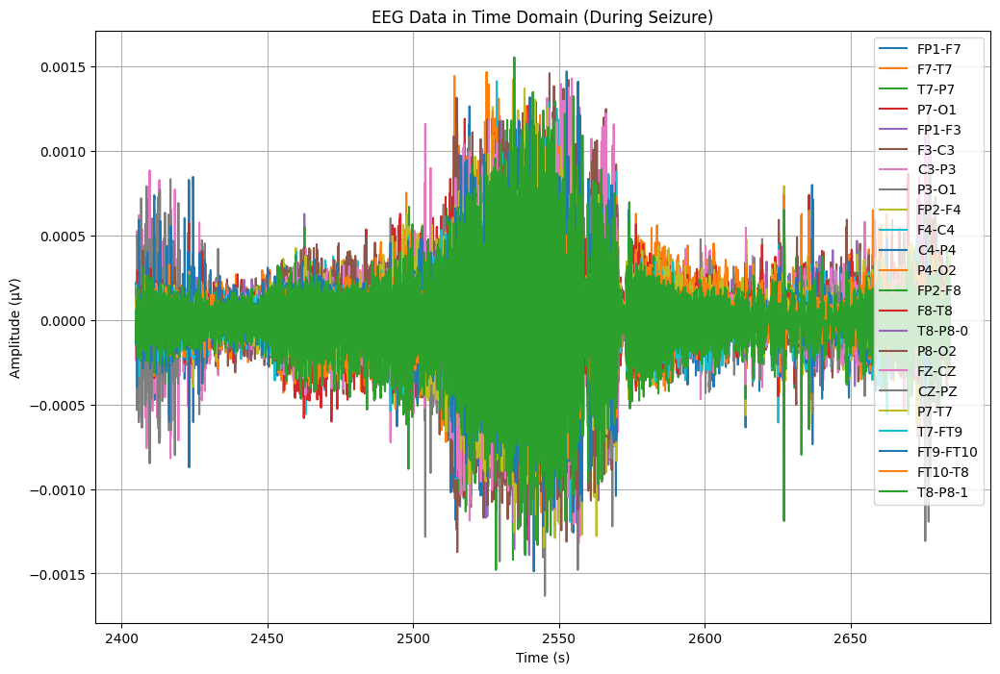

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA3['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA3.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA3[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


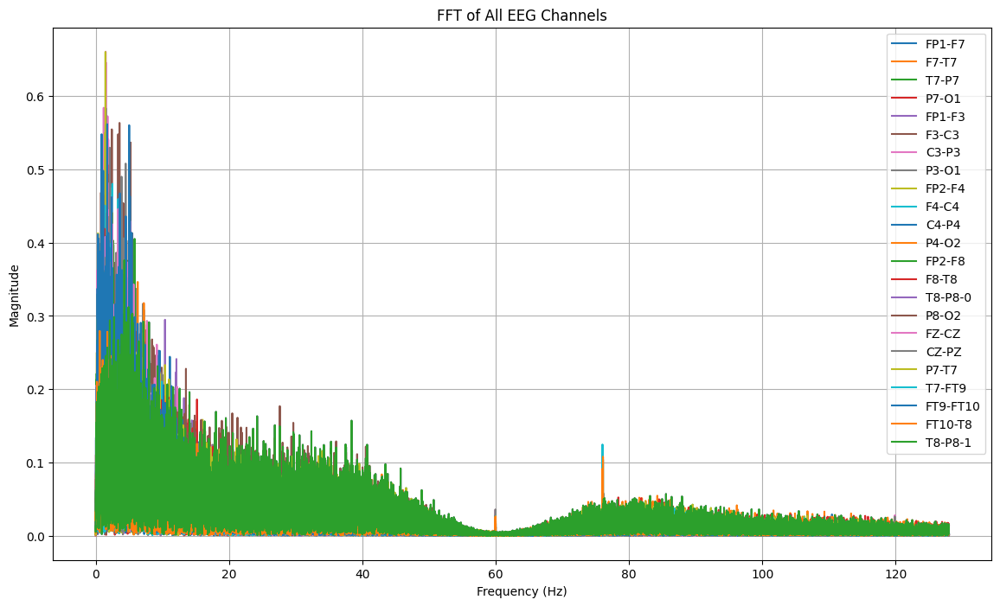

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA3[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2525:
        return "tidak kejang"
    elif 2525 <= row['Time'] < 2564:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_3 = TA3.copy()
TA_3['seizure'] = TA_3.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_3[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2405.000000  tidak kejang  0.000206  0.000040 -0.000009 -0.000070   
1  2405.003906  tidak kejang  0.000223  0.000065  0.000022 -0.000117   
2  2405.007812  tidak kejang  0.000208  0.000081  0.000037 -0.000127   
3  2405.011719  tidak kejang  0.000155  0.000090  0.000049 -0.000128   
4  2405.015625  tidak kejang  0.000175  0.000082  0.000027 -0.000107   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000099  0.000115 -0.000176  0.000126  ...  0.000053 -0.000122  0.000113   
1  0.000151  0.000092 -0.000222  0.000172  ...  0.000053 -0.000115  0.000078   
2  0.000179  0.000075 -0.000241  0.000187  ...  0.000058 -0.000099  0.000050   
3  0.000127  0.000079 -0.000223  0.000182  ...  0.000022 -0.000085  0.000060   
4  0.000149  0.000056 -0.000130  0.000101  ...  0.000026 -0.000067  0.000042   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0  0.000040 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_3['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,9984


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_3)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 279.0 detik


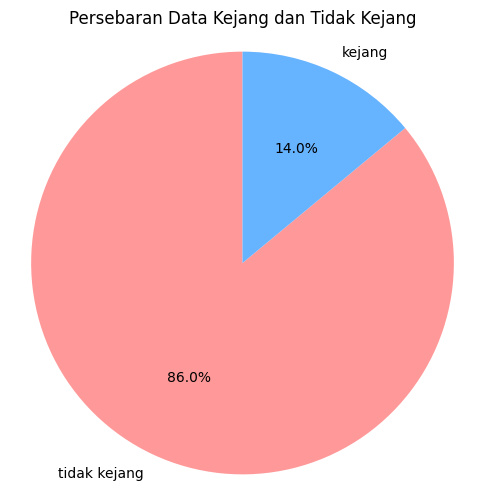

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_3['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_3.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb05_17.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_1.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_1['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.97      0.93      0.95      7779
tidak kejang       0.95      0.98      0.97     12241

    accuracy                           0.96     20020
   macro avg       0.96      0.96      0.96     20020
weighted avg       0.96      0.96      0.96     20020

Akurasi: 0.9612887112887113
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.93      0.95      7779
tidak kejang       0.95      0.98      0.97     12241

    accuracy                           0.96     20020
   macro avg       0.96      0.96      0.96     20020
weighted avg       0.96      0.96      0.96     20020



# DATA 4 (chb05_22)
Akurasi = 0.956

In [ ]:
# mengimport file edf
file4 = "/content/drive/MyDrive/TA/EDF/chb05_22.edf"
data4 = mne.io.read_raw_edf(file4) # membaca file edf dan menyimpannya di data
data4


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_22.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-93-54e038bb07ed>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data4 = mne.io.read_raw_edf(file4) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_22.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data4.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data4.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data4.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df4 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df4['Time'] = times  # Menambahkan kolom waktu
df4.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,2.559219e-05,-1.777778e-05,1.699634e-05,-7.521368e-05,1.230769e-05,-9.982906e-05,9.592186e-05,-5.880342e-05,-6.075702e-05,6.700855e-05,...,1.582418e-05,7.912088e-05,9.768010e-07,5.958486e-05,-1.660562e-05,3.711844e-06,-3.338706e-04,7.286935e-05,1.582418e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-5.860806e-07,-9.768010e-07,9.768010e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,-5.860806e-07,1.758242e-06,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df4.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df4.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.026663e-07,1.981392e-07,1.581612e-07,1.883814e-07,2.272207e-07,1.657823e-07,1.940124e-07,1.689060e-07,2.302350e-07,1.572823e-07,...,1.696064e-07,1.897012e-07,1.618390e-07,1.818838e-07,2.325592e-07,1.569678e-07,2.224418e-07,2.279910e-07,1.696064e-07,1799.998047
std,1.073628e-04,1.145983e-04,8.602412e-05,9.235884e-05,1.038931e-04,1.179088e-04,6.501976e-05,8.064252e-05,9.079373e-05,8.931952e-05,...,9.065014e-05,7.521492e-05,9.129845e-05,6.210484e-05,8.602412e-05,8.344717e-05,1.124880e-04,6.196082e-05,9.065014e-05,1039.231048
min,-1.468913e-03,-1.316142e-03,-1.239170e-03,-9.465201e-04,-1.302857e-03,-1.398193e-03,-8.519658e-04,-1.009426e-03,-9.008059e-04,-1.214945e-03,...,-1.132503e-03,-8.488400e-04,-1.378657e-03,-8.660317e-04,-1.086007e-03,-1.010989e-03,-9.840293e-04,-6.913797e-04,-1.132503e-03,0.000000
25%,-5.177045e-05,-6.349206e-05,-4.395604e-05,-5.294261e-05,-5.567766e-05,-6.192918e-05,-3.614164e-05,-4.630037e-05,-4.669109e-05,-4.161172e-05,...,-4.590965e-05,-3.926740e-05,-4.630037e-05,-3.145299e-05,-4.630037e-05,-4.590965e-05,-5.841270e-05,-3.106227e-05,-4.590965e-05,899.999023
50%,1.953602e-07,1.953602e-07,9.768010e-07,5.860806e-07,-1.758242e-06,2.539683e-06,1.953602e-07,1.367521e-06,-1.367521e-06,1.367521e-06,...,5.860806e-07,5.860806e-07,1.758242e-06,5.860806e-07,-5.860806e-07,5.860806e-07,-1.953602e-07,-5.860806e-07,5.860806e-07,1799.998047
75%,5.059829e-05,6.388278e-05,4.669109e-05,5.411477e-05,5.372405e-05,6.466422e-05,3.692308e-05,4.786325e-05,4.356532e-05,4.395604e-05,...,4.669109e-05,3.965812e-05,4.903541e-05,3.223443e-05,4.434676e-05,4.747253e-05,5.724054e-05,2.949939e-05,4.669109e-05,2699.997070
max,1.315360e-03,1.340757e-03,1.086398e-03,1.011380e-03,1.170403e-03,1.606447e-03,7.116972e-04,1.168059e-03,1.252845e-03,1.518535e-03,...,1.126252e-03,9.148718e-04,1.451722e-03,8.859585e-04,1.239560e-03,1.049280e-03,1.020757e-03,1.074286e-03,1.126252e-03,3599.996094


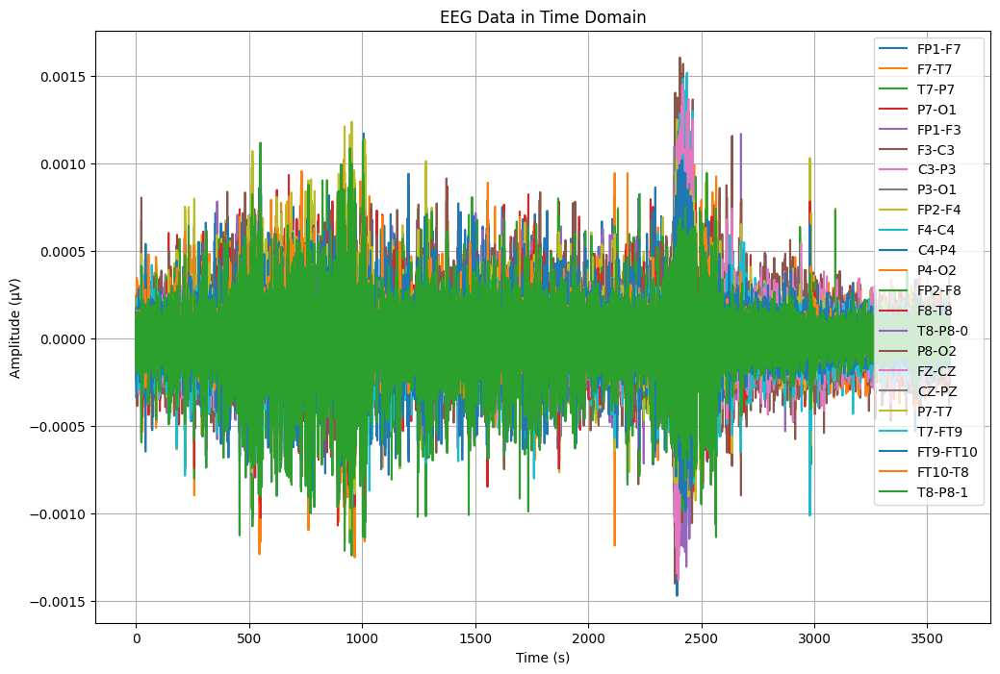

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df4['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df4[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


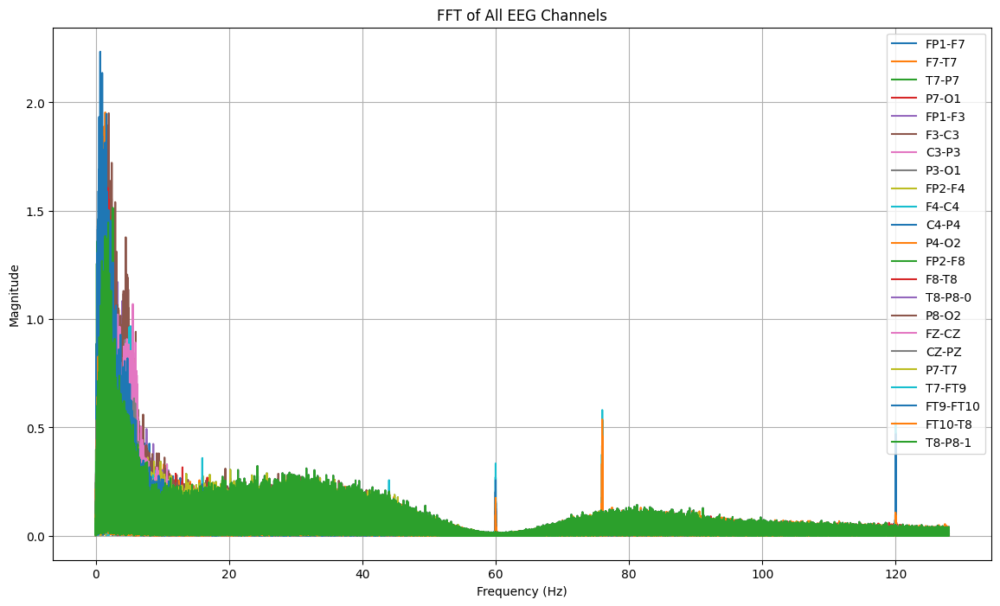

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df4[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_22.csv"
df4.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_22.csv


In [ ]:
#Import Data CSV
dataTA4 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_22.csv")
dataTA4

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,2.559219e-05,-1.777778e-05,1.699634e-05,-7.521368e-05,1.230769e-05,-9.982906e-05,9.592186e-05,-5.880342e-05,-6.075702e-05,6.700855e-05,...,1.582418e-05,7.912088e-05,9.768010e-07,5.958486e-05,-1.660562e-05,3.711844e-06,-3.338706e-04,7.286935e-05,1.582418e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-5.860806e-07,-9.768010e-07,9.768010e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,-5.860806e-07,1.758242e-06,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-3.809524e-05,-7.208791e-05,2.930403e-06,6.544567e-05,1.465201e-05,-6.153846e-05,-2.285714e-05,2.793651e-05,3.926740e-05,9.768010e-07,...,1.855922e-05,-2.520147e-05,-8.263736e-05,-5.860806e-07,-2.539683e-06,5.059829e-05,5.958486e-05,2.930403e-06,1.855922e-05,3599.980469
921596,-4.122100e-05,-7.013431e-05,3.711844e-06,6.661783e-05,1.191697e-05,-6.583639e-05,-1.582418e-05,2.910867e-05,3.965812e-05,1.953602e-07,...,2.481074e-05,-1.621490e-05,-7.755800e-05,2.148962e-06,-3.321123e-06,7.013431e-05,4.551893e-05,-1.035409e-05,2.481074e-05,3599.984375
921597,-4.864469e-05,-6.700855e-05,3.321123e-06,7.013431e-05,3.711844e-06,-6.700855e-05,-1.113553e-05,3.262515e-05,4.043956e-05,9.768010e-07,...,2.910867e-05,-1.816850e-05,-7.091575e-05,9.963370e-06,-2.930403e-06,7.404151e-05,4.590965e-05,-1.035409e-05,2.910867e-05,3599.988281
921598,-5.059829e-05,-6.114774e-05,3.711844e-06,7.208791e-05,9.768010e-07,-6.192918e-05,-3.711844e-06,2.989011e-05,4.317460e-05,2.539683e-06,...,3.262515e-05,-1.230769e-05,-6.896215e-05,2.012210e-05,-3.321123e-06,6.192918e-05,4.043956e-05,3.321123e-06,3.262515e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA4[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA4[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA4[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data4, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.68 Hz, Magnitude: 2.234297, Time: 2414.652344 s
Channel: F7-T7, Max Frequency: 1.43 Hz, Magnitude: 1.954128, Time: 2415.195312 s
Channel: F3-C3, Max Frequency: 1.96 Hz, Magnitude: 1.950264, Time: 2405.835938 s
Channel: FP1-F7, Max Frequency: 0.86 Hz, Magnitude: 1.689892, Time: 2393.363281 s
Channel: FP1-F3, Max Frequency: 1.92 Hz, Magnitude: 1.654394, Time: 2434.503906 s
Channel: F8-T8, Max Frequency: 1.34 Hz, Magnitude: 1.634592, Time: 2392.808594 s
Channel: F4-C4, Max Frequency: 1.47 Hz, Magnitude: 1.611405, Time: 2436.789062 s
Channel: FZ-CZ, Max Frequency: 1.47 Hz, Magnitude: 1.595905, Time: 2416.230469 s
Channel: FP2-F8, Max Frequency: 0.84 Hz, Magnitude: 1.593170, Time: 2399.457031 s
Channel: FP2-F4, Max Frequency: 0.74 Hz, Magnitude: 1.464458, Time: 2392.785156 s
Channel: T8-P8-0, Max Frequency: 1.88 Hz, Magnitude: 1.446066, Time: 2565.691406 s
Channel: T8-P8-1, Max

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-P7, Max Frequency: 1.29 Hz, Magnitude: 1.258311, Time: 953.695312 s
Channel: P7-T7, Max Frequency: 1.29 Hz, Magnitude: 1.258311, Time: 953.695312 s
Channel: FT10-T8, Max Frequency: 0.67 Hz, Magnitude: 0.898744, Time: 1003.132812 s
Channel: P8-O2, Max Frequency: 1.97 Hz, Magnitude: 1.074100, Time: 1372.953125 s
Channel: P3-O1, Max Frequency: 1.60 Hz, Magnitude: 1.339623, Time: 2391.660156 s
Channel: P7-O1, Max Frequency: 0.67 Hz, Magnitude: 1.418500, Time: 2391.664062 s
Channel: FP2-F4, Max Frequency: 0.74 Hz, Magnitude: 1.464458, Time: 2392.785156 s
Channel: F8-T8, Max Frequency: 1.34 Hz, Magnitude: 1.634592, Time: 2392.808594 s
Channel: FP1-F7, Max Frequency: 0.86 Hz, Magnitude: 1.689892, Time: 2393.363281 s
Channel: FP2-F8, Max Frequency: 0.84 Hz, Magnitude: 1.593170, Time: 2399.457031 s
Channel: F3-C3, Max Frequency: 1.96 Hz, Magnitude: 1.950264, Time: 2405.835938

In [ ]:
# potong data (potong dulu datanya)
# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2271   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2685    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut4 = dataTA4.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut4.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_22.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA4 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_22.csv")
TA4.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000060,0.000096,0.000052,0.000015,0.000117,-0.000025,0.000010,9.768010e-07,9.572650e-06,0.000004,...,0.000087,0.000117,-0.000039,0.000008,-0.000052,-0.000067,-0.000125,-0.000005,0.000087,2271.000000
1,-0.000065,0.000090,0.000060,0.000011,0.000114,-0.000023,0.000011,-4.884005e-06,-1.953602e-07,0.000002,...,0.000075,0.000117,-0.000048,0.000005,-0.000060,-0.000071,-0.000124,0.000012,0.000075,2271.003906
2,-0.000067,0.000073,0.000074,0.000010,0.000120,-0.000035,0.000013,-8.009768e-06,-1.504274e-05,-0.000004,...,0.000055,0.000117,-0.000054,0.000003,-0.000074,-0.000045,-0.000122,0.000017,0.000055,2271.007812
3,-0.000074,0.000045,0.000081,0.000018,0.000119,-0.000051,0.000012,-9.181929e-06,-3.614164e-05,0.000004,...,0.000045,0.000115,-0.000062,0.000006,-0.000081,-0.000023,-0.000121,0.000022,0.000045,2271.011719
4,-0.000089,0.000038,0.000075,0.000016,0.000113,-0.000062,0.000005,-1.504274e-05,-3.575092e-05,-0.000012,...,0.000033,0.000109,-0.000072,0.000004,-0.000074,-0.000026,-0.000120,0.000039,0.000033,2271.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA4.shape

(105984, 24)

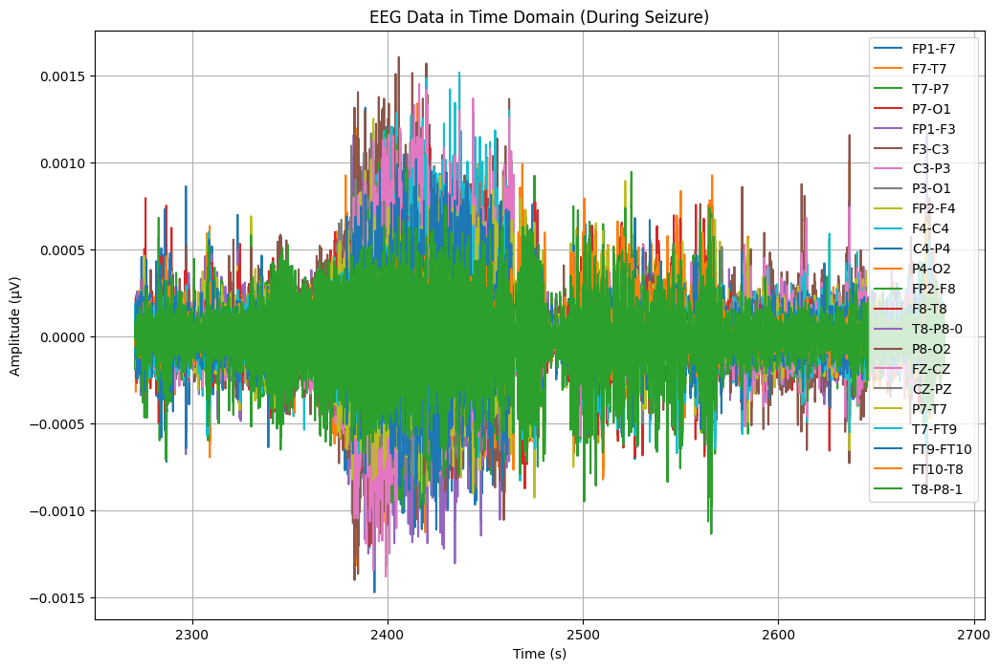

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA4['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA4.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA4[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


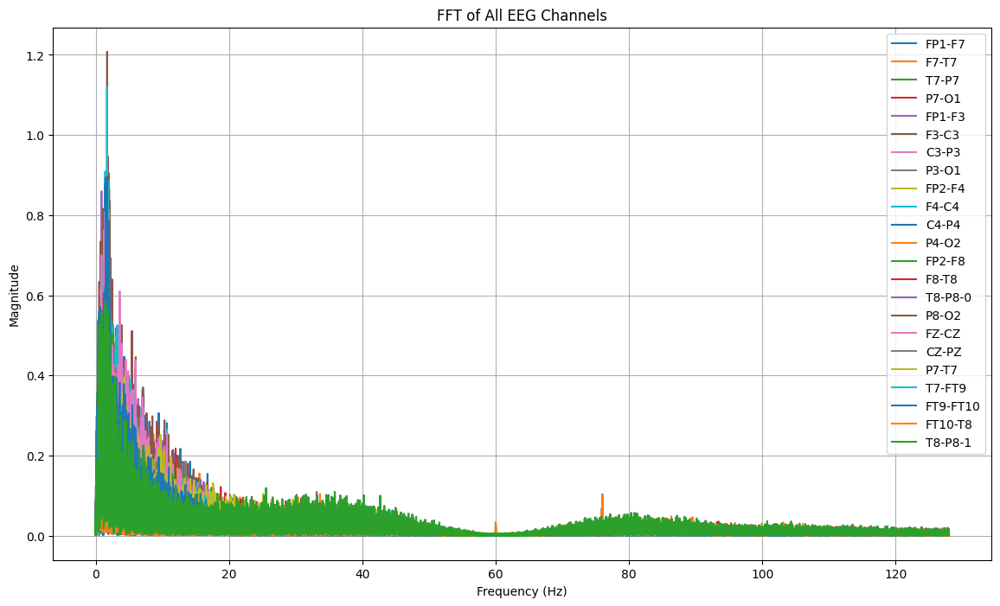

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA4[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2391:
        return "tidak kejang"
    elif 2391 <= row['Time'] < 2565:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_4 = TA4.copy()
TA_4['seizure'] = TA_4.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_4[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2271.000000  tidak kejang -0.000060  0.000096  0.000052  0.000015   
1  2271.003906  tidak kejang -0.000065  0.000090  0.000060  0.000011   
2  2271.007812  tidak kejang -0.000067  0.000073  0.000074  0.000010   
3  2271.011719  tidak kejang -0.000074  0.000045  0.000081  0.000018   
4  2271.015625  tidak kejang -0.000089  0.000038  0.000075  0.000016   

     FP1-F3     F3-C3     C3-P3         P3-O1  ...     F8-T8   T8-P8-0  \
0  0.000117 -0.000025  0.000010  9.768010e-07  ...  0.000047  0.000087   
1  0.000114 -0.000023  0.000011 -4.884005e-06  ...  0.000060  0.000075   
2  0.000120 -0.000035  0.000013 -8.009768e-06  ...  0.000080  0.000055   
3  0.000119 -0.000051  0.000012 -9.181929e-06  ...  0.000087  0.000045   
4  0.000113 -0.000062  0.000005 -1.504274e-05  ...  0.000092  0.000033   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0  0.000117 -0.000039  0.000008 -0.000052 -0.00

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_4['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,44544


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_4)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 414.0 detik


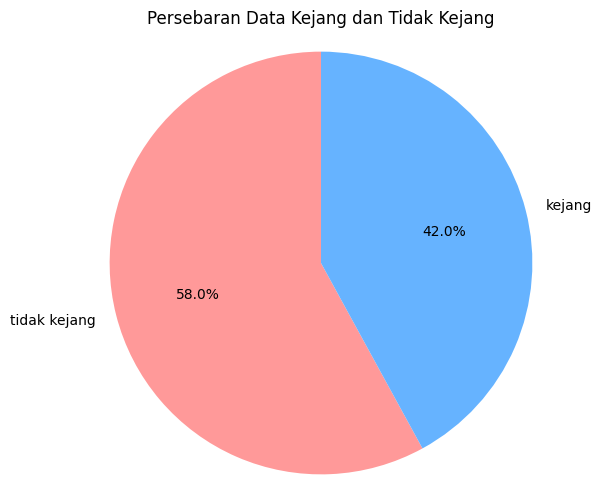

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_4['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_4.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb05_22.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_4.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_4['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.95      0.95      0.95      8979
tidak kejang       0.96      0.96      0.96     12218

    accuracy                           0.96     21197
   macro avg       0.95      0.96      0.96     21197
weighted avg       0.96      0.96      0.96     21197

Akurasi: 0.956125866867953
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.95      0.95      0.95      8979
tidak kejang       0.96      0.96      0.96     12218

    accuracy                           0.96     21197
   macro avg       0.95      0.96      0.96     21197
weighted avg       0.96      0.96      0.96     21197



# DATA 5 (chb05_06)
Akurasi = 0.986

In [ ]:
# mengimport file edf
file5 = "/content/drive/MyDrive/TA/EDF/chb05_06.edf"
data5 = mne.io.read_raw_edf(file5) # membaca file edf dan menyimpannya di data
data5


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_06.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-117-4df7912b5c69>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data5 = mne.io.read_raw_edf(file5) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_06.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data5.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data5.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data5.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df5 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df5['Time'] = times  # Menambahkan kolom waktu
df5.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.197558e-04,5.020757e-05,2.793651e-05,3.340659e-05,-1.127228e-04,5.665446e-06,5.372405e-05,4.512821e-05,1.894994e-05,1.387057e-05,...,-5.528694e-05,9.084249e-05,-2.148962e-06,6.974359e-05,-2.754579e-05,-9.162393e-05,1.850061e-04,-7.794872e-05,-5.528694e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-9.768010e-07,1.953602e-07,9.768010e-07,0.011719
4,1.953602e-07,1.367521e-06,-1.367521e-06,5.860806e-07,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.758242e-06,-2.930403e-06,1.367521e-06,5.860806e-07,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df5.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df5.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.211958e-07,1.853030e-07,1.895532e-07,1.565981e-07,2.216528e-07,1.915904e-07,1.844466e-07,1.530856e-07,1.952830e-07,1.743344e-07,...,1.934316e-07,1.906314e-07,1.870023e-07,1.958079e-07,2.011672e-07,1.712013e-07,1.615194e-07,2.144710e-07,1.934316e-07,1799.998047
std,7.841277e-05,9.052202e-05,5.870792e-05,6.954047e-05,8.058388e-05,1.035991e-04,6.137087e-05,7.483343e-05,6.557304e-05,6.895106e-05,...,5.566048e-05,5.319267e-05,7.587799e-05,5.122940e-05,5.870792e-05,5.727516e-05,8.023936e-05,4.206899e-05,5.566048e-05,1039.231048
min,-1.191502e-03,-9.887179e-04,-9.664469e-04,-7.804640e-04,-1.265739e-03,-7.050549e-04,-1.307546e-03,-1.498999e-03,-8.160195e-04,-6.593407e-04,...,-8.406349e-04,-7.632723e-04,-8.480586e-04,-5.483761e-04,-6.984127e-04,-8.730647e-04,-1.047717e-03,-5.593162e-04,-8.406349e-04,0.000000
25%,-3.496947e-05,-4.551893e-05,-2.949939e-05,-3.653236e-05,-4.122100e-05,-4.512821e-05,-2.715507e-05,-3.536020e-05,-2.910867e-05,-2.832723e-05,...,-2.637363e-05,-2.481074e-05,-3.496947e-05,-2.637363e-05,-2.949939e-05,-2.910867e-05,-3.965812e-05,-1.934066e-05,-2.637363e-05,899.999023
50%,-1.953602e-07,5.860806e-07,1.953602e-07,1.367521e-06,-5.860806e-07,1.953602e-07,5.860806e-07,1.758242e-06,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,9.768010e-07,1.953602e-07,1.953602e-07,1799.998047
75%,3.379731e-05,4.630037e-05,2.989011e-05,3.887668e-05,4.043956e-05,4.630037e-05,2.793651e-05,3.731380e-05,2.910867e-05,2.989011e-05,...,2.676435e-05,2.559219e-05,3.575092e-05,2.676435e-05,2.989011e-05,3.028083e-05,4.122100e-05,1.934066e-05,2.676435e-05,2699.997070
max,1.323956e-03,1.288791e-03,6.988034e-04,7.960928e-04,1.012552e-03,1.799463e-03,1.572063e-03,1.102027e-03,8.492308e-04,1.502515e-03,...,7.449084e-04,7.726496e-04,1.416166e-03,7.316239e-04,9.668376e-04,5.515018e-04,8.804884e-04,7.097436e-04,7.449084e-04,3599.996094


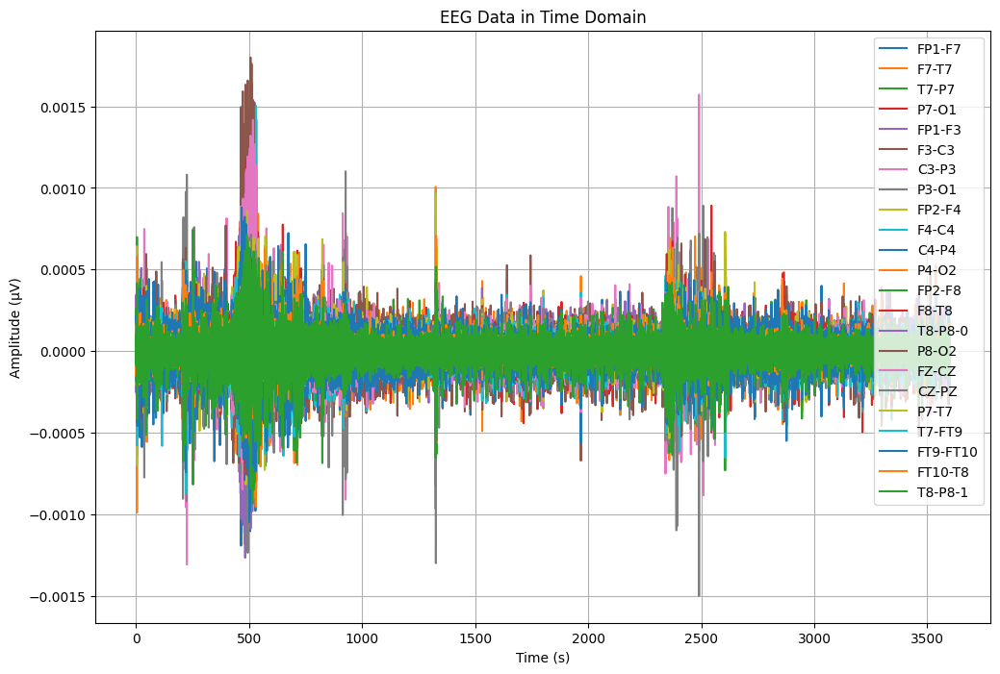

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df5['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df5[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


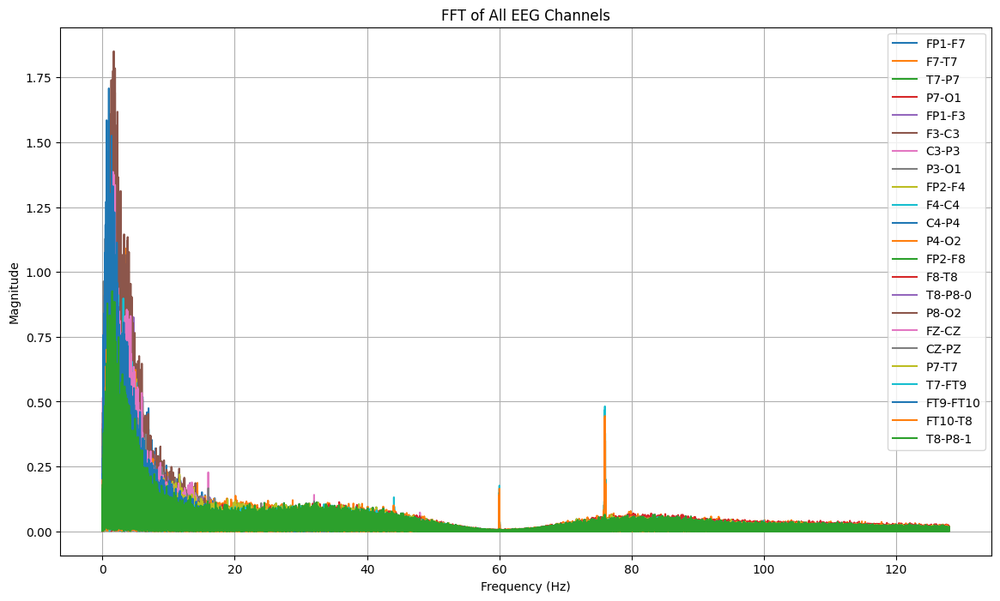

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df5[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_06.csv"
df5.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_06.csv


In [ ]:
#Import Data CSV
dataTA5 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_06.csv")
dataTA5


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.197558e-04,5.020757e-05,2.793651e-05,3.340659e-05,-1.127228e-04,5.665446e-06,5.372405e-05,4.512821e-05,1.894994e-05,1.387057e-05,...,-5.528694e-05,9.084249e-05,-2.148962e-06,6.974359e-05,-2.754579e-05,-9.162393e-05,1.850061e-04,-7.794872e-05,-5.528694e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-9.768010e-07,1.953602e-07,9.768010e-07,0.011719
4,1.953602e-07,1.367521e-06,-1.367521e-06,5.860806e-07,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.758242e-06,-2.930403e-06,1.367521e-06,5.860806e-07,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,7.208791e-05,1.240537e-04,-8.400488e-06,-2.557265e-04,4.043956e-05,4.102564e-06,-9.963370e-06,-1.021734e-04,-3.809524e-05,-3.770452e-05,...,-3.379731e-05,1.758242e-06,-3.496947e-05,-5.606838e-05,8.791209e-06,-1.135043e-04,-1.361661e-04,-4.551893e-05,-3.379731e-05,3599.980469
921596,7.052503e-05,1.068620e-04,-1.426129e-05,-2.463492e-04,4.043956e-05,-1.758242e-06,-3.301587e-05,-8.888889e-05,-4.434676e-05,-3.653236e-05,...,-2.989011e-05,-6.056166e-06,-3.848596e-05,-6.075702e-05,1.465201e-05,-1.095971e-04,-1.295238e-04,-3.184371e-05,-2.989011e-05,3599.984375
921597,6.700855e-05,9.279609e-05,-2.168498e-05,-2.357998e-04,4.083028e-05,-7.619048e-06,-5.450549e-05,-7.599512e-05,-3.848596e-05,-3.340659e-05,...,-2.715507e-05,-1.855922e-05,-4.083028e-05,-7.052503e-05,2.207570e-05,-9.631258e-05,-1.232723e-04,-2.520147e-05,-2.715507e-05,3599.988281
921598,6.192918e-05,7.521368e-05,-2.910867e-05,-2.174359e-04,4.004884e-05,-1.621490e-05,-7.365079e-05,-5.802198e-05,-3.301587e-05,-3.340659e-05,...,-2.207570e-05,-2.402930e-05,-3.926740e-05,-7.990232e-05,2.949939e-05,-6.427350e-05,-1.166300e-04,-4.043956e-05,-2.207570e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA5[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA5[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA5[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data5, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")



Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: F3-C3, Max Frequency: 1.71 Hz, Magnitude: 1.851268, Time: 506.011719 s
Channel: FT9-FT10, Max Frequency: 0.97 Hz, Magnitude: 1.708117, Time: 500.902344 s
Channel: F7-T7, Max Frequency: 1.34 Hz, Magnitude: 1.544761, Time: 518.628906 s
Channel: FP1-F3, Max Frequency: 1.27 Hz, Magnitude: 1.388824, Time: 482.476562 s
Channel: FZ-CZ, Max Frequency: 1.59 Hz, Magnitude: 1.385849, Time: 517.070312 s
Channel: FP1-F7, Max Frequency: 2.06 Hz, Magnitude: 1.281214, Time: 493.921875 s
Channel: P7-O1, Max Frequency: 0.93 Hz, Magnitude: 1.253924, Time: 495.101562 s
Channel: F4-C4, Max Frequency: 1.55 Hz, Magnitude: 1.236548, Time: 530.316406 s
Channel: P3-O1, Max Frequency: 1.60 Hz, Magnitude: 1.221586, Time: 2490.269531 s
Channel: FP2-F4, Max Frequency: 1.56 Hz, Magnitude: 1.211121, Time: 495.117188 s
Channel: F8-T8, Max Frequency: 1.55 Hz, Magnitude: 1.190038, Time: 487.542969 s
Channel: T7-FT9, Max Frequency: 0.

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-FT9, Max Frequency: 0.96 Hz, Magnitude: 1.039995, Time: 220.660156 s
Channel: FT10-T8, Max Frequency: 0.64 Hz, Magnitude: 0.700995, Time: 251.808594 s
Channel: CZ-PZ, Max Frequency: 1.75 Hz, Magnitude: 0.814548, Time: 480.941406 s
Channel: FP1-F3, Max Frequency: 1.27 Hz, Magnitude: 1.388824, Time: 482.476562 s
Channel: F8-T8, Max Frequency: 1.55 Hz, Magnitude: 1.190038, Time: 487.542969 s
Channel: FP2-F8, Max Frequency: 1.43 Hz, Magnitude: 0.900028, Time: 490.906250 s
Channel: FP1-F7, Max Frequency: 2.06 Hz, Magnitude: 1.281214, Time: 493.921875 s
Channel: P7-O1, Max Frequency: 0.93 Hz, Magnitude: 1.253924, Time: 495.101562 s
Channel: FP2-F4, Max Frequency: 1.56 Hz, Magnitude: 1.211121, Time: 495.117188 s
Channel: P8-O2, Max Frequency: 1.13 Hz, Magnitude: 0.906928, Time: 497.351562 s
Channel: FT9-FT10, Max Frequency: 0.97 Hz, Magnitude: 1.708117, Time: 500.902344 s
C

In [ ]:
# potong data (potong dulu datanya)
# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 360   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 650    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut5 = dataTA5.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut5.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_06.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA5 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb05_06.csv")
TA5.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000109,0.000037,-0.000089,0.000081,-0.000038,0.000035,-0.000223,0.000146,-0.000055,-0.000052,...,-0.000001,-9.768010e-07,0.000035,0.000007,0.000089,0.000073,0.000059,-0.000080,-0.000001,360.000000
1,-0.000137,0.000035,-0.000080,0.000071,-0.000076,0.000045,-0.000221,0.000142,-0.000103,-0.000028,...,0.000025,-9.768010e-07,0.000040,0.000012,0.000080,0.000061,0.000055,-0.000067,0.000025,360.003906
2,-0.000112,0.000033,-0.000068,0.000061,-0.000046,0.000046,-0.000217,0.000131,-0.000101,-0.000028,...,0.000036,-1.699634e-05,0.000036,0.000010,0.000068,0.000055,0.000056,-0.000057,0.000036,360.007812
3,-0.000093,0.000033,-0.000066,0.000058,-0.000037,0.000053,-0.000214,0.000129,-0.000096,-0.000041,...,0.000042,-1.738706e-05,0.000032,0.000008,0.000066,0.000065,0.000056,-0.000073,0.000042,360.011719
4,-0.000096,0.000035,-0.000073,0.000067,-0.000043,0.000059,-0.000215,0.000131,-0.000038,-0.000062,...,0.000038,-1.387057e-05,0.000028,0.000008,0.000074,0.000060,0.000058,-0.000069,0.000038,360.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA5.shape

(74240, 24)

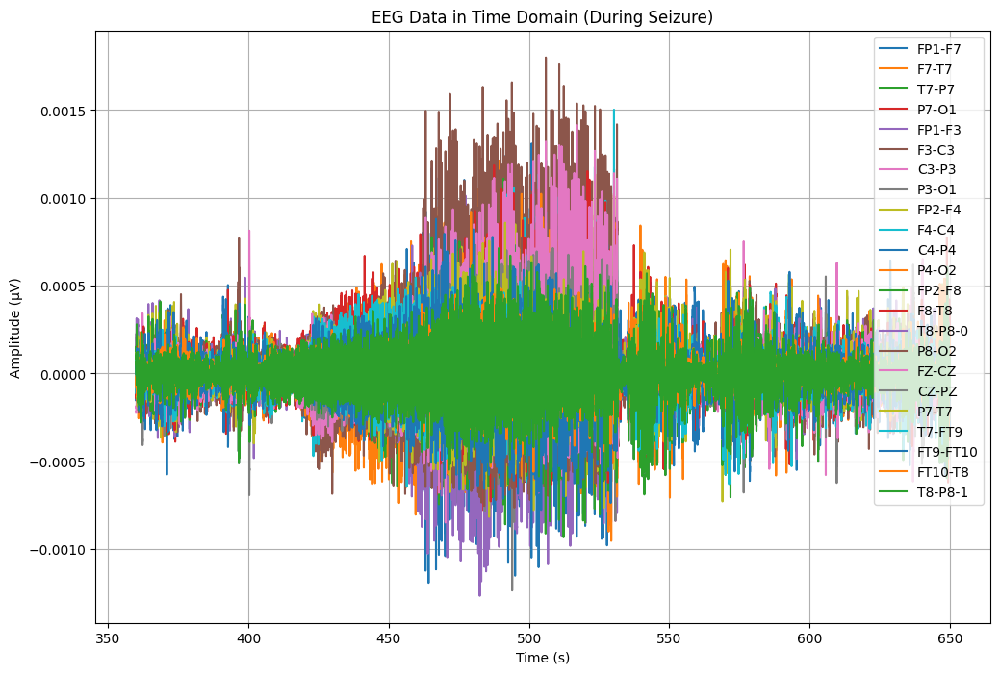

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA5['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA5.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA5[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


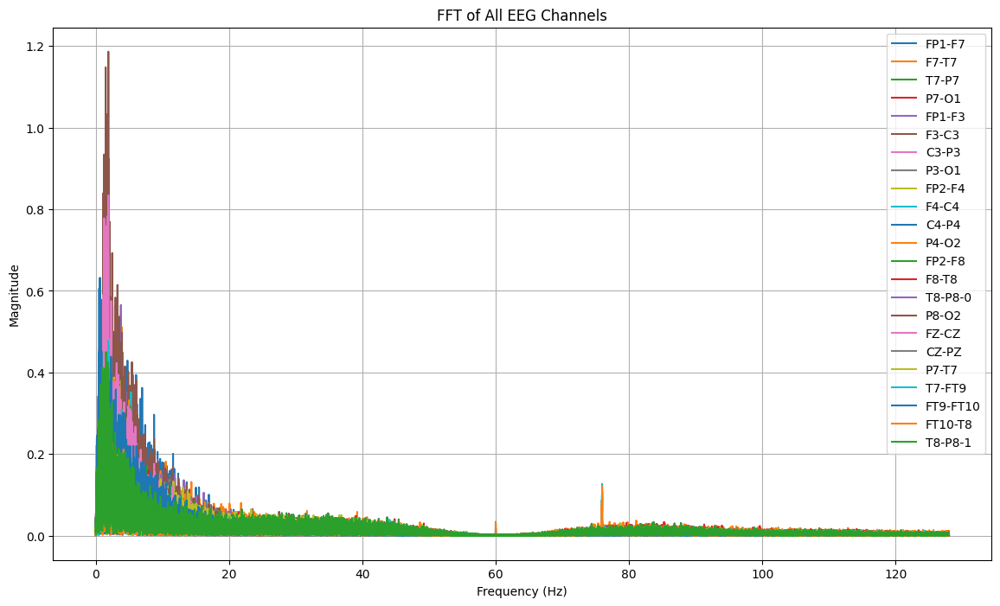

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA5[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 480:
        return "tidak kejang"
    elif 480 <= row['Time'] < 530:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_5 = TA5.copy()
TA_5['seizure'] = TA_5.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_5[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1    FP1-F3  \
0  360.000000  tidak kejang -0.000109  0.000037 -0.000089  0.000081 -0.000038   
1  360.003906  tidak kejang -0.000137  0.000035 -0.000080  0.000071 -0.000076   
2  360.007812  tidak kejang -0.000112  0.000033 -0.000068  0.000061 -0.000046   
3  360.011719  tidak kejang -0.000093  0.000033 -0.000066  0.000058 -0.000037   
4  360.015625  tidak kejang -0.000096  0.000035 -0.000073  0.000067 -0.000043   

      F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0         P8-O2  \
0  0.000035 -0.000223  0.000146  ... -0.000127 -0.000001 -9.768010e-07   
1  0.000045 -0.000221  0.000142  ... -0.000134  0.000025 -9.768010e-07   
2  0.000046 -0.000217  0.000131  ... -0.000138  0.000036 -1.699634e-05   
3  0.000053 -0.000214  0.000129  ... -0.000141  0.000042 -1.738706e-05   
4  0.000059 -0.000215  0.000131  ... -0.000133  0.000038 -1.387057e-05   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_5['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,12800


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_5)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 290.0 detik


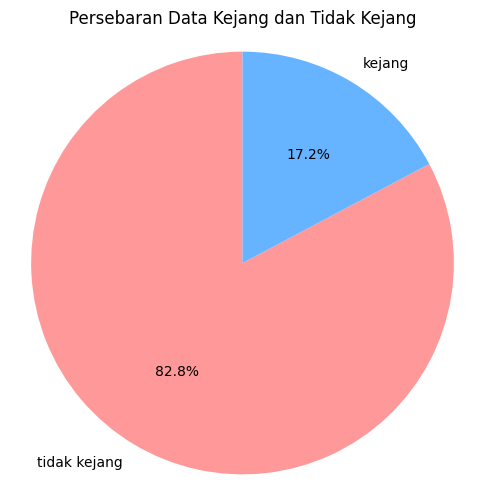

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_5['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_5.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb05_06.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_5.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_5['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.97      0.95      0.96      2627
tidak kejang       0.99      0.99      0.99     12221

    accuracy                           0.99     14848
   macro avg       0.98      0.97      0.98     14848
weighted avg       0.99      0.99      0.99     14848

Akurasi: 0.9861260775862069
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.95      0.96      2627
tidak kejang       0.99      0.99      0.99     12221

    accuracy                           0.99     14848
   macro avg       0.98      0.97      0.98     14848
weighted avg       0.99      0.99      0.99     14848



# DATA 6 (chb06_10)
akurasi = 0,992

In [ ]:
# mengimport file edf
file6 = "/content/drive/MyDrive/TA/EDF/chb06_10.edf"
data6 = mne.io.read_raw_edf(file6) # membaca file edf dan menyimpannya di data
data6


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb06_10.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-3-e16f8f818471>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data6 = mne.io.read_raw_edf(file6) # membaca file edf dan menyimpannya di data


<RawEDF | chb06_10.edf, 23 x 3686400 (14400.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data6.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data6.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data6.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df6 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df6['Time'] = times  # Menambahkan kolom waktu
df6.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,5.333333e-05,2.539683e-06,5.274725e-06,2.754579e-05,-1.699634e-05,-6.446886e-06,3.887668e-05,7.326007e-05,-5.919414e-05,3.926740e-05,...,2.715507e-05,7.013431e-05,6.153846e-05,-9.787546e-05,-4.884005e-06,-1.113553e-05,-4.884005e-06,2.871795e-05,2.715507e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df6.shape)


(3686400, 24)


In [ ]:
# mendeskripsikan data
df6.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,...,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06
mean,2.177902e-07,2.304980e-07,1.831127e-07,1.854063e-07,2.922597e-07,2.243006e-07,1.440230e-07,1.568455e-07,2.736039e-07,2.066875e-07,...,1.832110e-07,1.766770e-07,2.297887e-07,1.157398e-07,2.076077e-07,1.480963e-07,1.954944e-07,2.294747e-07,1.832110e-07,7.199998e+03
std,5.137024e-05,7.078004e-05,5.422062e-05,6.788501e-05,8.852750e-05,9.055230e-05,7.984368e-05,8.136705e-05,8.531657e-05,9.256136e-05,...,7.428337e-05,6.623201e-05,1.044323e-04,1.029191e-04,5.422062e-05,6.947164e-05,5.500093e-05,5.369829e-05,7.428337e-05,4.156923e+03
min,-1.473602e-03,-1.170012e-03,-7.507692e-04,-1.065299e-03,-1.360684e-03,-1.073895e-03,-8.175824e-04,-1.056703e-03,-1.075458e-03,-1.408742e-03,...,-1.022711e-03,-8.468864e-04,-1.029353e-03,-9.766056e-04,-1.038339e-03,-1.408352e-03,-1.272772e-03,-1.349744e-03,-1.022711e-03,0.000000e+00
25%,-2.402930e-05,-3.575092e-05,-2.989011e-05,-3.809524e-05,-4.200244e-05,-4.395604e-05,-3.926740e-05,-3.848596e-05,-4.122100e-05,-4.747253e-05,...,-4.317460e-05,-3.614164e-05,-5.177045e-05,-5.059829e-05,-2.949939e-05,-3.106227e-05,-2.715507e-05,-2.715507e-05,-4.317460e-05,3.599999e+03
50%,-1.953602e-07,-9.768010e-07,1.953602e-07,1.953602e-07,-3.321123e-06,-5.860806e-07,1.758242e-06,1.367521e-06,-2.539683e-06,-1.953602e-07,...,1.953602e-07,5.860806e-07,-9.768010e-07,4.102564e-06,1.953602e-07,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,7.199998e+03
75%,2.324786e-05,3.379731e-05,2.989011e-05,3.926740e-05,3.536020e-05,4.122100e-05,4.200244e-05,4.200244e-05,3.575092e-05,4.747253e-05,...,4.356532e-05,3.731380e-05,4.864469e-05,5.606838e-05,3.028083e-05,3.457875e-05,2.754579e-05,2.637363e-05,4.356532e-05,1.080000e+04
max,1.565812e-03,1.596288e-03,1.038730e-03,9.492552e-04,1.585348e-03,1.077021e-03,6.913797e-04,8.519658e-04,1.186422e-03,1.141880e-03,...,1.216899e-03,1.009035e-03,1.200879e-03,9.617582e-04,7.511600e-04,1.239560e-03,1.565031e-03,1.223932e-03,1.216899e-03,1.440000e+04


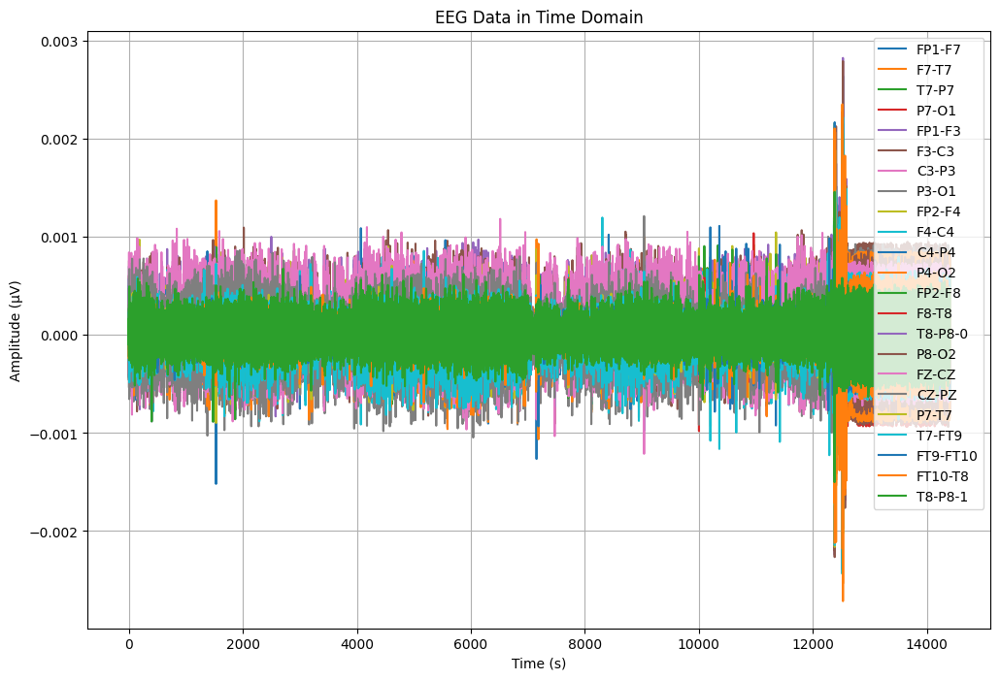

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df6['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df6[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


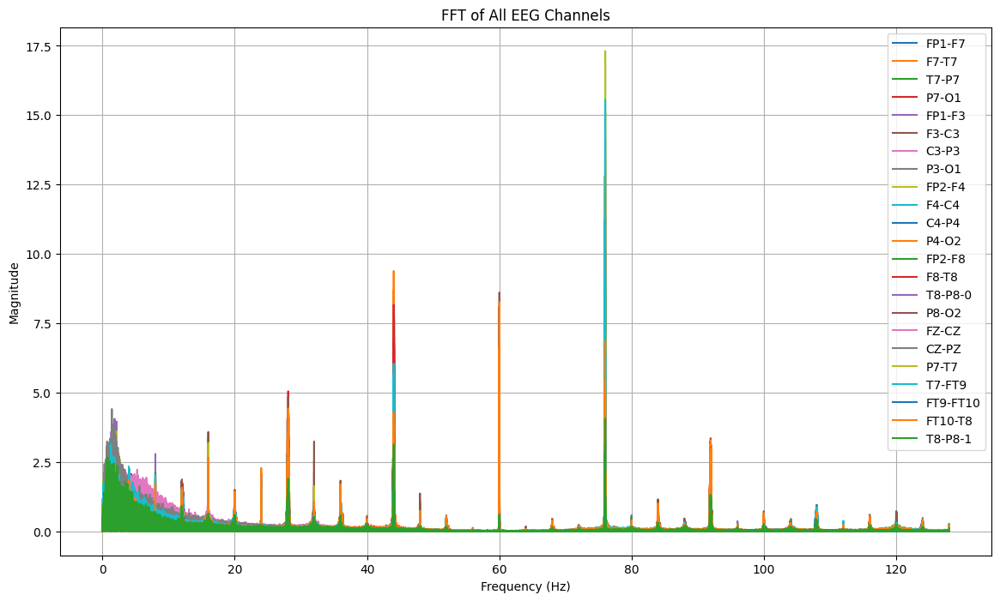

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df6[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb06_10.csv"
df6.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb06_10.csv


In [ ]:
#Import Data CSV
dataTA6 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb06_10.csv")
dataTA6


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,5.333333e-05,2.539683e-06,5.274725e-06,2.754579e-05,-1.699634e-05,-6.446886e-06,3.887668e-05,7.326007e-05,-5.919414e-05,3.926740e-05,...,2.715507e-05,7.013431e-05,6.153846e-05,-9.787546e-05,-4.884005e-06,-1.113553e-05,-4.884005e-06,2.871795e-05,2.715507e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3686395,4.077167e-04,-4.514774e-04,-1.416361e-04,4.823443e-04,3.127717e-04,-2.756532e-04,4.034188e-04,-1.431990e-04,-4.493284e-06,3.457875e-05,...,-7.560440e-05,3.702076e-04,-7.951160e-05,5.177045e-05,1.420269e-04,4.624176e-04,3.067155e-05,-4.221734e-04,-7.560440e-05,14399.980469
3686396,3.158974e-04,-4.803907e-04,3.553602e-04,6.661783e-05,2.736996e-04,-3.770452e-05,1.076435e-04,-8.459096e-05,1.381197e-04,1.521856e-04,...,-1.072527e-04,-1.431990e-04,-8.927961e-05,2.064957e-04,-3.549695e-04,4.971917e-04,7.228327e-06,1.705495e-04,-1.072527e-04,14399.984375
3686397,-2.182173e-04,1.670330e-04,-3.010501e-04,2.006349e-04,-1.306960e-04,-2.526007e-04,1.607814e-04,6.974359e-05,5.098901e-05,-1.582418e-05,...,2.871795e-05,-2.107937e-04,-7.169719e-05,4.942613e-05,3.014408e-04,-2.924542e-04,9.904762e-05,2.037607e-04,2.871795e-05,14399.988281
3686398,-3.299634e-04,2.795604e-04,-3.514530e-04,1.092063e-04,-2.690110e-04,-1.365568e-04,8.107448e-05,3.028083e-05,8.615385e-05,-1.986813e-04,...,7.013431e-05,3.049573e-04,1.650794e-04,3.106227e-05,3.518437e-04,-3.409035e-04,5.177045e-05,-3.729426e-04,7.013431e-05,14399.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA6[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA6[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA6[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data6, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: T7-P7, Max Frequency: 76.00 Hz, Magnitude: 17.305286, Time: 12384.261719 s
Channel: P7-T7, Max Frequency: 76.00 Hz, Magnitude: 17.305286, Time: 12384.261719 s
Channel: T7-FT9, Max Frequency: 76.00 Hz, Magnitude: 15.551406, Time: 12517.214844 s
Channel: FP2-F8, Max Frequency: 76.00 Hz, Magnitude: 15.079295, Time: 12528.371094 s
Channel: C4-P4, Max Frequency: 76.00 Hz, Magnitude: 14.143085, Time: 12517.214844 s
Channel: P4-O2, Max Frequency: 76.00 Hz, Magnitude: 13.568232, Time: 12377.898438 s
Channel: P8-O2, Max Frequency: 76.00 Hz, Magnitude: 13.047494, Time: 12528.375000 s
Channel: F7-T7, Max Frequency: 76.00 Hz, Magnitude: 12.681564, Time: 12528.375000 s
Channel: P7-O1, Max Frequency: 76.00 Hz, Magnitude: 11.268040, Time: 12381.484375 s
Channel: FP1-F7, Max Frequency: 76.00 Hz, Magnitude: 10.717302, Time: 12528.375000 s
Channel: F3-C3, Max Frequency: 76.00 Hz, Magnitude: 10.144295, Time: 12381.968

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FZ-CZ, Max Frequency: 76.00 Hz, Magnitude: 7.498243, Time: 9039.214844 s
Channel: P4-O2, Max Frequency: 76.00 Hz, Magnitude: 13.568232, Time: 12377.898438 s
Channel: T8-P8-0, Max Frequency: 76.00 Hz, Magnitude: 4.054414, Time: 12380.960938 s
Channel: T8-P8-1, Max Frequency: 76.00 Hz, Magnitude: 4.054414, Time: 12380.960938 s
Channel: P3-O1, Max Frequency: 76.00 Hz, Magnitude: 5.091422, Time: 12381.203125 s
Channel: CZ-PZ, Max Frequency: 1.42 Hz, Magnitude: 4.408959, Time: 12381.339844 s
Channel: FP2-F4, Max Frequency: 1.53 Hz, Magnitude: 3.736439, Time: 12381.402344 s
Channel: C3-P3, Max Frequency: 76.00 Hz, Magnitude: 5.131459, Time: 12381.425781 s
Channel: P7-O1, Max Frequency: 76.00 Hz, Magnitude: 11.268040, Time: 12381.484375 s
Channel: F3-C3, Max Frequency: 76.00 Hz, Magnitude: 10.144295, Time: 12381.968750 s
Channel: F4-C4, Max Frequency: 1.64 Hz, Magnitude: 3.505

In [ ]:
# potong data (potong dulu datanya)

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 12257   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 12504    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut6 = dataTA6.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut6.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb06_10.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA6 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb06_10.csv")
TA6.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000064,-0.000053,0.000060,0.000039,-0.000136,-2.930403e-06,0.000053,0.000067,-0.000235,0.000049,...,0.000031,0.000101,0.000040,0.000102,-0.000060,0.000071,-0.000061,-0.000033,0.000031,12257.000000
1,-0.000065,-0.000039,0.000047,0.000030,-0.000134,2.539683e-06,0.000037,0.000067,-0.000239,0.000065,...,0.000016,0.000108,0.000058,0.000071,-0.000047,0.000058,-0.000064,-0.000025,0.000016,12257.003906
2,-0.000067,-0.000022,0.000037,0.000009,-0.000129,2.148962e-06,0.000022,0.000062,-0.000234,0.000078,...,-0.000002,0.000108,0.000073,0.000038,-0.000037,0.000037,-0.000060,-0.000019,-0.000002,12257.007812
3,-0.000075,-0.000002,0.000011,-0.000004,-0.000128,1.953602e-07,0.000006,0.000051,-0.000229,0.000095,...,-0.000020,0.000102,0.000090,0.000005,-0.000010,0.000015,-0.000056,-0.000014,-0.000020,12257.011719
4,-0.000081,0.000009,-0.000016,-0.000009,-0.000129,-1.367521e-06,-0.000013,0.000046,-0.000224,0.000110,...,-0.000045,0.000101,0.000108,-0.000031,0.000016,0.000005,-0.000058,-0.000007,-0.000045,12257.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA6.shape


(63232, 24)

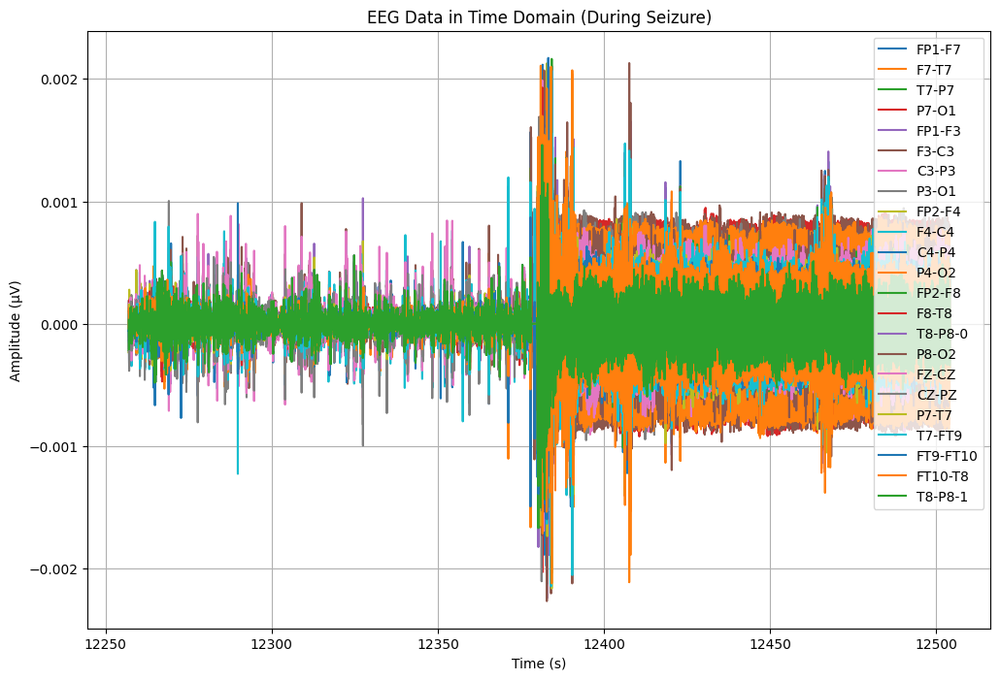

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA6['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA6.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA6[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


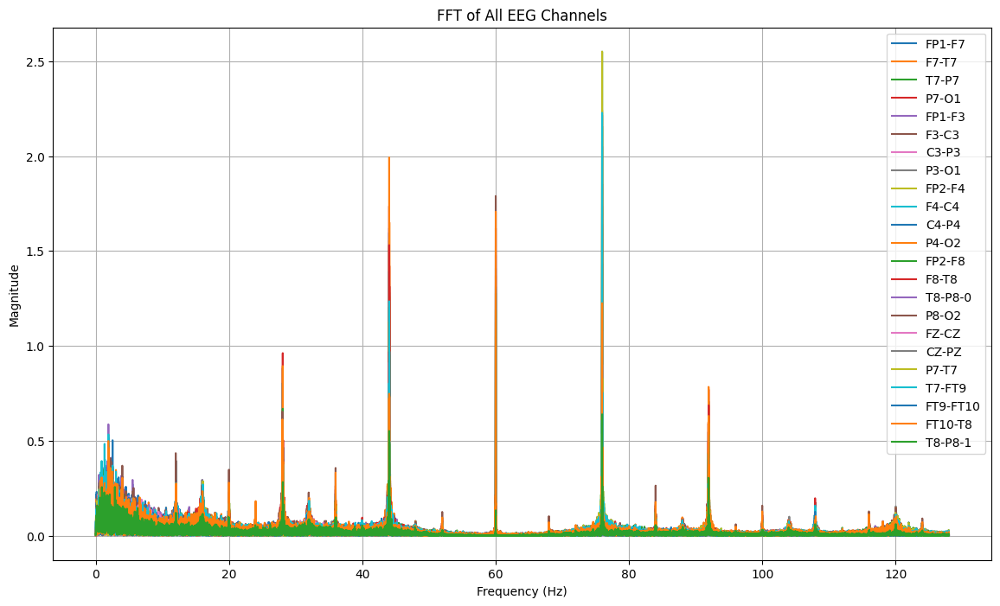

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA6[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 12377:
        return "tidak kejang"
    elif 12377 <= row['Time'] < 12384:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_6 = TA6.copy()
TA_6['seizure'] = TA_6.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_6[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


           Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  12257.000000  tidak kejang -0.000064 -0.000053  0.000060  0.000039   
1  12257.003906  tidak kejang -0.000065 -0.000039  0.000047  0.000030   
2  12257.007812  tidak kejang -0.000067 -0.000022  0.000037  0.000009   
3  12257.011719  tidak kejang -0.000075 -0.000002  0.000011 -0.000004   
4  12257.015625  tidak kejang -0.000081  0.000009 -0.000016 -0.000009   

     FP1-F3         F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000136 -2.930403e-06  0.000053  0.000067  ...  0.000040  0.000031   
1 -0.000134  2.539683e-06  0.000037  0.000067  ...  0.000049  0.000016   
2 -0.000129  2.148962e-06  0.000022  0.000062  ...  0.000055 -0.000002   
3 -0.000128  1.953602e-07  0.000006  0.000051  ...  0.000060 -0.000020   
4 -0.000129 -1.367521e-06 -0.000013  0.000046  ...  0.000068 -0.000045   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0  0.000101  0.000040  0.000102 -0.000060

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_6['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,1792


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_6)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 247.0 detik


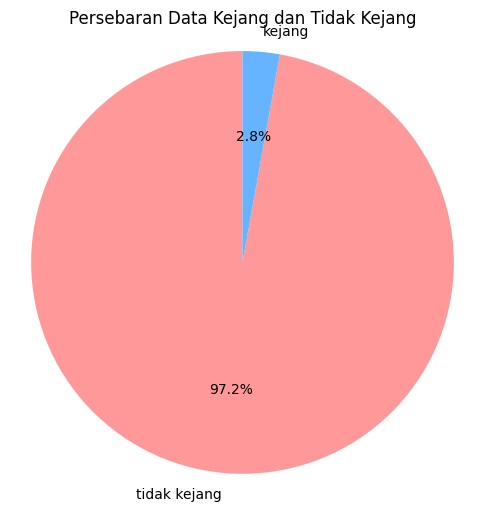

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_6['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_6.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb06_10.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_6.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_6['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.98      0.76      0.86       388
tidak kejang       0.99      1.00      1.00     12259

    accuracy                           0.99     12647
   macro avg       0.99      0.88      0.93     12647
weighted avg       0.99      0.99      0.99     12647

Akurasi: 0.9922511267494267
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.76      0.86       388
tidak kejang       0.99      1.00      1.00     12259

    accuracy                           0.99     12647
   macro avg       0.99      0.88      0.93     12647
weighted avg       0.99      0.99      0.99     12647



# DATA 7 (chb01_04)
akurasi = 0.979

In [ ]:
# mengimport file edf
file14 = "/content/drive/MyDrive/TA/EDF/chb01_04.edf"
data14 = mne.io.read_raw_edf(file14) # membaca file edf dan menyimpannya di data
data14


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-3-be135fe16ab0>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data14 = mne.io.read_raw_edf(file14) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_04.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data14.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data14.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data14.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df14 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df14['Time'] = times  # Menambahkan kolom waktu
df14.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,9.318681e-05,5.724054e-05,-7.794872e-05,-2.539683e-06,7.833944e-05,2.051282e-05,-1.543346e-05,-1.347985e-05,8.420024e-05,1.816850e-05,...,-2.930403e-06,4.434676e-05,-3.028083e-05,5.880342e-05,7.833944e-05,-1.816850e-05,-5.684982e-05,-1.543346e-05,-2.930403e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,9.768010e-07,-9.768010e-07,9.768010e-07,1.953602e-07,...,-1.953602e-07,3.321123e-06,1.953602e-07,9.768010e-07,1.953602e-07,2.148962e-06,-5.860806e-07,-1.953602e-07,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df14.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df14.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.755783e-07,1.818995e-07,2.024013e-07,2.087170e-07,1.891615e-07,1.691472e-07,2.055577e-07,2.034612e-07,2.072951e-07,1.842766e-07,...,1.800481e-07,1.976118e-07,1.851174e-07,2.034112e-07,1.883191e-07,1.949799e-07,2.437063e-07,2.048764e-07,1.800481e-07,1799.998047
std,3.688918e-05,2.816281e-05,2.539512e-05,2.382374e-05,4.107482e-05,3.417111e-05,2.412722e-05,2.873010e-05,3.915086e-05,3.500844e-05,...,3.417669e-05,4.492561e-05,3.829465e-05,3.631725e-05,2.539512e-05,2.252803e-05,4.896572e-05,2.855657e-05,3.417669e-05,1039.231048
min,-5.108669e-04,-4.968010e-04,-3.315263e-04,-3.682540e-04,-6.655922e-04,-3.323077e-04,-2.123565e-04,-2.678388e-04,-4.327228e-04,-4.710134e-04,...,-5.010989e-04,-1.285665e-03,-4.932845e-04,-3.291819e-04,-4.456166e-04,-4.889866e-04,-9.172161e-04,-5.616606e-04,-5.010989e-04,0.000000
25%,-1.387057e-05,-1.308913e-05,-1.387057e-05,-1.308913e-05,-1.816850e-05,-1.738706e-05,-1.347985e-05,-1.660562e-05,-1.777778e-05,-1.660562e-05,...,-1.699634e-05,-2.246642e-05,-1.816850e-05,-1.973138e-05,-1.347985e-05,-1.191697e-05,-2.129426e-05,-1.191697e-05,-1.699634e-05,899.999023
50%,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.465201e-05,1.387057e-05,1.387057e-05,1.347985e-05,1.816850e-05,1.855922e-05,1.347985e-05,1.660562e-05,1.699634e-05,1.738706e-05,...,1.777778e-05,2.285714e-05,1.934066e-05,1.934066e-05,1.426129e-05,1.308913e-05,2.090354e-05,1.191697e-05,1.777778e-05,2699.997070
max,8.390720e-04,5.151648e-04,4.460073e-04,2.268132e-04,6.734066e-04,2.725275e-04,3.791941e-04,2.154823e-04,5.319658e-04,4.514774e-04,...,5.968254e-04,6.941148e-04,3.330891e-04,3.799756e-04,3.319170e-04,5.538462e-04,8.273504e-04,9.363614e-04,5.968254e-04,3599.996094


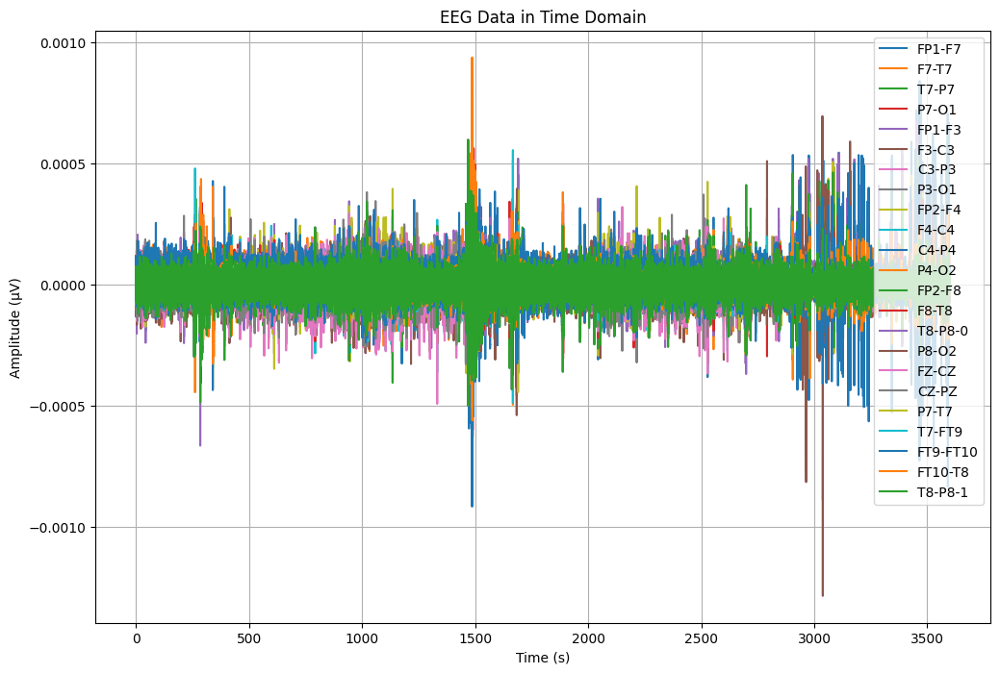

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df14['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df14[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


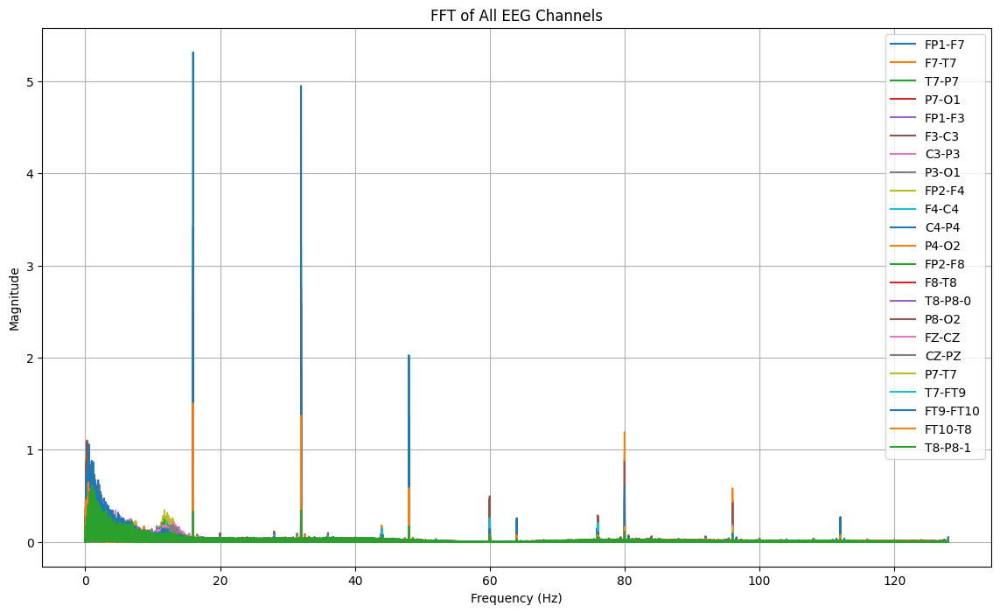

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df14[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_04.csv"
df14.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_04.csv


In [ ]:
#Import Data CSV
dataTA14 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_04.csv")
dataTA14


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,9.318681e-05,5.724054e-05,-7.794872e-05,-2.539683e-06,7.833944e-05,2.051282e-05,-1.543346e-05,-1.347985e-05,8.420024e-05,1.816850e-05,...,-2.930403e-06,4.434676e-05,-3.028083e-05,5.880342e-05,7.833944e-05,-1.816850e-05,-5.684982e-05,-1.543346e-05,-2.930403e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,9.768010e-07,-9.768010e-07,9.768010e-07,1.953602e-07,...,-1.953602e-07,3.321123e-06,1.953602e-07,9.768010e-07,1.953602e-07,2.148962e-06,-5.860806e-07,-1.953602e-07,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.894994e-05,-1.367521e-06,-1.758242e-06,1.230769e-05,-9.572650e-06,-1.035409e-05,4.884005e-06,5.274725e-06,-1.621490e-05,2.637363e-05,...,5.860806e-07,3.321123e-06,1.973138e-05,-1.758242e-06,2.148962e-06,-1.035409e-05,2.754579e-05,4.493284e-06,5.860806e-07,3599.980469
921596,-1.387057e-05,-9.768010e-07,-3.321123e-06,2.148962e-06,-7.228327e-06,-7.228327e-06,5.665446e-06,-6.446886e-06,-8.791209e-06,2.598291e-05,...,1.758242e-06,3.321123e-06,1.855922e-05,1.367521e-06,3.711844e-06,-3.711844e-06,1.543346e-05,5.274725e-06,1.758242e-06,3599.984375
921597,-2.930403e-06,-1.953602e-07,-9.963370e-06,2.148962e-06,-2.930403e-06,-5.860806e-07,5.860806e-07,-8.400488e-06,-2.148962e-06,2.207570e-05,...,4.884005e-06,1.953602e-07,1.543346e-05,-1.367521e-06,1.035409e-05,5.860806e-07,-9.572650e-06,6.446886e-06,4.884005e-06,3599.988281
921598,4.493284e-06,1.367521e-06,-1.152625e-05,-9.768010e-07,-1.367521e-06,6.056166e-06,-1.758242e-06,-9.181929e-06,-1.953602e-07,2.051282e-05,...,6.837607e-06,-6.837607e-06,1.543346e-05,1.953602e-07,1.191697e-05,9.768010e-07,-2.442002e-05,9.963370e-06,6.837607e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA14[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA14[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA14[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data14, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")



Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 5.314103, Time: 1486.300781 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 3.429051, Time: 1666.906250 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 2.983072, Time: 1486.621094 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 2.807857, Time: 1474.886719 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 2.719783, Time: 1484.769531 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 2.599424, Time: 3038.003906 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 2.182354, Time: 1468.871094 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.998998, Time: 3465.816406 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 1.972107, Time: 3452.851562 s
Channel: P4-O2, Max Frequency: 32.00 Hz, Magnitude: 1.919343, Time: 3038.003906 s
Channel: P7-O1, Max Frequency: 32.00 Hz, Magnitude: 1.759863, Time: 1689.507812 s
Channel: FP2-

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 1.473278, Time: 283.757812 s
Channel: CZ-PZ, Max Frequency: 1.04 Hz, Magnitude: 0.685250, Time: 1020.804688 s
Channel: FZ-CZ, Max Frequency: 32.00 Hz, Magnitude: 0.786043, Time: 1331.996094 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 2.182354, Time: 1468.871094 s
Channel: T8-P8-0, Max Frequency: 1.01 Hz, Magnitude: 0.609284, Time: 1468.910156 s
Channel: T8-P8-1, Max Frequency: 1.01 Hz, Magnitude: 0.609284, Time: 1468.910156 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 2.807857, Time: 1474.886719 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 2.719783, Time: 1484.769531 s
Channel: F4-C4, Max Frequency: 16.00 Hz, Magnitude: 0.767657, Time: 1485.937500 s
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 5.314103, Time: 1486.300781 s
Channel: FT10-T8, Max Frequency: 16.00 Hz, Magnitude: 1.503549, Time

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1348   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1606    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut14 = dataTA14.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut14.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_04.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA14 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_04.csv")
TA14.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000039,0.000008,0.000022,-3.711844e-06,0.000068,0.000008,0.000011,-0.000021,0.000014,0.000035,...,0.000038,0.000057,1.758242e-06,0.000030,-0.000021,-0.000015,0.000026,-0.000010,0.000038,1348.000000
1,0.000036,0.000004,0.000026,-1.758242e-06,0.000068,0.000001,0.000016,-0.000021,0.000015,0.000035,...,0.000035,0.000063,2.930403e-06,0.000032,-0.000026,-0.000007,0.000030,-0.000011,0.000035,1348.003906
2,0.000033,0.000005,0.000021,-2.148962e-06,0.000065,-0.000002,0.000015,-0.000019,0.000013,0.000029,...,0.000033,0.000043,-1.953602e-07,0.000031,-0.000021,-0.000013,0.000036,-0.000010,0.000033,1348.007812
3,0.000032,0.000004,0.000018,-1.367521e-06,0.000062,-0.000004,0.000011,-0.000015,0.000014,0.000024,...,0.000030,0.000033,-4.884005e-06,0.000031,-0.000017,-0.000017,0.000040,-0.000010,0.000030,1348.011719
4,0.000032,-0.000003,0.000017,9.768010e-07,0.000062,-0.000013,0.000015,-0.000015,0.000017,0.000021,...,0.000023,0.000047,-5.274725e-06,0.000036,-0.000016,-0.000003,0.000036,-0.000013,0.000023,1348.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA14.shape


(66048, 24)

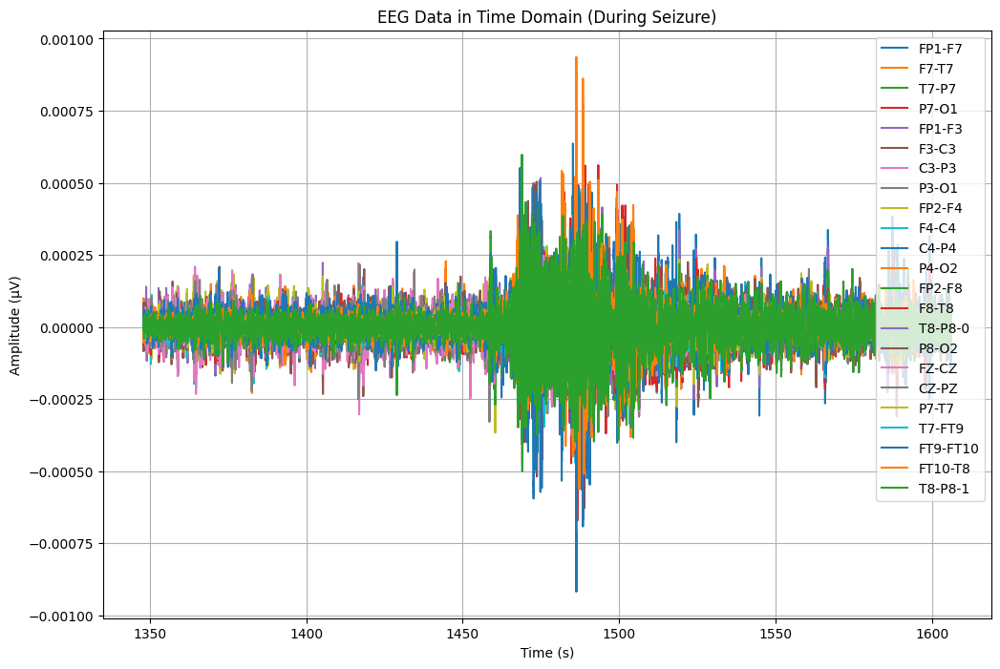

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA14['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA14.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA14[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


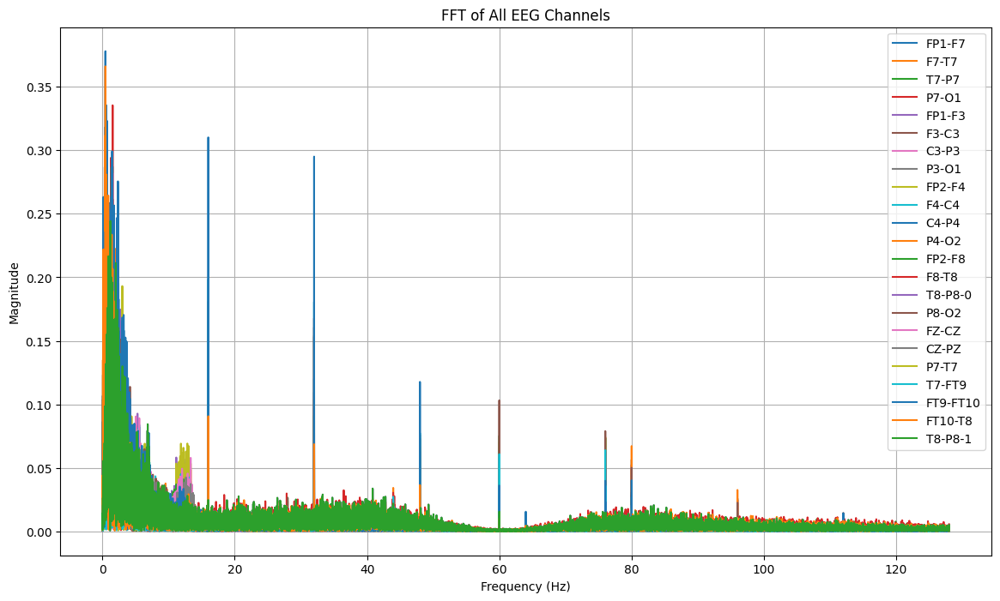

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA14[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1468:
        return "tidak kejang"
    elif 1468 <= row['Time'] < 1486:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_14 = TA14.copy()
TA_14['seizure'] = TA_14.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_14[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7         P7-O1  \
0  1348.000000  tidak kejang  0.000039  0.000008  0.000022 -3.711844e-06   
1  1348.003906  tidak kejang  0.000036  0.000004  0.000026 -1.758242e-06   
2  1348.007812  tidak kejang  0.000033  0.000005  0.000021 -2.148962e-06   
3  1348.011719  tidak kejang  0.000032  0.000004  0.000018 -1.367521e-06   
4  1348.015625  tidak kejang  0.000032 -0.000003  0.000017  9.768010e-07   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000068  0.000008  0.000011 -0.000021  ... -0.000009  0.000038  0.000057   
1  0.000068  0.000001  0.000016 -0.000021  ... -0.000013  0.000035  0.000063   
2  0.000065 -0.000002  0.000015 -0.000019  ... -0.000004  0.000033  0.000043   
3  0.000062 -0.000004  0.000011 -0.000015  ...  0.000002  0.000030  0.000033   
4  0.000062 -0.000013  0.000015 -0.000015  ... -0.000011  0.000023  0.000047   

          FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_14['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,4608


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_14)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 258.0 detik


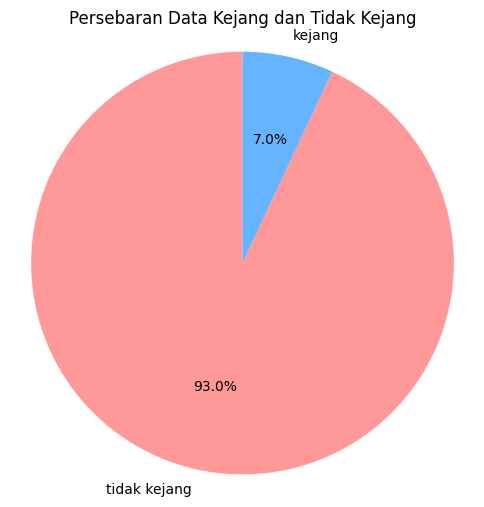

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_14['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_14.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb01_04.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_14.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_14['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.99      0.72      0.83       938
tidak kejang       0.98      1.00      0.99     12272

    accuracy                           0.98     13210
   macro avg       0.98      0.86      0.91     13210
weighted avg       0.98      0.98      0.98     13210

Akurasi: 0.979560938682816
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.72      0.83       938
tidak kejang       0.98      1.00      0.99     12272

    accuracy                           0.98     13210
   macro avg       0.98      0.86      0.91     13210
weighted avg       0.98      0.98      0.98     13210



# DATA 8 (chb01_15)
akurasi = 0.985

In [ ]:
# mengimport file edf
file15 = "/content/drive/MyDrive/TA/EDF/chb01_15.edf"
data15 = mne.io.read_raw_edf(file15) # membaca file edf dan menyimpannya di data
data15


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_15.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-39-e74d1e0c8ed7>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data15 = mne.io.read_raw_edf(file15) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_15.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data15.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data15.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data15.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df15 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df15['Time'] = times  # Menambahkan kolom waktu
df15.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.457875e-05,-7.951160e-05,1.010012e-04,2.623687e-04,1.191697e-05,1.426129e-05,1.119414e-04,1.803175e-04,-5.665446e-06,6.349206e-05,...,7.365079e-05,7.163858e-04,7.443223e-05,1.932112e-04,-1.006105e-04,3.350427e-04,-2.170452e-04,3.321123e-06,7.365079e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,6.056166e-06,1.953602e-07,5.860806e-07,1.953602e-07,1.367521e-06,1.953602e-07,-1.758242e-06,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df15.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df15.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.684732e-07,1.814166e-07,2.066299e-07,1.951575e-07,1.863278e-07,1.805653e-07,2.115325e-07,1.965011e-07,1.923637e-07,1.826253e-07,...,1.896397e-07,1.677083e-07,1.764372e-07,2.086924e-07,1.840905e-07,1.663758e-07,2.318681e-07,2.089625e-07,1.896397e-07,1799.998047
std,4.321249e-05,3.708270e-05,4.448748e-05,4.502868e-05,5.276279e-05,5.288570e-05,4.422320e-05,5.724097e-05,5.184163e-05,5.643165e-05,...,5.422112e-05,6.109327e-05,6.658366e-05,6.530754e-05,4.448748e-05,3.510210e-05,5.435756e-05,3.199263e-05,5.422112e-05,1039.231048
min,-4.631990e-04,-4.526496e-04,-3.338706e-04,-3.338706e-04,-4.100611e-04,-3.467643e-04,-3.291819e-04,-4.092796e-04,-4.557753e-04,-5.061783e-04,...,-6.929426e-04,-6.069841e-04,-5.557998e-04,-7.355311e-04,-3.514530e-04,-6.945055e-04,-7.120879e-04,-3.995116e-04,-6.929426e-04,0.000000
25%,-1.894994e-05,-1.816850e-05,-2.207570e-05,-2.285714e-05,-2.598291e-05,-2.520147e-05,-2.285714e-05,-2.871795e-05,-2.559219e-05,-2.715507e-05,...,-2.715507e-05,-3.301587e-05,-3.184371e-05,-3.379731e-05,-2.129426e-05,-1.621490e-05,-2.598291e-05,-1.660562e-05,-2.715507e-05,899.999023
50%,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1799.998047
75%,2.051282e-05,1.894994e-05,2.168498e-05,2.285714e-05,2.598291e-05,2.637363e-05,2.207570e-05,2.871795e-05,2.559219e-05,2.793651e-05,...,2.754579e-05,3.301587e-05,3.301587e-05,3.262515e-05,2.246642e-05,1.699634e-05,2.520147e-05,1.660562e-05,2.754579e-05,2699.997070
max,3.803663e-04,3.561416e-04,3.518437e-04,3.096459e-04,4.147497e-04,3.936508e-04,3.873993e-04,4.198291e-04,4.534310e-04,4.928938e-04,...,3.967766e-04,7.163858e-04,4.874237e-04,6.284737e-04,3.342613e-04,6.241758e-04,8.703297e-04,4.549939e-04,3.967766e-04,3599.996094


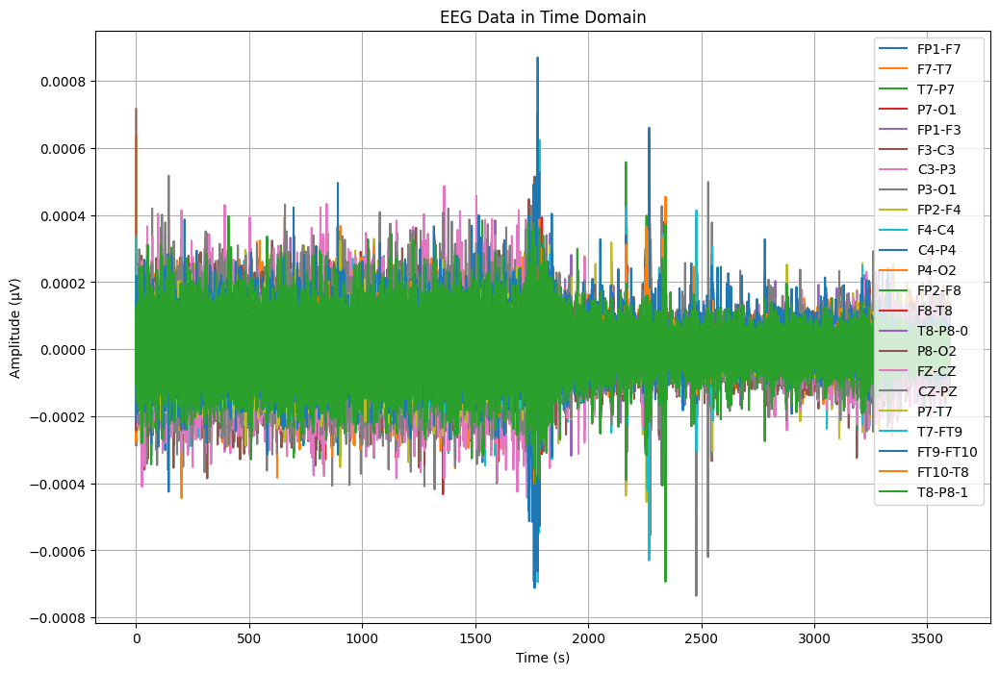

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df15['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df15[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


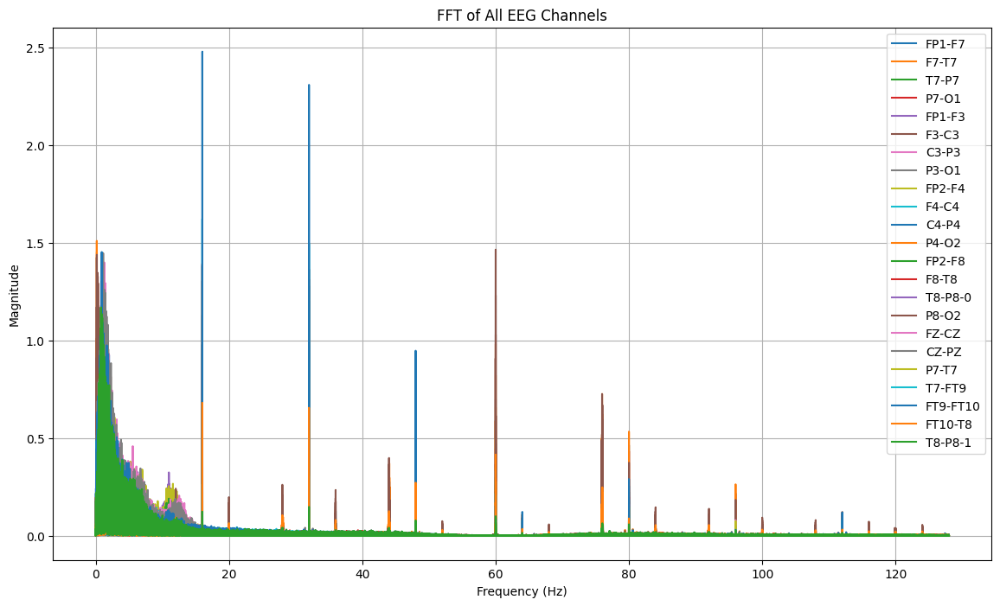

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df15[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_15.csv"
df15.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_15.csv


In [ ]:
#Import Data CSV
dataTA15 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_15.csv")
dataTA15


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.457875e-05,-7.951160e-05,1.010012e-04,2.623687e-04,1.191697e-05,1.426129e-05,1.119414e-04,1.803175e-04,-5.665446e-06,6.349206e-05,...,7.365079e-05,7.163858e-04,7.443223e-05,1.932112e-04,-1.006105e-04,3.350427e-04,-2.170452e-04,3.321123e-06,7.365079e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,6.056166e-06,1.953602e-07,5.860806e-07,1.953602e-07,1.367521e-06,1.953602e-07,-1.758242e-06,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-3.301587e-05,1.347985e-05,-5.860806e-07,5.665446e-06,-7.091575e-05,-4.493284e-06,3.301587e-05,2.832723e-05,-5.489621e-05,-6.837607e-06,...,-1.035409e-05,-7.951160e-05,-2.754579e-05,3.692308e-05,9.768010e-07,-1.758242e-06,3.028083e-05,-1.758242e-06,-1.035409e-05,3599.980469
921596,-2.285714e-05,9.963370e-06,2.539683e-06,5.274725e-06,-6.583639e-05,9.768010e-07,3.379731e-05,2.598291e-05,-5.255189e-05,-2.930403e-06,...,-9.963370e-06,-3.340659e-05,-1.816850e-05,4.473748e-05,-2.148962e-06,1.074481e-05,2.637363e-05,-1.113553e-05,-9.963370e-06,3599.984375
921597,-1.465201e-05,5.665446e-06,4.102564e-06,8.791209e-06,-6.036630e-05,5.274725e-06,2.989011e-05,2.871795e-05,-5.255189e-05,-1.953602e-07,...,-1.269841e-05,-1.758242e-06,-1.582418e-05,4.669109e-05,-3.711844e-06,2.129426e-05,2.090354e-05,-1.973138e-05,-1.269841e-05,3599.988281
921598,-1.074481e-05,5.665446e-06,3.321123e-06,9.181929e-06,-5.645910e-05,9.963370e-06,2.402930e-05,2.989011e-05,-4.942613e-05,1.367521e-06,...,-1.699634e-05,-3.457875e-05,-1.426129e-05,3.731380e-05,-2.930403e-06,1.621490e-05,2.012210e-05,-1.113553e-05,-1.699634e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA15[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA15[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA15[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data15, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")



Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 2.480624, Time: 1776.585938 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.623409, Time: 1776.593750 s
Channel: P4-O2, Max Frequency: 0.17 Hz, Magnitude: 1.510924, Time: 0.000000 s
Channel: P8-O2, Max Frequency: 60.01 Hz, Magnitude: 1.466102, Time: 0.000000 s
Channel: F4-C4, Max Frequency: 1.05 Hz, Magnitude: 1.449670, Time: 1766.085938 s
Channel: CZ-PZ, Max Frequency: 1.13 Hz, Magnitude: 1.447949, Time: 2478.320312 s
Channel: FZ-CZ, Max Frequency: 1.29 Hz, Magnitude: 1.400654, Time: 1766.082031 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.393849, Time: 1769.906250 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.306506, Time: 657.398438 s
Channel: P3-O1, Max Frequency: 0.90 Hz, Magnitude: 1.291815, Time: 71.000000 s
Channel: T8-P8-0, Max Frequency: 0.79 Hz, Magnitude: 1.170239, Time: 2342.023438 s
Channel: T8-P8-1, Max Freque

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: P4-O2, Max Frequency: 0.17 Hz, Magnitude: 1.510924, Time: 0.000000 s
Channel: P8-O2, Max Frequency: 60.01 Hz, Magnitude: 1.466102, Time: 0.000000 s
Channel: P3-O1, Max Frequency: 0.90 Hz, Magnitude: 1.291815, Time: 71.000000 s
Channel: C3-P3, Max Frequency: 1.05 Hz, Magnitude: 1.069378, Time: 144.050781 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.306506, Time: 657.398438 s
Channel: T7-P7, Max Frequency: 0.95 Hz, Magnitude: 1.032298, Time: 902.410156 s
Channel: P7-T7, Max Frequency: 0.95 Hz, Magnitude: 1.032298, Time: 902.410156 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 0.979376, Time: 1737.484375 s
Channel: FP1-F3, Max Frequency: 1.57 Hz, Magnitude: 1.122266, Time: 1737.917969 s
Channel: P7-O1, Max Frequency: 0.99 Hz, Magnitude: 1.092219, Time: 1751.242188 s
Channel: FZ-CZ, Max Frequency: 1.29 Hz, Magnitude: 1.400654, Time: 1766.082031 s
Channel

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1617   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1896    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut15 = dataTA15.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut15.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_15.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA15 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_15.csv")
TA15.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000133,-0.000020,0.000027,0.000023,-0.000161,-0.000040,0.000033,0.000065,-0.000116,-0.000083,...,-0.000037,-0.000015,-0.000099,0.000031,-0.000027,0.000024,0.000111,-0.000025,-0.000037,1617.000000
1,-0.000139,-0.000018,0.000031,0.000022,-0.000162,-0.000040,0.000034,0.000065,-0.000116,-0.000082,...,-0.000038,-0.000027,-0.000102,0.000030,-0.000031,0.000025,0.000124,-0.000029,-0.000038,1617.003906
2,-0.000143,-0.000015,0.000033,0.000020,-0.000164,-0.000039,0.000035,0.000063,-0.000112,-0.000082,...,-0.000041,-0.000037,-0.000107,0.000029,-0.000032,0.000023,0.000136,-0.000028,-0.000041,1617.007812
3,-0.000149,-0.000015,0.000029,0.000024,-0.000173,-0.000040,0.000033,0.000069,-0.000111,-0.000083,...,-0.000046,-0.000022,-0.000112,0.000027,-0.000029,0.000022,0.000143,-0.000022,-0.000046,1617.011719
4,-0.000155,-0.000015,0.000024,0.000027,-0.000180,-0.000042,0.000031,0.000073,-0.000108,-0.000083,...,-0.000051,-0.000031,-0.000116,0.000027,-0.000024,0.000021,0.000154,-0.000020,-0.000051,1617.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA15.shape


(71424, 24)

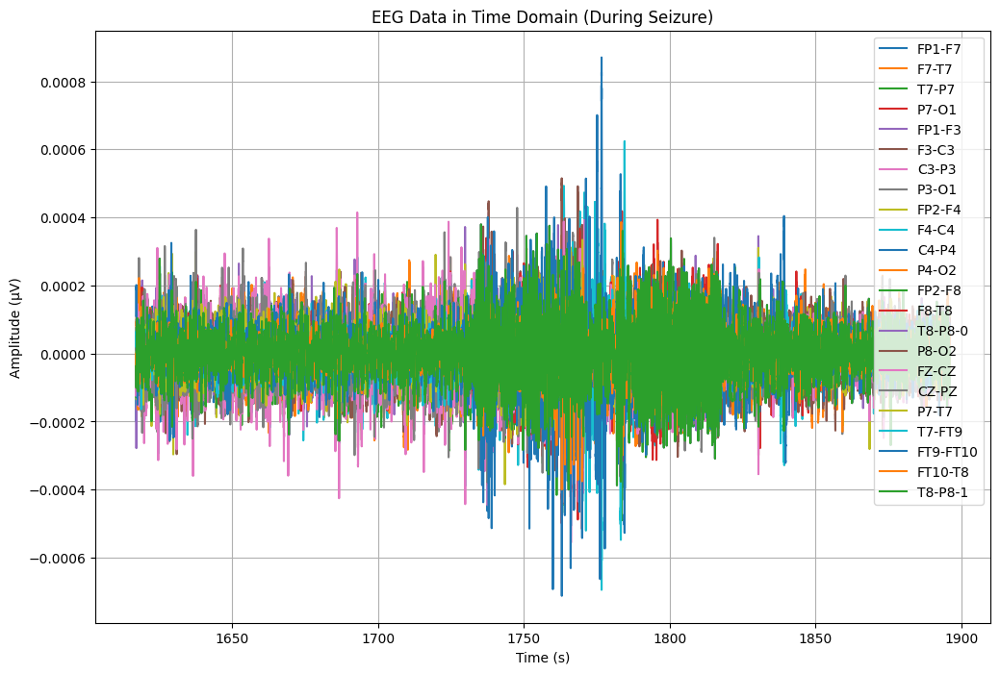

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA15['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA15.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA15[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


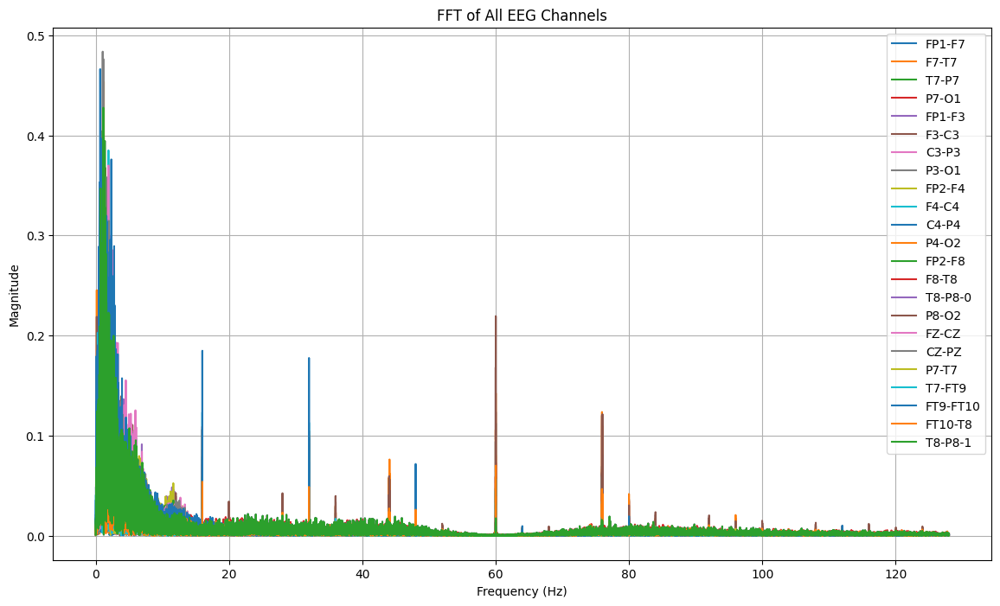

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA15[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1737:
        return "tidak kejang"
    elif 1737 <= row['Time'] < 1776:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_15 = TA15.copy()
TA_15['seizure'] = TA_15.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_15[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1617.000000  tidak kejang -0.000133 -0.000020  0.000027  0.000023   
1  1617.003906  tidak kejang -0.000139 -0.000018  0.000031  0.000022   
2  1617.007812  tidak kejang -0.000143 -0.000015  0.000033  0.000020   
3  1617.011719  tidak kejang -0.000149 -0.000015  0.000029  0.000024   
4  1617.015625  tidak kejang -0.000155 -0.000015  0.000024  0.000027   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000161 -0.000040  0.000033  0.000065  ... -0.000048 -0.000037 -0.000015   
1 -0.000162 -0.000040  0.000034  0.000065  ... -0.000046 -0.000038 -0.000027   
2 -0.000164 -0.000039  0.000035  0.000063  ... -0.000042 -0.000041 -0.000037   
3 -0.000173 -0.000040  0.000033  0.000069  ... -0.000043 -0.000046 -0.000022   
4 -0.000180 -0.000042  0.000031  0.000073  ... -0.000038 -0.000051 -0.000031   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0 -0.000099 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_15['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,9984


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_15)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 279.0 detik


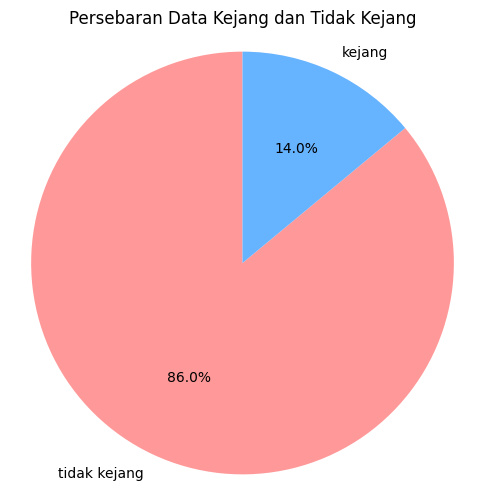

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_15['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_15.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb01_15.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_15.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_15['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       1.00      0.90      0.95      2031
tidak kejang       0.98      1.00      0.99     12254

    accuracy                           0.99     14285
   macro avg       0.99      0.95      0.97     14285
weighted avg       0.99      0.99      0.98     14285

Akurasi: 0.9852292614630731
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       1.00      0.90      0.95      2031
tidak kejang       0.98      1.00      0.99     12254

    accuracy                           0.99     14285
   macro avg       0.99      0.95      0.97     14285
weighted avg       0.99      0.99      0.98     14285



# DATA 9 (chb01_16)
akurasi = 0.968

In [ ]:
# mengimport file edf
file16 = "/content/drive/MyDrive/TA/EDF/chb01_16.edf"
data16 = mne.io.read_raw_edf(file16) # membaca file edf dan menyimpannya di data
data16


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_16.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-63-b0e01ee86623>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data16 = mne.io.read_raw_edf(file16) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_16.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data16.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data16.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data16.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df16 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df16['Time'] = times  # Menambahkan kolom waktu
df16.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.043956e-05,5.958486e-05,1.582418e-05,-6.036630e-05,-4.200244e-05,9.318681e-05,-4.512821e-05,-3.145299e-05,9.181929e-06,5.665446e-06,...,-2.559219e-05,-3.674725e-04,5.333333e-05,-5.137973e-05,-1.543346e-05,-3.770452e-05,-5.860806e-07,7.833944e-05,-2.559219e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,-1.953602e-07,-7.228327e-06,-5.860806e-07,-9.768010e-07,1.953602e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,5.860806e-07,9.768010e-07,1.953602e-07,5.860806e-07,1.953602e-07,-5.860806e-07,5.860806e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df16.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df16.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.674065e-07,1.664119e-07,2.056963e-07,2.046737e-07,1.930712e-07,1.619069e-07,2.055776e-07,1.991729e-07,2.032098e-07,1.660320e-07,...,1.926617e-07,2.008687e-07,1.672017e-07,2.115898e-07,1.850241e-07,1.830620e-07,2.108894e-07,2.097371e-07,1.926617e-07,1799.998047
std,4.499182e-05,3.889350e-05,4.279833e-05,4.412269e-05,5.432335e-05,5.511390e-05,4.313423e-05,5.617577e-05,5.341219e-05,5.878084e-05,...,5.524322e-05,5.775020e-05,6.744579e-05,6.591931e-05,4.279833e-05,2.736749e-05,5.450405e-05,3.212783e-05,5.524322e-05,1039.231048
min,-5.936996e-04,-6.827839e-04,-3.381685e-04,-3.026129e-04,-5.858852e-04,-5.210256e-04,-3.596581e-04,-5.089133e-04,-4.471795e-04,-5.456410e-04,...,-6.280830e-04,-7.089621e-04,-4.729670e-04,-7.597558e-04,-3.534066e-04,-4.256899e-04,-6.921612e-04,-3.877900e-04,-6.280830e-04,0.000000
25%,-2.168498e-05,-1.934066e-05,-2.090354e-05,-2.285714e-05,-2.910867e-05,-2.871795e-05,-2.246642e-05,-2.754579e-05,-2.871795e-05,-3.067155e-05,...,-2.754579e-05,-3.184371e-05,-3.496947e-05,-3.340659e-05,-2.051282e-05,-1.465201e-05,-2.715507e-05,-1.699634e-05,-2.754579e-05,899.999023
50%,9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,...,1.953602e-07,1.953602e-07,1.367521e-06,-1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,2.363858e-05,2.129426e-05,2.090354e-05,2.246642e-05,2.871795e-05,3.067155e-05,2.207570e-05,2.754579e-05,2.832723e-05,3.262515e-05,...,2.754579e-05,3.223443e-05,3.731380e-05,3.262515e-05,2.129426e-05,1.543346e-05,2.676435e-05,1.699634e-05,2.754579e-05,2699.997070
max,6.823932e-04,4.147497e-04,3.537973e-04,3.190232e-04,5.483761e-04,3.854457e-04,3.756777e-04,4.421001e-04,4.839072e-04,3.709890e-04,...,4.362393e-04,8.093773e-04,4.624176e-04,1.218071e-03,3.385592e-04,4.299878e-04,6.194872e-04,4.393651e-04,4.362393e-04,3599.996094


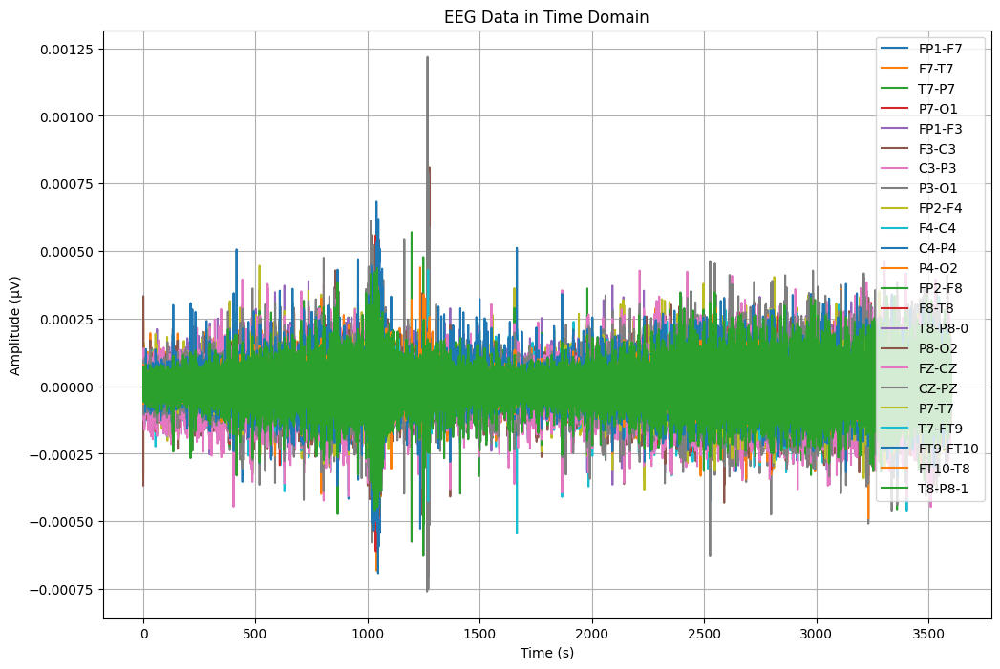

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df16['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df16[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


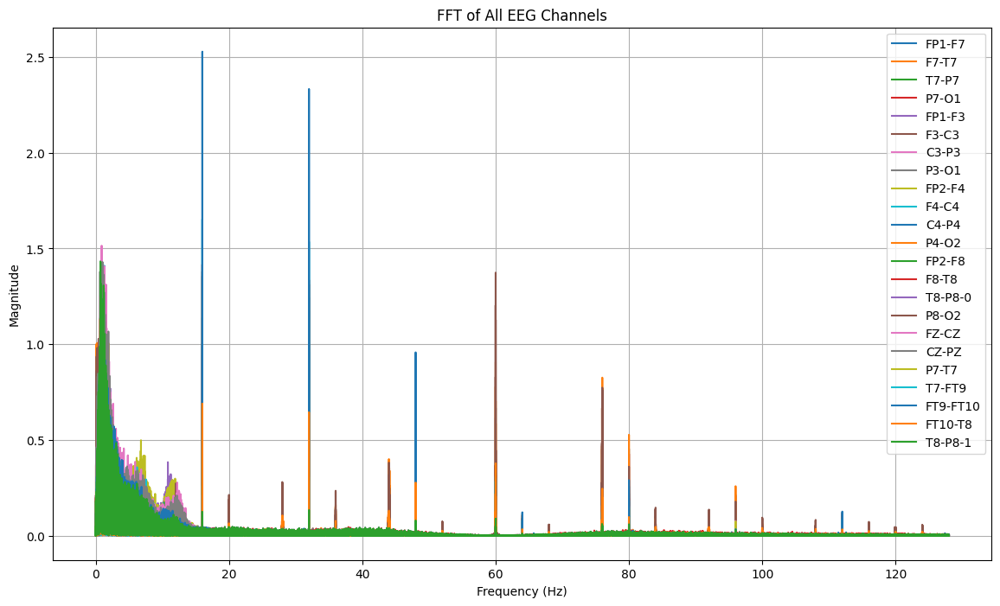

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df16[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_16.csv"
df16.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_16.csv


In [ ]:
#Import Data CSV
dataTA16 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_16.csv")
dataTA16


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.043956e-05,5.958486e-05,1.582418e-05,-6.036630e-05,-4.200244e-05,9.318681e-05,-4.512821e-05,-3.145299e-05,9.181929e-06,5.665446e-06,...,-2.559219e-05,-3.674725e-04,5.333333e-05,-5.137973e-05,-1.543346e-05,-3.770452e-05,-5.860806e-07,7.833944e-05,-2.559219e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,-1.953602e-07,-7.228327e-06,-5.860806e-07,-9.768010e-07,1.953602e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,5.860806e-07,9.768010e-07,1.953602e-07,5.860806e-07,1.953602e-07,-5.860806e-07,5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,2.715507e-05,2.637363e-05,5.684982e-05,2.910867e-05,3.321123e-06,-9.768010e-07,1.113553e-05,1.271795e-04,2.207570e-05,-6.056166e-06,...,-1.973138e-05,-1.387057e-05,-1.621490e-05,-3.926740e-05,-5.645910e-05,-3.711844e-06,-8.400488e-06,-1.308913e-05,-1.973138e-05,3599.980469
921596,2.832723e-05,2.715507e-05,5.411477e-05,2.090354e-05,4.884005e-06,1.367521e-06,7.619048e-06,1.181929e-04,2.363858e-05,-4.884005e-06,...,-1.934066e-05,-3.575092e-05,-1.269841e-05,-4.317460e-05,-5.372405e-05,-1.367521e-06,-1.308913e-05,-1.465201e-05,-1.934066e-05,3599.984375
921597,3.692308e-05,2.637363e-05,4.356532e-05,2.090354e-05,4.884005e-06,3.711844e-06,5.860806e-07,1.185836e-04,2.246642e-05,-5.274725e-06,...,-2.012210e-05,8.400488e-06,-8.400488e-06,-4.512821e-05,-4.317460e-05,5.274725e-06,-2.989011e-05,-2.051282e-05,-2.012210e-05,3599.988281
921598,4.122100e-05,2.051282e-05,4.122100e-05,1.973138e-05,3.321123e-06,4.102564e-06,-2.539683e-06,1.178022e-04,2.051282e-05,-8.009768e-06,...,-1.699634e-05,3.848596e-05,-6.446886e-06,-4.551893e-05,-4.083028e-05,1.426129e-05,-3.770452e-05,-3.262515e-05,-1.699634e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA16[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA16[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA16[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data16, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 2.528138, Time: 1046.738281 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.652329, Time: 1269.304688 s
Channel: FZ-CZ, Max Frequency: 0.90 Hz, Magnitude: 1.514784, Time: 1021.570312 s
Channel: T8-P8-0, Max Frequency: 0.72 Hz, Magnitude: 1.432572, Time: 1248.382812 s
Channel: T8-P8-1, Max Frequency: 0.72 Hz, Magnitude: 1.432572, Time: 1248.382812 s
Channel: CZ-PZ, Max Frequency: 1.02 Hz, Magnitude: 1.429834, Time: 1267.085938 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.416581, Time: 1044.218750 s
Channel: F4-C4, Max Frequency: 1.30 Hz, Magnitude: 1.410236, Time: 1665.312500 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 1.379728, Time: 1276.054688 s
Channel: F3-C3, Max Frequency: 1.21 Hz, Magnitude: 1.379514, Time: 1040.378906 s
Channel: P3-O1, Max Frequency: 0.66 Hz, Magnitude: 1.379471, Time: 3232.273438 s
Channel: P4-O2, Ma

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 0.91 Hz, Magnitude: 0.936430, Time: 804.257812 s
Channel: FZ-CZ, Max Frequency: 0.90 Hz, Magnitude: 1.514784, Time: 1021.570312 s
Channel: T7-P7, Max Frequency: 0.96 Hz, Magnitude: 1.019501, Time: 1035.867188 s
Channel: P7-T7, Max Frequency: 0.96 Hz, Magnitude: 1.019501, Time: 1035.867188 s
Channel: FP2-F4, Max Frequency: 0.97 Hz, Magnitude: 1.017499, Time: 1039.519531 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.003745, Time: 1039.531250 s
Channel: F7-T7, Max Frequency: 1.22 Hz, Magnitude: 0.868094, Time: 1040.347656 s
Channel: F3-C3, Max Frequency: 1.21 Hz, Magnitude: 1.379514, Time: 1040.378906 s
Channel: FP1-F3, Max Frequency: 1.20 Hz, Magnitude: 1.185412, Time: 1040.421875 s
Channel: P7-O1, Max Frequency: 1.17 Hz, Magnitude: 1.018006, Time: 1042.687500 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.416581, Time: 1044.21875

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 901   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1166    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut16 = dataTA16.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut16.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_16.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA16 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_16.csv")
TA16.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000013,0.000062,-0.000038,-0.000022,-0.000027,0.000040,0.000016,-1.465201e-05,-0.000004,0.000073,...,1.113553e-05,0.000013,0.000058,-0.000008,0.000038,-0.000014,-0.000063,2.148962e-06,1.113553e-05,901.000000
1,0.000013,0.000060,-0.000031,-0.000025,-0.000035,0.000038,0.000019,-5.274725e-06,-0.000011,0.000068,...,3.711844e-06,0.000005,0.000047,-0.000001,0.000031,-0.000013,-0.000058,4.493284e-06,3.711844e-06,901.003906
2,0.000012,0.000056,-0.000026,-0.000027,-0.000042,0.000040,0.000017,-1.953602e-07,-0.000019,0.000063,...,7.228327e-06,-0.000026,0.000035,0.000004,0.000026,-0.000013,-0.000058,2.930403e-06,7.228327e-06,901.007812
3,0.000013,0.000040,-0.000014,-0.000024,-0.000050,0.000039,0.000017,7.619048e-06,-0.000033,0.000057,...,1.035409e-05,-0.000016,0.000026,0.000008,0.000014,-0.000004,-0.000056,1.953602e-07,1.035409e-05,901.011719
4,0.000019,0.000024,-0.000008,-0.000021,-0.000059,0.000038,0.000019,1.543346e-05,-0.000048,0.000050,...,5.860806e-07,0.000003,0.000019,0.000014,0.000008,0.000001,-0.000049,3.711844e-06,5.860806e-07,901.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA16.shape


(67840, 24)

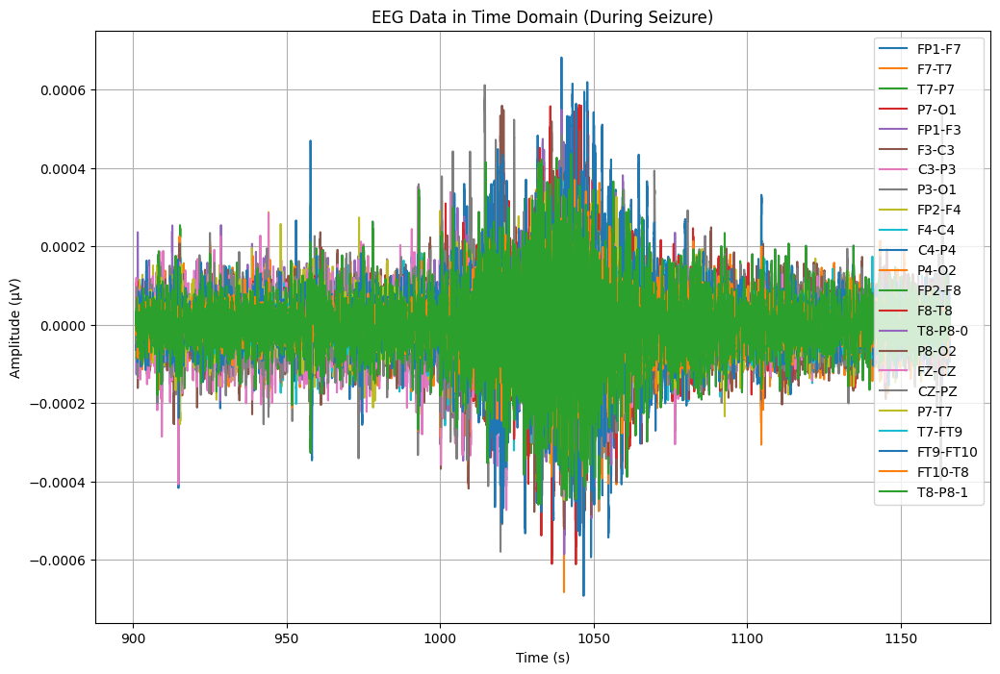

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA16['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA16.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA16[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


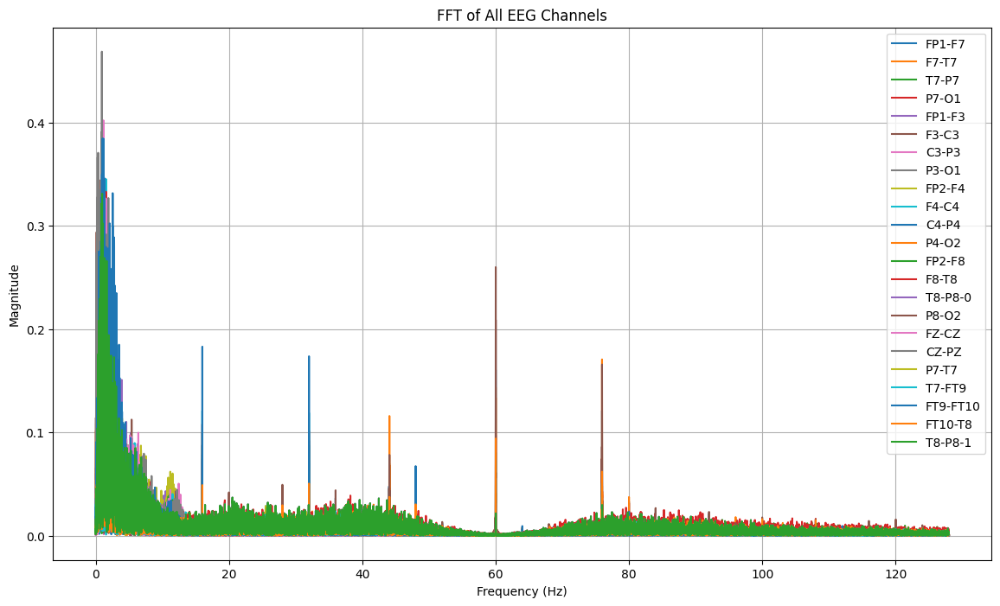

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA16[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1021:
        return "tidak kejang"
    elif 1021 <= row['Time'] < 1046:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_16 = TA16.copy()
TA_16['seizure'] = TA_16.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_16[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1    FP1-F3  \
0  901.000000  tidak kejang  0.000013  0.000062 -0.000038 -0.000022 -0.000027   
1  901.003906  tidak kejang  0.000013  0.000060 -0.000031 -0.000025 -0.000035   
2  901.007812  tidak kejang  0.000012  0.000056 -0.000026 -0.000027 -0.000042   
3  901.011719  tidak kejang  0.000013  0.000040 -0.000014 -0.000024 -0.000050   
4  901.015625  tidak kejang  0.000019  0.000024 -0.000008 -0.000021 -0.000059   

      F3-C3     C3-P3         P3-O1  ...     F8-T8       T8-P8-0     P8-O2  \
0  0.000040  0.000016 -1.465201e-05  ...  0.000008  1.113553e-05  0.000013   
1  0.000038  0.000019 -5.274725e-06  ...  0.000017  3.711844e-06  0.000005   
2  0.000040  0.000017 -1.953602e-07  ...  0.000025  7.228327e-06 -0.000026   
3  0.000039  0.000017  7.619048e-06  ...  0.000026  1.035409e-05 -0.000016   
4  0.000038  0.000019  1.543346e-05  ...  0.000035  5.860806e-07  0.000003   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  F

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_16['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,6400


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_16)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 265.0 detik


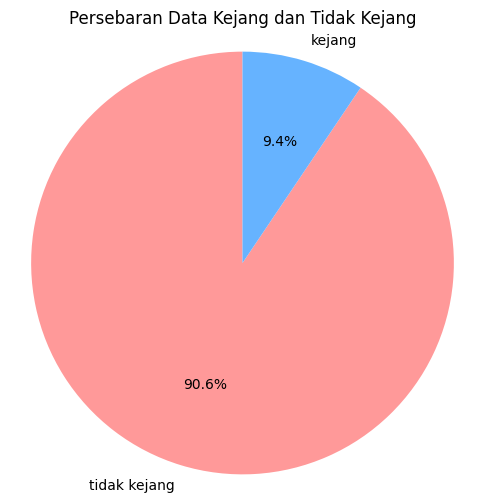

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_16['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_16.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb01_16.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_16.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_16['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.95      0.71      0.81      1311
tidak kejang       0.97      1.00      0.98     12257

    accuracy                           0.97     13568
   macro avg       0.96      0.85      0.90     13568
weighted avg       0.97      0.97      0.97     13568

Akurasi: 0.9684551886792453
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.95      0.71      0.81      1311
tidak kejang       0.97      1.00      0.98     12257

    accuracy                           0.97     13568
   macro avg       0.96      0.85      0.90     13568
weighted avg       0.97      0.97      0.97     13568



# DATA 10 (chb01_18)
akurasi = 0.991

In [ ]:
file17 = "/content/drive/MyDrive/TA/EDF/chb01_18.edf"
data17 = mne.io.read_raw_edf(file17) # membaca file edf dan menyimpannya di data
data17

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_18.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-102-3478a89c8d85>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data17 = mne.io.read_raw_edf(file17) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_18.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data17.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data17.ch_names  # Mendapatkan nama channel

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df17 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df17['Time'] = times  # Menambahkan kolom waktu
df17.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.536020e-05,6.349206e-05,-6.837607e-06,1.621490e-05,5.177045e-05,1.191697e-05,8.791209e-06,3.575092e-05,5.059829e-05,2.598291e-05,...,9.768010e-07,-1.924298e-04,-4.434676e-05,1.894994e-05,7.228327e-06,-1.619536e-04,1.347985e-05,1.025641e-04,9.768010e-07,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,-6.837607e-06,-5.860806e-07,-1.758242e-06,1.953602e-07,-1.758242e-06,9.768010e-07,2.148962e-06,-1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,5.860806e-07,1.758242e-06,1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,0.015625


In [ ]:
channels = data17.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df17.shape) #23 baris dan 921600 kolom

(921600, 24)


In [ ]:
df17.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.016492e-07,1.771550e-07,1.836827e-07,1.931832e-07,1.999067e-07,1.708295e-07,1.961784e-07,1.962331e-07,1.916620e-07,1.810461e-07,...,1.726313e-07,1.951516e-07,1.832557e-07,1.961899e-07,2.070377e-07,1.951817e-07,2.011053e-07,2.080438e-07,1.726313e-07,1799.998047
std,3.490810e-05,2.922000e-05,2.769049e-05,3.025611e-05,3.708658e-05,3.246304e-05,2.527418e-05,3.026389e-05,3.203059e-05,3.314178e-05,...,3.408141e-05,3.811200e-05,3.649301e-05,4.196750e-05,2.769049e-05,2.301585e-05,4.825242e-05,2.499980e-05,3.408141e-05,1039.231048
min,-6.175336e-04,-5.003175e-04,-3.041758e-04,-3.455922e-04,-4.608547e-04,-4.889866e-04,-3.842735e-04,-3.178510e-04,-3.366056e-04,-6.386325e-04,...,-6.312088e-04,-3.936508e-04,-4.311600e-04,-1.018803e-03,-5.061783e-04,-5.749451e-04,-1.495482e-03,-4.366300e-04,-6.312088e-04,0.000000
25%,-1.308913e-05,-1.191697e-05,-1.269841e-05,-1.347985e-05,-1.660562e-05,-1.543346e-05,-1.269841e-05,-1.621490e-05,-1.465201e-05,-1.582418e-05,...,-1.543346e-05,-2.168498e-05,-1.855922e-05,-1.973138e-05,-1.308913e-05,-1.035409e-05,-1.855922e-05,-1.113553e-05,-1.543346e-05,899.999023
50%,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1799.998047
75%,1.308913e-05,1.269841e-05,1.347985e-05,1.387057e-05,1.660562e-05,1.660562e-05,1.308913e-05,1.621490e-05,1.504274e-05,1.660562e-05,...,1.660562e-05,2.207570e-05,1.934066e-05,1.973138e-05,1.308913e-05,1.035409e-05,1.816850e-05,1.152625e-05,1.660562e-05,2699.997070
max,7.597558e-04,3.819292e-04,5.065690e-04,4.737485e-04,5.757265e-04,4.510867e-04,4.874237e-04,3.545788e-04,5.405617e-04,3.377778e-04,...,4.573382e-04,6.343346e-04,5.776801e-04,1.011380e-03,3.045665e-04,4.819536e-04,7.152137e-04,1.629499e-03,4.573382e-04,3599.996094


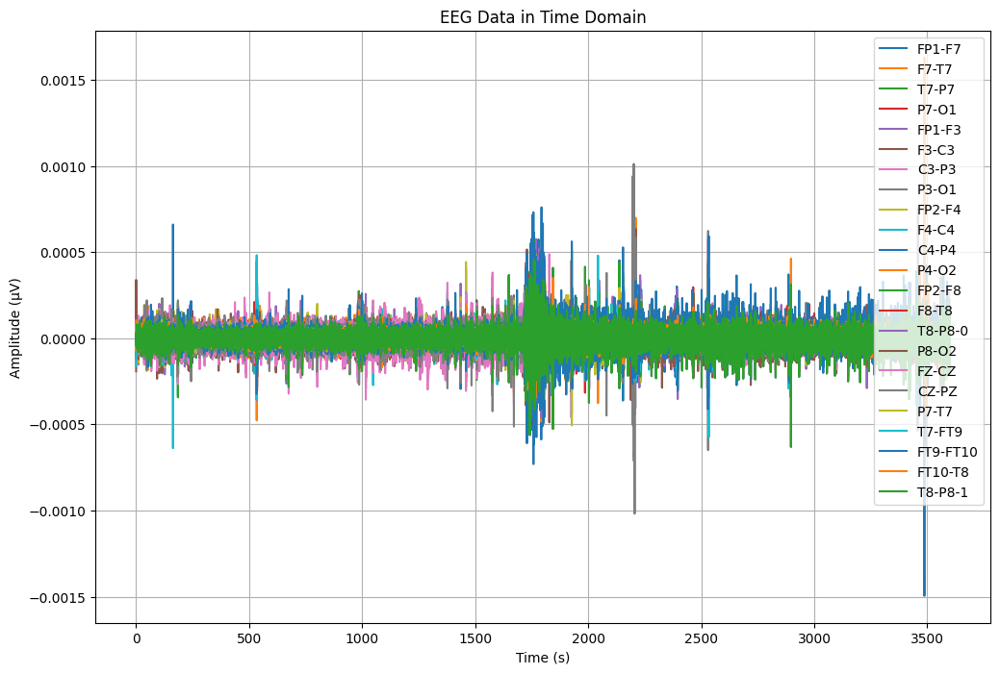

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df17['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df17[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

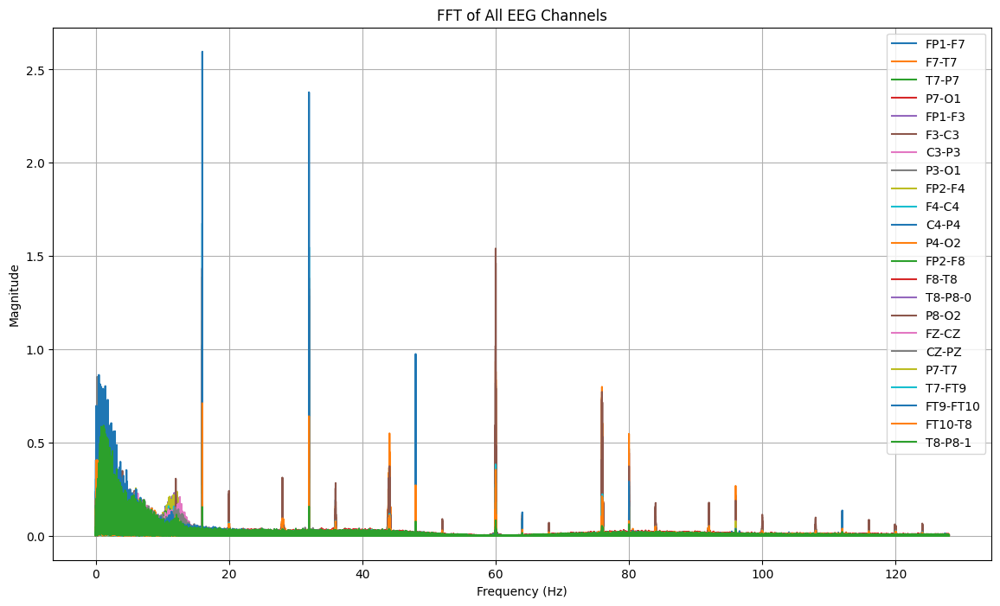

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df17[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_18.csv"
df17.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_18.csv


In [ ]:
dataTA17 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_18.csv")
dataTA17

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.536020e-05,6.349206e-05,-6.837607e-06,1.621490e-05,5.177045e-05,1.191697e-05,8.791209e-06,3.575092e-05,5.059829e-05,2.598291e-05,...,9.768010e-07,-1.924298e-04,-4.434676e-05,1.894994e-05,7.228327e-06,-1.619536e-04,1.347985e-05,1.025641e-04,9.768010e-07,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,-6.837607e-06,-5.860806e-07,-1.758242e-06,1.953602e-07,-1.758242e-06,9.768010e-07,2.148962e-06,-1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,5.860806e-07,1.758242e-06,1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-2.559219e-05,5.274725e-06,1.543346e-05,-1.934066e-05,-5.665446e-06,8.009768e-06,-1.113553e-05,-1.465201e-05,-3.184371e-05,5.724054e-05,...,-4.434676e-05,-8.791209e-06,4.434676e-05,-2.246642e-05,-1.504274e-05,-3.692308e-05,4.669109e-05,6.583639e-05,-4.434676e-05,3599.980469
921596,-1.934066e-05,1.113553e-05,1.543346e-05,-2.481074e-05,5.860806e-07,1.621490e-05,-1.113553e-05,-2.246642e-05,-2.754579e-05,6.739927e-05,...,-3.965812e-05,-5.645910e-05,5.098901e-05,-2.051282e-05,-1.504274e-05,-3.575092e-05,4.512821e-05,6.622711e-05,-3.965812e-05,3599.984375
921597,-1.269841e-05,1.660562e-05,9.181929e-06,-2.363858e-05,6.056166e-06,2.285714e-05,-1.621490e-05,-2.285714e-05,-2.442002e-05,7.365079e-05,...,-3.653236e-05,-8.732601e-05,5.567766e-05,-1.894994e-05,-8.791209e-06,-3.536020e-05,3.848596e-05,6.857143e-05,-3.653236e-05,3599.988281
921598,-4.102564e-06,1.738706e-05,6.446886e-06,-2.285714e-05,1.035409e-05,2.793651e-05,-1.934066e-05,-2.246642e-05,-2.363858e-05,8.107448e-05,...,-3.262515e-05,-3.301587e-05,6.818071e-05,-1.269841e-05,-6.056166e-06,-2.402930e-05,2.871795e-05,6.271062e-05,-3.262515e-05,3599.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA17[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA17[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA17[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data17, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 2.595869, Time: 3487.343750 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.675268, Time: 2533.523438 s
Channel: P8-O2, Max Frequency: 60.00 Hz, Magnitude: 1.540294, Time: 2209.945312 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.436182, Time: 1762.371094 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.387693, Time: 1827.984375 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 1.215149, Time: 3559.687500 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.023885, Time: 1793.527344 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 1.020163, Time: 163.214844 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 0.947442, Time: 1769.488281 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 0.944413, Time: 1827.984375 s
Channel: P4-O2, Max Frequency: 60.00 Hz, Magnitude: 0.936111, Time: 2209.945312 s
Channel: CZ-PZ

In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA17[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA17[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz


# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA17[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data17, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F4-C4, Max Frequency: 0.89 Hz, Magnitude: 0.572209, Time: 163.214844 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 1.020163, Time: 163.214844 s
Channel: P7-O1, Max Frequency: 32.00 Hz, Magnitude: 0.850356, Time: 1753.640625 s
Channel: FP2-F4, Max Frequency: 0.52 Hz, Magnitude: 0.514145, Time: 1756.652344 s
Channel: FP2-F8, Max Frequency: 16.00 Hz, Magnitude: 0.693477, Time: 1758.941406 s
Channel: F7-T7, Max Frequency: 1.42 Hz, Magnitude: 0.541769, Time: 1762.347656 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.436182, Time: 1762.371094 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 0.947442, Time: 1769.488281 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.023885, Time: 1793.527344 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.387693, Time: 1827.984375 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 0.944413, Time: 1827

In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1633   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1913    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut17 = dataTA17.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut17.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_18.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA17 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_18.csv")
TA17.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.758242e-06,-0.000003,1.953602e-07,0.000028,-0.000015,0.000003,0.000018,0.000017,5.274725e-06,0.000010,...,0.000028,0.000008,-0.000002,0.000012,1.953602e-07,0.000013,-3.711844e-06,9.181929e-06,0.000028,1633.000000
1,-2.539683e-06,-0.000004,2.930403e-06,0.000024,-0.000019,0.000002,0.000019,0.000018,-1.953602e-07,0.000009,...,0.000028,-0.000007,-0.000002,0.000014,-2.539683e-06,0.000015,-1.758242e-06,2.148962e-06,0.000028,1633.003906
2,-3.321123e-06,-0.000004,5.274725e-06,0.000021,-0.000022,0.000003,0.000018,0.000019,-1.758242e-06,0.000008,...,0.000026,-0.000009,-0.000003,0.000015,-4.884005e-06,0.000015,-9.768010e-07,1.953602e-07,0.000026,1633.007812
3,-1.953602e-07,-0.000004,4.102564e-06,0.000020,-0.000022,0.000005,0.000017,0.000019,-4.102564e-06,0.000006,...,0.000024,0.000017,-0.000005,0.000021,-3.711844e-06,0.000017,-7.619048e-06,-4.884005e-06,0.000024,1633.011719
4,1.953602e-07,-0.000002,2.930403e-06,0.000015,-0.000023,0.000004,0.000018,0.000017,-7.619048e-06,0.000004,...,0.000021,0.000010,-0.000008,0.000027,-2.539683e-06,0.000018,-1.387057e-05,-8.791209e-06,0.000021,1633.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA17.shape

(71680, 24)

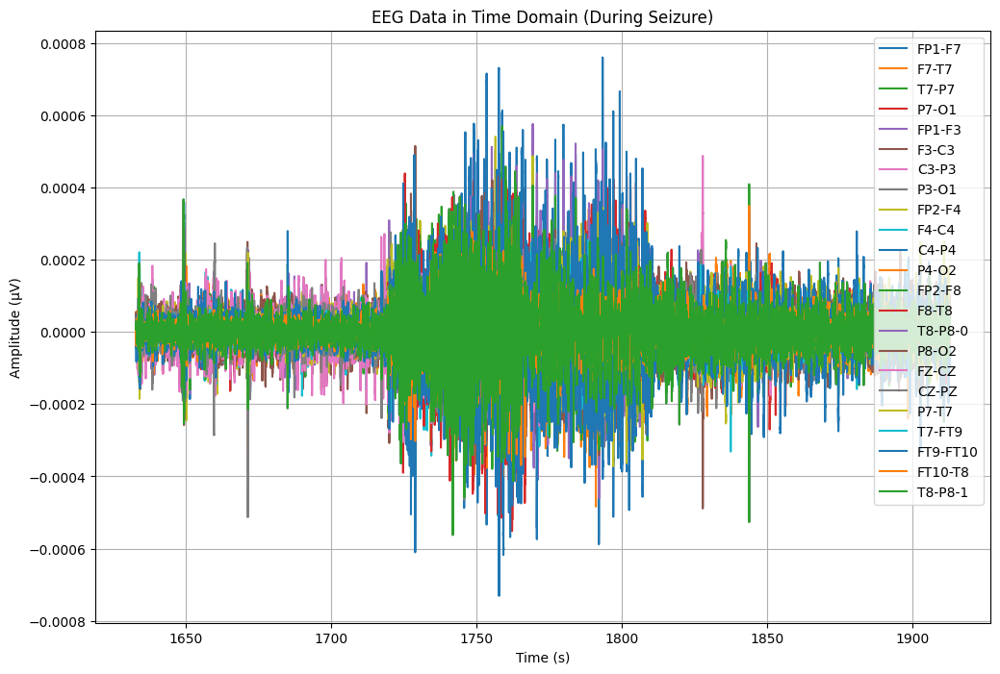

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA17['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA17.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA17[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


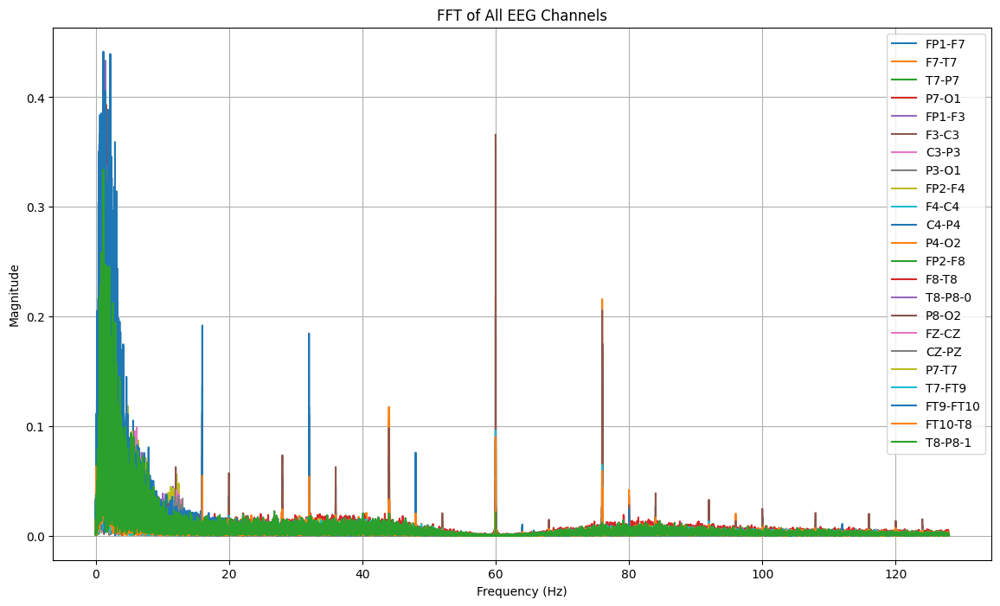

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA17[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1753:
        return "tidak kejang"
    elif 1753 <= row['Time'] < 1793:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_17 = TA17.copy()
TA_17['seizure'] = TA_17.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_17[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure        FP1-F7     F7-T7         T7-P7     P7-O1  \
0  1633.000000  tidak kejang -1.758242e-06 -0.000003  1.953602e-07  0.000028   
1  1633.003906  tidak kejang -2.539683e-06 -0.000004  2.930403e-06  0.000024   
2  1633.007812  tidak kejang -3.321123e-06 -0.000004  5.274725e-06  0.000021   
3  1633.011719  tidak kejang -1.953602e-07 -0.000004  4.102564e-06  0.000020   
4  1633.015625  tidak kejang  1.953602e-07 -0.000002  2.930403e-06  0.000015   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000015  0.000003  0.000018  0.000017  ...  0.000006  0.000028  0.000008   
1 -0.000019  0.000002  0.000019  0.000018  ...  0.000003  0.000028 -0.000007   
2 -0.000022  0.000003  0.000018  0.000019  ...  0.000002  0.000026 -0.000009   
3 -0.000022  0.000005  0.000017  0.000019  ... -0.000006  0.000024  0.000017   
4 -0.000023  0.000004  0.000018  0.000017  ... -0.000010  0.000021  0.000010   

      FZ-CZ     CZ-PZ         P7-T7   

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_17['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,10240


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_17)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 280.0 detik


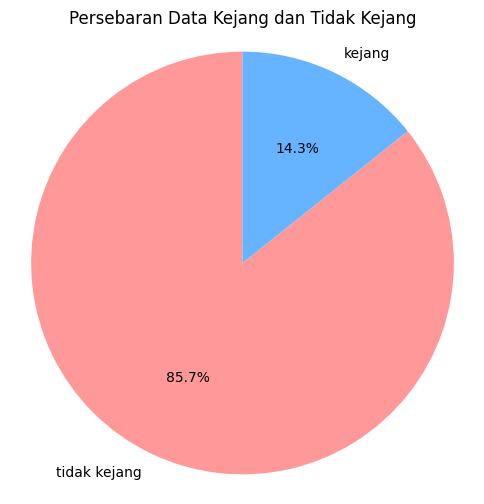

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_17['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_17.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb01_18.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_17.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_17['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.99      0.95      0.97      2100
tidak kejang       0.99      1.00      1.00     12236

    accuracy                           0.99     14336
   macro avg       0.99      0.97      0.98     14336
weighted avg       0.99      0.99      0.99     14336

Akurasi: 0.9917689732142857
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.95      0.97      2100
tidak kejang       0.99      1.00      1.00     12236

    accuracy                           0.99     14336
   macro avg       0.99      0.97      0.98     14336
weighted avg       0.99      0.99      0.99     14336



# DATA 11 (chb01_21)
akurasi = 0.966

In [ ]:
file18 = "/content/drive/MyDrive/TA/EDF/chb01_21.edf"
data18 = mne.io.read_raw_edf(file18) # membaca file edf dan menyimpannya di data
data18

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_21.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-138-9ea486a8993b>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data18 = mne.io.read_raw_edf(file18) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_21.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data18.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data18.ch_names  # Mendapatkan nama channel

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df18 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df18['Time'] = times  # Menambahkan kolom waktu
df18.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.059829e-05,-2.793651e-05,-6.837607e-06,-1.504274e-05,9.768010e-07,-7.482295e-05,-2.930403e-06,-2.363858e-05,4.200244e-05,-5.450549e-05,...,-2.637363e-05,-3.770452e-05,-5.528694e-05,-5.997558e-05,7.228327e-06,-6.192918e-05,3.926740e-05,7.912088e-05,-2.637363e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,-9.768010e-07,-5.860806e-07,-1.758242e-06,1.953602e-07,-1.758242e-06,9.768010e-07,1.758242e-06,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.367521e-06,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.015625


In [ ]:
channels = data18.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df18.shape) #23 baris dan 921600 kolom

(921600, 24)


In [ ]:
df18.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.153329e-07,1.841028e-07,1.794524e-07,1.889385e-07,1.935592e-07,1.983830e-07,1.933502e-07,1.925341e-07,1.973638e-07,1.911376e-07,...,1.534892e-07,1.941947e-07,1.942498e-07,1.565264e-07,2.112680e-07,1.932714e-07,1.966567e-07,2.107864e-07,1.534892e-07,1799.998047
std,6.289710e-05,4.110748e-05,3.335726e-05,2.810327e-05,6.073348e-05,3.917120e-05,2.836364e-05,3.046516e-05,5.338453e-05,4.021296e-05,...,4.299551e-05,3.737323e-05,4.253606e-05,4.854325e-05,3.335726e-05,3.194406e-05,6.756242e-05,3.227766e-05,4.299551e-05,1039.231048
min,-8.586081e-04,-5.745543e-04,-5.643956e-04,-5.061783e-04,-6.823932e-04,-6.870818e-04,-3.729426e-04,-3.498901e-04,-7.601465e-04,-6.644200e-04,...,-5.784615e-04,-5.182906e-04,-9.008059e-04,-1.884249e-03,-6.175336e-04,-6.714530e-04,-7.964835e-04,-4.190476e-04,-5.784615e-04,0.000000
25%,-1.777778e-05,-1.621490e-05,-1.621490e-05,-1.347985e-05,-2.129426e-05,-1.777778e-05,-1.387057e-05,-1.621490e-05,-1.934066e-05,-1.855922e-05,...,-1.973138e-05,-1.816850e-05,-2.012210e-05,-2.285714e-05,-1.621490e-05,-1.387057e-05,-2.676435e-05,-1.426129e-05,-1.973138e-05,899.999023
50%,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1799.998047
75%,1.738706e-05,1.660562e-05,1.660562e-05,1.387057e-05,2.051282e-05,1.816850e-05,1.387057e-05,1.621490e-05,1.855922e-05,1.934066e-05,...,2.168498e-05,1.934066e-05,2.090354e-05,2.285714e-05,1.660562e-05,1.426129e-05,2.598291e-05,1.426129e-05,2.168498e-05,2699.997070
max,9.504274e-04,5.436874e-04,6.179243e-04,4.772650e-04,9.484737e-04,4.319414e-04,6.081563e-04,2.990965e-04,6.741880e-04,7.390476e-04,...,4.194383e-04,5.136020e-04,1.012161e-03,1.074676e-03,5.647863e-04,4.901587e-04,7.245910e-04,6.300366e-04,4.194383e-04,3599.996094


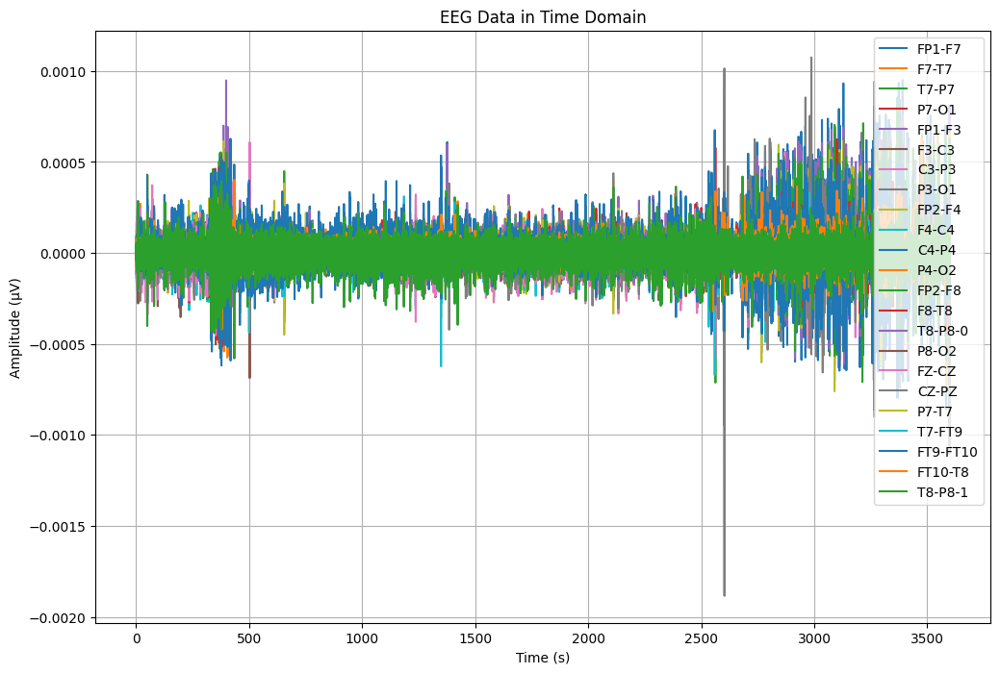

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df18['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df18[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

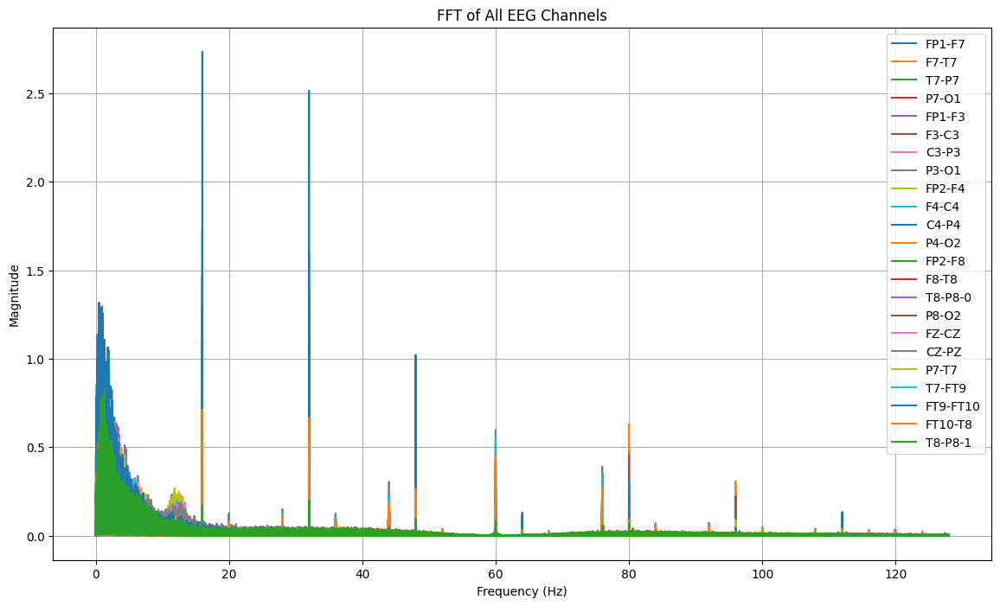

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df18[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_21.csv"
df18.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_21.csv


In [ ]:
dataTA18 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_21.csv")
dataTA18

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.059829e-05,-2.793651e-05,-6.837607e-06,-1.504274e-05,9.768010e-07,-7.482295e-05,-2.930403e-06,-2.363858e-05,4.200244e-05,-5.450549e-05,...,-2.637363e-05,-3.770452e-05,-5.528694e-05,-5.997558e-05,7.228327e-06,-6.192918e-05,3.926740e-05,7.912088e-05,-2.637363e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,-9.768010e-07,-5.860806e-07,-1.758242e-06,1.953602e-07,-1.758242e-06,9.768010e-07,1.758242e-06,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.367521e-06,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-2.442002e-05,3.418803e-05,-1.894994e-05,2.832723e-05,-2.793651e-05,8.459096e-05,-4.317460e-05,5.274725e-06,-1.855922e-05,-4.630037e-05,...,-3.184371e-05,2.207570e-05,-2.051282e-05,2.871795e-05,1.934066e-05,-1.113553e-05,5.880342e-05,-4.864469e-05,-3.184371e-05,3599.980469
921596,-2.676435e-05,4.043956e-05,-1.934066e-05,2.090354e-05,-2.598291e-05,8.654457e-05,-4.630037e-05,1.367521e-06,-1.308913e-05,-3.770452e-05,...,-2.676435e-05,1.816850e-05,-1.582418e-05,3.536020e-05,1.973138e-05,-1.504274e-05,4.864469e-05,-4.200244e-05,-2.676435e-05,3599.984375
921597,-3.536020e-05,3.887668e-05,-1.934066e-05,1.582418e-05,-3.418803e-05,8.654457e-05,-4.942613e-05,-2.148962e-06,-1.191697e-05,-3.262515e-05,...,-2.481074e-05,2.090354e-05,-2.090354e-05,4.551893e-05,1.973138e-05,-1.426129e-05,4.122100e-05,-4.278388e-05,-2.481074e-05,3599.988281
921598,-1.816850e-05,4.434676e-05,-2.402930e-05,1.191697e-05,-1.269841e-05,8.771673e-05,-5.255189e-05,-6.837607e-06,-7.619048e-06,-2.559219e-05,...,-2.246642e-05,1.894994e-05,-2.324786e-05,4.747253e-05,2.442002e-05,-2.168498e-05,3.887668e-05,-3.965812e-05,-2.246642e-05,3599.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA18[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA18[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA18[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data18, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 2.735199, Time: 3368.500000 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.727905, Time: 2560.089844 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.476151, Time: 502.542969 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.463940, Time: 3100.468750 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 1.360162, Time: 394.386719 s
Channel: P8-O2, Max Frequency: 32.00 Hz, Magnitude: 1.284700, Time: 3382.476562 s
Channel: FP1-F7, Max Frequency: 1.05 Hz, Magnitude: 1.211112, Time: 3391.187500 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 1.110596, Time: 3264.859375 s
Channel: FP1-F3, Max Frequency: 1.05 Hz, Magnitude: 1.090232, Time: 398.371094 s
Channel: P4-O2, Max Frequency: 32.00 Hz, Magnitude: 1.038733, Time: 3382.460938 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 0.970485, Time: 502.542969 s
Channel: P7-O1, Max

In [ ]:
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 1.360162, Time: 394.386719 s
Channel: FP1-F3, Max Frequency: 1.05 Hz, Magnitude: 1.090232, Time: 398.371094 s
Channel: F7-T7, Max Frequency: 0.69 Hz, Magnitude: 0.833245, Time: 403.535156 s
Channel: T8-P8-0, Max Frequency: 1.33 Hz, Magnitude: 0.834622, Time: 434.074219 s
Channel: T8-P8-1, Max Frequency: 1.33 Hz, Magnitude: 0.834622, Time: 434.074219 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.476151, Time: 502.542969 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 0.970485, Time: 502.542969 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.727905, Time: 2560.089844 s
Channel: CZ-PZ, Max Frequency: 0.65 Hz, Magnitude: 0.776857, Time: 2602.855469 s
Channel: FZ-CZ, Max Frequency: 1.59 Hz, Magnitude: 0.720069, Time: 2602.859375 s
Channel: FP2-F4, Max Frequency: 1.05 Hz, Magnitude: 0.900553, Time: 3089.80078

In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 274   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 554    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut18 = dataTA18.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut18.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_21.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA18 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_21.csv")
TA18.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000007,-0.000012,-0.000003,0.000036,-0.000015,0.000010,0.000005,0.000010,-0.000017,-0.000008,...,0.000024,0.000049,0.000001,0.000036,0.000004,0.000013,-0.000018,-9.768010e-07,0.000024,274.000000
1,-0.000011,-0.000008,0.000004,0.000035,-0.000024,0.000008,0.000012,0.000023,-0.000019,-0.000008,...,0.000028,0.000046,-0.000001,0.000039,-0.000004,0.000011,-0.000020,-5.860806e-07,0.000028,274.003906
2,-0.000009,-0.000007,0.000014,0.000033,-0.000028,0.000006,0.000017,0.000035,-0.000022,-0.000008,...,0.000028,0.000049,-0.000006,0.000045,-0.000014,0.000016,-0.000025,-2.930403e-06,0.000028,274.007812
3,-0.000005,-0.000006,0.000023,0.000029,-0.000030,0.000003,0.000021,0.000046,-0.000023,-0.000012,...,0.000024,0.000047,-0.000013,0.000044,-0.000022,0.000017,-0.000024,-2.930403e-06,0.000024,274.011719
4,-0.000004,-0.000002,0.000027,0.000028,-0.000030,-0.000001,0.000025,0.000055,-0.000022,-0.000015,...,0.000019,0.000042,-0.000019,0.000041,-0.000027,0.000012,-0.000019,2.148962e-06,0.000019,274.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA18.shape

(71680, 24)

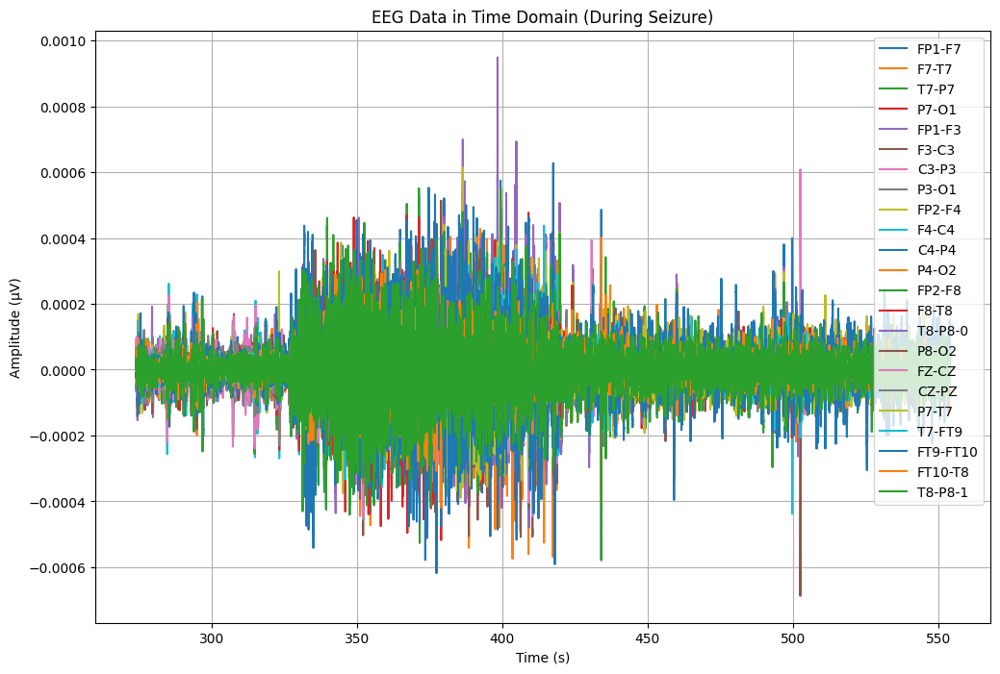

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA18['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA18.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA18[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


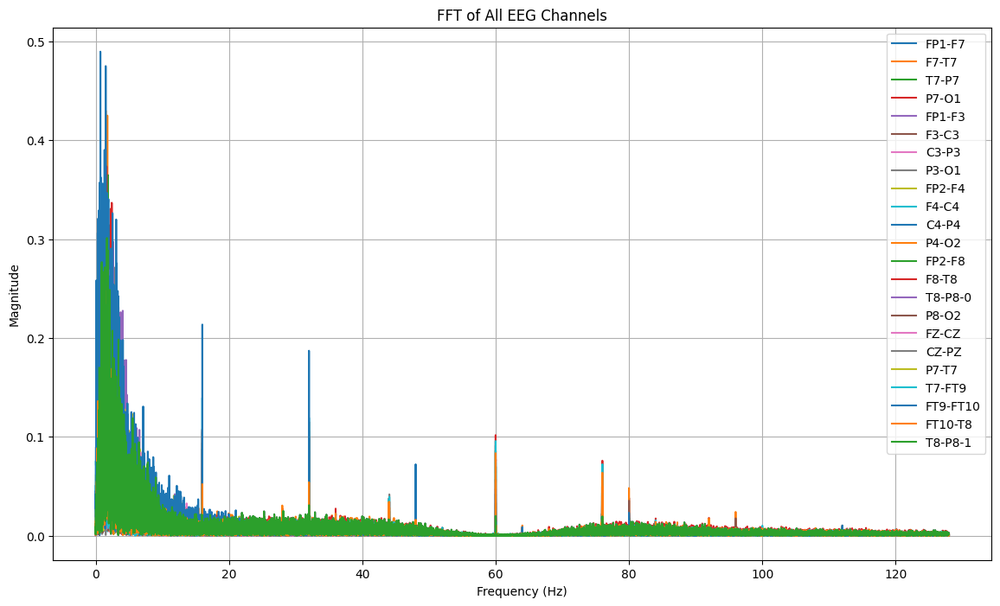

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA18[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 394:
        return "tidak kejang"
    elif 394 <= row['Time'] < 434:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_18 = TA18.copy()
TA_18['seizure'] = TA_18.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_18[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1    FP1-F3  \
0  274.000000  tidak kejang -0.000007 -0.000012 -0.000003  0.000036 -0.000015   
1  274.003906  tidak kejang -0.000011 -0.000008  0.000004  0.000035 -0.000024   
2  274.007812  tidak kejang -0.000009 -0.000007  0.000014  0.000033 -0.000028   
3  274.011719  tidak kejang -0.000005 -0.000006  0.000023  0.000029 -0.000030   
4  274.015625  tidak kejang -0.000004 -0.000002  0.000027  0.000028 -0.000030   

      F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2     FZ-CZ  \
0  0.000010  0.000005  0.000010  ...  0.000012  0.000024  0.000049  0.000001   
1  0.000008  0.000012  0.000023  ...  0.000013  0.000028  0.000046 -0.000001   
2  0.000006  0.000017  0.000035  ...  0.000010  0.000028  0.000049 -0.000006   
3  0.000003  0.000021  0.000046  ...  0.000010  0.000024  0.000047 -0.000013   
4 -0.000001  0.000025  0.000055  ...  0.000017  0.000019  0.000042 -0.000019   

      CZ-PZ     P7-T7    T7-FT9 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_18['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,10240


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_18)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 280.0 detik


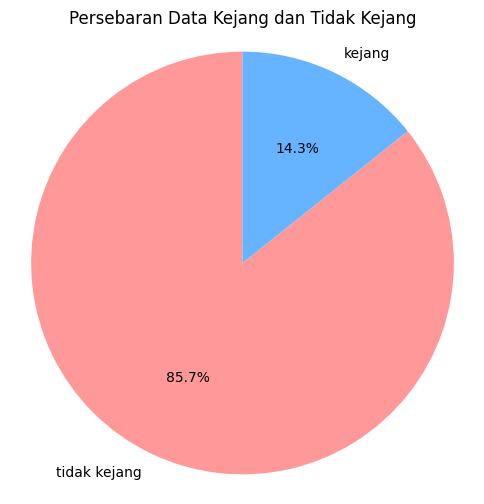

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_18['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_18.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb01_21.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_18.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_18['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       1.00      0.77      0.87      2100
tidak kejang       0.96      1.00      0.98     12236

    accuracy                           0.97     14336
   macro avg       0.98      0.89      0.93     14336
weighted avg       0.97      0.97      0.96     14336

Akurasi: 0.9665178571428571
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       1.00      0.77      0.87      2100
tidak kejang       0.96      1.00      0.98     12236

    accuracy                           0.97     14336
   macro avg       0.98      0.89      0.93     14336
weighted avg       0.97      0.97      0.96     14336



# DATA 12 (chb01_26)
akurasi = 0.983

In [ ]:
file19 = "/content/drive/MyDrive/TA/EDF/chb01_26.edf"
data19 = mne.io.read_raw_edf(file19) # membaca file edf dan menyimpannya di data
data19

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_26.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-163-4d5279880260>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data19 = mne.io.read_raw_edf(file19) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_26.edf, 23 x 595200 (2325.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data19.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data19.ch_names  # Mendapatkan nama channel

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df19 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df19['Time'] = times  # Menambahkan kolom waktu
df19.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.059829e-05,1.181929e-04,1.619536e-04,4.278388e-05,1.330403e-04,-2.139194e-04,3.119902e-04,4.122100e-05,5.684982e-05,-2.148962e-06,...,-3.106227e-05,9.357753e-05,1.582418e-05,2.832723e-05,-1.615629e-04,-2.754579e-05,2.291575e-04,-2.930403e-06,-3.106227e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,9.768010e-07,0.011719
4,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,-2.539683e-06,2.148962e-06,-1.953602e-07,9.768010e-07,-9.768010e-07,...,-3.711844e-06,1.953602e-07,-5.860806e-07,-3.321123e-06,5.860806e-07,-5.860806e-07,1.758242e-06,9.768010e-07,-3.711844e-06,0.015625


In [ ]:
channels = data19.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df19.shape) #23 baris dan 921600 kolom

(595200, 24)


In [ ]:
df19.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,...,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,595200.000000
mean,2.006007e-07,1.818465e-07,1.731222e-07,1.891160e-07,1.845104e-07,1.825259e-07,1.971891e-07,1.941648e-07,2.085168e-07,1.661310e-07,...,1.777535e-07,1.777325e-07,1.706001e-07,2.040497e-07,2.175982e-07,1.901250e-07,2.129708e-07,2.200940e-07,1.777535e-07,1162.498047
std,5.597364e-05,4.557905e-05,3.812132e-05,3.678945e-05,6.121230e-05,5.861786e-05,4.758908e-05,3.833102e-05,5.544189e-05,4.491906e-05,...,5.734014e-05,5.676751e-05,5.002744e-05,6.275893e-05,3.812132e-05,3.316304e-05,6.362798e-05,3.131797e-05,5.734014e-05,671.170252
min,-7.281074e-04,-6.179243e-04,-4.042002e-04,-3.401221e-04,-6.433211e-04,-8.039072e-04,-7.109158e-04,-3.850549e-04,-8.812698e-04,-5.370452e-04,...,-1.278242e-03,-1.048889e-03,-5.276679e-04,-1.024274e-03,-5.647863e-04,-7.320147e-04,-5.944811e-04,-2.901099e-04,-1.278242e-03,0.000000
25%,-1.973138e-05,-1.777778e-05,-1.738706e-05,-1.777778e-05,-2.402930e-05,-2.520147e-05,-2.129426e-05,-2.051282e-05,-2.129426e-05,-1.973138e-05,...,-2.481074e-05,-2.402930e-05,-2.207570e-05,-2.715507e-05,-1.777778e-05,-1.387057e-05,-2.676435e-05,-1.426129e-05,-2.481074e-05,581.249023
50%,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,...,9.768010e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,1.953602e-07,9.768010e-07,1162.498047
75%,1.973138e-05,1.816850e-05,1.816850e-05,1.855922e-05,2.363858e-05,2.637363e-05,2.090354e-05,2.090354e-05,2.051282e-05,2.129426e-05,...,2.637363e-05,2.520147e-05,2.363858e-05,2.637363e-05,1.777778e-05,1.426129e-05,2.559219e-05,1.426129e-05,2.637363e-05,1743.747070
max,8.136752e-04,4.385836e-04,5.651770e-04,4.350672e-04,1.059438e-03,8.648596e-04,7.980464e-04,3.448107e-04,1.003956e-03,3.526252e-04,...,9.937973e-04,1.110623e-03,3.842735e-04,1.008254e-03,4.045910e-04,5.976068e-04,5.905739e-04,3.409035e-04,9.937973e-04,2324.996094


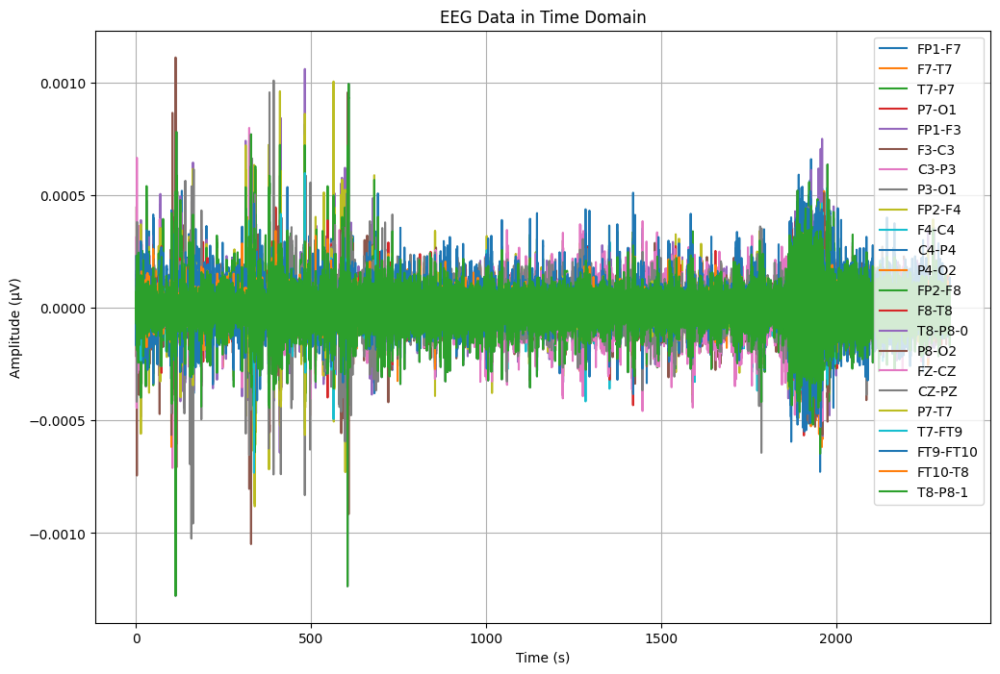

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df19['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df19[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

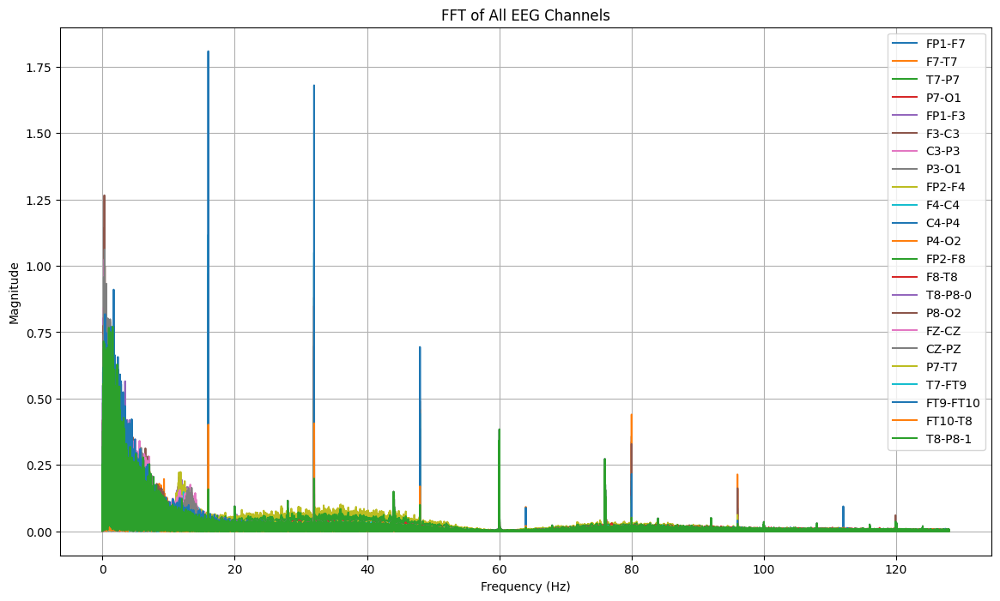

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df19[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_26.csv"
df19.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_26.csv


In [ ]:
dataTA19 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_26.csv")
dataTA19

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.059829e-05,1.181929e-04,1.619536e-04,4.278388e-05,1.330403e-04,-2.139194e-04,3.119902e-04,4.122100e-05,5.684982e-05,-2.148962e-06,...,-3.106227e-05,9.357753e-05,1.582418e-05,2.832723e-05,-1.615629e-04,-2.754579e-05,2.291575e-04,-2.930403e-06,-3.106227e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,9.768010e-07,0.011719
4,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,-2.539683e-06,2.148962e-06,-1.953602e-07,9.768010e-07,-9.768010e-07,...,-3.711844e-06,1.953602e-07,-5.860806e-07,-3.321123e-06,5.860806e-07,-5.860806e-07,1.758242e-06,9.768010e-07,-3.711844e-06,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
595195,3.731380e-05,1.152625e-05,-7.619048e-06,1.816850e-05,4.122100e-05,3.711844e-06,-9.572650e-06,2.442002e-05,1.035409e-05,6.056166e-06,...,2.989011e-05,1.387057e-05,2.989011e-05,-4.551893e-05,8.009768e-06,-2.871795e-05,-5.645910e-05,-4.493284e-06,2.989011e-05,2324.980469
595196,2.754579e-05,9.963370e-06,-8.400488e-06,1.308913e-05,3.692308e-05,1.953602e-07,-1.035409e-05,1.504274e-05,1.347985e-05,5.860806e-07,...,2.793651e-05,1.934066e-05,2.481074e-05,-4.903541e-05,8.791209e-06,-2.559219e-05,-6.427350e-05,-8.791209e-06,2.793651e-05,2324.984375
595197,2.715507e-05,4.884005e-06,-1.113553e-05,1.426129e-05,3.692308e-05,5.860806e-07,-1.426129e-05,1.152625e-05,3.321123e-06,1.953602e-07,...,4.630037e-05,2.598291e-05,1.582418e-05,-3.887668e-05,1.152625e-05,-1.855922e-05,-7.755800e-05,-1.777778e-05,4.630037e-05,2324.988281
595198,2.910867e-05,2.539683e-06,-1.191697e-05,1.113553e-05,4.161172e-05,2.930403e-06,-1.777778e-05,3.321123e-06,-5.860806e-07,2.148962e-06,...,6.427350e-05,2.832723e-05,9.963370e-06,-3.223443e-05,1.230769e-05,-1.660562e-05,-8.693529e-05,-2.324786e-05,6.427350e-05,2324.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA19[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA19[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA19[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data19, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 1.807812, Time: 1871.886719 s
Channel: F3-C3, Max Frequency: 0.29 Hz, Magnitude: 1.265265, Time: 103.851562 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.117001, Time: 336.890625 s
Channel: CZ-PZ, Max Frequency: 0.32 Hz, Magnitude: 1.061271, Time: 157.816406 s
Channel: C3-P3, Max Frequency: 0.29 Hz, Magnitude: 1.024314, Time: 323.156250 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 0.992431, Time: 1895.035156 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 0.874661, Time: 1908.007812 s
Channel: P8-O2, Max Frequency: 0.42 Hz, Magnitude: 0.835980, Time: 112.785156 s
Channel: FP1-F3, Max Frequency: 0.31 Hz, Magnitude: 0.820747, Time: 482.039062 s
Channel: FP1-F7, Max Frequency: 0.21 Hz, Magnitude: 0.818818, Time: 482.019531 s
Channel: T8-P8-0, Max Frequency: 1.55 Hz, Magnitude: 0.771022, Time: 112.785156 s
Channel: T8-P8-1, Max Freq

In [ ]:
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F3-C3, Max Frequency: 0.29 Hz, Magnitude: 1.265265, Time: 103.851562 s
Channel: T8-P8-0, Max Frequency: 1.55 Hz, Magnitude: 0.771022, Time: 112.785156 s
Channel: P8-O2, Max Frequency: 0.42 Hz, Magnitude: 0.835980, Time: 112.785156 s
Channel: T8-P8-1, Max Frequency: 1.55 Hz, Magnitude: 0.771022, Time: 112.785156 s
Channel: P4-O2, Max Frequency: 32.00 Hz, Magnitude: 0.739442, Time: 113.593750 s
Channel: CZ-PZ, Max Frequency: 0.32 Hz, Magnitude: 1.061271, Time: 157.816406 s
Channel: C3-P3, Max Frequency: 0.29 Hz, Magnitude: 1.024314, Time: 323.156250 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.117001, Time: 336.890625 s
Channel: FT10-T8, Max Frequency: 1.70 Hz, Magnitude: 0.436432, Time: 398.589844 s
Channel: FP2-F8, Max Frequency: 1.01 Hz, Magnitude: 0.712306, Time: 410.925781 s
Channel: FP1-F7, Max Frequency: 0.21 Hz, Magnitude: 0.818818, Time: 482.019531 s


In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1751   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2079    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut19 = dataTA19.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut19.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_26.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA19 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_26.csv")
TA19.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000015,0.000023,-5.860806e-07,-0.000004,0.000049,0.000013,-0.000004,-0.000024,0.000037,-0.000003,...,0.000025,-0.000022,-0.000024,-0.000007,9.768010e-07,-0.000008,-0.000003,-0.000008,0.000025,1751.000000
1,0.000013,0.000020,-2.148962e-06,-0.000005,0.000048,0.000013,-0.000006,-0.000030,0.000037,-0.000001,...,0.000040,-0.000028,-0.000022,-0.000004,2.539683e-06,-0.000010,-0.000005,-0.000012,0.000040,1751.003906
2,0.000011,0.000018,-5.274725e-06,-0.000009,0.000049,0.000012,-0.000007,-0.000039,0.000040,-0.000008,...,0.000023,-0.000015,-0.000021,-0.000015,5.665446e-06,-0.000008,-0.000012,-0.000013,0.000023,1751.007812
3,0.000010,0.000015,-1.308913e-05,-0.000013,0.000047,0.000007,-0.000010,-0.000045,0.000041,-0.000017,...,0.000010,-0.000004,-0.000024,-0.000022,1.347985e-05,-0.000008,-0.000023,-0.000013,0.000010,1751.011719
4,0.000010,0.000010,-1.738706e-05,-0.000021,0.000044,0.000004,-0.000016,-0.000049,0.000037,-0.000018,...,0.000032,-0.000022,-0.000032,-0.000025,1.777778e-05,-0.000003,-0.000036,-0.000018,0.000032,1751.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA19.shape

(83968, 24)

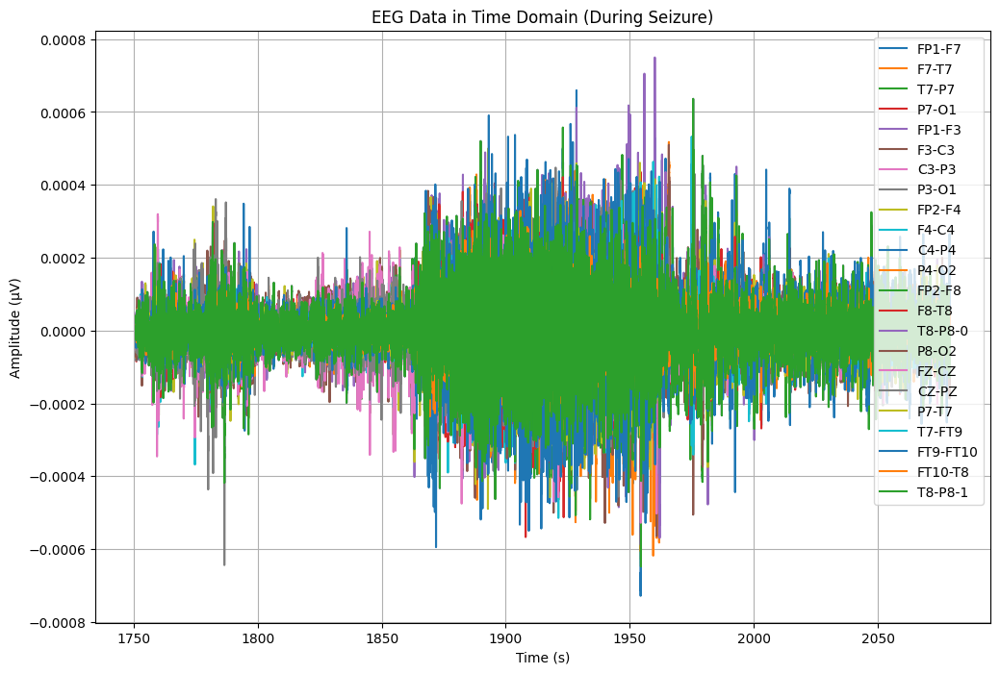

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA19['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA19.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA19[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


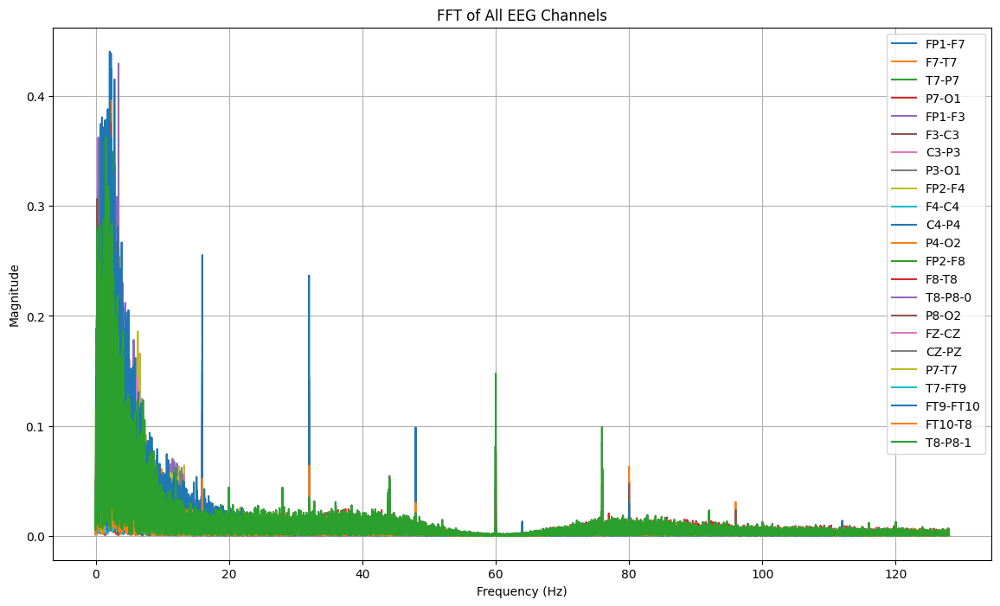

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA19[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1871:
        return "tidak kejang"
    elif 1871 <= row['Time'] < 1959:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_19 = TA19.copy()
TA_19['seizure'] = TA_19.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_19[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7         T7-P7     P7-O1  \
0  1751.000000  tidak kejang  0.000015  0.000023 -5.860806e-07 -0.000004   
1  1751.003906  tidak kejang  0.000013  0.000020 -2.148962e-06 -0.000005   
2  1751.007812  tidak kejang  0.000011  0.000018 -5.274725e-06 -0.000009   
3  1751.011719  tidak kejang  0.000010  0.000015 -1.308913e-05 -0.000013   
4  1751.015625  tidak kejang  0.000010  0.000010 -1.738706e-05 -0.000021   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000049  0.000013 -0.000004 -0.000024  ... -0.000033  0.000025 -0.000022   
1  0.000048  0.000013 -0.000006 -0.000030  ... -0.000037  0.000040 -0.000028   
2  0.000049  0.000012 -0.000007 -0.000039  ... -0.000040  0.000023 -0.000015   
3  0.000047  0.000007 -0.000010 -0.000045  ... -0.000042  0.000010 -0.000004   
4  0.000044  0.000004 -0.000016 -0.000049  ... -0.000045  0.000032 -0.000022   

      FZ-CZ     CZ-PZ         P7-T7    T7-FT9  FT9-FT10   FT10

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_19['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,22528


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_19)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 328.0 detik


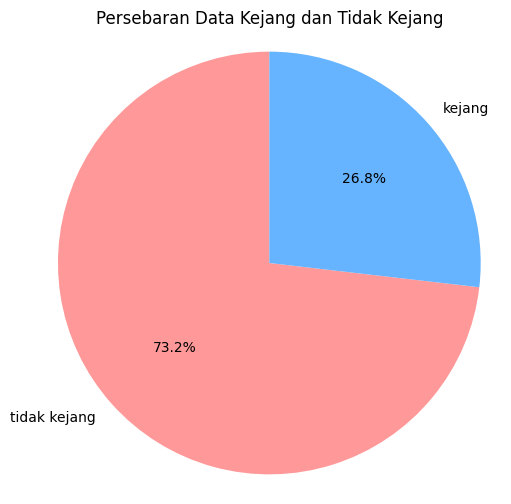

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_19['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_19.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb01_26.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_19.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_19['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.99      0.95      0.97      4567
tidak kejang       0.98      1.00      0.99     12227

    accuracy                           0.98     16794
   macro avg       0.99      0.97      0.98     16794
weighted avg       0.98      0.98      0.98     16794

Akurasi: 0.9837441943551268
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.95      0.97      4567
tidak kejang       0.98      1.00      0.99     12227

    accuracy                           0.98     16794
   macro avg       0.99      0.97      0.98     16794
weighted avg       0.98      0.98      0.98     16794



# DATA 13 (chb03_02)
akurasi = 0.955

In [ ]:
# mengimport file edf
file23 = "/content/drive/MyDrive/TA/EDF/chb03_02.edf"
data23 = mne.io.read_raw_edf(file23) # membaca file edf dan menyimpannya di data
data23


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-187-fc346c8e9a60>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data23 = mne.io.read_raw_edf(file23) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_02.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data23.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data23.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data23.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df23 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df23['Time'] = times  # Menambahkan kolom waktu
df23.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,8.967033e-05,-1.953602e-07,-8.791209e-06,-5.333333e-05,-4.239316e-05,4.786325e-05,1.934066e-05,2.539683e-06,-1.248352e-04,1.699634e-05,...,2.402930e-05,-5.860806e-07,-5.274725e-06,6.036630e-05,9.181929e-06,-3.301587e-05,-2.598291e-05,-4.043956e-05,2.402930e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df23.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df23.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.331273e-07,2.564649e-07,9.586004e-08,2.083215e-07,2.319296e-07,1.975444e-07,1.843610e-07,1.973337e-07,2.316595e-07,2.166421e-07,...,1.005376e-07,1.854608e-07,2.118191e-07,1.892497e-07,2.948603e-07,1.276082e-07,2.045940e-07,2.673789e-07,1.005376e-07,1799.998047
std,8.651438e-05,7.206590e-05,5.520981e-05,2.433464e-05,7.610802e-05,3.443067e-05,2.755506e-05,2.037945e-05,7.606942e-05,2.824241e-05,...,5.797878e-05,2.230675e-05,2.593456e-05,1.855425e-05,5.520981e-05,5.426199e-05,6.221896e-05,6.492074e-05,5.797878e-05,1039.231048
min,-9.547253e-04,-7.773382e-04,-1.425543e-03,-6.034676e-04,-8.996337e-04,-5.499389e-04,-5.819780e-04,-4.889866e-04,-9.097924e-04,-5.155556e-04,...,-1.242295e-03,-5.405617e-04,-3.549695e-04,-2.483028e-04,-9.027595e-04,-1.153211e-03,-8.558730e-04,-5.792430e-04,-1.242295e-03,0.000000
25%,-1.855922e-05,-2.090354e-05,-1.113553e-05,-8.400488e-06,-2.090354e-05,-1.347985e-05,-6.837607e-06,-6.056166e-06,-2.090354e-05,-1.113553e-05,...,-1.074481e-05,-7.619048e-06,-9.963370e-06,-7.619048e-06,-1.426129e-05,-1.191697e-05,-1.621490e-05,-1.191697e-05,-1.074481e-05,899.999023
50%,-1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1799.998047
75%,1.738706e-05,1.855922e-05,1.465201e-05,9.181929e-06,1.777778e-05,1.308913e-05,7.619048e-06,6.446886e-06,1.855922e-05,1.074481e-05,...,1.387057e-05,8.400488e-06,9.572650e-06,8.400488e-06,1.152625e-05,1.426129e-05,1.621490e-05,1.074481e-05,1.387057e-05,2699.997070
max,1.543932e-03,1.000830e-03,9.031502e-04,5.448596e-04,8.851770e-04,6.011233e-04,8.562637e-04,7.015385e-04,9.406593e-04,4.061538e-04,...,7.902320e-04,5.620513e-04,2.510379e-04,2.162637e-04,1.425934e-03,7.128694e-04,6.640293e-04,1.201661e-03,7.902320e-04,3599.996094


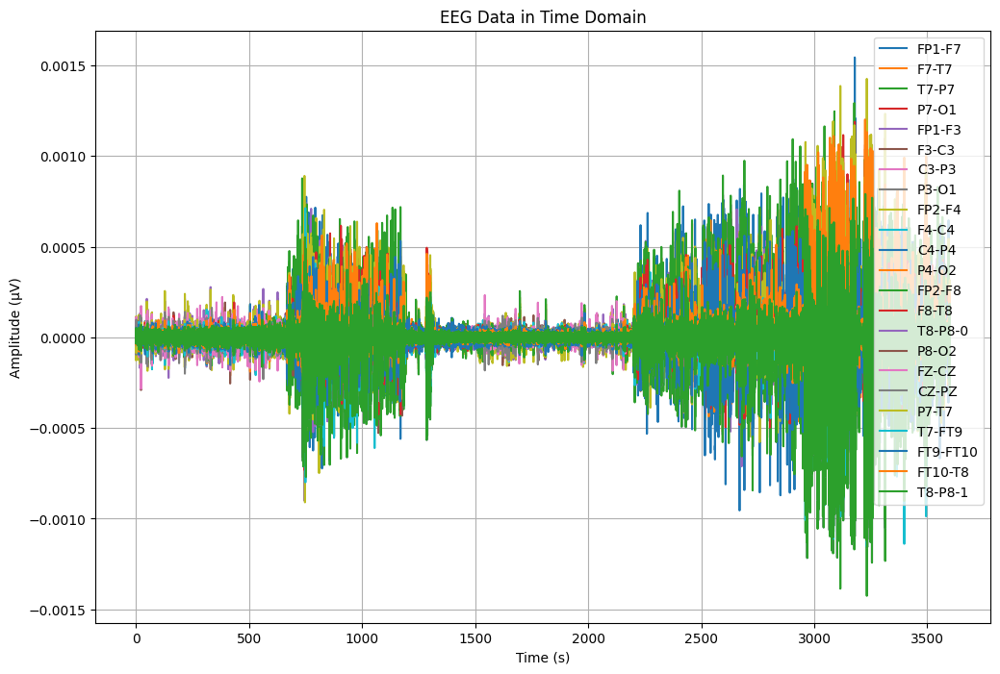

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df23['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df23[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


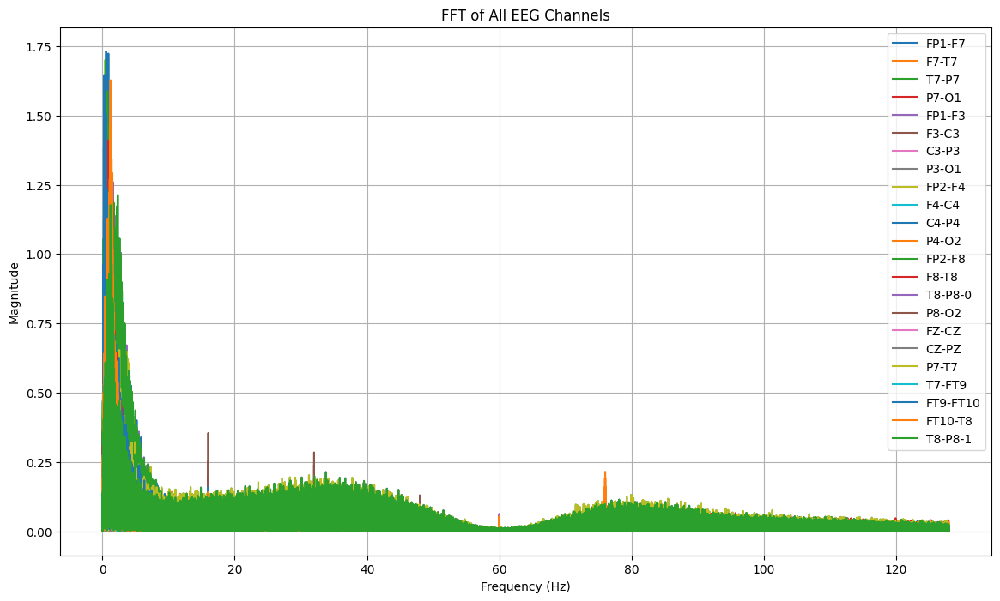

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df23[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_02.csv"
df23.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_02.csv


In [ ]:
#Import Data CSV
dataTA23 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_02.csv")
dataTA23


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,8.967033e-05,-1.953602e-07,-8.791209e-06,-5.333333e-05,-4.239316e-05,4.786325e-05,1.934066e-05,2.539683e-06,-1.248352e-04,1.699634e-05,...,2.402930e-05,-5.860806e-07,-5.274725e-06,6.036630e-05,9.181929e-06,-3.301587e-05,-2.598291e-05,-4.043956e-05,2.402930e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,4.278388e-05,-6.036630e-05,6.056166e-06,4.102564e-06,-6.446886e-06,-8.009768e-06,8.791209e-06,-1.953602e-07,2.930403e-06,1.191697e-05,...,6.583639e-05,-2.324786e-05,1.113553e-05,2.539683e-06,-5.665446e-06,4.473748e-05,-1.504274e-05,-3.692308e-05,6.583639e-05,3599.980469
921596,1.347985e-05,-1.543346e-05,1.777778e-05,1.953602e-07,-1.953602e-07,1.816850e-05,-2.539683e-06,5.860806e-07,4.884005e-06,1.621490e-05,...,6.974359e-05,3.321123e-06,1.308913e-05,4.493284e-06,-1.738706e-05,-4.102564e-06,1.973138e-05,-3.418803e-05,6.974359e-05,3599.984375
921597,7.228327e-06,1.230769e-05,-3.379731e-05,1.973138e-05,-1.934066e-05,7.619048e-06,1.758242e-06,1.543346e-05,-9.181929e-06,5.860806e-07,...,5.059829e-05,1.426129e-05,1.074481e-05,2.539683e-06,3.418803e-05,-1.699634e-05,1.934066e-05,-5.645910e-05,5.059829e-05,3599.988281
921598,2.148962e-06,-2.148962e-06,7.619048e-06,1.035409e-05,-2.012210e-05,3.418803e-05,-2.930403e-06,7.619048e-06,3.711844e-06,1.660562e-05,...,3.457875e-05,2.285714e-05,1.699634e-05,4.102564e-06,-7.228327e-06,-1.426129e-05,1.426129e-05,-3.887668e-05,3.457875e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA23[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA23[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA23[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data23, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP1-F7, Max Frequency: 0.56 Hz, Magnitude: 1.731759, Time: 3179.398438 s
Channel: FP2-F8, Max Frequency: 0.44 Hz, Magnitude: 1.700656, Time: 3177.253906 s
Channel: FT9-FT10, Max Frequency: 0.28 Hz, Magnitude: 1.646446, Time: 3179.433594 s
Channel: FT10-T8, Max Frequency: 1.21 Hz, Magnitude: 1.627248, Time: 3225.011719 s
Channel: FP2-F4, Max Frequency: 1.33 Hz, Magnitude: 1.468505, Time: 3011.042969 s
Channel: F7-T7, Max Frequency: 0.28 Hz, Magnitude: 1.446811, Time: 3494.750000 s
Channel: FP1-F3, Max Frequency: 1.33 Hz, Magnitude: 1.445375, Time: 744.402344 s
Channel: F8-T8, Max Frequency: 0.80 Hz, Magnitude: 1.410716, Time: 3179.429688 s
Channel: T7-FT9, Max Frequency: 1.15 Hz, Magnitude: 1.255282, Time: 3232.003906 s
Channel: T8-P8-0, Max Frequency: 1.21 Hz, Magnitude: 1.176548, Time: 3255.558594 s
Channel: T8-P8-1, Max Frequency: 1.21 Hz, Magnitude: 1.176548, Time: 3255.558594 s
Channel: P7-T7, M

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP1-F3, Max Frequency: 1.33 Hz, Magnitude: 1.445375, Time: 744.402344 s
Channel: FZ-CZ, Max Frequency: 1.30 Hz, Magnitude: 0.493772, Time: 766.671875 s
Channel: CZ-PZ, Max Frequency: 1.36 Hz, Magnitude: 0.333129, Time: 781.570312 s
Channel: FP2-F4, Max Frequency: 1.33 Hz, Magnitude: 1.468505, Time: 3011.042969 s
Channel: P3-O1, Max Frequency: 1.15 Hz, Magnitude: 0.241946, Time: 3038.113281 s
Channel: P4-O2, Max Frequency: 1.39 Hz, Magnitude: 0.322332, Time: 3038.113281 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 0.354941, Time: 3038.113281 s
Channel: F3-C3, Max Frequency: 0.40 Hz, Magnitude: 0.608901, Time: 3069.511719 s
Channel: F4-C4, Max Frequency: 0.32 Hz, Magnitude: 0.536517, Time: 3108.621094 s
Channel: FP2-F8, Max Frequency: 0.44 Hz, Magnitude: 1.700656, Time: 3177.253906 s
Channel: FP1-F7, Max Frequency: 0.56 Hz, Magnitude: 1.731759, Time: 3179.398438 

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 624   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 901    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut23 = dataTA23.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut23.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb03_02.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA23 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb03_02.csv")
TA23.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.711844e-06,0.000028,0.000004,-0.000009,0.000005,0.000007,1.367521e-06,0.000014,-0.000002,0.000040,...,-6.056166e-06,-0.000023,0.000029,-0.000011,-0.000004,1.953602e-07,0.000029,0.000016,-6.056166e-06,624.000000
1,1.367521e-06,0.000029,0.000011,-0.000008,0.000008,0.000008,1.953602e-07,0.000015,-0.000003,0.000037,...,-6.056166e-06,-0.000018,0.000032,-0.000008,-0.000010,-4.884005e-06,0.000033,0.000015,-6.056166e-06,624.003906
2,-5.860806e-07,0.000032,0.000013,-0.000008,0.000011,0.000009,3.321123e-06,0.000010,-0.000003,0.000038,...,-5.665446e-06,-0.000017,0.000033,-0.000007,-0.000012,-1.191697e-05,0.000028,0.000024,-5.665446e-06,624.007812
3,1.367521e-06,0.000032,0.000012,-0.000008,0.000010,0.000013,3.711844e-06,0.000009,-0.000003,0.000038,...,1.953602e-07,-0.000024,0.000032,-0.000004,-0.000011,-1.152625e-05,0.000025,0.000024,1.953602e-07,624.011719
4,3.321123e-06,0.000029,0.000011,-0.000006,0.000008,0.000018,1.367521e-06,0.000009,-0.000003,0.000035,...,1.758242e-06,-0.000025,0.000031,-0.000004,-0.000011,-1.113553e-05,0.000024,0.000022,1.758242e-06,624.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA23.shape

(70912, 24)

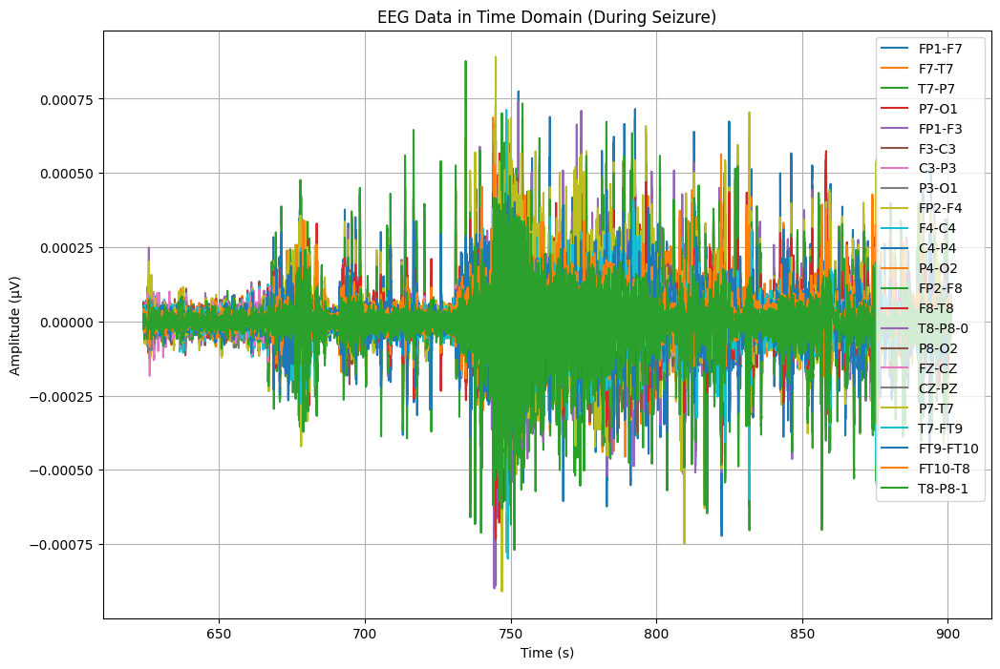

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA23['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA23.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA23[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


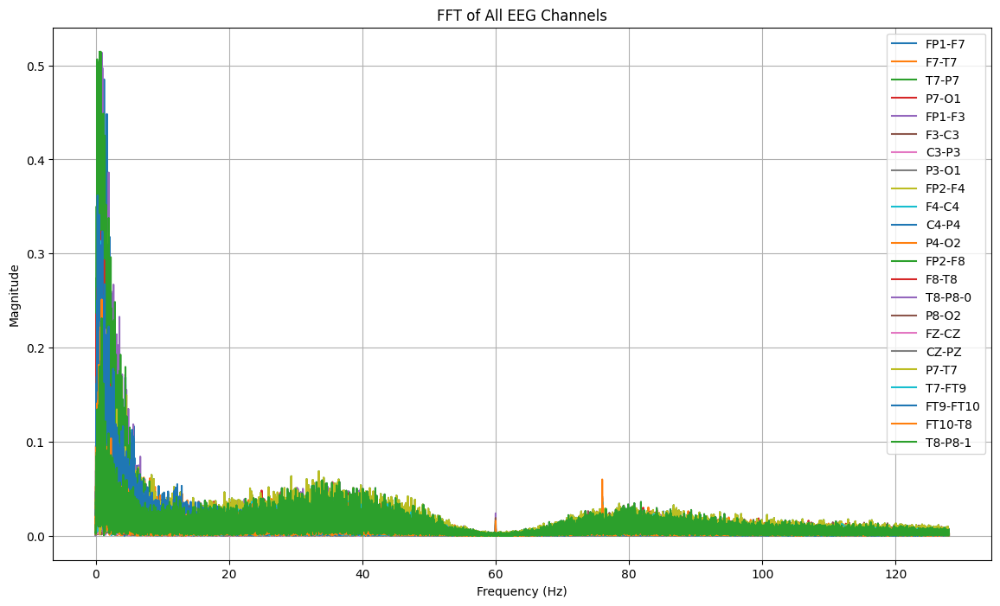

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA23[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 744:
        return "tidak kejang"
    elif 744 <= row['Time'] < 781:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_23 = TA23.copy()
TA_23['seizure'] = TA_23.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_23[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure        FP1-F7     F7-T7     T7-P7     P7-O1  \
0  624.000000  tidak kejang  3.711844e-06  0.000028  0.000004 -0.000009   
1  624.003906  tidak kejang  1.367521e-06  0.000029  0.000011 -0.000008   
2  624.007812  tidak kejang -5.860806e-07  0.000032  0.000013 -0.000008   
3  624.011719  tidak kejang  1.367521e-06  0.000032  0.000012 -0.000008   
4  624.015625  tidak kejang  3.321123e-06  0.000029  0.000011 -0.000006   

     FP1-F3     F3-C3         C3-P3     P3-O1  ...     F8-T8       T8-P8-0  \
0  0.000005  0.000007  1.367521e-06  0.000014  ...  0.000042 -6.056166e-06   
1  0.000008  0.000008  1.953602e-07  0.000015  ...  0.000041 -6.056166e-06   
2  0.000011  0.000009  3.321123e-06  0.000010  ...  0.000043 -5.665446e-06   
3  0.000010  0.000013  3.711844e-06  0.000009  ...  0.000047  1.953602e-07   
4  0.000008  0.000018  1.367521e-06  0.000009  ...  0.000050  1.758242e-06   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7        T7-FT9  FT9-FT10   FT10-T8  \
0

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_23['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,9472


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_23)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 277.0 detik


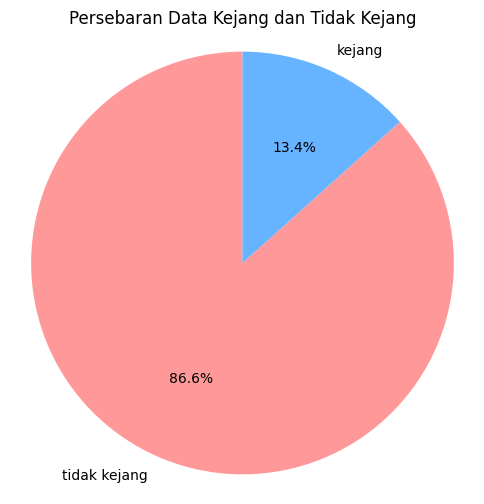

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_23['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_23.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb03_02.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_23.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_23['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.91      0.75      0.82      1937
tidak kejang       0.96      0.99      0.97     12246

    accuracy                           0.96     14183
   macro avg       0.94      0.87      0.90     14183
weighted avg       0.95      0.96      0.95     14183

Akurasi: 0.9557216385814002
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.91      0.75      0.82      1937
tidak kejang       0.96      0.99      0.97     12246

    accuracy                           0.96     14183
   macro avg       0.94      0.87      0.90     14183
weighted avg       0.95      0.96      0.95     14183



# DATA 14 (chb03_34)
akurasi = 0.963

In [ ]:
# mengimport file edf
file26 = "/content/drive/MyDrive/TA/EDF/chb03_34.edf"
data26 = mne.io.read_raw_edf(file26) # membaca file edf dan menyimpannya di data
data26


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_34.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-211-095119b44043>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data26 = mne.io.read_raw_edf(file26) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_34.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data26.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data26.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data26.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df26= pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df26['Time'] = times  # Menambahkan kolom waktu
df26.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.473748e-05,-8.009768e-06,6.544567e-05,1.758242e-06,7.521368e-05,-7.638584e-05,4.590965e-05,-3.028083e-05,3.379731e-05,4.083028e-05,...,6.896215e-05,-3.614164e-05,1.269841e-05,2.318926e-04,-6.505495e-05,1.615629e-04,-1.408547e-04,2.285714e-05,6.896215e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,...,5.860806e-07,1.953602e-07,9.768010e-07,5.665446e-06,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,2.539683e-06,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df26.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df26.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.142705e-07,2.008191e-07,1.040636e-07,2.927406e-07,1.236056e-07,2.847078e-07,1.858245e-07,2.276786e-07,2.106749e-07,1.979463e-07,...,1.727857e-07,2.128561e-07,1.991466e-07,1.892073e-07,2.866567e-07,1.584063e-07,2.163059e-07,1.945551e-07,1.727857e-07,1799.998047
std,4.936661e-05,4.861904e-05,4.406845e-05,4.959530e-05,5.116416e-05,4.332370e-05,2.682343e-05,4.496633e-05,4.622006e-05,7.857988e-05,...,3.189693e-05,2.630969e-05,4.125162e-05,7.787424e-05,4.406845e-05,4.104697e-05,3.736968e-05,3.054710e-05,3.189693e-05,1039.231048
min,-1.067253e-03,-8.027350e-04,-9.812943e-04,-1.347009e-03,-1.071160e-03,-1.157118e-03,-4.897680e-04,-1.388425e-03,-9.488645e-04,-1.515800e-03,...,-7.957021e-04,-9.734799e-04,-1.233700e-03,-1.723272e-03,-1.145788e-03,-9.594139e-04,-1.066862e-03,-5.108669e-04,-7.957021e-04,0.000000
25%,-1.074481e-05,-1.465201e-05,-1.347985e-05,-1.543346e-05,-1.621490e-05,-1.777778e-05,-9.181929e-06,-9.572650e-06,-1.426129e-05,-1.426129e-05,...,-9.963370e-06,-9.572650e-06,-1.465201e-05,-2.442002e-05,-1.543346e-05,-1.035409e-05,-1.191697e-05,-8.400488e-06,-9.963370e-06,899.999023
50%,1.953602e-07,1.953602e-07,9.768010e-07,-9.768010e-07,9.768010e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.074481e-05,1.465201e-05,1.582418e-05,1.347985e-05,1.777778e-05,1.582418e-05,9.572650e-06,9.572650e-06,1.426129e-05,1.504274e-05,...,1.074481e-05,9.572650e-06,1.504274e-05,2.520147e-05,1.387057e-05,1.152625e-05,1.230769e-05,8.791209e-06,1.074481e-05,2699.997070
max,9.601954e-04,9.633211e-04,1.146178e-03,1.230183e-03,1.157509e-03,1.137973e-03,9.621490e-04,1.365372e-03,1.060611e-03,1.541978e-03,...,5.425153e-04,9.293284e-04,1.318486e-03,1.657241e-03,9.816850e-04,1.058266e-03,8.062515e-04,8.558730e-04,5.425153e-04,3599.996094


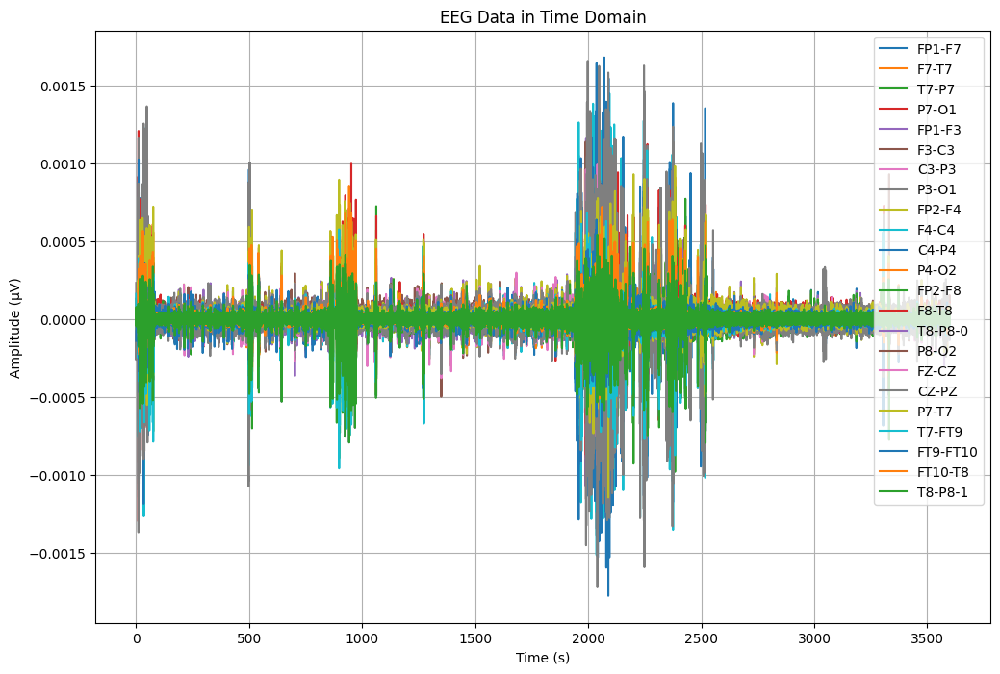

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya

time = df26['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df26[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


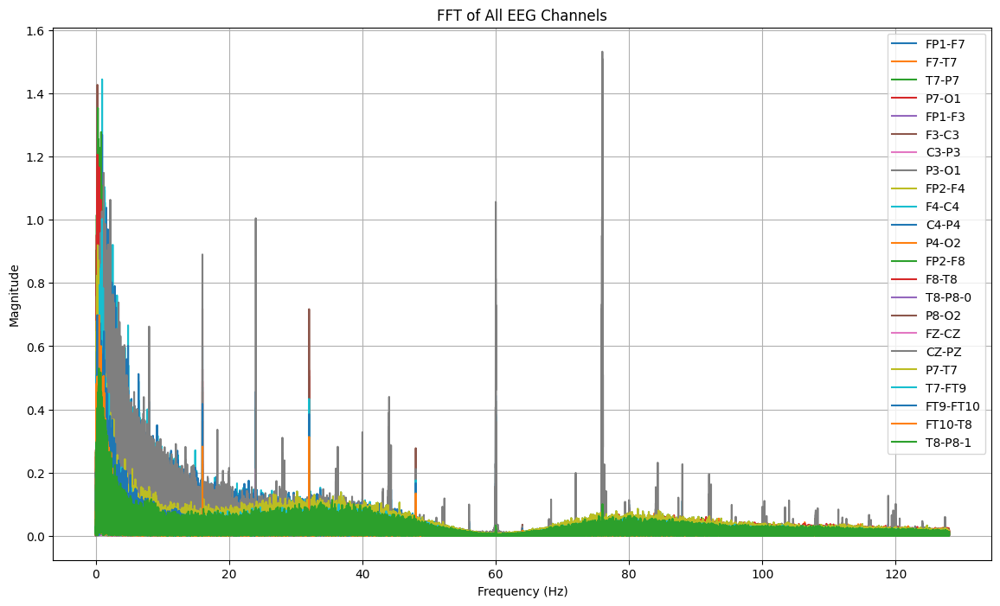

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df26[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_34.csv"
df26.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_34.csv


In [ ]:
#Import Data CSV
dataTA26 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_34.csv")
dataTA26


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.473748e-05,-8.009768e-06,6.544567e-05,1.758242e-06,7.521368e-05,-7.638584e-05,4.590965e-05,-3.028083e-05,3.379731e-05,4.083028e-05,...,6.896215e-05,-3.614164e-05,1.269841e-05,2.318926e-04,-6.505495e-05,1.615629e-04,-1.408547e-04,2.285714e-05,6.896215e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,...,5.860806e-07,1.953602e-07,9.768010e-07,5.665446e-06,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,2.539683e-06,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-9.768010e-07,1.152625e-05,-2.930403e-06,-1.660562e-05,6.349206e-05,-5.020757e-05,-7.619048e-06,-1.426129e-05,4.825397e-05,-4.942613e-05,...,1.074481e-05,-1.855922e-05,-3.184371e-05,-8.771673e-05,3.321123e-06,-2.989011e-05,8.791209e-06,9.768010e-07,1.074481e-05,3599.980469
921596,-6.446886e-06,1.230769e-05,-7.619048e-06,-1.934066e-05,5.450549e-05,-4.981685e-05,-9.572650e-06,-1.582418e-05,4.356532e-05,-2.910867e-05,...,1.074481e-05,-2.285714e-05,-1.660562e-05,9.768010e-07,8.009768e-06,-2.949939e-05,1.308913e-05,-1.953602e-07,1.074481e-05,3599.984375
921597,-8.791209e-06,5.665446e-06,-9.572650e-06,-1.269841e-05,4.473748e-05,-5.137973e-05,-1.074481e-05,-7.619048e-06,2.949939e-05,-1.699634e-05,...,8.400488e-06,-1.621490e-05,-1.387057e-05,3.028083e-05,9.963370e-06,-2.598291e-05,1.269841e-05,1.953602e-07,8.400488e-06,3599.988281
921598,-9.181929e-06,5.274725e-06,-4.884005e-06,-1.582418e-05,3.575092e-05,-4.708181e-05,-5.274725e-06,-7.228327e-06,1.855922e-05,-2.324786e-05,...,8.791209e-06,-2.051282e-05,-2.871795e-05,1.347985e-05,5.274725e-06,-2.207570e-05,1.387057e-05,-9.768010e-07,8.791209e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA26[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA26[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA26[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data26, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: CZ-PZ, Max Frequency: 75.99 Hz, Magnitude: 1.532156, Time: 2040.523438 s
Channel: F4-C4, Max Frequency: 0.95 Hz, Magnitude: 1.444332, Time: 2040.359375 s
Channel: F3-C3, Max Frequency: 0.25 Hz, Magnitude: 1.427214, Time: 1990.507812 s
Channel: FP2-F8, Max Frequency: 0.32 Hz, Magnitude: 1.353743, Time: 1997.683594 s
Channel: C4-P4, Max Frequency: 0.95 Hz, Magnitude: 1.269256, Time: 2089.101562 s
Channel: F8-T8, Max Frequency: 0.25 Hz, Magnitude: 1.206076, Time: 951.996094 s
Channel: P7-O1, Max Frequency: 0.40 Hz, Magnitude: 1.149650, Time: 2036.972656 s
Channel: FP1-F3, Max Frequency: 0.32 Hz, Magnitude: 1.111533, Time: 1990.507812 s
Channel: T7-FT9, Max Frequency: 0.93 Hz, Magnitude: 1.002980, Time: 1953.351562 s
Channel: FP1-F7, Max Frequency: 0.35 Hz, Magnitude: 0.984828, Time: 2056.566406 s
Channel: P3-O1, Max Frequency: 1.06 Hz, Magnitude: 0.949817, Time: 2036.976562 s
Channel: P7-T7, Max Freque

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT10-T8, Max Frequency: 0.54 Hz, Magnitude: 0.697410, Time: 942.441406 s
Channel: F8-T8, Max Frequency: 0.25 Hz, Magnitude: 1.206076, Time: 951.996094 s
Channel: T7-FT9, Max Frequency: 0.93 Hz, Magnitude: 1.002980, Time: 1953.351562 s
Channel: FT9-FT10, Max Frequency: 0.24 Hz, Magnitude: 0.698443, Time: 1953.355469 s
Channel: F7-T7, Max Frequency: 0.40 Hz, Magnitude: 0.912188, Time: 1986.488281 s
Channel: FP1-F3, Max Frequency: 0.32 Hz, Magnitude: 1.111533, Time: 1990.507812 s
Channel: F3-C3, Max Frequency: 0.25 Hz, Magnitude: 1.427214, Time: 1990.507812 s
Channel: FP2-F8, Max Frequency: 0.32 Hz, Magnitude: 1.353743, Time: 1997.683594 s
Channel: P7-O1, Max Frequency: 0.40 Hz, Magnitude: 1.149650, Time: 2036.972656 s
Channel: P3-O1, Max Frequency: 1.06 Hz, Magnitude: 0.949817, Time: 2036.976562 s
Channel: F4-C4, Max Frequency: 0.95 Hz, Magnitude: 1.444332, Time: 2040.359

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1866   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2210    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut26 = dataTA26.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut26.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb03_34.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA26 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb03_34.csv")
TA26.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000009,-0.000012,0.000015,-0.000015,-0.000031,-0.000018,0.000019,0.000026,-0.000050,-1.074481e-05,...,0.000023,0.000022,-0.000092,0.000023,-0.000014,0.000006,-0.000022,-0.000019,0.000023,1866.000000
1,0.000006,-0.000004,0.000009,-0.000020,-0.000033,-0.000014,0.000016,0.000021,-0.000050,1.953602e-07,...,0.000021,0.000018,-0.000083,0.000073,-0.000009,-0.000002,-0.000019,-0.000019,0.000021,1866.003906
2,0.000001,0.000006,0.000005,-0.000024,-0.000035,-0.000011,0.000015,0.000019,-0.000046,1.621490e-05,...,0.000017,0.000013,-0.000076,0.000106,-0.000004,-0.000008,-0.000017,-0.000014,0.000017,1866.007812
3,0.000003,0.000018,-0.000010,-0.000019,-0.000030,-0.000014,0.000013,0.000023,-0.000043,1.953602e-07,...,0.000008,0.000023,-0.000086,0.000049,0.000010,-0.000026,-0.000015,-0.000012,0.000008,1866.011719
4,0.000001,0.000018,-0.000009,-0.000021,-0.000027,-0.000016,0.000011,0.000021,-0.000036,-6.837607e-06,...,0.000003,0.000025,-0.000088,0.000033,0.000009,-0.000025,-0.000012,-0.000010,0.000003,1866.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA26.shape

(88064, 24)

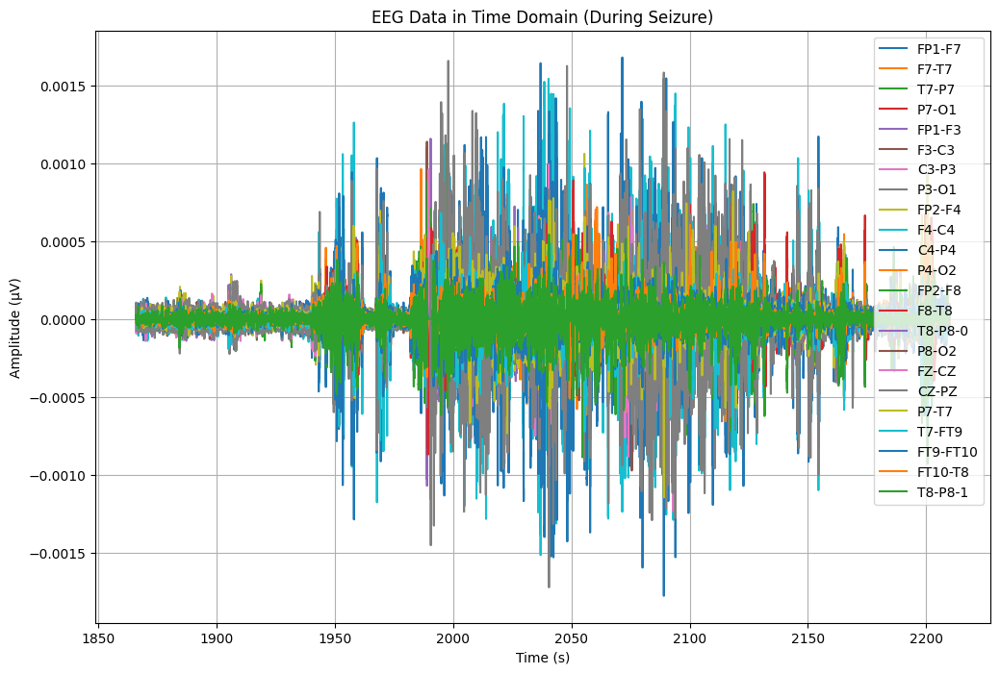

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA26['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA26.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA26[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


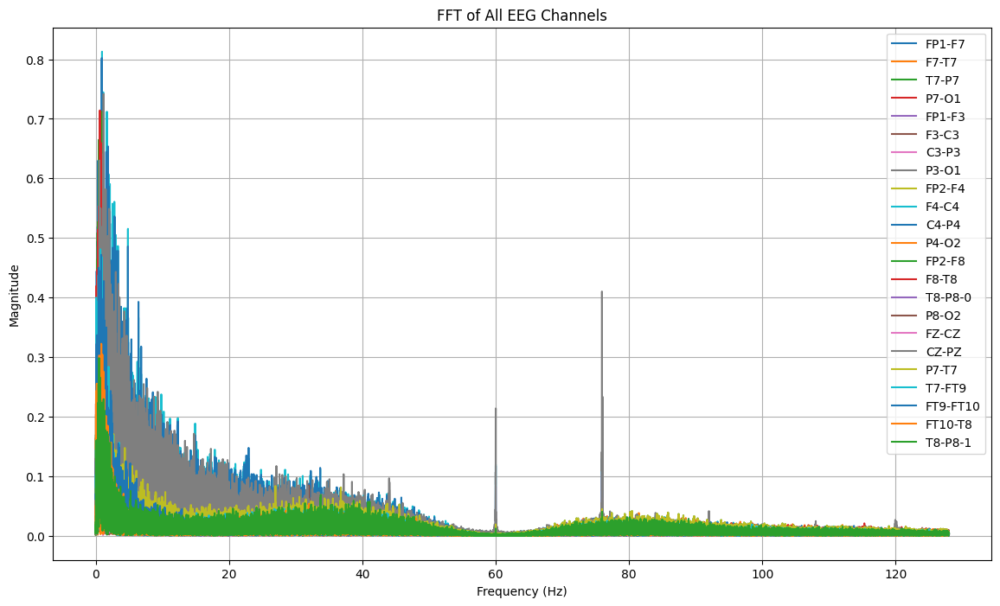

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA26[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1986:
        return "tidak kejang"
    elif 1986 <= row['Time'] < 2090:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_26 = TA26.copy()
TA_26['seizure'] = TA_26.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_26[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1866.000000  tidak kejang  0.000009 -0.000012  0.000015 -0.000015   
1  1866.003906  tidak kejang  0.000006 -0.000004  0.000009 -0.000020   
2  1866.007812  tidak kejang  0.000001  0.000006  0.000005 -0.000024   
3  1866.011719  tidak kejang  0.000003  0.000018 -0.000010 -0.000019   
4  1866.015625  tidak kejang  0.000001  0.000018 -0.000009 -0.000021   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000031 -0.000018  0.000019  0.000026  ... -0.000021  0.000023  0.000022   
1 -0.000033 -0.000014  0.000016  0.000021  ... -0.000020  0.000021  0.000018   
2 -0.000035 -0.000011  0.000015  0.000019  ... -0.000016  0.000017  0.000013   
3 -0.000030 -0.000014  0.000013  0.000023  ... -0.000018  0.000008  0.000023   
4 -0.000027 -0.000016  0.000011  0.000021  ... -0.000017  0.000003  0.000025   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0 -0.000092 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_26['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,26624


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_26)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 344.0 detik


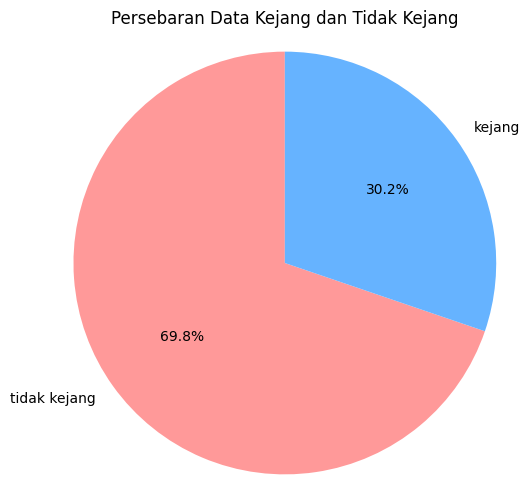

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_26['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_26.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb03_34.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_26.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_26['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.94      0.94      0.94      5295
tidak kejang       0.98      0.97      0.97     12318

    accuracy                           0.96     17613
   macro avg       0.96      0.96      0.96     17613
weighted avg       0.96      0.96      0.96     17613

Akurasi: 0.963776755805371
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.94      0.94      0.94      5295
tidak kejang       0.98      0.97      0.97     12318

    accuracy                           0.96     17613
   macro avg       0.96      0.96      0.96     17613
weighted avg       0.96      0.96      0.96     17613



# DATA 07 (chb09_06)
akurasi = 0.972

In [ ]:
# mengimport file edf
file7 = "/content/drive/MyDrive/TA/EDF/chb09_06.edf"
data7 = mne.io.read_raw_edf(file7) # membaca file edf dan menyimpannya di data
data7


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb09_06.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-3-7aeb0fcbd71a>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data7 = mne.io.read_raw_edf(file7) # membaca file edf dan menyimpannya di data


<RawEDF | chb09_06.edf, 24 x 3686144 (14399.0 s), ~28 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data7.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data7.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data7.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1',
 'VNS']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df7 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df7['Time'] = times  # Menambahkan kolom waktu
df7.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,-1.048889e-03,1.025055e-03,-1.024664e-03,1.953602e-07,-1.048889e-03,1.953602e-07,1.953602e-07,1.953602e-07,3.842735e-04,1.953602e-07,...,-1.599805e-03,6.081563e-04,4.456166e-04,1.025055e-03,-1.024664e-03,1.953602e-07,1.600195e-03,1.953602e-07,1.953602e-07,0.000000
1,-5.860806e-07,9.768010e-07,1.953602e-07,-5.860806e-07,-5.860806e-07,5.860806e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,8.009768e-06,-7.619048e-06,1.367521e-06,6.446886e-06,8.009768e-06,-3.321123e-06,3.711844e-06,1.953602e-07,2.148962e-06,1.953602e-07,...,5.665446e-06,2.148962e-06,2.930403e-06,-9.768010e-07,6.837607e-06,9.768010e-07,-5.274725e-06,1.953602e-07,1.953602e-07,0.007812
3,-5.860806e-07,-1.758242e-06,-1.152625e-05,1.387057e-05,-5.860806e-07,-7.228327e-06,7.619048e-06,1.953602e-07,8.400488e-06,1.758242e-06,...,-1.543346e-05,1.973138e-05,7.619048e-06,1.191697e-05,1.953602e-07,1.758242e-06,1.582418e-05,1.953602e-07,1.953602e-07,0.011719
4,-8.341880e-05,7.912088e-05,-4.004884e-05,-3.809524e-05,-8.341880e-05,2.129426e-05,-2.090354e-05,1.953602e-07,-5.274725e-06,3.711844e-06,...,-8.263736e-05,3.711844e-06,-1.113553e-05,4.043956e-05,-7.326007e-05,-4.884005e-06,8.302808e-05,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df7.shape)


(3686400, 24)


In [ ]:
# mendeskripsikan data
df7.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,...,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06
mean,2.879704e-07,2.362369e-07,1.929739e-07,1.884252e-07,2.927629e-07,2.055092e-07,2.088306e-07,1.915765e-07,2.973331e-07,2.146239e-07,...,1.722146e-07,1.868181e-07,2.313862e-07,1.980196e-07,1.977464e-07,1.808661e-07,2.043195e-07,2.020763e-07,1.722146e-07,7.199998e+03
std,9.939634e-05,4.852827e-05,4.951717e-05,5.863301e-05,9.039525e-05,3.847236e-05,2.937619e-05,5.118047e-05,8.668524e-05,4.680184e-05,...,3.085049e-05,2.767544e-05,4.414003e-05,3.966303e-05,4.951717e-05,3.168110e-05,6.825429e-05,3.114863e-05,3.085049e-05,4.156923e+03
min,-9.637118e-04,-8.378999e-04,-1.695922e-03,-2.446886e-03,-1.038730e-03,-1.114921e-03,-1.308327e-03,-1.570891e-03,-7.714774e-04,-8.640781e-04,...,-6.304274e-04,-5.694750e-04,-1.343101e-03,-1.808059e-03,-1.658413e-03,-1.275897e-03,-1.524396e-03,-1.410305e-03,-6.304274e-04,0.000000e+00
25%,-2.012210e-05,-1.543346e-05,-1.543346e-05,-1.269841e-05,-2.051282e-05,-1.465201e-05,-1.191697e-05,-1.426129e-05,-2.090354e-05,-1.621490e-05,...,-1.230769e-05,-1.230769e-05,-1.426129e-05,-1.621490e-05,-1.543346e-05,-1.035409e-05,-1.816850e-05,-1.113553e-05,-1.230769e-05,3.599999e+03
50%,-9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-1.367521e-06,-1.953602e-07,1.953602e-07,1.953602e-07,-1.367521e-06,-1.953602e-07,...,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,7.199998e+03
75%,1.465201e-05,1.426129e-05,1.582418e-05,1.308913e-05,1.465201e-05,1.387057e-05,1.230769e-05,1.465201e-05,1.504274e-05,1.543346e-05,...,1.308913e-05,1.269841e-05,1.347985e-05,1.660562e-05,1.582418e-05,1.113553e-05,1.816850e-05,1.113553e-05,1.308913e-05,1.080000e+04
max,1.209084e-03,1.284493e-03,1.658803e-03,2.324200e-03,1.145006e-03,1.434139e-03,1.312234e-03,1.881905e-03,1.082491e-03,9.242491e-04,...,5.870574e-04,8.214896e-04,1.292698e-03,1.605275e-03,1.696313e-03,9.035409e-04,1.232527e-03,1.517753e-03,5.870574e-04,1.440000e+04


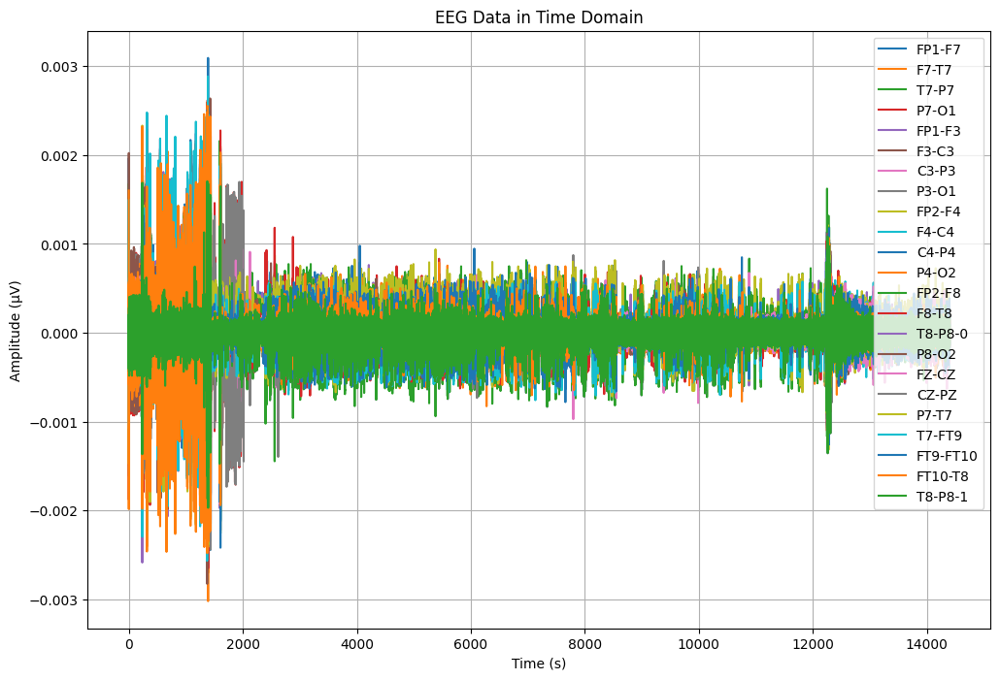

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df7['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df7[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


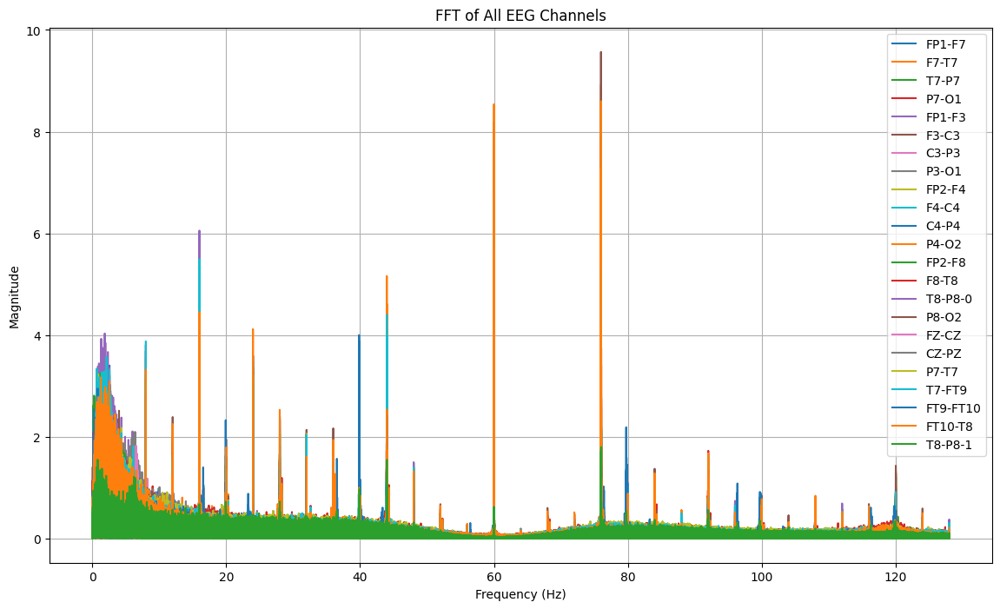

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df7[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_06.csv"
df7.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_06.csv


In [ ]:
#Import Data CSV
dataTA7 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_06.csv")
dataTA7


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,-1.048889e-03,1.025055e-03,-1.024664e-03,1.953602e-07,-1.048889e-03,1.953602e-07,1.953602e-07,1.953602e-07,3.842735e-04,1.953602e-07,...,-1.599805e-03,6.081563e-04,4.456166e-04,1.025055e-03,-1.024664e-03,1.953602e-07,1.600195e-03,1.953602e-07,1.953602e-07,0.000000
1,-5.860806e-07,9.768010e-07,1.953602e-07,-5.860806e-07,-5.860806e-07,5.860806e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,8.009768e-06,-7.619048e-06,1.367521e-06,6.446886e-06,8.009768e-06,-3.321123e-06,3.711844e-06,1.953602e-07,2.148962e-06,1.953602e-07,...,5.665446e-06,2.148962e-06,2.930403e-06,-9.768010e-07,6.837607e-06,9.768010e-07,-5.274725e-06,1.953602e-07,1.953602e-07,0.007812
3,-5.860806e-07,-1.758242e-06,-1.152625e-05,1.387057e-05,-5.860806e-07,-7.228327e-06,7.619048e-06,1.953602e-07,8.400488e-06,1.758242e-06,...,-1.543346e-05,1.973138e-05,7.619048e-06,1.191697e-05,1.953602e-07,1.758242e-06,1.582418e-05,1.953602e-07,1.953602e-07,0.011719
4,-8.341880e-05,7.912088e-05,-4.004884e-05,-3.809524e-05,-8.341880e-05,2.129426e-05,-2.090354e-05,1.953602e-07,-5.274725e-06,3.711844e-06,...,-8.263736e-05,3.711844e-06,-1.113553e-05,4.043956e-05,-7.326007e-05,-4.884005e-06,8.302808e-05,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3686139,-4.043956e-05,-3.653236e-05,-5.216117e-05,-5.216117e-05,-2.871795e-05,-7.990232e-05,-2.129426e-05,-5.098901e-05,-9.435897e-05,-1.181929e-04,...,1.426129e-05,-1.088156e-04,-1.035409e-05,5.255189e-05,-1.465201e-05,-5.665446e-06,-1.699634e-05,-1.201465e-04,-2.539683e-06,14398.980469
3686140,-3.692308e-05,-3.457875e-05,-5.294261e-05,-6.622711e-05,-2.363858e-05,-8.693529e-05,-2.402930e-05,-5.528694e-05,-9.435897e-05,-1.193651e-04,...,8.791209e-06,-1.146764e-04,-1.230769e-05,5.333333e-05,-1.816850e-05,-1.387057e-05,-2.090354e-05,-1.205372e-04,5.860806e-07,14398.984375
3686141,-3.614164e-05,-3.067155e-05,-5.137973e-05,-7.482295e-05,-1.934066e-05,-9.396825e-05,-2.676435e-05,-5.255189e-05,-9.474969e-05,-1.213187e-04,...,1.504274e-05,-1.221001e-04,-1.582418e-05,5.177045e-05,-2.168498e-05,-2.715507e-05,-2.129426e-05,-1.209280e-04,-2.930403e-06,14398.988281
3686142,-3.770452e-05,-2.559219e-05,-4.317460e-05,-8.224664e-05,-1.621490e-05,-9.904762e-05,-2.129426e-05,-5.216117e-05,-9.553114e-05,-1.174115e-04,...,2.363858e-05,-1.252259e-04,-1.308913e-05,4.356532e-05,-2.363858e-05,-3.614164e-05,-2.168498e-05,-1.135043e-04,-8.400488e-06,14398.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA7[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA7[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA7[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data7, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: P8-O2, Max Frequency: 75.98 Hz, Magnitude: 9.568151, Time: 1373.558594 s
Channel: P4-O2, Max Frequency: 75.98 Hz, Magnitude: 8.919837, Time: 1377.167969 s
Channel: FT10-T8, Max Frequency: 75.98 Hz, Magnitude: 8.599530, Time: 1381.652344 s
Channel: F8-T8, Max Frequency: 60.01 Hz, Magnitude: 7.638956, Time: 1391.789062 s
Channel: FP1-F3, Max Frequency: 60.01 Hz, Magnitude: 7.181877, Time: 1385.785156 s
Channel: FP1-F7, Max Frequency: 60.01 Hz, Magnitude: 6.998820, Time: 1390.445312 s
Channel: F7-T7, Max Frequency: 60.01 Hz, Magnitude: 6.967198, Time: 1390.445312 s
Channel: P7-O1, Max Frequency: 75.98 Hz, Magnitude: 6.705325, Time: 1382.019531 s
Channel: T7-FT9, Max Frequency: 60.01 Hz, Magnitude: 6.655751, Time: 1386.593750 s
Channel: P7-T7, Max Frequency: 60.01 Hz, Magnitude: 6.343484, Time: 1390.445312 s
Channel: T7-P7, Max Frequency: 60.01 Hz, Magnitude: 6.343484, Time: 1390.445312 s
Channel: C4-P4

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: P3-O1, Max Frequency: 75.98 Hz, Magnitude: 5.052214, Time: 1370.339844 s
Channel: P8-O2, Max Frequency: 75.98 Hz, Magnitude: 9.568151, Time: 1373.558594 s
Channel: CZ-PZ, Max Frequency: 0.65 Hz, Magnitude: 1.223143, Time: 1376.765625 s
Channel: P4-O2, Max Frequency: 75.98 Hz, Magnitude: 8.919837, Time: 1377.167969 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 1.995546, Time: 1380.203125 s
Channel: FT10-T8, Max Frequency: 75.98 Hz, Magnitude: 8.599530, Time: 1381.652344 s
Channel: P7-O1, Max Frequency: 75.98 Hz, Magnitude: 6.705325, Time: 1382.019531 s
Channel: FP1-F3, Max Frequency: 60.01 Hz, Magnitude: 7.181877, Time: 1385.785156 s
Channel: FP2-F4, Max Frequency: 1.17 Hz, Magnitude: 2.403643, Time: 1386.582031 s
Channel: T7-FT9, Max Frequency: 60.01 Hz, Magnitude: 6.655751, Time: 1386.593750 s
Channel: C4-P4, Max Frequency: 60.01 Hz, Magnitude: 6.311645, Time: 

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1250   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1512    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut7 = dataTA7.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut7.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb09_06.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA7 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb09_06.csv")
TA7.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,-0.000137,0.000143,0.000153,-0.000434,-0.000290,0.000537,-0.000496,-0.000024,0.000016,0.000022,...,-0.000219,-0.000004,1.953602e-07,-0.000152,-0.000377,0.000126,0.000259,0.000041,0.000055,1250.000000
1,0.000122,-0.000116,0.000218,-0.000180,0.000046,0.000240,-0.000177,-0.000064,0.000015,0.000021,...,0.000054,-0.000004,1.953602e-07,-0.000217,-0.000008,0.000178,-0.000162,0.000040,-0.000027,1250.003906
2,0.000244,-0.000239,0.000400,-0.000259,0.000153,0.000229,-0.000221,-0.000012,0.000015,0.000021,...,0.000139,-0.000004,1.953602e-07,-0.000399,0.000128,0.000074,-0.000195,0.000039,-0.000021,1250.007812
3,-0.000071,0.000076,0.000205,-0.000387,-0.000183,0.000461,-0.000308,-0.000146,0.000015,0.000021,...,-0.000091,-0.000003,1.953602e-07,-0.000205,-0.000027,-0.000035,0.000070,0.000037,-0.000083,1250.011719
4,0.000150,-0.000144,0.000409,-0.000407,0.000024,0.000514,-0.000548,0.000019,0.000014,0.000020,...,0.000161,-0.000003,1.953602e-07,-0.000408,-0.000080,0.000145,-0.000057,0.000036,-0.000054,1250.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA7.shape


(67072, 25)

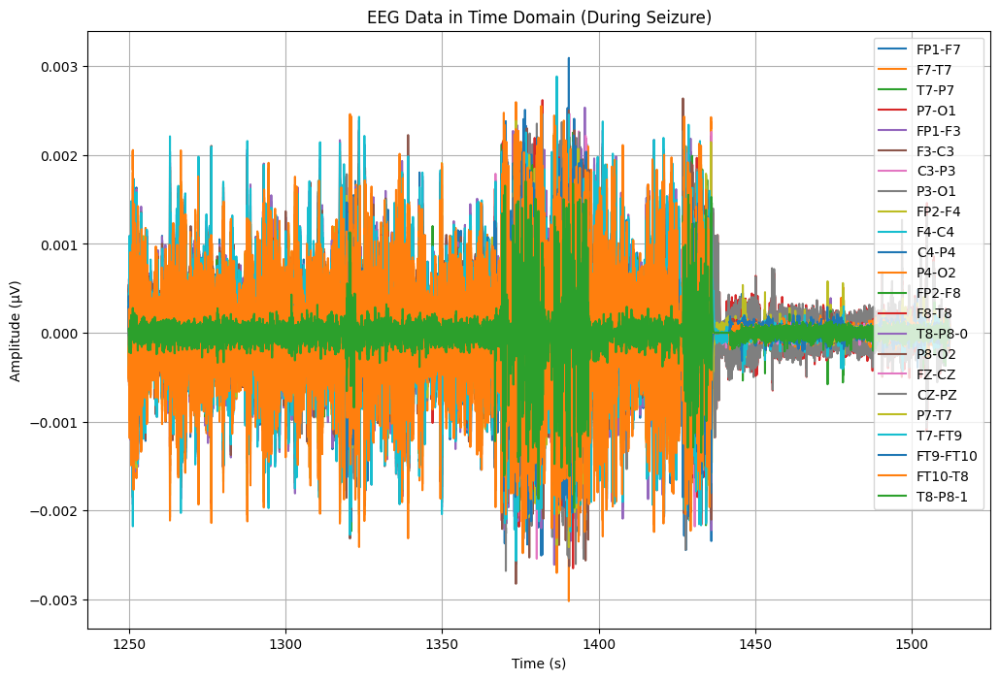

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA7['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA7.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA7[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


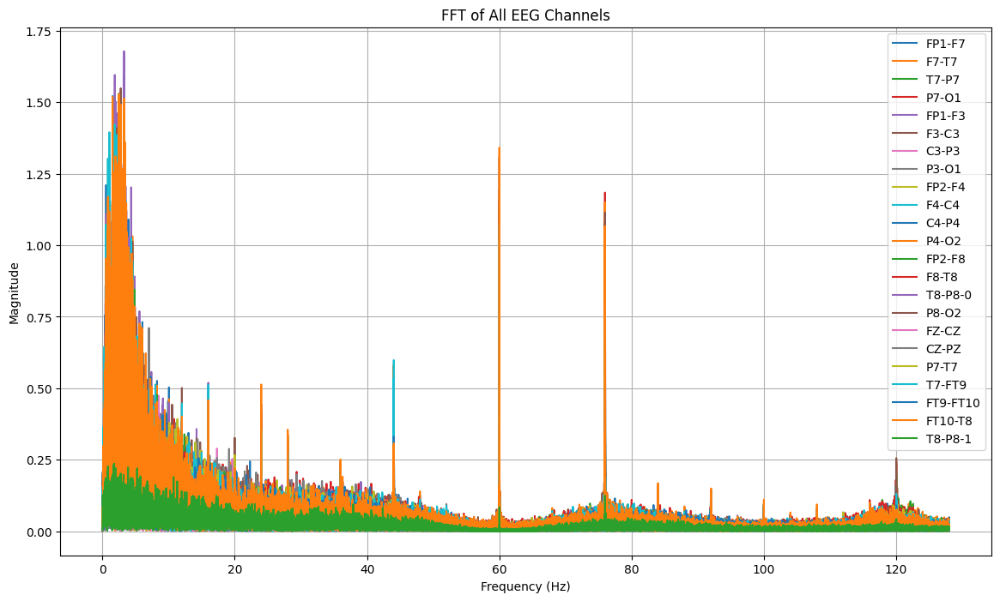

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA7[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1370:
        return "tidak kejang"
    elif 1370 <= row['Time'] < 1392:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_7 = TA7.copy()
TA_7['seizure'] = TA_7.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_7[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1250.000000  tidak kejang -0.000137  0.000143  0.000153 -0.000434   
1  1250.003906  tidak kejang  0.000122 -0.000116  0.000218 -0.000180   
2  1250.007812  tidak kejang  0.000244 -0.000239  0.000400 -0.000259   
3  1250.011719  tidak kejang -0.000071  0.000076  0.000205 -0.000387   
4  1250.015625  tidak kejang  0.000150 -0.000144  0.000409 -0.000407   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000290  0.000537 -0.000496 -0.000024  ... -0.000282  0.000041 -0.000219   
1  0.000046  0.000240 -0.000177 -0.000064  ... -0.000255  0.000040  0.000054   
2  0.000153  0.000229 -0.000221 -0.000012  ... -0.000298  0.000039  0.000139   
3 -0.000183  0.000461 -0.000308 -0.000146  ... -0.000233  0.000037 -0.000091   
4  0.000024  0.000514 -0.000548  0.000019  ... -0.000316  0.000036  0.000161   

      FZ-CZ         CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0 -0.000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_7['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,5632


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_7)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 262.0 detik


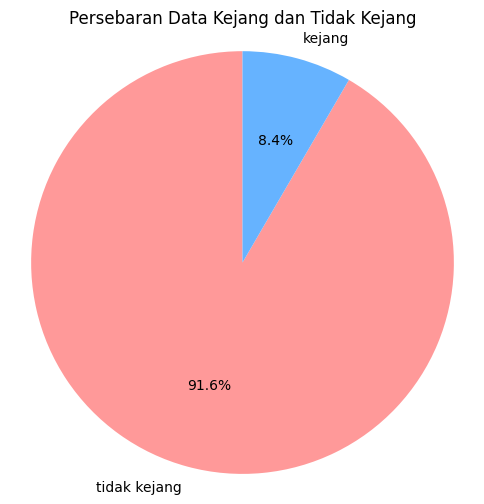

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_7['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_7.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb09_06.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_7.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_7['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.92      0.75      0.83      1176
tidak kejang       0.98      0.99      0.98     12239

    accuracy                           0.97     13415
   macro avg       0.95      0.87      0.91     13415
weighted avg       0.97      0.97      0.97     13415

Akurasi: 0.9723443906075289
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.92      0.75      0.83      1176
tidak kejang       0.98      0.99      0.98     12239

    accuracy                           0.97     13415
   macro avg       0.95      0.87      0.91     13415
weighted avg       0.97      0.97      0.97     13415



# DATA 8 (chb09_08)
akurasi = 0.979

In [ ]:
# mengimport file edf
file8 = "/content/drive/MyDrive/TA/EDF/chb09_08.edf"
data8 = mne.io.read_raw_edf(file8) # membaca file edf dan menyimpannya di data
data8


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb09_08.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-49-4e378dd2e49f>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data8 = mne.io.read_raw_edf(file8) # membaca file edf dan menyimpannya di data


<RawEDF | chb09_08.edf, 24 x 3686400 (14400.0 s), ~28 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data8.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data8.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data8.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1',
 'VNS']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df8 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df8['Time'] = times  # Menambahkan kolom waktu
df8.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,5.860806e-07,6.837607e-06,-3.575092e-05,3.262515e-05,3.340659e-05,1.387057e-05,-3.926740e-05,-3.711844e-06,3.809524e-05,4.043956e-05,...,3.321123e-06,5.567766e-05,5.333333e-05,3.614164e-05,-6.056166e-06,8.791209e-06,2.051282e-05,-4.708181e-05,7.794872e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,-1.953602e-07,0.007812
3,9.768010e-07,5.860806e-07,1.953602e-07,9.768010e-07,1.367521e-06,5.860806e-07,1.953602e-07,5.860806e-07,9.768010e-07,1.953602e-07,...,9.768010e-07,9.768010e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-2.148962e-06,2.930403e-06,1.953602e-07,-9.768010e-07,0.011719
4,1.953602e-07,-5.860806e-07,-1.953602e-07,-5.860806e-07,-5.860806e-07,5.860806e-07,1.953602e-07,-9.768010e-07,-1.953602e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,5.860806e-07,4.884005e-06,-5.274725e-06,1.953602e-07,3.321123e-06,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df8.shape)


(3686400, 25)


In [ ]:
# mendeskripsikan data
df8.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
count,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,...,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06,3.686400e+06
mean,2.353895e-07,1.814192e-07,1.676514e-07,1.901777e-07,2.134974e-07,1.642479e-07,2.107179e-07,1.800976e-07,2.206589e-07,1.580306e-07,...,2.000512e-07,1.753014e-07,1.985841e-07,2.230690e-07,1.722282e-07,2.034768e-07,2.049418e-07,1.701269e-07,1.447125e-07,7.199998e+03
std,6.672374e-05,6.578219e-05,6.329672e-05,4.721844e-05,7.765341e-05,6.276505e-05,4.834427e-05,6.053157e-05,7.929034e-05,6.744052e-05,...,4.788904e-05,6.690038e-05,4.504898e-05,6.329672e-05,5.036949e-05,7.493071e-05,4.940260e-05,5.445870e-05,4.818527e-05,4.156923e+03
min,-1.112576e-03,-1.050452e-03,-1.122735e-03,-9.179976e-04,-1.284493e-03,-1.152039e-03,-9.312821e-04,-1.208694e-03,-1.187985e-03,-1.190720e-03,...,-1.230183e-03,-1.186422e-03,-1.034432e-03,-1.313407e-03,-9.469109e-04,-1.395849e-03,-1.081709e-03,-1.401319e-03,-1.214945e-03,0.000000e+00
25%,-2.637363e-05,-2.832723e-05,-2.949939e-05,-2.363858e-05,-3.457875e-05,-2.715507e-05,-2.246642e-05,-2.715507e-05,-3.614164e-05,-2.832723e-05,...,-2.246642e-05,-2.871795e-05,-2.090354e-05,-3.067155e-05,-2.246642e-05,-3.262515e-05,-2.207570e-05,-2.598291e-05,-9.572650e-06,3.599999e+03
50%,-5.860806e-07,5.860806e-07,9.768010e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,5.860806e-07,-5.860806e-07,9.768010e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,7.199998e+03
75%,2.442002e-05,2.989011e-05,3.106227e-05,2.402930e-05,3.301587e-05,2.910867e-05,2.285714e-05,2.832723e-05,3.379731e-05,3.028083e-05,...,2.285714e-05,2.989011e-05,2.129426e-05,2.989011e-05,2.285714e-05,3.301587e-05,2.246642e-05,2.715507e-05,1.504274e-05,1.080000e+04
max,1.360293e-03,1.253236e-03,1.313797e-03,1.086007e-03,1.383736e-03,9.992674e-04,1.127814e-03,1.126642e-03,1.406789e-03,1.625592e-03,...,1.471258e-03,1.131722e-03,1.293871e-03,1.123126e-03,1.002002e-03,1.372796e-03,1.059438e-03,1.184469e-03,1.065299e-03,1.440000e+04


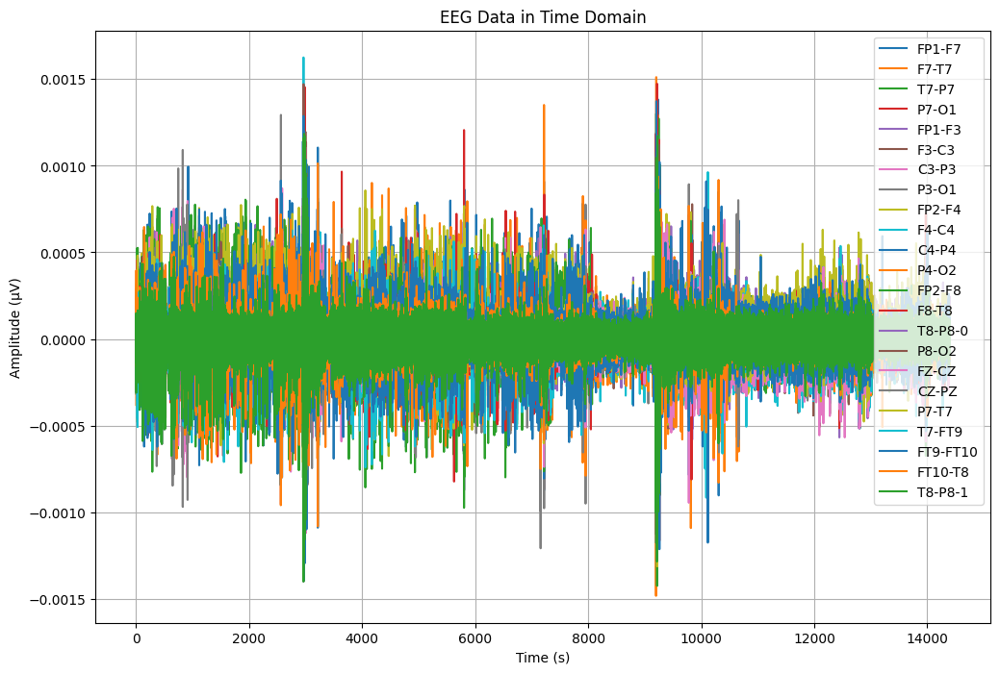

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df8['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df8[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


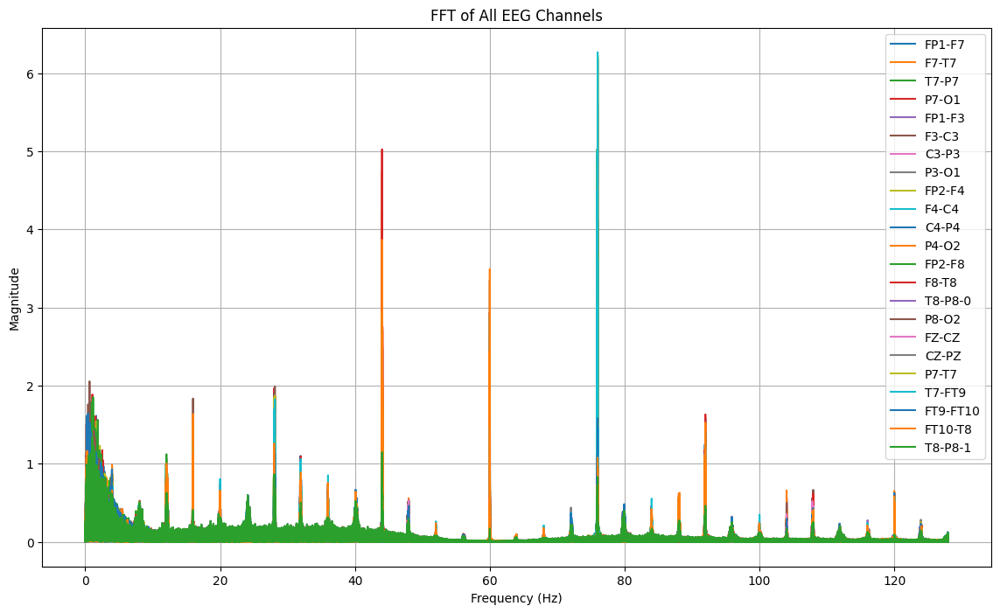

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df8[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_08.csv"
df8.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_08.csv


In [ ]:
#Import Data CSV
dataTA8 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_08.csv")
dataTA8


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,5.860806e-07,6.837607e-06,-3.575092e-05,3.262515e-05,3.340659e-05,1.387057e-05,-3.926740e-05,-3.711844e-06,3.809524e-05,4.043956e-05,...,3.321123e-06,5.567766e-05,5.333333e-05,3.614164e-05,-6.056166e-06,8.791209e-06,2.051282e-05,-4.708181e-05,7.794872e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,-1.953602e-07,0.007812
3,9.768010e-07,5.860806e-07,1.953602e-07,9.768010e-07,1.367521e-06,5.860806e-07,1.953602e-07,5.860806e-07,9.768010e-07,1.953602e-07,...,9.768010e-07,9.768010e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-2.148962e-06,2.930403e-06,1.953602e-07,-9.768010e-07,0.011719
4,1.953602e-07,-5.860806e-07,-1.953602e-07,-5.860806e-07,-5.860806e-07,5.860806e-07,1.953602e-07,-9.768010e-07,-1.953602e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,5.860806e-07,4.884005e-06,-5.274725e-06,1.953602e-07,3.321123e-06,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3686395,-1.738706e-05,1.621490e-05,-3.809524e-05,2.676435e-05,1.973138e-05,-9.963370e-06,-6.837607e-06,-1.426129e-05,8.791209e-06,-1.738706e-05,...,-4.239316e-05,-2.363858e-05,-5.860806e-07,3.848596e-05,-2.949939e-05,1.660562e-05,1.758242e-06,2.246642e-05,2.051282e-05,14399.980469
3686396,-1.582418e-05,9.181929e-06,-5.645910e-05,2.871795e-05,2.090354e-05,-2.246642e-05,-1.269841e-05,-1.934066e-05,-1.758242e-06,-2.246642e-05,...,-5.137973e-05,-3.067155e-05,-6.056166e-06,5.684982e-05,-2.989011e-05,3.653236e-05,-2.090354e-05,1.660562e-05,5.684982e-05,14399.984375
3686397,-1.113553e-05,5.860806e-07,-6.231990e-05,2.442002e-05,1.973138e-05,-2.989011e-05,-1.465201e-05,-2.285714e-05,-1.191697e-05,-2.949939e-05,...,-5.528694e-05,-3.496947e-05,-1.035409e-05,6.271062e-05,-2.832723e-05,2.832723e-05,-1.347985e-05,8.400488e-06,7.755800e-05,14399.988281
3686398,-1.035409e-05,-5.274725e-06,-5.919414e-05,1.777778e-05,1.426129e-05,-3.223443e-05,-1.387057e-05,-2.402930e-05,-1.777778e-05,-3.614164e-05,...,-5.528694e-05,-3.887668e-05,-1.269841e-05,5.958486e-05,-2.598291e-05,1.660562e-05,5.860806e-07,-3.321123e-06,6.310134e-05,14399.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA8[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA8[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA8[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data8, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 39.85 Hz, Magnitude: 3.468087, Time: 2964.539062 s
Channel: FP2-F8, Max Frequency: 0.79 Hz, Magnitude: 3.428763, Time: 9219.234375 s
Channel: T7-FT9, Max Frequency: 39.85 Hz, Magnitude: 3.292785, Time: 2970.675781 s
Channel: FP2-F4, Max Frequency: 1.31 Hz, Magnitude: 3.247476, Time: 2959.980469 s
Channel: FP1-F3, Max Frequency: 0.88 Hz, Magnitude: 3.073838, Time: 2979.582031 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 2.927791, Time: 2963.179688 s
Channel: FZ-CZ, Max Frequency: 1.27 Hz, Magnitude: 2.841522, Time: 2964.648438 s
Channel: F3-C3, Max Frequency: 1.19 Hz, Magnitude: 2.818261, Time: 9207.218750 s
Channel: F8-T8, Max Frequency: 0.55 Hz, Magnitude: 2.738262, Time: 9219.218750 s
Channel: P4-O2, Max Frequency: 0.63 Hz, Magnitude: 2.723768, Time: 9204.968750 s
Channel: F4-C4, Max Frequency: 1.19 Hz, Magnitude: 2.713420, Time: 2962.339844 s
Channel: FP1-F7, Max

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: CZ-PZ, Max Frequency: 0.91 Hz, Magnitude: 1.843047, Time: 2562.714844 s
Channel: FP2-F4, Max Frequency: 1.31 Hz, Magnitude: 3.247476, Time: 2959.980469 s
Channel: C3-P3, Max Frequency: 0.77 Hz, Magnitude: 1.804887, Time: 2962.058594 s
Channel: T8-P8-0, Max Frequency: 0.96 Hz, Magnitude: 1.654208, Time: 2962.238281 s
Channel: T8-P8-1, Max Frequency: 0.96 Hz, Magnitude: 1.654208, Time: 2962.238281 s
Channel: F4-C4, Max Frequency: 1.19 Hz, Magnitude: 2.713420, Time: 2962.339844 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 2.927791, Time: 2963.179688 s
Channel: FT9-FT10, Max Frequency: 39.85 Hz, Magnitude: 3.468087, Time: 2964.539062 s
Channel: FZ-CZ, Max Frequency: 1.27 Hz, Magnitude: 2.841522, Time: 2964.648438 s
Channel: P7-O1, Max Frequency: 0.50 Hz, Magnitude: 1.590773, Time: 2969.656250 s
Channel: T7-FT9, Max Frequency: 39.85 Hz, Magnitude: 3.292785, Time: 29

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 9089   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 9342    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut8 = dataTA8.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut8.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb09_08.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA8 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb09_08.csv")
TA8.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,0.000018,0.000001,0.000073,-0.000038,-0.000022,0.000033,0.000021,0.000023,-0.000033,0.000032,...,0.000003,0.000027,0.000015,-0.000072,0.000010,0.000010,5.860806e-07,-2.148962e-06,1.953602e-07,9089.000000
1,0.000021,0.000007,0.000081,-0.000046,-0.000021,0.000037,0.000021,0.000025,-0.000050,0.000044,...,0.000003,0.000035,0.000011,-0.000080,0.000006,0.000012,-1.074481e-05,-4.884005e-06,2.148962e-06,9089.003906
2,0.000028,0.000008,0.000083,-0.000041,-0.000015,0.000043,0.000018,0.000031,-0.000065,0.000053,...,0.000006,0.000041,0.000010,-0.000082,0.000002,-0.000002,-9.181929e-06,-5.665446e-06,2.148962e-06,9089.007812
3,0.000028,0.000017,0.000086,-0.000031,-0.000004,0.000049,0.000013,0.000040,-0.000080,0.000061,...,0.000014,0.000044,0.000015,-0.000085,-0.000004,-0.000014,-6.056166e-06,-9.768010e-07,1.953602e-07,9089.011719
4,0.000026,0.000023,0.000082,-0.000022,0.000011,0.000048,0.000005,0.000045,-0.000090,0.000070,...,0.000022,0.000048,0.000019,-0.000082,-0.000009,-0.000011,-1.308913e-05,9.181929e-06,-5.665446e-06,9089.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA8.shape


(64768, 25)

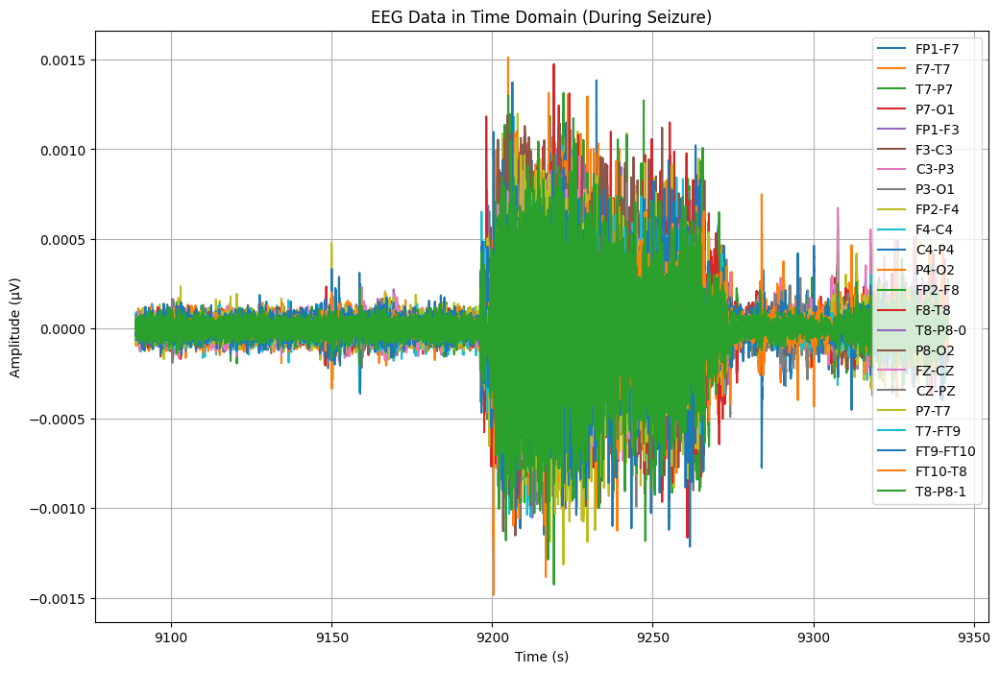

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA8['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA8.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA8[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


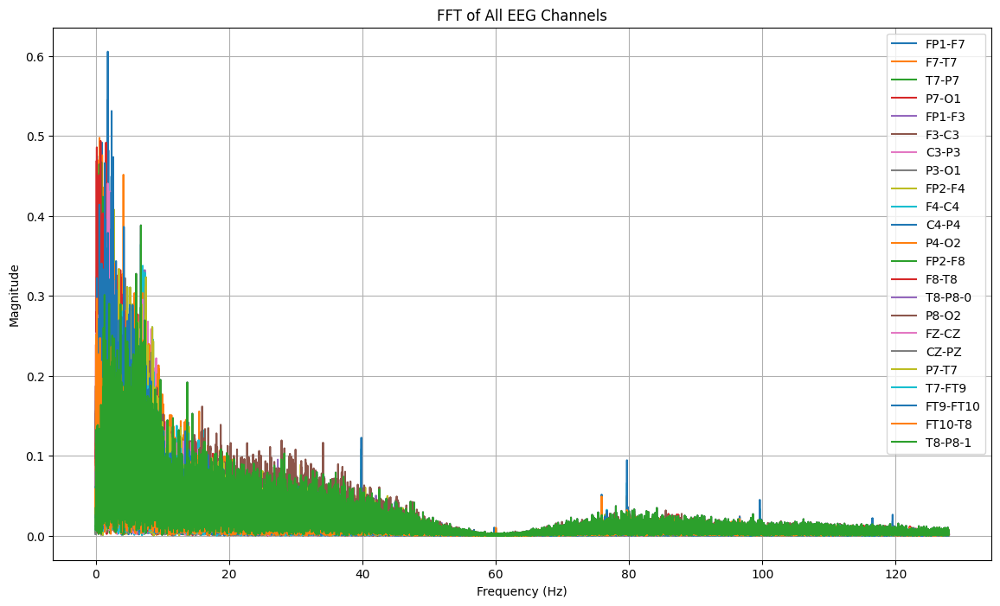

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA8[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 9204:
        return "tidak kejang"
    elif 9204 <= row['Time'] < 9222:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_8 = TA8.copy()
TA_8['seizure'] = TA_8.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_8[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  9089.000000  tidak kejang  0.000018  0.000001  0.000073 -0.000038   
1  9089.003906  tidak kejang  0.000021  0.000007  0.000081 -0.000046   
2  9089.007812  tidak kejang  0.000028  0.000008  0.000083 -0.000041   
3  9089.011719  tidak kejang  0.000028  0.000017  0.000086 -0.000031   
4  9089.015625  tidak kejang  0.000026  0.000023  0.000082 -0.000022   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8       T8-P8-0  \
0 -0.000022  0.000033  0.000021  0.000023  ...  0.000026 -2.148962e-06   
1 -0.000021  0.000037  0.000021  0.000025  ...  0.000025 -4.884005e-06   
2 -0.000015  0.000043  0.000018  0.000031  ...  0.000022 -5.665446e-06   
3 -0.000004  0.000049  0.000013  0.000040  ...  0.000019 -9.768010e-07   
4  0.000011  0.000048  0.000005  0.000045  ...  0.000017  9.181929e-06   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10       FT10-T8  \
0  0.000003  0.000027  0.000015 -0.000072  

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_8['seizure'].value_counts()


,count
seizure,
tidak kejang,60160
kejang,4608


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_8)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 253.0 detik


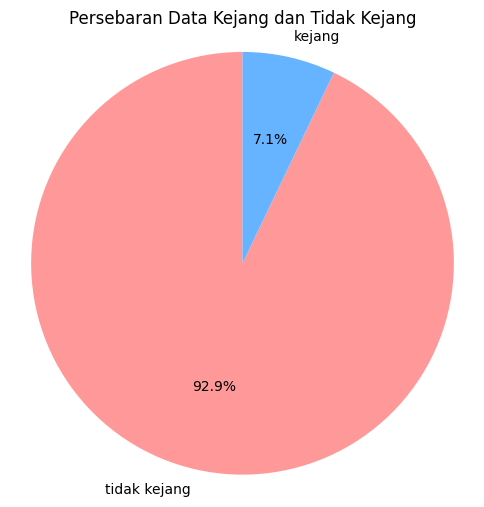

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_8['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_8.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb09_08.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_8.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_8['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.97      0.76      0.85       956
tidak kejang       0.98      1.00      0.99     11998

    accuracy                           0.98     12954
   macro avg       0.97      0.88      0.92     12954
weighted avg       0.98      0.98      0.98     12954

Akurasi: 0.979928979465802
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.76      0.85       956
tidak kejang       0.98      1.00      0.99     11998

    accuracy                           0.98     12954
   macro avg       0.97      0.88      0.92     12954
weighted avg       0.98      0.98      0.98     12954



# DATA 9 (chb09_19)
akurasi = 0.979

In [ ]:
# mengimport file edf
file9 = "/content/drive/MyDrive/TA/EDF/chb09_19.edf"
data9 = mne.io.read_raw_edf(file9) # membaca file edf dan menyimpannya di data
data9


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb09_19.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-3-95b534a8353b>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data9 = mne.io.read_raw_edf(file9) # membaca file edf dan menyimpannya di data


<RawEDF | chb09_19.edf, 24 x 1459200 (5700.0 s), ~28 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data9.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data9.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data9.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1',
 'VNS']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df9 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df9['Time'] = times  # Menambahkan kolom waktu
df9.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,-1.185836e-04,-1.342125e-04,-7.404151e-05,-1.408547e-04,3.393407e-04,-5.288400e-04,4.630037e-05,-3.244933e-04,2.865934e-04,-4.081074e-04,...,-6.446886e-06,-7.671795e-04,3.301587e-05,7.443223e-05,-1.185836e-04,1.213187e-04,8.576313e-05,-3.457875e-05,1.953602e-07,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,5.860806e-07,5.860806e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,-9.768010e-07,1.758242e-06,1.953602e-07,1.953602e-07,1.367521e-06,0.007812
3,-5.860806e-07,1.367521e-06,2.148962e-06,5.860806e-07,-1.367521e-06,3.321123e-06,1.953602e-07,1.367521e-06,-1.953602e-07,1.758242e-06,...,9.768010e-07,2.539683e-06,1.953602e-07,-1.758242e-06,-3.321123e-06,4.493284e-06,1.953602e-07,1.953602e-07,2.148962e-06,0.011719
4,1.367521e-06,-9.768010e-07,-9.768010e-07,-1.953602e-07,4.102564e-06,-4.102564e-06,-1.953602e-07,-9.768010e-07,1.367521e-06,-1.758242e-06,...,1.953602e-07,-1.758242e-06,1.953602e-07,1.367521e-06,9.963370e-06,-9.572650e-06,-9.768010e-07,1.953602e-07,-7.228327e-06,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df9.shape)


(1459200, 25)


In [ ]:
# mendeskripsikan data
df9.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
count,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,...,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06,1.459200e+06
mean,2.522824e-07,1.666565e-07,1.472541e-07,2.019753e-07,2.107700e-07,1.574701e-07,2.119835e-07,1.758834e-07,2.213667e-07,1.640999e-07,...,2.137060e-07,1.721526e-07,1.967148e-07,2.434663e-07,1.944201e-07,1.955032e-07,2.208689e-07,1.355378e-07,2.297383e-07,2.849998e+03
std,9.388209e-05,9.145434e-05,9.461234e-05,6.521414e-05,1.106490e-04,8.241482e-05,6.517603e-05,8.103602e-05,1.075562e-04,8.421738e-05,...,6.552072e-05,8.204166e-05,5.427551e-05,9.461234e-05,9.465256e-05,1.147558e-04,6.775441e-05,8.200255e-05,7.609198e-05,1.645449e+03
min,-9.340171e-04,-1.059048e-03,-1.318095e-03,-9.027595e-04,-1.080537e-03,-1.004737e-03,-8.757998e-04,-9.758242e-04,-1.237607e-03,-1.236825e-03,...,-1.196190e-03,-1.005910e-03,-7.242002e-04,-1.381392e-03,-1.135629e-03,-1.264567e-03,-8.019536e-04,-1.619341e-03,-9.738706e-04,0.000000e+00
25%,-4.239316e-05,-4.512821e-05,-4.512821e-05,-3.379731e-05,-5.606838e-05,-4.161172e-05,-3.692308e-05,-4.473748e-05,-5.137973e-05,-3.848596e-05,...,-3.106227e-05,-3.614164e-05,-2.989011e-05,-4.786325e-05,-3.965812e-05,-5.255189e-05,-3.418803e-05,-3.848596e-05,-2.871795e-05,1.424999e+03
50%,-1.758242e-06,2.148962e-06,1.758242e-06,1.953602e-07,-1.758242e-06,2.148962e-06,-1.953602e-07,1.758242e-06,-1.367521e-06,1.367521e-06,...,1.953602e-07,1.758242e-06,1.953602e-07,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,-9.768010e-07,2.849998e+03
75%,3.731380e-05,4.786325e-05,4.825397e-05,3.457875e-05,5.177045e-05,4.473748e-05,3.653236e-05,4.747253e-05,4.708181e-05,4.083028e-05,...,3.067155e-05,3.965812e-05,2.989011e-05,4.551893e-05,4.122100e-05,5.216117e-05,3.418803e-05,4.083028e-05,2.051282e-05,4.274997e+03
max,1.302076e-03,1.027790e-03,1.381783e-03,8.769719e-04,1.327473e-03,9.473016e-04,8.480586e-04,9.992674e-04,1.354823e-03,1.062173e-03,...,1.361856e-03,1.005128e-03,6.991941e-04,1.318486e-03,1.307546e-03,1.448205e-03,9.484737e-04,1.192283e-03,1.330989e-03,5.699996e+03


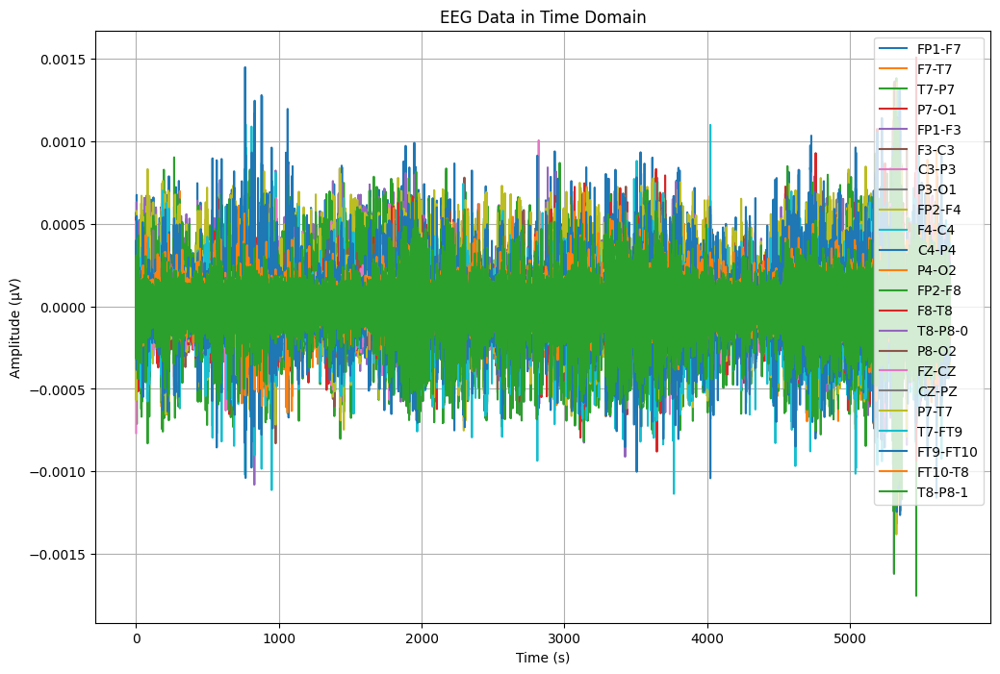

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df9['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df9[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


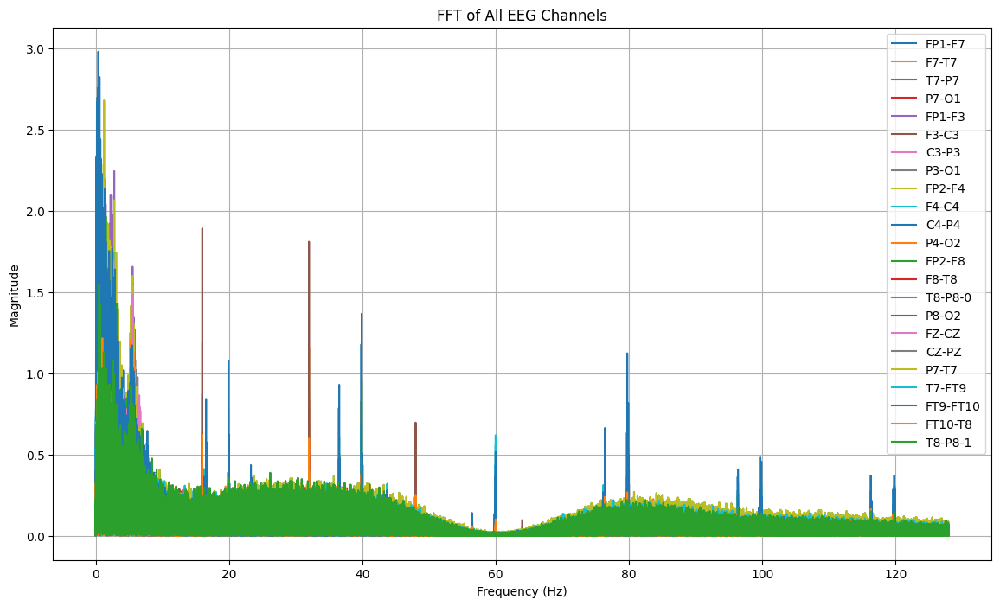

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df9[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_19.csv"
df9.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_19.csv


In [ ]:
#Import Data CSV
dataTA9 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb09_19.csv")
dataTA9


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,-1.185836e-04,-1.342125e-04,-7.404151e-05,-1.408547e-04,3.393407e-04,-5.288400e-04,4.630037e-05,-3.244933e-04,2.865934e-04,-4.081074e-04,...,-6.446886e-06,-7.671795e-04,3.301587e-05,7.443223e-05,-1.185836e-04,1.213187e-04,8.576313e-05,-3.457875e-05,1.953602e-07,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,5.860806e-07,5.860806e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,-9.768010e-07,1.758242e-06,1.953602e-07,1.953602e-07,1.367521e-06,0.007812
3,-5.860806e-07,1.367521e-06,2.148962e-06,5.860806e-07,-1.367521e-06,3.321123e-06,1.953602e-07,1.367521e-06,-1.953602e-07,1.758242e-06,...,9.768010e-07,2.539683e-06,1.953602e-07,-1.758242e-06,-3.321123e-06,4.493284e-06,1.953602e-07,1.953602e-07,2.148962e-06,0.011719
4,1.367521e-06,-9.768010e-07,-9.768010e-07,-1.953602e-07,4.102564e-06,-4.102564e-06,-1.953602e-07,-9.768010e-07,1.367521e-06,-1.758242e-06,...,1.953602e-07,-1.758242e-06,1.953602e-07,1.367521e-06,9.963370e-06,-9.572650e-06,-9.768010e-07,1.953602e-07,-7.228327e-06,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1459195,3.340659e-05,4.395604e-05,8.537241e-05,2.754579e-05,-7.091575e-05,8.654457e-05,8.732601e-05,8.967033e-05,-1.779731e-04,1.607814e-04,...,-1.152625e-05,1.049084e-04,6.114774e-05,-8.498168e-05,3.965812e-05,-1.347985e-05,1.777778e-05,9.982906e-05,-7.052503e-05,5699.980469
1459196,3.887668e-05,3.731380e-05,8.380952e-05,3.418803e-05,-6.661783e-05,9.240537e-05,8.380952e-05,8.693529e-05,-1.764103e-04,1.650794e-04,...,-1.758242e-06,1.119414e-04,6.192918e-05,-8.341880e-05,4.356532e-05,-1.934066e-05,1.816850e-05,1.041270e-04,-6.388278e-05,5699.984375
1459197,3.887668e-05,3.223443e-05,9.045177e-05,4.356532e-05,-5.880342e-05,9.514042e-05,8.302808e-05,8.810745e-05,-1.678144e-04,1.709402e-04,...,9.572650e-06,1.205372e-04,6.114774e-05,-9.006105e-05,4.903541e-05,-1.308913e-05,1.777778e-05,1.064713e-04,-4.884005e-06,5699.988281
1459198,4.004884e-05,2.793651e-05,8.849817e-05,5.411477e-05,-5.450549e-05,1.017827e-04,8.068376e-05,8.537241e-05,-1.576557e-04,1.783639e-04,...,2.559219e-05,1.287424e-04,6.427350e-05,-8.810745e-05,4.864469e-05,-1.426129e-05,1.973138e-05,1.056899e-04,1.152625e-05,5699.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA9[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA9[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA9[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data9, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.41 Hz, Magnitude: 2.980855, Time: 763.582031 s
Channel: FP2-F4, Max Frequency: 1.26 Hz, Magnitude: 2.680969, Time: 5329.207031 s
Channel: T7-FT9, Max Frequency: 0.25 Hz, Magnitude: 2.457640, Time: 5336.148438 s
Channel: F8-T8, Max Frequency: 0.28 Hz, Magnitude: 2.407419, Time: 5464.750000 s
Channel: FP1-F3, Max Frequency: 2.79 Hz, Magnitude: 2.245251, Time: 5327.046875 s
Channel: FP2-F8, Max Frequency: 0.38 Hz, Magnitude: 2.137465, Time: 5464.750000 s
Channel: FZ-CZ, Max Frequency: 1.19 Hz, Magnitude: 2.005910, Time: 5310.558594 s
Channel: FP1-F7, Max Frequency: 0.43 Hz, Magnitude: 1.910105, Time: 5318.257812 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 1.892906, Time: 5313.562500 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.872030, Time: 5306.957031 s
Channel: F4-C4, Max Frequency: 1.19 Hz, Magnitude: 1.866495, Time: 5305.941406 s
Channel: P4-O2, Max Fr

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT9-FT10, Max Frequency: 0.41 Hz, Magnitude: 2.980855, Time: 763.582031 s
Channel: F4-C4, Max Frequency: 1.19 Hz, Magnitude: 1.866495, Time: 5305.941406 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.872030, Time: 5306.957031 s
Channel: T8-P8-0, Max Frequency: 0.53 Hz, Magnitude: 1.548103, Time: 5309.449219 s
Channel: T8-P8-1, Max Frequency: 0.53 Hz, Magnitude: 1.548103, Time: 5309.449219 s
Channel: CZ-PZ, Max Frequency: 0.53 Hz, Magnitude: 1.233213, Time: 5309.792969 s
Channel: FZ-CZ, Max Frequency: 1.19 Hz, Magnitude: 2.005910, Time: 5310.558594 s
Channel: P3-O1, Max Frequency: 1.37 Hz, Magnitude: 1.652554, Time: 5311.078125 s
Channel: P4-O2, Max Frequency: 0.51 Hz, Magnitude: 1.812268, Time: 5312.085938 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 1.892906, Time: 5313.562500 s
Channel: C3-P3, Max Frequency: 2.41 Hz, Magnitude: 1.171947, Time: 5317.60

In [ ]:
import numpy as np
import pandas as pd
import pywt

# Fungsi untuk mendapatkan frekuensi terbesar dari DWT
def get_max_frequency_dwt(signal, waveletname='db4', level=10, sampling_rate=256):
    # Melakukan Discrete Wavelet Transform (DWT)
    coeffs = pywt.wavedec(signal, waveletname, level=level)

    # Koefisien approximation pada level tertinggi
    approx_coeffs = coeffs[0]

    # Mendapatkan frekuensi dominan berdasarkan level DWT
    freq = sampling_rate / (2 ** level)

    # Mendapatkan magnitudo maksimum dari koefisien approximation
    max_magnitude = np.max(np.abs(approx_coeffs))

    return freq, max_magnitude

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, dataTA9, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA9[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA9[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat list untuk menyimpan hasil
results = []

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA9[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency_dwt(signal, sampling_rate=sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar menggunakan DWT

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, dataTA9, 'Time')

    # Menyimpan hasil ke list
    results.append({
        'Channel': channel,
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    })

# Mengurutkan hasil berdasarkan waktu
sorted_results = sorted(results, key=lambda x: x['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for info in sorted_results:
    print(f"Channel: {info['Channel']}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT9-FT10, Max Frequency: 0.25 Hz, Magnitude: 0.002214, Time: 763.582031 s
Channel: F4-C4, Max Frequency: 0.25 Hz, Magnitude: 0.004047, Time: 5305.941406 s
Channel: F7-T7, Max Frequency: 0.25 Hz, Magnitude: 0.001300, Time: 5306.957031 s
Channel: T8-P8-0, Max Frequency: 0.25 Hz, Magnitude: 0.002107, Time: 5309.449219 s
Channel: T8-P8-1, Max Frequency: 0.25 Hz, Magnitude: 0.002107, Time: 5309.449219 s
Channel: CZ-PZ, Max Frequency: 0.25 Hz, Magnitude: 0.001637, Time: 5309.792969 s
Channel: FZ-CZ, Max Frequency: 0.25 Hz, Magnitude: 0.005497, Time: 5310.558594 s
Channel: P3-O1, Max Frequency: 0.25 Hz, Magnitude: 0.002323, Time: 5311.078125 s
Channel: P4-O2, Max Frequency: 0.25 Hz, Magnitude: 0.002833, Time: 5312.085938 s
Channel: P8-O2, Max Frequency: 0.25 Hz, Magnitude: 0.001308, Time: 5313.562500 s
Channel: C3-P3, Max Frequency: 0.25 Hz, Magnitude: 0.001556, Time: 5317.609

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 5185   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 5463    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut9 = dataTA9.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut9.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb09_19.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA9 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb09_19.csv")
TA9.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,VNS,Time
0,-0.000053,-0.000132,0.000116,0.000092,0.000035,-0.000085,-0.000070,0.000143,-0.000099,0.000129,...,0.000110,0.000028,-0.000136,-0.000115,0.000154,-0.000008,0.000008,0.000057,0.000273,5185.000000
1,-0.000047,-0.000157,0.000094,0.000100,0.000061,-0.000101,-0.000094,0.000124,-0.000072,0.000099,...,0.000126,0.000010,-0.000154,-0.000093,0.000173,-0.000026,-0.000040,0.000088,0.000181,5185.003906
2,-0.000044,-0.000164,0.000080,0.000099,0.000083,-0.000109,-0.000112,0.000110,-0.000047,0.000072,...,0.000136,-0.000011,-0.000168,-0.000079,0.000188,-0.000046,-0.000068,0.000094,0.000035,5185.007812
3,-0.000049,-0.000226,0.000139,0.000063,0.000092,-0.000124,-0.000125,0.000084,-0.000043,0.000068,...,0.000097,-0.000028,-0.000174,-0.000139,0.000235,-0.000010,-0.000116,0.000128,0.000115,5185.011719
4,-0.000048,-0.000233,0.000157,0.000030,0.000108,-0.000131,-0.000134,0.000065,-0.000031,0.000061,...,0.000089,-0.000041,-0.000170,-0.000156,0.000233,-0.000005,-0.000105,0.000092,0.000101,5185.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA9.shape


(71168, 25)

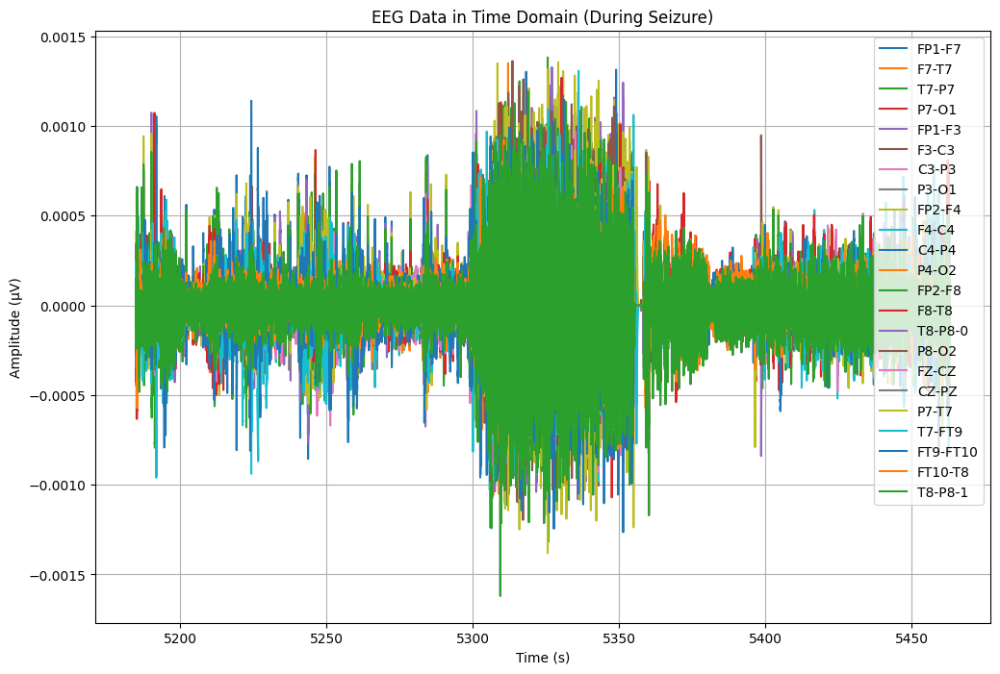

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA9['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA9.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA9[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


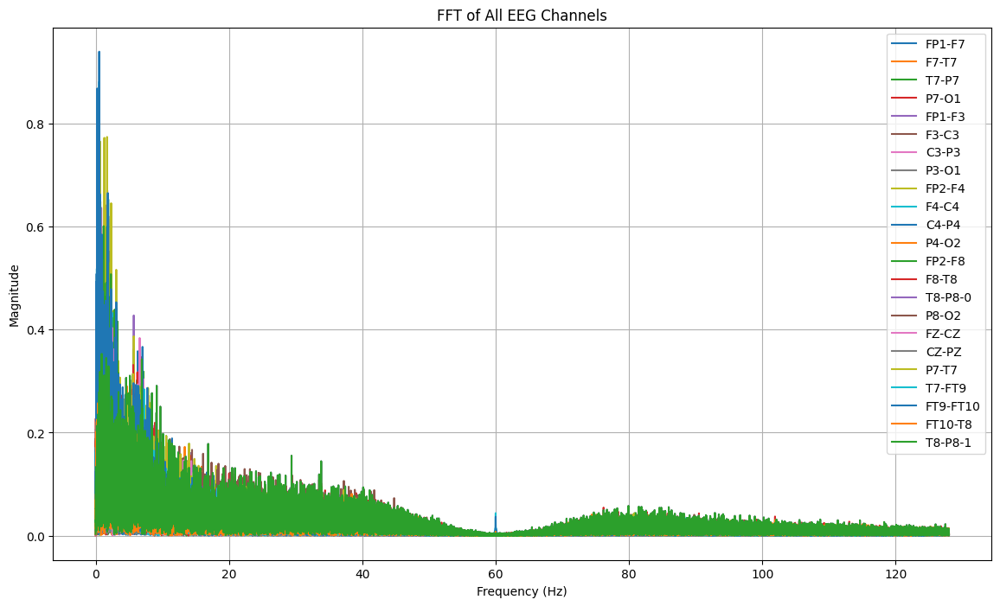

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA9[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 5305:
        return "tidak kejang"
    elif 5305 <= row['Time'] < 5343:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_9 = TA9.copy()
TA_9['seizure'] = TA_9.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_9[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())



          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  5185.000000  tidak kejang -0.000053 -0.000132  0.000116  0.000092   
1  5185.003906  tidak kejang -0.000047 -0.000157  0.000094  0.000100   
2  5185.007812  tidak kejang -0.000044 -0.000164  0.000080  0.000099   
3  5185.011719  tidak kejang -0.000049 -0.000226  0.000139  0.000063   
4  5185.015625  tidak kejang -0.000048 -0.000233  0.000157  0.000030   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000035 -0.000085 -0.000070  0.000143  ...  0.000087  0.000057  0.000110   
1  0.000061 -0.000101 -0.000094  0.000124  ...  0.000022  0.000088  0.000126   
2  0.000083 -0.000109 -0.000112  0.000110  ... -0.000015  0.000094  0.000136   
3  0.000092 -0.000124 -0.000125  0.000084  ... -0.000051  0.000128  0.000097   
4  0.000108 -0.000131 -0.000134  0.000065  ... -0.000036  0.000092  0.000089   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0  0.000028 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_9['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,9728


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_9)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 278.0 detik


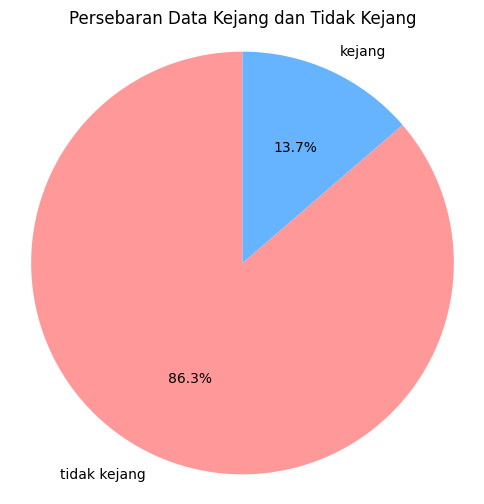

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_9['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_9.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb09_19.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_9.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_9['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))



              precision    recall  f1-score   support

      kejang       0.91      0.94      0.93      1979
tidak kejang       0.99      0.99      0.99     12255

    accuracy                           0.98     14234
   macro avg       0.95      0.96      0.96     14234
weighted avg       0.98      0.98      0.98     14234

Akurasi: 0.9790642124490656
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.91      0.94      0.93      1979
tidak kejang       0.99      0.99      0.99     12255

    accuracy                           0.98     14234
   macro avg       0.95      0.96      0.96     14234
weighted avg       0.98      0.98      0.98     14234



# DATA 10 (chb09_27) akurasinya cuma 94. gatau mau dipake gak. belum dicatet kok

In [ ]:
# mengimport file edf
file10 = "/content/drive/MyDrive/TA/EDF/chb10_27.edf"
data10 = mne.io.read_raw_edf(file10) # membaca file edf dan menyimpannya di data
data10


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb10_27.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-65-ee75af23f4f7>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data10 = mne.io.read_raw_edf(file10) # membaca file edf dan menyimpannya di data


<RawEDF | chb10_27.edf, 23 x 1847808 (7218.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data10.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data10.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data10.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df10 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df10['Time'] = times  # Menambahkan kolom waktu
df10.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.611722e-05,-2.435165e-04,3.487179e-05,3.956044e-05,5.714286e-05,-1.702564e-04,-6.241758e-05,-9.670330e-06,-5.714286e-05,-1.397802e-04,...,-1.057875e-04,-8.468864e-05,-1.427106e-04,-9.289377e-05,-3.428571e-05,-1.963370e-05,2.810256e-04,1.260073e-05,-1.057875e-04,0.000000
1,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.003906
2,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.007812
3,8.791209e-07,2.930403e-07,-2.930403e-07,8.791209e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,8.791209e-07,-2.051282e-06,2.051282e-06,2.930403e-07,2.930403e-07,0.011719
4,-2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,-2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,8.791209e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df10.shape)


(1847808, 24)


In [ ]:
# mendeskripsikan data
df10.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,...,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06,1.847808e+06
mean,3.398409e-07,2.637522e-07,2.857357e-07,2.976463e-07,3.370317e-07,2.568220e-07,2.754332e-07,2.878183e-07,2.987618e-07,2.600029e-07,...,3.087329e-07,3.184115e-07,2.848277e-07,3.049281e-07,3.003449e-07,3.194255e-07,2.544403e-07,2.956557e-07,3.087329e-07,3.608998e+03
std,6.615914e-05,8.672680e-05,5.635289e-05,6.717518e-05,1.021541e-04,9.969003e-05,6.829546e-05,7.452575e-05,1.000737e-04,7.130292e-05,...,5.420995e-05,4.933792e-05,1.071681e-04,7.758143e-05,5.635289e-05,7.255502e-05,8.846965e-05,3.830026e-05,5.420995e-05,2.083658e+03
min,-1.142564e-03,-9.556044e-04,-1.137875e-03,-1.311941e-03,-1.137875e-03,-8.741392e-04,-9.280586e-04,-1.034139e-03,-9.268864e-04,-9.456410e-04,...,-8.624176e-04,-6.232967e-04,-9.948718e-04,-6.989011e-04,-1.060513e-03,-2.631209e-03,-2.123077e-03,-1.133773e-03,-8.624176e-04,0.000000e+00
25%,-3.663004e-05,-5.245421e-05,-3.076923e-05,-3.604396e-05,-6.417582e-05,-6.124542e-05,-4.131868e-05,-4.190476e-05,-5.948718e-05,-4.307692e-05,...,-3.135531e-05,-2.783883e-05,-6.593407e-05,-4.835165e-05,-3.076923e-05,-2.549451e-05,-3.194139e-05,-2.080586e-05,-3.135531e-05,1.804499e+03
50%,-2.930403e-07,1.465201e-06,2.930403e-07,2.930403e-07,-1.465201e-06,1.465201e-06,2.930403e-07,2.930403e-07,2.930403e-07,8.791209e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,-2.930403e-07,8.791209e-07,2.930403e-07,2.930403e-07,3.608998e+03
75%,3.545788e-05,5.421245e-05,3.135531e-05,3.663004e-05,6.300366e-05,6.358974e-05,4.249084e-05,4.307692e-05,6.007326e-05,4.542125e-05,...,3.135531e-05,2.783883e-05,6.710623e-05,4.835165e-05,3.135531e-05,2.432234e-05,3.428571e-05,2.080586e-05,3.135531e-05,5.413497e+03
max,1.175971e-03,1.129670e-03,1.061099e-03,1.209963e-03,1.176557e-03,1.103297e-03,8.495238e-04,1.341245e-03,2.423150e-03,6.789744e-04,...,7.967766e-04,7.915018e-04,1.122637e-03,9.684982e-04,1.138462e-03,2.630037e-03,2.470623e-03,7.780220e-04,7.967766e-04,7.217996e+03


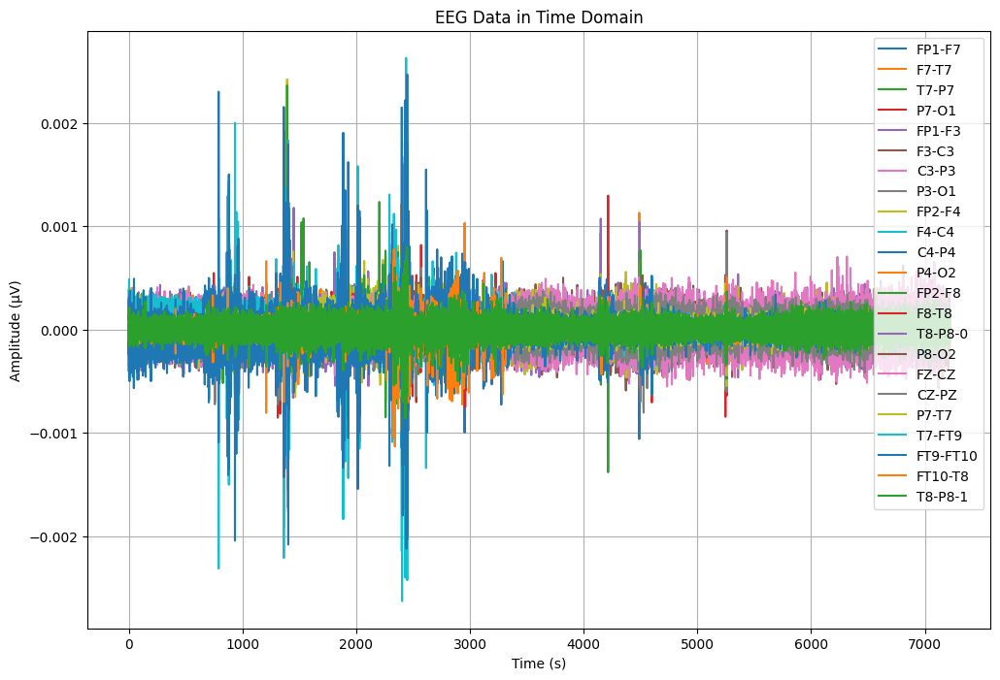

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df10['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df10[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


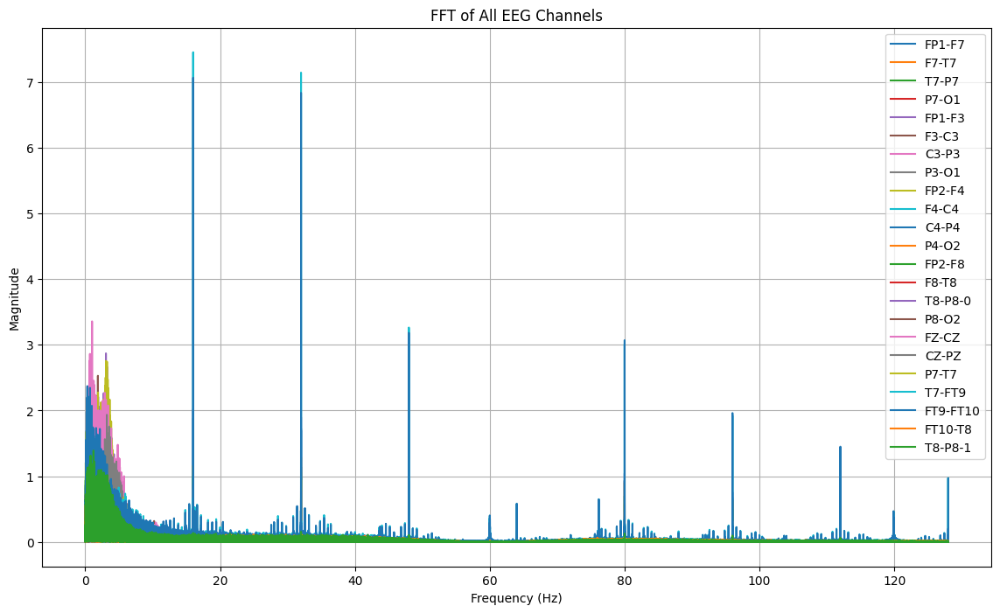

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df10[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb10_27.csv"
df10.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb10_27.csv


In [ ]:
#Import Data CSV
dataTA10 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb10_27.csv")
dataTA10


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.611722e-05,-2.435165e-04,3.487179e-05,3.956044e-05,5.714286e-05,-1.702564e-04,-6.241758e-05,-9.670330e-06,-5.714286e-05,-1.397802e-04,...,-1.057875e-04,-8.468864e-05,-1.427106e-04,-9.289377e-05,-3.428571e-05,-1.963370e-05,2.810256e-04,1.260073e-05,-1.057875e-04,0.000000
1,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.003906
2,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.007812
3,8.791209e-07,2.930403e-07,-2.930403e-07,8.791209e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,8.791209e-07,-2.051282e-06,2.051282e-06,2.930403e-07,2.930403e-07,0.011719
4,-2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,-2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,8.791209e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1847803,-2.930403e-07,3.135531e-05,5.948718e-05,5.069597e-05,-2.051282e-06,-3.194139e-05,9.113553e-05,8.703297e-05,7.648352e-05,-1.318681e-05,...,9.084249e-06,3.663004e-05,-2.432234e-05,5.948718e-05,-5.890110e-05,-9.084249e-06,1.377289e-05,3.194139e-05,9.084249e-06,7217.980469
1847804,-2.051282e-06,3.194139e-05,5.948718e-05,5.304029e-05,1.084249e-05,-4.014652e-05,9.113553e-05,8.234432e-05,1.010989e-04,-1.728938e-05,...,-1.465201e-06,4.190476e-05,-1.846154e-05,4.307692e-05,-5.890110e-05,-1.084249e-05,1.963370e-05,3.487179e-05,-1.465201e-06,7217.984375
1847805,1.465201e-06,3.076923e-05,5.655678e-05,5.831502e-05,2.842491e-05,-4.717949e-05,8.937729e-05,7.882784e-05,1.239560e-04,-2.373626e-05,...,-9.670330e-06,4.717949e-05,-1.435897e-05,2.608059e-05,-5.597070e-05,-1.084249e-05,2.256410e-05,3.604396e-05,-9.670330e-06,7217.988281
1847806,6.153846e-06,2.959707e-05,5.304029e-05,6.476190e-05,4.659341e-05,-5.538462e-05,8.468864e-05,7.941392e-05,1.438828e-04,-3.076923e-05,...,-1.846154e-05,5.304029e-05,-1.377289e-05,1.025641e-05,-5.245421e-05,-1.318681e-05,2.783883e-05,3.604396e-05,-1.846154e-05,7217.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA10[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA10[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA10[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data10, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 7.453612, Time: 2402.882812 s
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 7.065464, Time: 2447.914062 s
Channel: FZ-CZ, Max Frequency: 1.01 Hz, Magnitude: 3.357730, Time: 2444.679688 s
Channel: FP1-F3, Max Frequency: 3.06 Hz, Magnitude: 2.870648, Time: 1451.054688 s
Channel: FP2-F4, Max Frequency: 3.06 Hz, Magnitude: 2.754371, Time: 1392.113281 s
Channel: F3-C3, Max Frequency: 1.87 Hz, Magnitude: 2.528987, Time: 2442.968750 s
Channel: P7-O1, Max Frequency: 0.56 Hz, Magnitude: 2.333932, Time: 2441.269531 s
Channel: P3-O1, Max Frequency: 0.68 Hz, Magnitude: 2.310133, Time: 2435.457031 s
Channel: F7-T7, Max Frequency: 1.57 Hz, Magnitude: 2.225894, Time: 4488.433594 s
Channel: CZ-PZ, Max Frequency: 3.20 Hz, Magnitude: 1.934997, Time: 2441.355469 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.881839, Time: 1451.054688 s
Channel: F4-C4, Max 

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C4-P4, Max Frequency: 0.58 Hz, Magnitude: 1.362824, Time: 1362.441406 s
Channel: F4-C4, Max Frequency: 3.07 Hz, Magnitude: 1.875909, Time: 1362.445312 s
Channel: FP2-F4, Max Frequency: 3.06 Hz, Magnitude: 2.754371, Time: 1392.113281 s
Channel: FP2-F8, Max Frequency: 1.34 Hz, Magnitude: 1.807266, Time: 1392.113281 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.881839, Time: 1451.054688 s
Channel: FP1-F3, Max Frequency: 3.06 Hz, Magnitude: 2.870648, Time: 1451.054688 s
Channel: FT10-T8, Max Frequency: 0.52 Hz, Magnitude: 0.999496, Time: 2339.351562 s
Channel: P4-O2, Max Frequency: 0.56 Hz, Magnitude: 1.531830, Time: 2398.113281 s
Channel: T7-P7, Max Frequency: 0.55 Hz, Magnitude: 1.791212, Time: 2402.875000 s
Channel: P7-T7, Max Frequency: 0.55 Hz, Magnitude: 1.791212, Time: 2402.875000 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 7.453612, Time: 2402.

In [ ]:
import numpy as np
import pandas as pd
import pywt

# Fungsi untuk mendapatkan frekuensi terbesar dari DWT
def get_max_frequency_dwt(signal, waveletname='db4', level=4, sampling_rate=256):
    # Melakukan Discrete Wavelet Transform (DWT)
    coeffs = pywt.wavedec(signal, waveletname, level=level)

    # Koefisien approximation pada level tertinggi
    approx_coeffs = coeffs[0]

    # Mendapatkan frekuensi dominan berdasarkan level DWT
    freq = sampling_rate / (2 ** level)

    # Mendapatkan magnitudo maksimum dari koefisien approximation
    max_magnitude = np.max(np.abs(approx_coeffs))

    return freq, max_magnitude

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, dataTA10, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA10[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA10[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat list untuk menyimpan hasil
results = []

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA10[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency_dwt(signal, sampling_rate=sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar menggunakan DWT

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, dataTA10, 'Time')

    # Menyimpan hasil ke list
    results.append({
        'Channel': channel,
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    })

# Mengurutkan hasil berdasarkan waktu
sorted_results = sorted(results, key=lambda x: x['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for info in sorted_results:
    print(f"Channel: {info['Channel']}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 0.003049, Time: 1362.441406 s
Channel: F4-C4, Max Frequency: 16.00 Hz, Magnitude: 0.003137, Time: 1362.445312 s
Channel: FP2-F4, Max Frequency: 16.00 Hz, Magnitude: 0.007580, Time: 1392.113281 s
Channel: FP2-F8, Max Frequency: 16.00 Hz, Magnitude: 0.007381, Time: 1392.113281 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 0.004285, Time: 1451.054688 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 0.004305, Time: 1451.054688 s
Channel: FT10-T8, Max Frequency: 16.00 Hz, Magnitude: 0.002511, Time: 2339.351562 s
Channel: P4-O2, Max Frequency: 16.00 Hz, Magnitude: 0.004540, Time: 2398.113281 s
Channel: T7-P7, Max Frequency: 16.00 Hz, Magnitude: 0.003556, Time: 2402.875000 s
Channel: P7-T7, Max Frequency: 16.00 Hz, Magnitude: 0.003554, Time: 2402.875000 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 0.007783, Ti

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2219   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2569    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut10 = dataTA10.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut10.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb10_27.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA10 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb10_27.csv")
TA10.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000035,2.930403e-07,0.000095,-0.000101,-0.000020,0.000006,0.000108,-0.000136,-0.000033,-0.000045,...,0.000031,-0.000043,0.000028,0.000055,-0.000094,-0.000047,0.000035,0.000020,0.000031,2219.000000
1,-0.000035,1.670330e-05,0.000083,-0.000085,-0.000023,0.000014,0.000113,-0.000123,-0.000041,-0.000028,...,0.000054,-0.000037,0.000044,0.000070,-0.000082,-0.000045,0.000023,-0.000002,0.000054,2219.003906
2,-0.000041,2.959707e-05,0.000086,-0.000081,-0.000028,0.000019,0.000120,-0.000118,-0.000044,-0.000008,...,0.000056,-0.000037,0.000058,0.000085,-0.000086,-0.000036,0.000020,-0.000004,0.000056,2219.007812
3,-0.000034,3.897436e-05,0.000100,-0.000091,-0.000025,0.000031,0.000127,-0.000118,-0.000040,0.000009,...,0.000057,-0.000043,0.000071,0.000094,-0.000099,-0.000024,0.000014,0.000003,0.000057,2219.011719
4,-0.000040,5.069597e-05,0.000096,-0.000087,-0.000039,0.000042,0.000130,-0.000115,-0.000051,0.000024,...,0.000065,-0.000057,0.000084,0.000100,-0.000095,-0.000014,0.000007,0.000006,0.000065,2219.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA10.shape


(89600, 24)

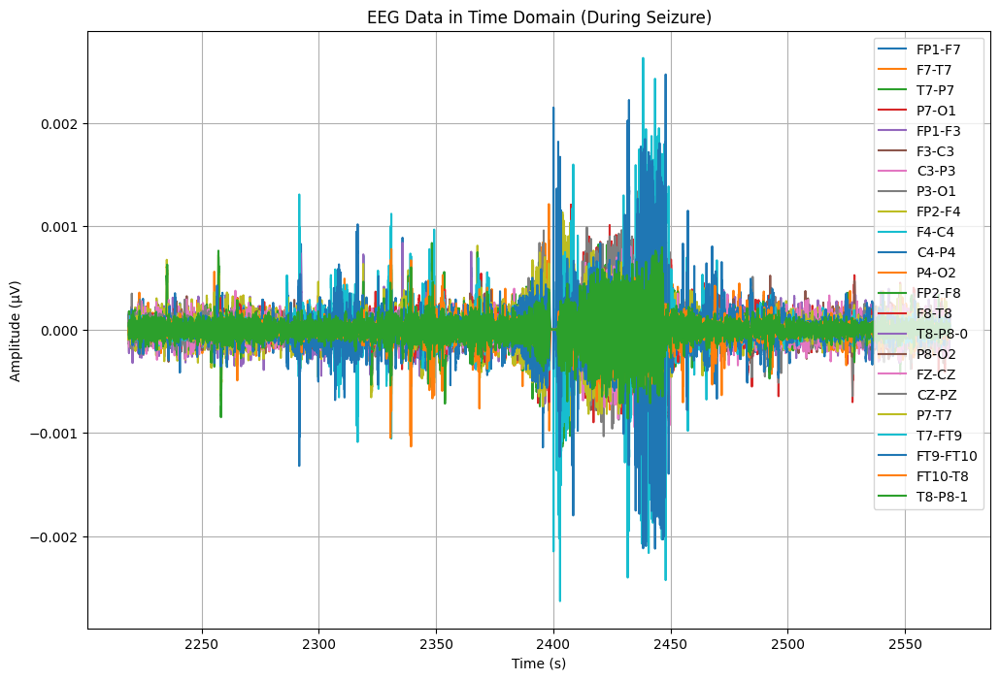

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA10['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA10.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA10[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


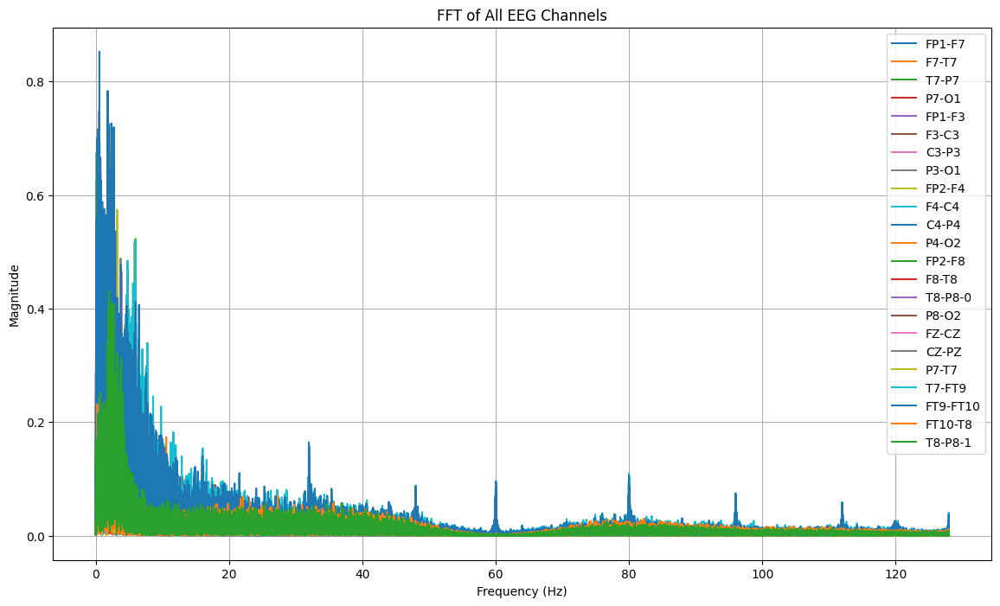

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA10[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2339:
        return "tidak kejang"
    elif 2339 <= row['Time'] < 2449:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_10 = TA10.copy()
TA_10['seizure'] = TA_10.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_10[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7         F7-T7     T7-P7     P7-O1  \
0  2219.000000  tidak kejang -0.000035  2.930403e-07  0.000095 -0.000101   
1  2219.003906  tidak kejang -0.000035  1.670330e-05  0.000083 -0.000085   
2  2219.007812  tidak kejang -0.000041  2.959707e-05  0.000086 -0.000081   
3  2219.011719  tidak kejang -0.000034  3.897436e-05  0.000100 -0.000091   
4  2219.015625  tidak kejang -0.000040  5.069597e-05  0.000096 -0.000087   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000020  0.000006  0.000108 -0.000136  ...  0.000008  0.000031 -0.000043   
1 -0.000023  0.000014  0.000113 -0.000123  ... -0.000012  0.000054 -0.000037   
2 -0.000028  0.000019  0.000120 -0.000118  ... -0.000003  0.000056 -0.000037   
3 -0.000025  0.000031  0.000127 -0.000118  ...  0.000018  0.000057 -0.000043   
4 -0.000039  0.000042  0.000130 -0.000115  ...  0.000031  0.000065 -0.000057   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_10['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,28160


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_10)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 350.0 detik


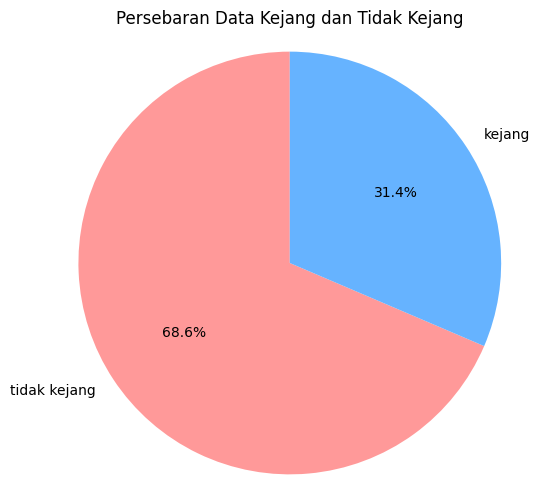

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_10['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_10.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb10_27.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_10.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_10['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.99      0.82      0.90      5666
tidak kejang       0.92      1.00      0.96     12254

    accuracy                           0.94     17920
   macro avg       0.96      0.91      0.93     17920
weighted avg       0.94      0.94      0.94     17920

Akurasi: 0.9408482142857143
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.82      0.90      5666
tidak kejang       0.92      1.00      0.96     12254

    accuracy                           0.94     17920
   macro avg       0.96      0.91      0.93     17920
weighted avg       0.94      0.94      0.94     17920



# DATA 11 (chb10_31) datanya ada 3 gelombang. belum dilanjutin

In [ ]:
# mengimport file edf
file11 = "/content/drive/MyDrive/TA/EDF/chb10_31.edf"
data11 = mne.io.read_raw_edf(file11) # membaca file edf dan menyimpannya di data
data11


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb10_31.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-19-ffab5e0e2631>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data11 = mne.io.read_raw_edf(file11) # membaca file edf dan menyimpannya di data


<RawEDF | chb10_31.edf, 23 x 1848576 (7221.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data11.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data11.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data11.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df11 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df11['Time'] = times  # Menambahkan kolom waktu
df11.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.941392e-05,-2.080586e-05,2.051282e-06,2.080586e-05,-1.643956e-04,-6.945055e-05,1.321612e-04,2.432234e-05,-1.122344e-04,-9.758242e-05,...,1.728938e-05,4.190476e-05,-1.192674e-04,1.169231e-04,-1.465201e-06,-1.142857e-05,8.791209e-07,-3.194139e-05,1.728938e-05,0.000000
1,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.003906
2,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.007812
3,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.011719
4,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df11.shape)


(1846528, 24)


In [ ]:
# mendeskripsikan data
df11.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.852891e-07,2.376687e-07,1.818113e-07,1.710830e-07,1.953602e-07,3.083927e-07,2.056840e-07,2.100881e-07,1.737637e-07,1.953602e-07,...,2.500051e-07,1.726665e-07,1.865262e-07,1.953602e-07,2.089091e-07,1.584775e-07,2.181030e-07,1.999173e-07,1.726665e-07,1799.998047
std,4.320906e-05,3.703641e-05,3.358578e-05,3.644742e-05,2.911677e-22,4.199102e-05,2.101991e-05,1.736408e-05,2.463345e-05,2.911677e-22,...,3.352085e-05,3.140812e-05,2.701736e-05,2.911677e-22,3.358578e-05,3.868148e-05,5.570771e-05,3.149197e-05,3.140812e-05,1039.231048
min,-5.854945e-04,-4.971917e-04,-5.429060e-04,-1.469304e-03,1.953602e-07,-7.034921e-04,-3.885714e-04,-1.553114e-04,-3.237118e-04,1.953602e-07,...,-5.436874e-04,-4.338950e-04,-3.920879e-04,1.953602e-07,-1.483370e-03,-9.820757e-04,-7.851526e-04,-3.432479e-04,-4.338950e-04,0.000000
25%,-1.777778e-05,-1.934066e-05,-1.894994e-05,-2.012210e-05,1.953602e-07,-1.777778e-05,-1.191697e-05,-9.963370e-06,-1.347985e-05,1.953602e-07,...,-1.777778e-05,-1.855922e-05,-1.543346e-05,1.953602e-07,-1.894994e-05,-1.582418e-05,-2.246642e-05,-1.660562e-05,-1.855922e-05,899.999023
50%,-9.768010e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,1799.998047
75%,1.543346e-05,1.894994e-05,1.934066e-05,2.090354e-05,1.953602e-07,1.426129e-05,1.191697e-05,9.963370e-06,1.387057e-05,1.953602e-07,...,1.738706e-05,1.855922e-05,1.543346e-05,1.953602e-07,1.934066e-05,1.660562e-05,2.207570e-05,1.816850e-05,1.855922e-05,2699.997070
max,6.593407e-04,5.026618e-04,1.483761e-03,5.522833e-04,1.953602e-07,8.261783e-04,2.752625e-04,2.186081e-04,2.803419e-04,1.953602e-07,...,5.323565e-04,4.483516e-04,5.956532e-04,1.953602e-07,5.432967e-04,4.921123e-04,9.062759e-04,6.648107e-04,4.483516e-04,3599.996094


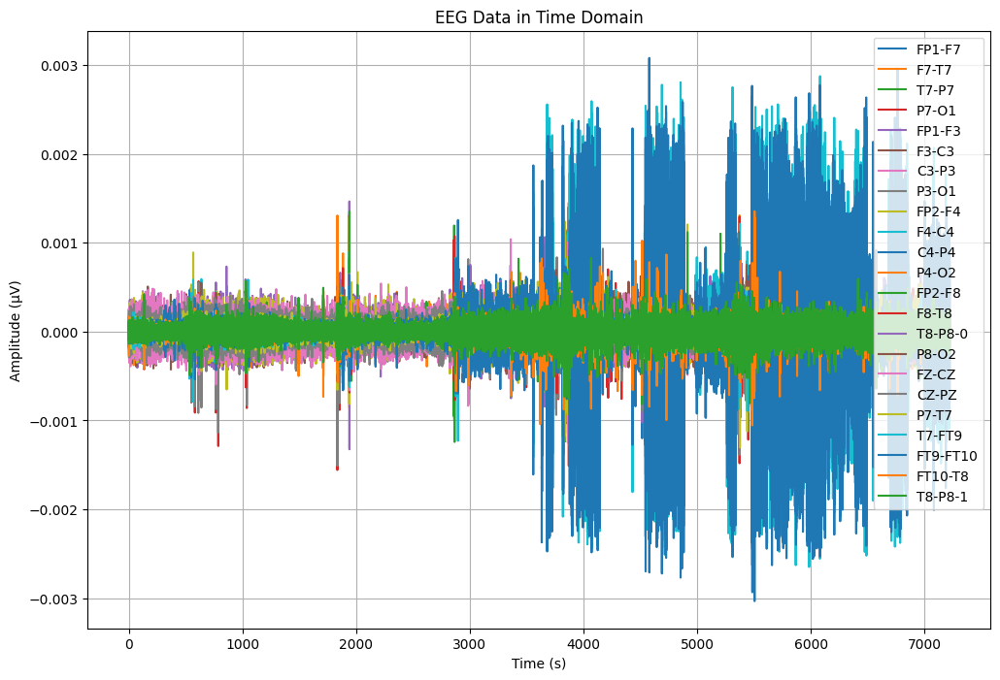

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df11['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df11[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


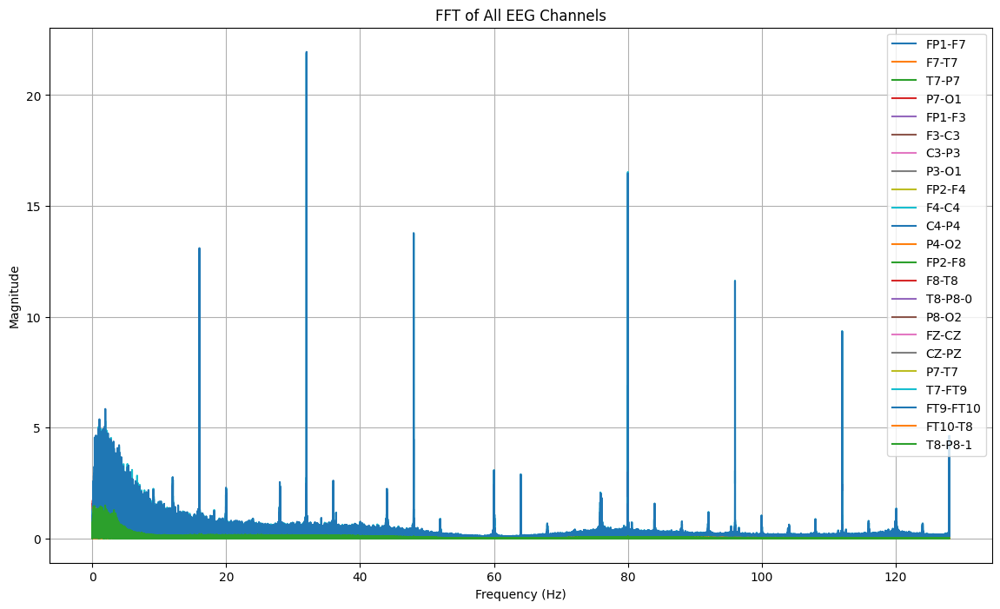

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df11[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb10_31.csv"
df11.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb10_31.csv


In [ ]:
#Import Data CSV
dataTA11 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb10_31.csv")
dataTA11


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.941392e-05,-2.080586e-05,2.051282e-06,2.080586e-05,-1.643956e-04,-6.945055e-05,1.321612e-04,2.432234e-05,-1.122344e-04,-9.758242e-05,...,1.728938e-05,4.190476e-05,-1.192674e-04,1.169231e-04,-1.465201e-06,-1.142857e-05,8.791209e-07,-3.194139e-05,1.728938e-05,0.000000
1,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.003906
2,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.007812
3,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.011719
4,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,...,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,2.930403e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1848571,-8.644689e-05,4.483516e-05,4.483516e-05,1.084249e-05,-6.183150e-05,-8.791209e-07,6.124542e-05,1.846154e-05,-9.465201e-05,2.725275e-05,...,-3.956044e-05,-2.197802e-05,1.465201e-06,1.377289e-05,-4.424908e-05,5.353846e-04,-4.257875e-04,-2.725275e-05,-3.956044e-05,7220.980469
1848572,-7.472527e-05,6.007326e-05,5.479853e-05,2.930403e-07,-4.893773e-05,6.153846e-06,6.241758e-05,2.197802e-05,-8.175824e-05,2.490842e-05,...,-5.567766e-06,-2.021978e-05,2.930403e-07,1.787546e-05,-5.421245e-05,1.714286e-04,-8.586081e-05,-4.542125e-05,-5.567766e-06,7220.984375
1848573,-5.655678e-05,6.358974e-05,3.545788e-05,1.904762e-05,-2.549451e-05,7.912088e-06,5.772894e-05,2.490842e-05,-6.417582e-05,2.080586e-05,...,7.912088e-06,-1.377289e-05,2.930403e-07,2.021978e-05,-3.487179e-05,-4.542125e-05,1.268864e-04,-5.831502e-05,7.912088e-06,7220.988281
1848574,-4.952381e-05,6.476190e-05,-1.465201e-06,5.655678e-05,-4.981685e-06,2.051282e-06,5.421245e-05,1.904762e-05,-4.776557e-05,1.728938e-05,...,1.142857e-05,-7.912088e-06,1.465201e-06,1.963370e-05,2.051282e-06,-7.326007e-06,1.010989e-04,-7.003663e-05,1.142857e-05,7220.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA11[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA11[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA11[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data11, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 32.00 Hz, Magnitude: 21.950715, Time: 4578.328125 s
Channel: T7-FT9, Max Frequency: 32.00 Hz, Magnitude: 21.896512, Time: 6080.781250 s
Channel: P3-O1, Max Frequency: 0.41 Hz, Magnitude: 2.853753, Time: 6414.675781 s
Channel: FP2-F4, Max Frequency: 3.28 Hz, Magnitude: 2.760706, Time: 3872.539062 s
Channel: P7-O1, Max Frequency: 0.62 Hz, Magnitude: 2.700735, Time: 6414.687500 s
Channel: F7-T7, Max Frequency: 1.25 Hz, Magnitude: 2.579495, Time: 5484.093750 s
Channel: FP1-F3, Max Frequency: 3.15 Hz, Magnitude: 2.507596, Time: 1940.031250 s
Channel: F3-C3, Max Frequency: 1.27 Hz, Magnitude: 2.506530, Time: 3870.511719 s
Channel: T7-P7, Max Frequency: 0.58 Hz, Magnitude: 2.299342, Time: 3821.250000 s
Channel: P7-T7, Max Frequency: 0.58 Hz, Magnitude: 2.299342, Time: 3821.250000 s
Channel: FZ-CZ, Max Frequency: 2.14 Hz, Magnitude: 2.295963, Time: 3861.898438 s
Channel: FP2-F8, Max

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP1-F7, Max Frequency: 0.82 Hz, Magnitude: 2.005556, Time: 1834.835938 s
Channel: FP1-F3, Max Frequency: 3.15 Hz, Magnitude: 2.507596, Time: 1940.031250 s
Channel: FP2-F8, Max Frequency: 0.49 Hz, Magnitude: 2.251034, Time: 1940.960938 s
Channel: T7-P7, Max Frequency: 0.58 Hz, Magnitude: 2.299342, Time: 3821.250000 s
Channel: P7-T7, Max Frequency: 0.58 Hz, Magnitude: 2.299342, Time: 3821.250000 s
Channel: CZ-PZ, Max Frequency: 0.84 Hz, Magnitude: 2.169278, Time: 3827.863281 s
Channel: C3-P3, Max Frequency: 1.05 Hz, Magnitude: 2.097167, Time: 3848.539062 s
Channel: FZ-CZ, Max Frequency: 2.14 Hz, Magnitude: 2.295963, Time: 3861.898438 s
Channel: F3-C3, Max Frequency: 1.27 Hz, Magnitude: 2.506530, Time: 3870.511719 s
Channel: FP2-F4, Max Frequency: 3.28 Hz, Magnitude: 2.760706, Time: 3872.539062 s
Channel: T8-P8-0, Max Frequency: 1.92 Hz, Magnitude: 1.487007, Time: 4066.257

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 3701   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3992    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut11 = dataTA11.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut11.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb10_31.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA11 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb10_31.csv")
TA11.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000074,0.000067,0.000104,-0.000010,-0.000096,0.000036,0.000083,0.000062,-0.000086,0.000098,...,-0.000108,2.930403e-07,0.000050,0.000018,-0.000103,0.001447,-0.001275,-0.000037,-0.000108,3701.000000
1,-0.000075,0.000077,0.000101,-0.000017,-0.000093,0.000037,0.000078,0.000061,-0.000079,0.000097,...,-0.000091,-2.256410e-05,0.000047,0.000008,-0.000100,0.001187,-0.001020,-0.000040,-0.000091,3701.003906
2,-0.000081,0.000083,0.000102,-0.000020,-0.000091,0.000037,0.000075,0.000061,-0.000071,0.000093,...,-0.000085,-4.014652e-05,0.000047,-0.000002,-0.000102,0.000762,-0.000595,-0.000033,-0.000085,3701.007812
3,-0.000084,0.000084,0.000099,-0.000011,-0.000085,0.000037,0.000074,0.000062,-0.000064,0.000093,...,-0.000086,-4.835165e-05,0.000054,-0.000017,-0.000099,-0.000567,0.000736,-0.000024,-0.000086,3701.011719
4,-0.000086,0.000089,0.000096,-0.000013,-0.000081,0.000034,0.000074,0.000057,-0.000058,0.000093,...,-0.000082,-5.948718e-05,0.000064,-0.000034,-0.000095,-0.000873,0.001042,-0.000024,-0.000082,3701.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA11.shape


(121600, 24)

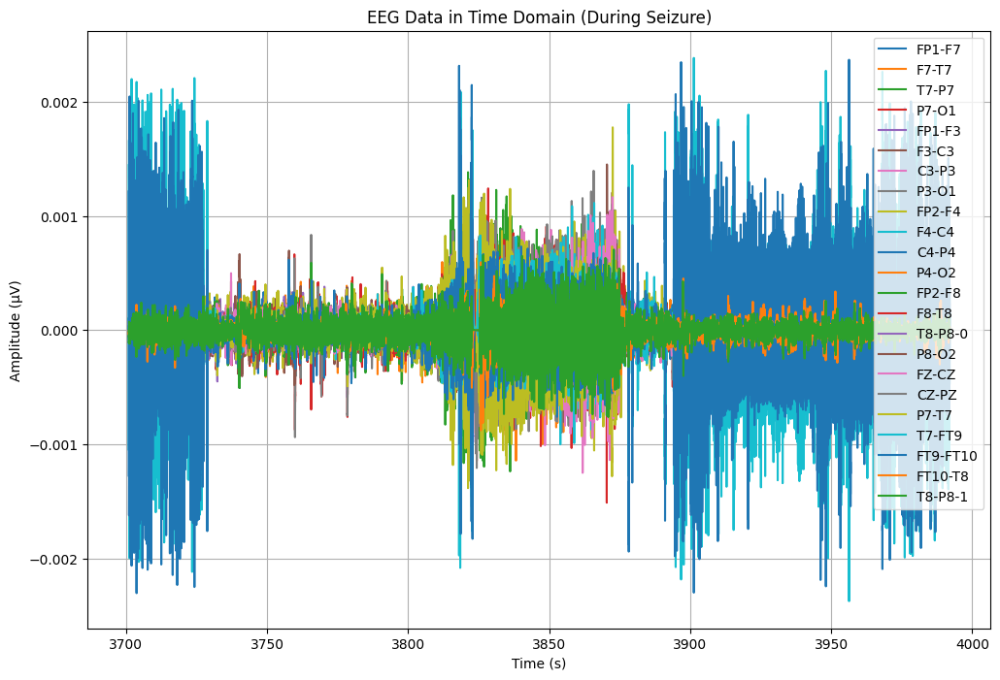

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA11['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA11.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA11[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


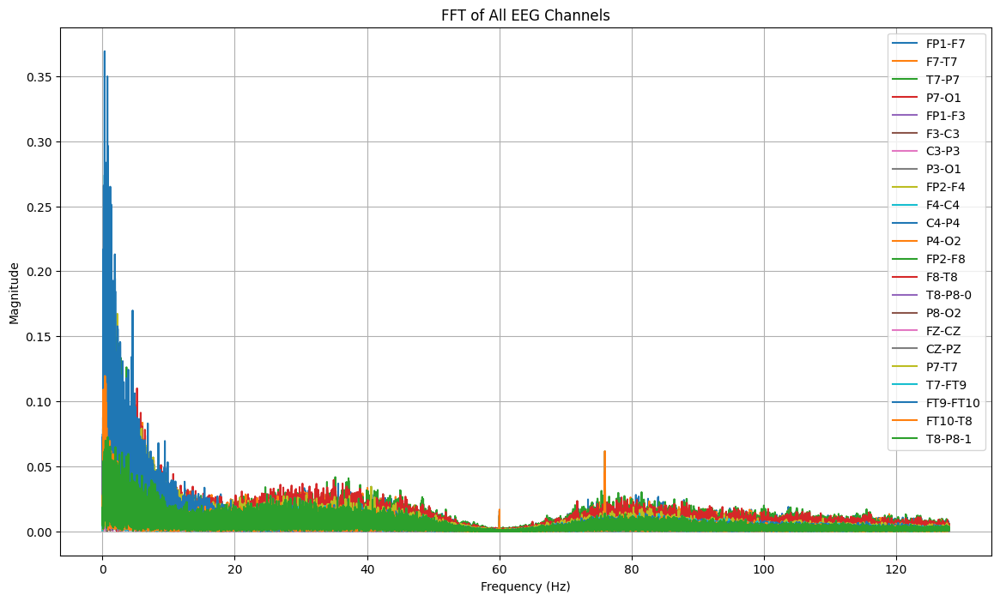

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA11[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 298:
        return "tidak kejang"
    elif 298 <= row['Time'] < 320:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_11 = TA11.copy()
TA_11['seizure'] = TA_11.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_11[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1    FP1-F3  \
0  178.000000  tidak kejang -0.000004 -0.000016 -0.000044  0.000005 -0.000005   
1  178.003906  tidak kejang -0.000009 -0.000024 -0.000052  0.000018 -0.000015   
2  178.007812  tidak kejang -0.000018 -0.000039 -0.000039  0.000020 -0.000031   
3  178.011719  tidak kejang -0.000015 -0.000059 -0.000014  0.000018 -0.000028   
4  178.015625  tidak kejang -0.000009 -0.000048 -0.000029  0.000024 -0.000008   

      F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0         P8-O2  \
0 -0.000032 -0.000006 -0.000014  ... -0.000027 -0.000013 -1.758242e-06   
1 -0.000031 -0.000008 -0.000013  ... -0.000011 -0.000028 -5.860806e-07   
2 -0.000019 -0.000010 -0.000014  ... -0.000028 -0.000037  1.543346e-05   
3 -0.000012 -0.000010 -0.000019  ... -0.000015 -0.000033 -2.539683e-06   
4 -0.000022 -0.000012 -0.000020  ... -0.000008 -0.000022 -1.660562e-05   

          FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   

In [ ]:
import pandas as pd

# Misal kita sudah membaca CSV
# df = pd.read_csv('path/to/your/csv.csv')

# Mencari baris pertama di mana 'kejang' dimulai pada kolom 'seizure'
seizure_start_row = TA_11[TA_11['seizure'] == 'kejang'].index[0]

# Menampilkan baris keberapa label 'kejang' dimulai
print(f"Label kejang dimulai pada baris ke-{seizure_start_row}")



Label kejang dimulai pada baris ke-30720


In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_11['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,5632


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_11)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 262.0 detik


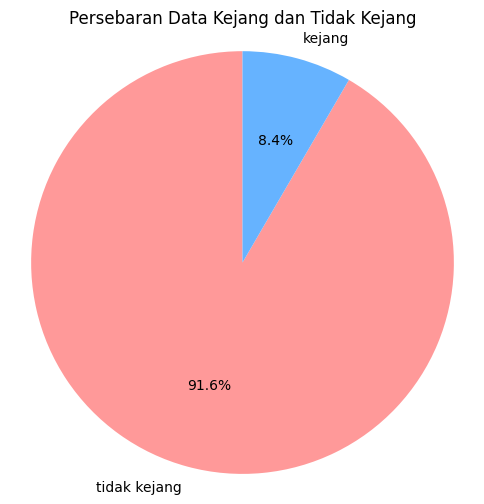

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_11['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_11.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb11_82.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_11.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_11['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.97      0.67      0.79      1176
tidak kejang       0.97      1.00      0.98     12239

    accuracy                           0.97     13415
   macro avg       0.97      0.83      0.89     13415
weighted avg       0.97      0.97      0.97     13415

Akurasi: 0.9693626537458069
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.67      0.79      1176
tidak kejang       0.97      1.00      0.98     12239

    accuracy                           0.97     13415
   macro avg       0.97      0.83      0.89     13415
weighted avg       0.97      0.97      0.97     13415



# DATA 12 (chb11_92) gak dipake visualisasinya gak jelas

In [ ]:
# mengimport file edf
file12 = "/content/drive/MyDrive/TA/EDF/chb11_92.edf"
data12 = mne.io.read_raw_edf(file12) # membaca file edf dan menyimpannya di data
data12


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb11_92.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-76-c2e92285a110>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8', '-'}. Applying running numbers for duplicates.
  data12 = mne.io.read_raw_edf(file12) # membaca file edf dan menyimpannya di data


<RawEDF | chb11_92.edf, 28 x 921600 (3600.0 s), ~32 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data12.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data12.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data12.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 '--0',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 '--1',
 'FZ-CZ',
 'CZ-PZ',
 '--2',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 '--3',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 '--4',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df12 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df12['Time'] = times  # Menambahkan kolom waktu
df12.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.802198e-05,5.020757e-05,2.637363e-05,6.622711e-05,1.953602e-07,-2.442002e-05,6.056166e-06,4.356532e-05,5.958486e-05,1.953602e-07,...,3.379731e-05,-5.665446e-06,1.621490e-05,1.953602e-07,-2.598291e-05,-8.459096e-05,9.592186e-05,2.832723e-05,-5.665446e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df12.shape)


(921600, 29)


In [ ]:
# mendeskripsikan data
df12.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.502671e-07,2.371557e-07,1.609191e-07,1.654279e-07,1.953602e-07,2.597464e-07,1.971595e-07,1.795792e-07,1.485136e-07,1.953602e-07,...,2.067452e-07,1.644553e-07,1.767425e-07,1.953602e-07,2.298013e-07,1.305471e-07,2.040238e-07,2.384938e-07,1.644553e-07,1799.998047
std,7.456002e-05,5.131920e-05,5.070621e-05,4.785068e-05,2.911677e-22,6.959877e-05,2.465969e-05,1.975801e-05,2.517862e-05,2.911677e-22,...,5.019231e-05,3.908611e-05,3.598466e-05,2.911677e-22,5.070621e-05,6.173397e-05,9.229235e-05,3.816182e-05,3.908611e-05,1039.231048
min,-8.117216e-04,-5.096947e-04,-1.451331e-03,-1.550183e-03,1.953602e-07,-7.917949e-04,-7.234188e-04,-3.905250e-04,-6.855189e-04,1.953602e-07,...,-7.007570e-04,-1.260269e-03,-9.691819e-04,1.953602e-07,-1.608010e-03,-1.084835e-03,-1.022320e-03,-7.624908e-04,-1.260269e-03,0.000000
25%,-2.051282e-05,-2.129426e-05,-1.855922e-05,-1.934066e-05,1.953602e-07,-2.051282e-05,-1.308913e-05,-9.963370e-06,-1.191697e-05,1.953602e-07,...,-1.934066e-05,-1.621490e-05,-1.465201e-05,1.953602e-07,-1.934066e-05,-1.777778e-05,-3.028083e-05,-1.504274e-05,-1.621490e-05,899.999023
50%,-5.860806e-07,-5.860806e-07,5.860806e-07,9.768010e-07,1.953602e-07,-9.768010e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.367521e-06,1.953602e-07,-1.953602e-07,1.953602e-07,1799.998047
75%,1.894994e-05,1.973138e-05,1.973138e-05,2.090354e-05,1.953602e-07,1.699634e-05,1.308913e-05,1.074481e-05,1.308913e-05,1.953602e-07,...,1.934066e-05,1.660562e-05,1.504274e-05,1.953602e-07,1.894994e-05,2.090354e-05,2.910867e-05,1.465201e-05,1.660562e-05,2699.997070
max,1.118046e-03,7.746032e-04,1.608400e-03,1.455238e-03,1.953602e-07,1.271600e-03,2.987057e-04,2.924542e-04,3.307448e-04,1.953602e-07,...,7.914042e-04,1.231746e-03,9.914530e-04,1.953602e-07,1.451722e-03,7.831990e-04,1.114530e-03,1.294652e-03,1.231746e-03,3599.996094


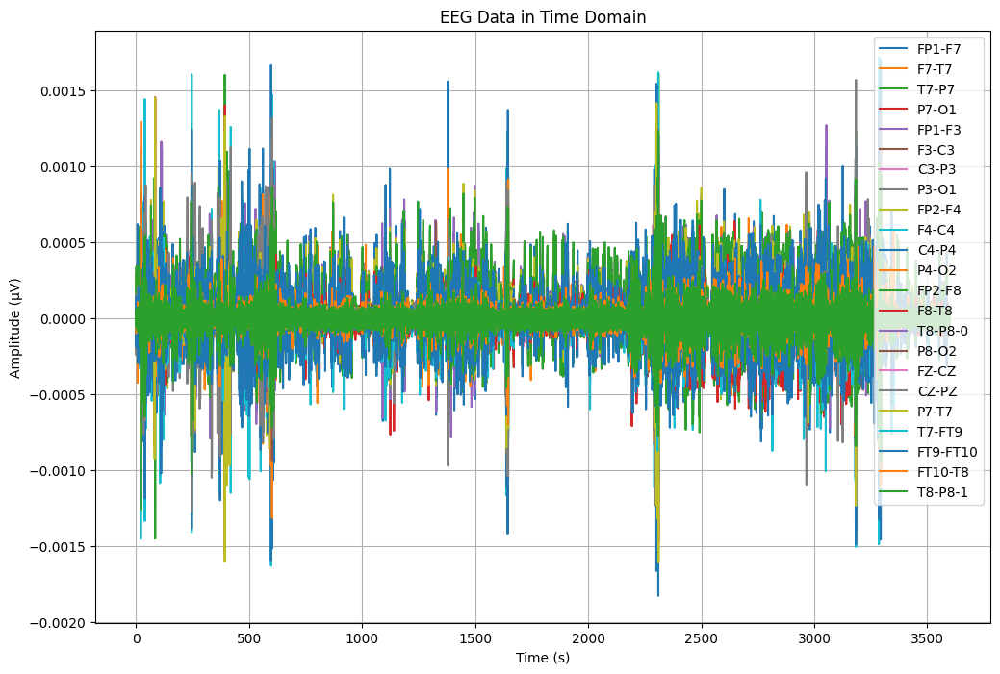

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df12['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df12[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


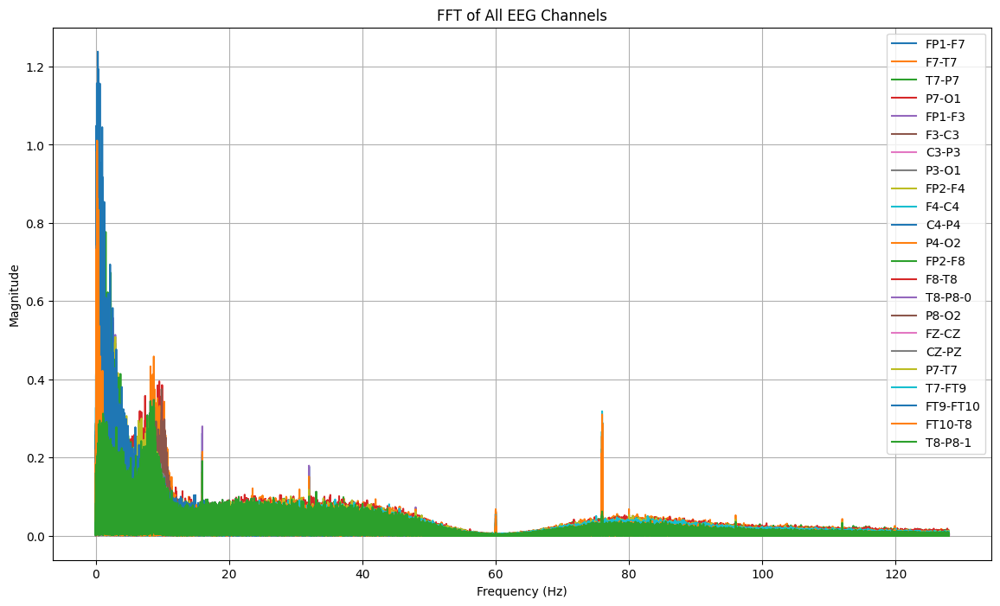

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df11[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_92.csv"
df12.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_92.csv


In [ ]:
#Import Data CSV
dataTA12 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_92.csv")
dataTA12


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.802198e-05,5.020757e-05,2.637363e-05,6.622711e-05,1.953602e-07,-2.442002e-05,6.056166e-06,4.356532e-05,5.958486e-05,1.953602e-07,...,3.379731e-05,-5.665446e-06,1.621490e-05,1.953602e-07,-2.598291e-05,-8.459096e-05,9.592186e-05,2.832723e-05,-5.665446e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,1.074481e-05,2.481074e-05,3.028083e-05,-5.841270e-05,1.953602e-07,1.953602e-07,1.426129e-05,-1.230769e-05,6.446886e-06,1.953602e-07,...,-2.481074e-05,-2.539683e-06,2.012210e-05,1.953602e-07,-2.989011e-05,-1.621490e-05,-4.884005e-06,-1.855922e-05,-2.539683e-06,3599.980469
921596,4.884005e-06,1.894994e-05,3.184371e-05,-5.528694e-05,1.953602e-07,-2.148962e-06,1.035409e-05,-8.009768e-06,1.953602e-07,1.953602e-07,...,-1.953602e-07,-2.207570e-05,1.504274e-05,1.953602e-07,-3.145299e-05,-1.934066e-05,9.768010e-07,8.791209e-06,-2.207570e-05,3599.984375
921597,4.102564e-06,3.321123e-06,3.575092e-05,-4.239316e-05,1.953602e-07,-5.860806e-07,6.837607e-06,-3.321123e-06,-5.860806e-07,1.953602e-07,...,-1.426129e-05,4.493284e-06,9.963370e-06,1.953602e-07,-3.536020e-05,-1.953602e-07,9.768010e-07,-1.465201e-05,4.493284e-06,3599.988281
921598,1.113553e-05,4.102564e-06,1.894994e-05,-2.754579e-05,1.953602e-07,4.102564e-06,3.711844e-06,-1.367521e-06,1.953602e-07,1.953602e-07,...,-1.387057e-05,8.009768e-06,1.191697e-05,1.953602e-07,-1.855922e-05,-1.113553e-05,3.711844e-06,-1.465201e-05,8.009768e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA12[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA12[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA12[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data12, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.65 Hz, Magnitude: 2.083672, Time: 502.046875 s
Channel: FP1-F7, Max Frequency: 0.56 Hz, Magnitude: 1.781071, Time: 113.324219 s
Channel: T7-FT9, Max Frequency: 0.43 Hz, Magnitude: 1.491207, Time: 106.203125 s
Channel: FP2-F8, Max Frequency: 0.23 Hz, Magnitude: 1.484996, Time: 261.937500 s
Channel: FP1-F3, Max Frequency: 0.56 Hz, Magnitude: 1.439436, Time: 3053.742188 s
Channel: F7-T7, Max Frequency: 0.81 Hz, Magnitude: 1.348722, Time: 110.546875 s
Channel: FP2-F4, Max Frequency: 0.40 Hz, Magnitude: 1.326101, Time: 2309.582031 s
Channel: T7-P7, Max Frequency: 0.69 Hz, Magnitude: 0.903036, Time: 2311.191406 s
Channel: P7-T7, Max Frequency: 0.69 Hz, Magnitude: 0.903036, Time: 2311.191406 s
Channel: F8-T8, Max Frequency: 0.65 Hz, Magnitude: 0.901270, Time: 22.238281 s
Channel: P7-O1, Max Frequency: 0.28 Hz, Magnitude: 0.837472, Time: 392.394531 s
Channel: FT10-T8, Max Frequenc

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 1.17 Hz, Magnitude: 0.324955, Time: 22.222656 s
Channel: F3-C3, Max Frequency: 0.72 Hz, Magnitude: 0.374176, Time: 22.234375 s
Channel: F8-T8, Max Frequency: 0.65 Hz, Magnitude: 0.901270, Time: 22.238281 s
Channel: T8-P8-0, Max Frequency: 0.16 Hz, Magnitude: 0.617105, Time: 22.242188 s
Channel: T8-P8-1, Max Frequency: 0.16 Hz, Magnitude: 0.617105, Time: 22.242188 s
Channel: FT10-T8, Max Frequency: 0.13 Hz, Magnitude: 0.776607, Time: 22.261719 s
Channel: T7-FT9, Max Frequency: 0.43 Hz, Magnitude: 1.491207, Time: 106.203125 s
Channel: F7-T7, Max Frequency: 0.81 Hz, Magnitude: 1.348722, Time: 110.546875 s
Channel: FP1-F7, Max Frequency: 0.56 Hz, Magnitude: 1.781071, Time: 113.324219 s
Channel: FP2-F8, Max Frequency: 0.23 Hz, Magnitude: 1.484996, Time: 261.937500 s
Channel: P7-O1, Max Frequency: 0.28 Hz, Magnitude: 0.837472, Time: 392.394531 s
Channel:

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2575   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2847    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut12 = dataTA12.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut12.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb11_92.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA12 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb11_92.csv")
TA12.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000061,-0.000037,-0.000079,0.000021,1.953602e-07,-0.000117,-0.000048,0.000073,5.802198e-05,1.953602e-07,...,-0.000215,-0.000080,0.000029,1.953602e-07,0.000080,0.000035,0.000091,-0.000168,-0.000080,2575.000000
1,0.000057,0.000026,-0.000035,-0.000058,1.953602e-07,-0.000063,0.000003,0.000063,-1.308913e-05,1.953602e-07,...,0.000070,-0.000156,-0.000028,1.953602e-07,0.000036,-0.000037,0.000089,0.000013,-0.000156,2575.003906
2,0.000072,-0.000032,-0.000018,-0.000020,1.953602e-07,-0.000072,-0.000006,0.000036,4.317460e-05,1.953602e-07,...,-0.000243,-0.000137,0.000035,1.953602e-07,0.000018,-0.000027,0.000117,-0.000063,-0.000137,2575.007812
3,0.000097,0.000095,-0.000086,-0.000058,1.953602e-07,-0.000064,0.000057,0.000044,9.181929e-06,1.953602e-07,...,-0.000142,-0.000129,0.000014,1.953602e-07,0.000087,-0.000031,0.000043,-0.000062,-0.000129,2575.011719
4,0.000071,-0.000043,0.000040,-0.000047,1.953602e-07,-0.000005,0.000038,-0.000013,1.953602e-07,1.953602e-07,...,-0.000046,-0.000130,0.000042,1.953602e-07,-0.000040,0.000049,-0.000040,0.000050,-0.000130,2575.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA12.shape


(69632, 29)

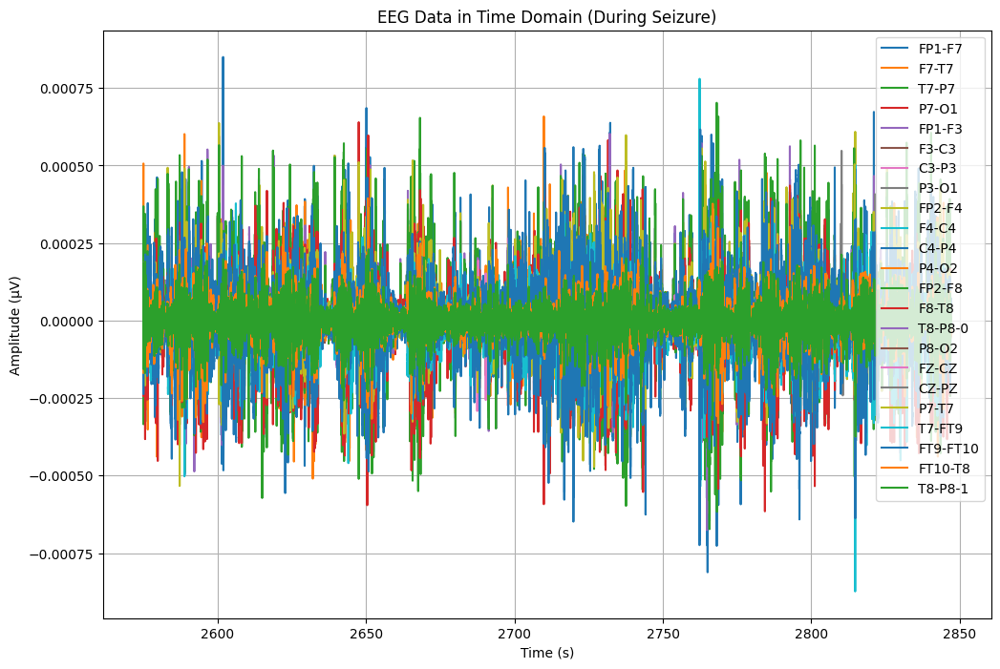

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA12['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA12.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA12[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


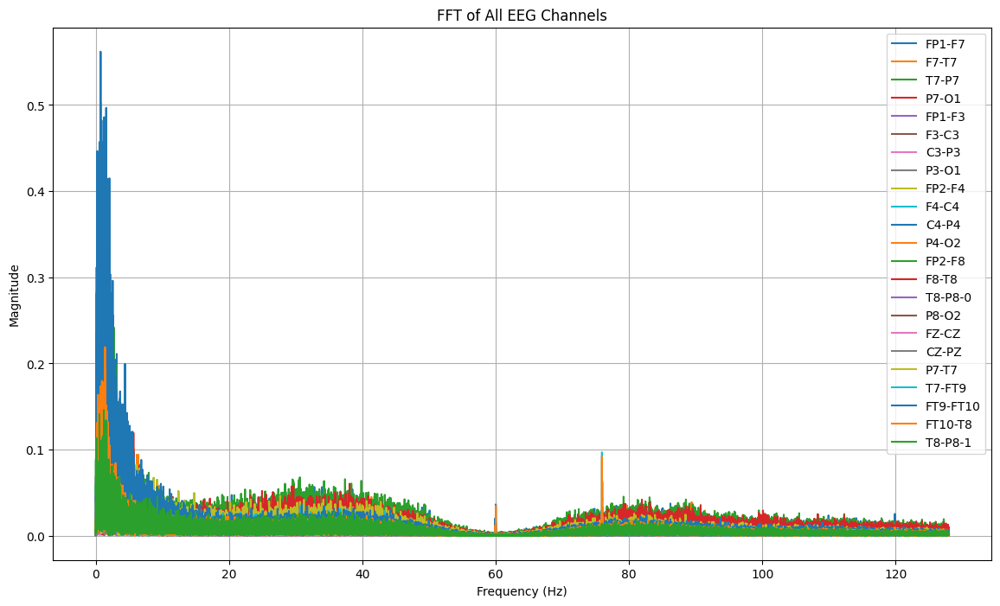

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA12[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2695:
        return "tidak kejang"
    elif 2695 <= row['Time'] < 2727:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_12 = TA12.copy()
TA_12['seizure'] = TA_12.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_12[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2575.000000  tidak kejang  0.000061 -0.000037 -0.000079  0.000021   
1  2575.003906  tidak kejang  0.000057  0.000026 -0.000035 -0.000058   
2  2575.007812  tidak kejang  0.000072 -0.000032 -0.000018 -0.000020   
3  2575.011719  tidak kejang  0.000097  0.000095 -0.000086 -0.000058   
4  2575.015625  tidak kejang  0.000071 -0.000043  0.000040 -0.000047   

     FP1-F3     F3-C3     C3-P3         P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000117 -0.000048  0.000073  5.802198e-05  ... -0.000215 -0.000080   
1 -0.000063  0.000003  0.000063 -1.308913e-05  ...  0.000070 -0.000156   
2 -0.000072 -0.000006  0.000036  4.317460e-05  ... -0.000243 -0.000137   
3 -0.000064  0.000057  0.000044  9.181929e-06  ... -0.000142 -0.000129   
4 -0.000005  0.000038 -0.000013  1.953602e-07  ... -0.000046 -0.000130   

      P8-O2     FZ-CZ         CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0  0.000029 -0.000014  1.152625e-05  0.0000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_12['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,8192


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_12)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 272.0 detik


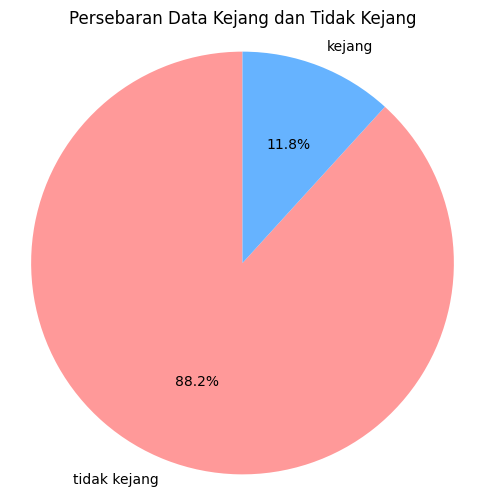

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_12['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_12.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb11_92.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_12.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_12['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.99      0.74      0.84      1691
tidak kejang       0.96      1.00      0.98     12236

    accuracy                           0.97     13927
   macro avg       0.98      0.87      0.91     13927
weighted avg       0.97      0.97      0.96     13927

Akurasi: 0.9667552236662598
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.74      0.84      1691
tidak kejang       0.96      1.00      0.98     12236

    accuracy                           0.97     13927
   macro avg       0.98      0.87      0.91     13927
weighted avg       0.97      0.97      0.96     13927



# DATA 13 (chb01_03)
akurasi = 0.973

In [ ]:
# mengimport file edf
file13 = "/content/drive/MyDrive/TA/EDF/chb01_03 (1).edf"
data13 = mne.io.read_raw_edf(file13) # membaca file edf dan menyimpannya di data
data13


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_03 (1).edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-4-934fd0162745>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data13 = mne.io.read_raw_edf(file13) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_03 (1).edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data13.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data13.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data13.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df13 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df13['Time'] = times  # Menambahkan kolom waktu
df13.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.777778e-05,3.926740e-05,-3.711844e-06,8.400488e-06,-5.860806e-07,4.102564e-06,3.770452e-05,-1.504274e-05,-1.738706e-05,-4.512821e-05,...,-5.997558e-05,1.803175e-04,-1.855922e-05,8.537241e-05,4.102564e-06,2.090354e-05,-9.181929e-06,-3.965812e-05,-5.997558e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,2.148962e-06,5.860806e-07,5.860806e-07,1.953602e-07,1.367521e-06,-1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df13.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df13.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.792972e-07,1.699668e-07,2.115262e-07,2.129045e-07,1.915001e-07,1.780686e-07,2.059151e-07,2.027239e-07,1.950278e-07,1.785070e-07,...,1.954594e-07,1.878718e-07,1.776434e-07,2.107020e-07,1.791942e-07,1.945534e-07,2.217894e-07,2.154592e-07,1.954594e-07,1799.998047
std,4.071426e-05,3.289431e-05,3.995194e-05,3.321602e-05,4.711351e-05,4.723402e-05,3.430131e-05,4.248185e-05,4.595016e-05,4.620191e-05,...,4.641400e-05,4.979114e-05,5.520218e-05,5.049616e-05,3.995194e-05,2.462092e-05,4.820836e-05,2.545986e-05,4.641400e-05,1039.231048
min,-4.800000e-04,-2.819048e-04,-3.139438e-04,-2.057143e-04,-5.132112e-04,-4.311600e-04,-3.166789e-04,-3.862271e-04,-5.362637e-04,-5.542369e-04,...,-7.210745e-04,-3.784127e-04,-5.401709e-04,-4.917216e-04,-3.092552e-04,-2.260317e-04,-5.124298e-04,-2.893284e-04,-7.210745e-04,0.000000
25%,-1.816850e-05,-1.660562e-05,-1.973138e-05,-1.738706e-05,-2.363858e-05,-2.402930e-05,-1.816850e-05,-2.246642e-05,-2.285714e-05,-2.207570e-05,...,-2.129426e-05,-2.637363e-05,-2.715507e-05,-2.754579e-05,-1.934066e-05,-1.347985e-05,-2.363858e-05,-1.269841e-05,-2.129426e-05,899.999023
50%,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.894994e-05,1.738706e-05,1.973138e-05,1.777778e-05,2.402930e-05,2.559219e-05,1.816850e-05,2.285714e-05,2.285714e-05,2.324786e-05,...,2.168498e-05,2.676435e-05,2.832723e-05,2.715507e-05,2.012210e-05,1.426129e-05,2.363858e-05,1.269841e-05,2.168498e-05,2699.997070
max,4.995360e-04,3.057387e-04,3.096459e-04,1.986813e-04,5.565812e-04,3.494994e-04,3.631746e-04,3.432479e-04,4.514774e-04,3.952137e-04,...,4.764835e-04,4.796093e-04,5.952625e-04,4.694505e-04,3.143346e-04,3.170696e-04,4.854701e-04,5.003175e-04,4.764835e-04,3599.996094


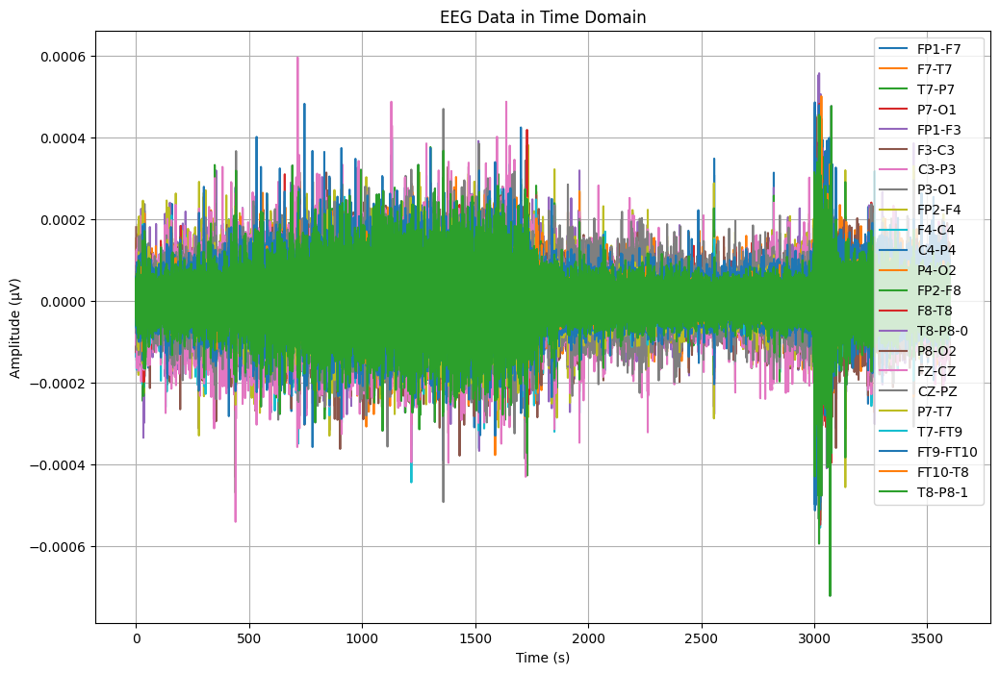

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df13['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df13[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


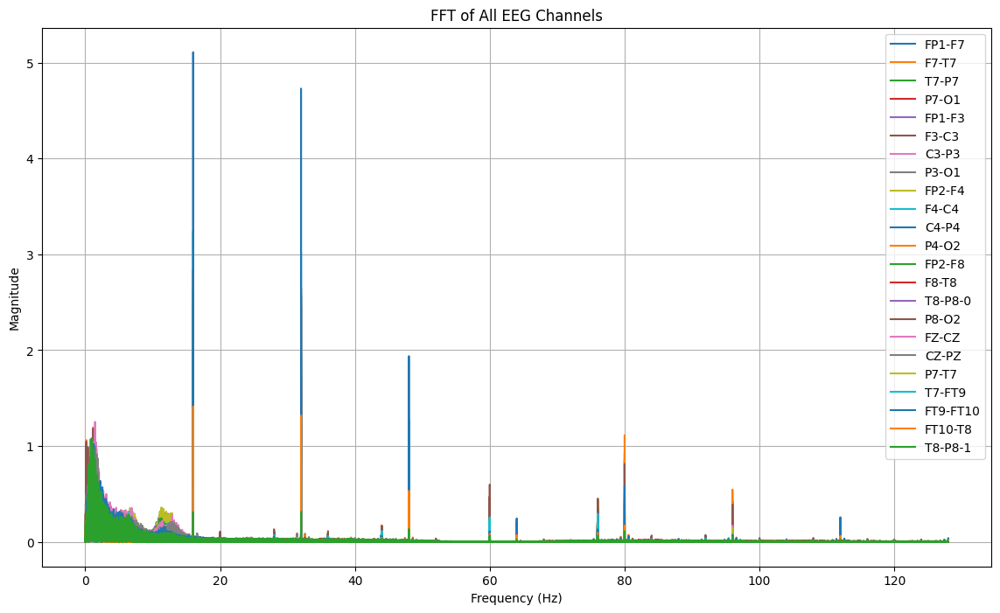

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df13[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_03.csv"
df13.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_03.csv


In [ ]:
#Import Data CSV
dataTA13 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_03.csv")
dataTA13


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.777778e-05,3.926740e-05,-3.711844e-06,8.400488e-06,-5.860806e-07,4.102564e-06,3.770452e-05,-1.504274e-05,-1.738706e-05,-4.512821e-05,...,-5.997558e-05,1.803175e-04,-1.855922e-05,8.537241e-05,4.102564e-06,2.090354e-05,-9.181929e-06,-3.965812e-05,-5.997558e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,2.148962e-06,5.860806e-07,5.860806e-07,1.953602e-07,1.367521e-06,-1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-3.379731e-05,-3.965812e-05,6.349206e-05,2.363858e-05,1.504274e-05,-2.754579e-05,2.012210e-05,5.274725e-06,1.660562e-05,-2.148962e-06,...,-1.367521e-06,-5.137973e-05,1.347985e-05,-3.106227e-05,-6.310134e-05,-5.665446e-06,8.810745e-05,4.786325e-05,-1.367521e-06,3599.980469
921596,-2.754579e-05,-2.676435e-05,6.505495e-05,1.035409e-05,2.285714e-05,-1.191697e-05,1.855922e-05,-9.181929e-06,2.637363e-05,4.884005e-06,...,9.963370e-06,-6.935287e-05,2.637363e-05,-2.676435e-05,-6.466422e-05,-4.884005e-06,7.912088e-05,4.864469e-05,9.963370e-06,3599.984375
921597,-1.777778e-05,-2.324786e-05,5.919414e-05,1.465201e-05,3.418803e-05,-2.539683e-06,9.181929e-06,-9.181929e-06,3.067155e-05,4.493284e-06,...,1.934066e-05,-4.512821e-05,2.246642e-05,-2.598291e-05,-5.880342e-05,8.009768e-06,4.864469e-05,4.356532e-05,1.934066e-05,3599.988281
921598,-8.791209e-06,-2.246642e-05,6.036630e-05,1.191697e-05,4.239316e-05,2.930403e-06,1.465201e-05,-1.973138e-05,3.575092e-05,8.400488e-06,...,2.637363e-05,-2.793651e-05,2.442002e-05,-1.855922e-05,-5.997558e-05,2.598291e-05,2.793651e-05,3.848596e-05,2.637363e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA13[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA13[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA13[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data13, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 5.107724, Time: 3003.339844 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 3.242629, Time: 3268.210938 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 2.835942, Time: 3026.292969 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 2.628186, Time: 439.832031 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 2.597257, Time: 3027.472656 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 2.577463, Time: 1720.910156 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 2.045068, Time: 1359.230469 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.894707, Time: 3026.625000 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 1.838531, Time: 3021.804688 s
Channel: P4-O2, Max Frequency: 32.00 Hz, Magnitude: 1.747145, Time: 3074.574219 s
Channel: P7-O1, Max Frequency: 32.00 Hz, Magnitude: 1.631361, Time: 1053.695312 s
Channel: C3-P3

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 2.628186, Time: 439.832031 s
Channel: FP2-F8, Max Frequency: 16.00 Hz, Magnitude: 1.358953, Time: 439.859375 s
Channel: FZ-CZ, Max Frequency: 1.45 Hz, Magnitude: 1.252469, Time: 714.753906 s
Channel: P7-O1, Max Frequency: 32.00 Hz, Magnitude: 1.631361, Time: 1053.695312 s
Channel: T7-P7, Max Frequency: 0.99 Hz, Magnitude: 0.982646, Time: 1252.812500 s
Channel: P7-T7, Max Frequency: 0.99 Hz, Magnitude: 0.982646, Time: 1252.812500 s
Channel: CZ-PZ, Max Frequency: 0.80 Hz, Magnitude: 1.072837, Time: 1359.226562 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 2.045068, Time: 1359.230469 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 1.487110, Time: 1359.449219 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 2.577463, Time: 1720.910156 s
Channel: F7-T7, Max Frequency: 1.37 Hz, Magnitude: 0.695057, Time: 1730.84375

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2883   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3194    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut13 = dataTA13.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut13.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_03.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA13 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb01_03.csv")
TA13


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000023,-0.000005,0.000008,0.000019,-5.860806e-07,-0.000024,0.000012,0.000011,-1.621490e-05,0.000010,...,0.000003,2.520147e-05,5.860806e-07,4.493284e-06,-0.000008,-2.148962e-06,-6.837607e-06,4.884005e-06,0.000003,2883.000000
1,-0.000024,-0.000006,0.000006,0.000024,-3.711844e-06,-0.000023,0.000013,0.000015,-2.012210e-05,0.000009,...,0.000004,4.122100e-05,6.446886e-06,4.493284e-06,-0.000005,-1.367521e-06,-9.181929e-06,3.321123e-06,0.000004,2883.003906
2,-0.000022,-0.000004,0.000005,0.000028,-5.274725e-06,-0.000021,0.000015,0.000019,-2.324786e-05,0.000008,...,0.000005,4.083028e-05,8.791209e-06,2.539683e-06,-0.000004,-2.539683e-06,-1.191697e-05,9.768010e-07,0.000005,2883.007812
3,-0.000020,-0.000002,0.000005,0.000029,-8.009768e-06,-0.000020,0.000015,0.000026,-2.481074e-05,0.000003,...,0.000005,3.770452e-05,7.619048e-06,1.953602e-07,-0.000005,-6.056166e-06,-1.308913e-05,-1.953602e-07,0.000005,2883.011719
4,-0.000013,-0.000002,0.000005,0.000029,-6.446886e-06,-0.000020,0.000018,0.000029,-2.168498e-05,-0.000002,...,0.000003,5.489621e-05,7.619048e-06,4.493284e-06,-0.000004,-5.860806e-07,-1.699634e-05,-1.758242e-06,0.000003,2883.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79611,-0.000029,0.000026,0.000007,0.000064,-3.653236e-05,0.000008,0.000044,0.000053,-1.699634e-05,0.000016,...,0.000069,1.347985e-05,-9.768010e-07,6.857143e-05,-0.000007,-4.551893e-05,6.466422e-05,-6.056166e-06,0.000069,3193.980469
79612,-0.000035,0.000040,0.000018,0.000044,-4.356532e-05,0.000019,0.000053,0.000038,-9.963370e-06,0.000023,...,0.000053,-1.230769e-05,5.665446e-06,5.645910e-05,-0.000018,-5.177045e-05,6.271062e-05,1.738706e-05,0.000053,3193.984375
79613,-0.000019,0.000052,0.000016,0.000026,-3.106227e-05,0.000048,0.000037,0.000021,-9.768010e-07,0.000012,...,0.000046,1.758242e-06,4.493284e-06,5.177045e-05,-0.000015,-3.028083e-05,2.285714e-05,9.181929e-06,0.000046,3193.988281
79614,-0.000012,0.000061,0.000018,0.000011,-2.559219e-05,0.000066,0.000030,0.000007,2.930403e-06,0.000010,...,0.000042,4.102564e-06,6.837607e-06,5.372405e-05,-0.000018,-1.621490e-05,7.619048e-06,-2.539683e-06,0.000042,3193.992188


In [ ]:
# melihat ukuran file yang sudah dipotong
TA13.shape


(79616, 24)

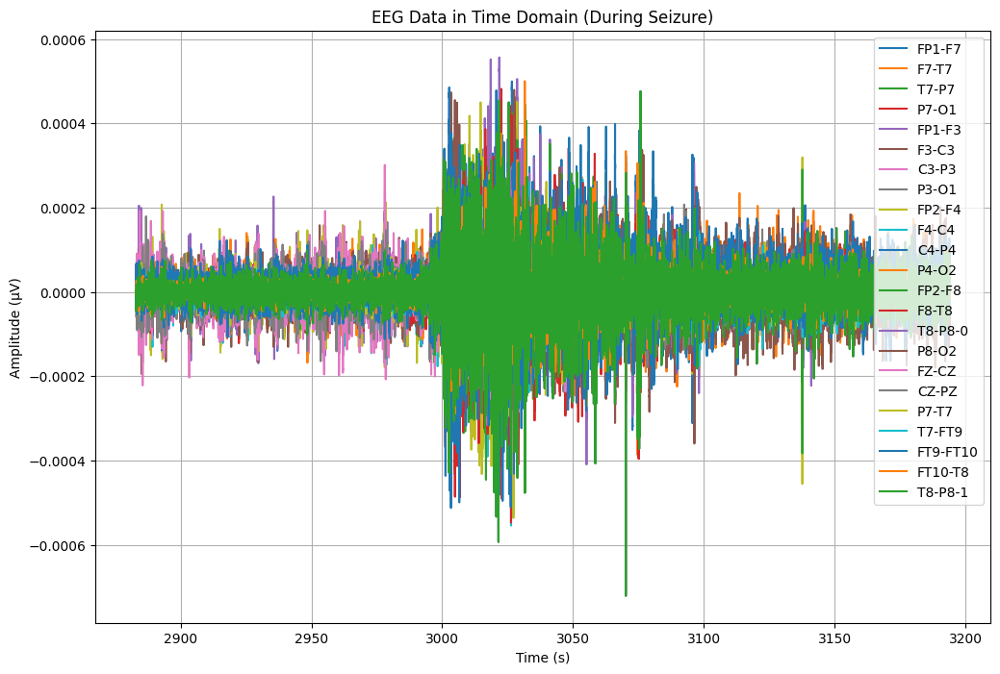

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA13['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA13.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA13[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


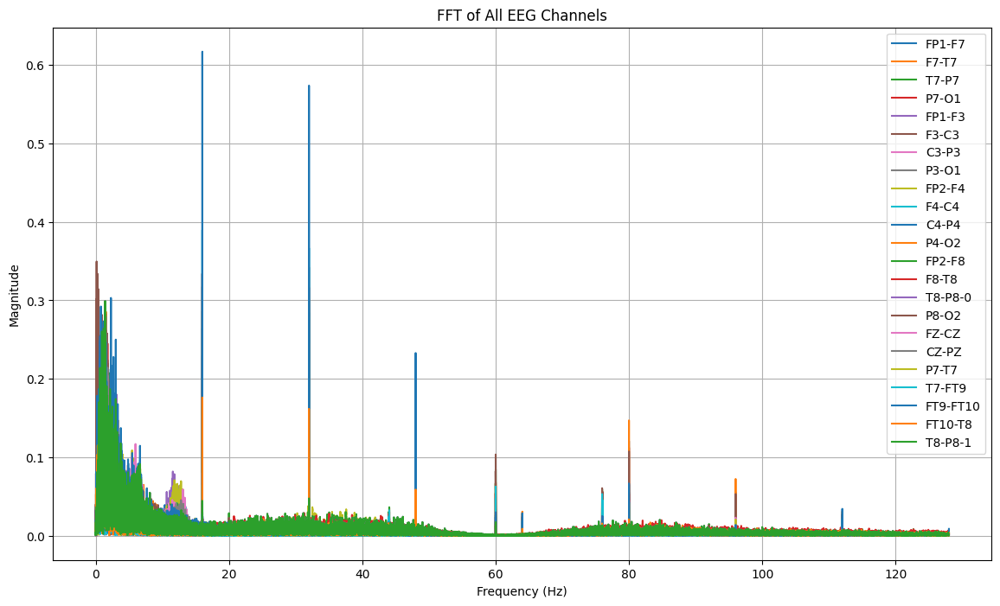

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA13[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 3003:
        return "tidak kejang"
    elif 3003 <= row['Time'] < 3074:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_13 = TA13.copy()
TA_13['seizure'] = TA_13.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_13[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2883.000000  tidak kejang -0.000023 -0.000005  0.000008  0.000019   
1  2883.003906  tidak kejang -0.000024 -0.000006  0.000006  0.000024   
2  2883.007812  tidak kejang -0.000022 -0.000004  0.000005  0.000028   
3  2883.011719  tidak kejang -0.000020 -0.000002  0.000005  0.000029   
4  2883.015625  tidak kejang -0.000013 -0.000002  0.000005  0.000029   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -5.860806e-07 -0.000024  0.000012  0.000011  ...  0.000006  0.000003   
1 -3.711844e-06 -0.000023  0.000013  0.000015  ...  0.000008  0.000004   
2 -5.274725e-06 -0.000021  0.000015  0.000019  ...  0.000015  0.000005   
3 -8.009768e-06 -0.000020  0.000015  0.000026  ...  0.000025  0.000005   
4 -6.446886e-06 -0.000020  0.000018  0.000029  ...  0.000018  0.000003   

      P8-O2         FZ-CZ         CZ-PZ     P7-T7        T7-FT9  FT9-FT10  \
0  0.000025  5.860806e-07  4.493284e-06 -0.00

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_13['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,18176


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_13)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 311.0 detik


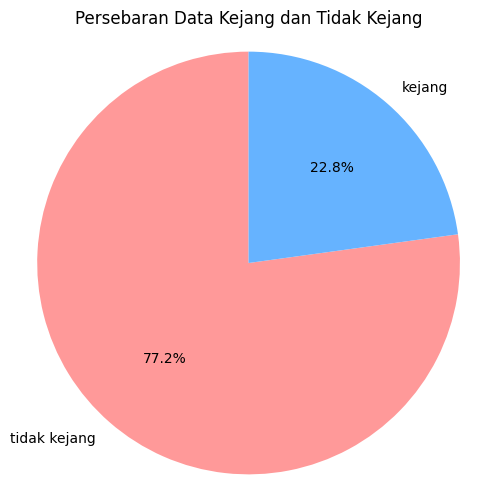

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_13['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_13.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb01_03.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_13.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_13['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.96      0.92      0.94      3719
tidak kejang       0.98      0.99      0.98     12205

    accuracy                           0.97     15924
   macro avg       0.97      0.95      0.96     15924
weighted avg       0.97      0.97      0.97     15924

Akurasi: 0.9731223310725948
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.92      0.94      3719
tidak kejang       0.98      0.99      0.98     12205

    accuracy                           0.97     15924
   macro avg       0.97      0.95      0.96     15924
weighted avg       0.97      0.97      0.97     15924



# DATA 20 (chb02_19) gak jelas

In [ ]:
# mengimport file edf
file20 = "/content/drive/MyDrive/TA/EDF/chb02_19.edf"
data20 = mne.io.read_raw_edf(file20) # membaca file edf dan menyimpannya di data
data20


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb02_19.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-247-4bf89b2b0610>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data20 = mne.io.read_raw_edf(file20) # membaca file edf dan menyimpannya di data


<RawEDF | chb02_19.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data20.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data20.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data20.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df20 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df20['Time'] = times  # Menambahkan kolom waktu
df20.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-2.949939e-05,-9.572650e-06,1.013919e-04,-3.223443e-05,-3.262515e-05,3.731380e-05,9.435897e-05,-6.896215e-05,4.884005e-06,1.035409e-05,...,2.871795e-05,1.367521e-06,2.754579e-05,1.103785e-04,-1.010012e-04,5.724054e-05,3.536020e-05,-5.333333e-05,2.871795e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,9.768010e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,-9.768010e-07,1.953602e-07,5.860806e-07,9.768010e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,-2.148962e-06,1.953602e-07,...,-5.860806e-07,1.367521e-06,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-5.860806e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df20.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df20.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.836733e-07,2.777078e-07,1.168680e-07,1.687962e-07,2.655139e-07,2.033823e-07,1.899607e-07,1.932841e-07,3.010671e-07,2.097574e-07,...,1.086750e-07,1.796979e-07,2.098956e-07,1.827690e-07,2.738523e-07,1.405555e-07,1.963099e-07,2.443686e-07,1.086750e-07,1799.998047
std,7.060445e-05,4.669756e-05,5.303388e-05,4.497394e-05,6.599013e-05,4.404182e-05,5.315197e-05,4.944983e-05,1.206243e-04,2.700399e-05,...,5.523045e-05,3.769038e-05,4.080256e-05,9.436798e-05,5.303388e-05,4.875871e-05,5.047455e-05,4.645920e-05,5.523045e-05,1039.231048
min,-1.780317e-03,-8.550916e-04,-1.212991e-03,-8.535287e-04,-1.532991e-03,-9.172161e-04,-1.846740e-03,-9.090110e-04,-1.711551e-03,-4.491331e-04,...,-1.132503e-03,-5.796337e-04,-1.263785e-03,-1.475946e-03,-6.241758e-04,-1.050842e-03,-7.054457e-04,-5.612698e-04,-1.132503e-03,0.000000
25%,-2.442002e-05,-1.894994e-05,-1.894994e-05,-1.855922e-05,-2.402930e-05,-1.855922e-05,-1.894994e-05,-1.816850e-05,-3.028083e-05,-1.465201e-05,...,-1.699634e-05,-1.426129e-05,-1.543346e-05,-2.129426e-05,-2.129426e-05,-1.543346e-05,-1.621490e-05,-1.543346e-05,-1.699634e-05,899.999023
50%,-1.367521e-06,-5.860806e-07,9.768010e-07,5.860806e-07,-1.367521e-06,-1.953602e-07,1.953602e-07,1.953602e-07,-1.758242e-06,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1799.998047
75%,2.012210e-05,1.738706e-05,2.168498e-05,1.934066e-05,2.051282e-05,1.855922e-05,1.894994e-05,1.894994e-05,2.481074e-05,1.465201e-05,...,1.934066e-05,1.465201e-05,1.543346e-05,2.168498e-05,1.934066e-05,1.738706e-05,1.699634e-05,1.465201e-05,1.934066e-05,2699.997070
max,1.408352e-03,9.910623e-04,6.245665e-04,7.601465e-04,1.606447e-03,1.217680e-03,1.672479e-03,8.461050e-04,1.626374e-03,4.292063e-04,...,6.976313e-04,9.953602e-04,1.666227e-03,1.867057e-03,1.213382e-03,6.784860e-04,6.007326e-04,1.018803e-03,6.976313e-04,3599.996094


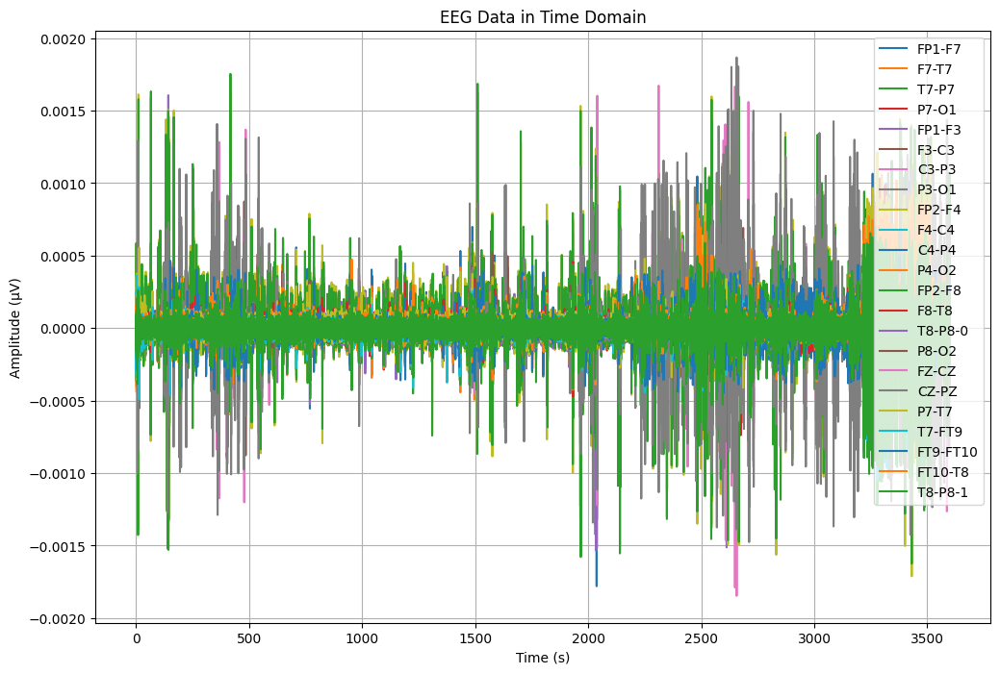

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df20['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df20[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


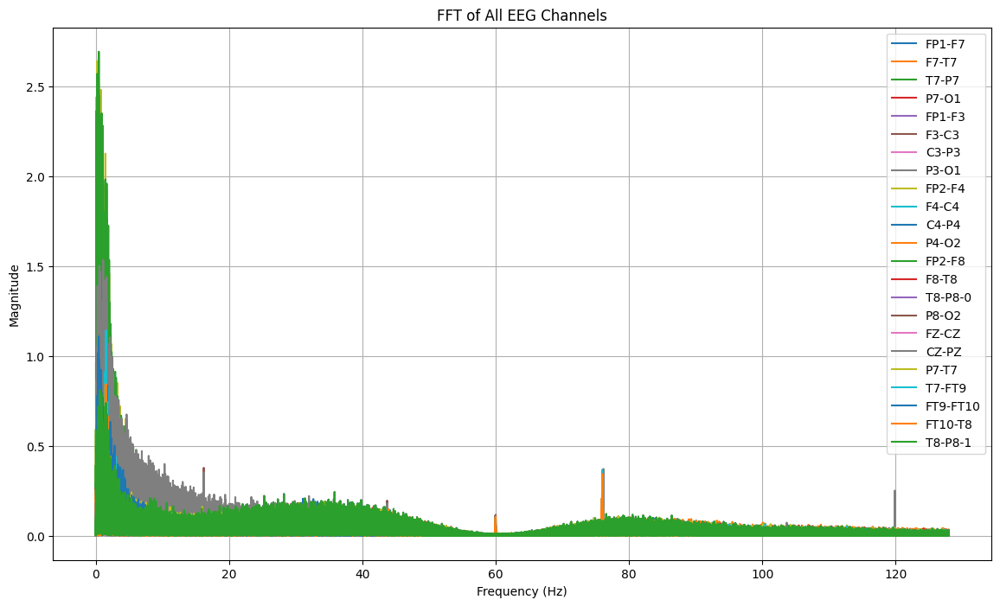

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df20[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_19.csv"
df20.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_19.csv


In [ ]:
#Import Data CSV
dataTA20 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_19.csv")
dataTA20


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-2.949939e-05,-9.572650e-06,1.013919e-04,-3.223443e-05,-3.262515e-05,3.731380e-05,9.435897e-05,-6.896215e-05,4.884005e-06,1.035409e-05,...,2.871795e-05,1.367521e-06,2.754579e-05,1.103785e-04,-1.010012e-04,5.724054e-05,3.536020e-05,-5.333333e-05,2.871795e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,9.768010e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,-9.768010e-07,1.953602e-07,5.860806e-07,9.768010e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,-2.148962e-06,1.953602e-07,...,-5.860806e-07,1.367521e-06,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-2.949939e-05,-2.012210e-05,-8.791209e-06,-1.387057e-05,-3.379731e-05,-6.271062e-05,1.074481e-05,1.074481e-05,1.269841e-05,-3.848596e-05,...,-1.699634e-05,-2.012210e-05,-3.262515e-05,-3.321123e-06,9.181929e-06,-9.963370e-06,4.102564e-06,2.989011e-05,-1.699634e-05,3599.980469
921596,-1.777778e-05,-1.621490e-05,-1.035409e-05,-1.543346e-05,-2.246642e-05,-5.489621e-05,6.837607e-06,8.009768e-06,4.102564e-06,-2.871795e-05,...,-9.768010e-07,-2.363858e-05,-3.106227e-05,6.446886e-06,1.074481e-05,2.930403e-06,2.539683e-06,7.619048e-06,-9.768010e-07,3599.984375
921597,-5.645910e-05,-1.269841e-05,-1.855922e-05,-5.665446e-06,-5.997558e-05,-5.958486e-05,4.493284e-06,1.934066e-05,-1.953602e-07,-2.246642e-05,...,1.347985e-05,-2.051282e-05,-3.340659e-05,1.191697e-05,1.894994e-05,6.056166e-06,5.860806e-07,-8.791209e-06,1.347985e-05,3599.988281
921598,-3.262515e-05,-5.860806e-07,-3.145299e-05,-6.446886e-06,-4.356532e-05,-4.512821e-05,2.539683e-06,1.308913e-05,9.768010e-07,-1.699634e-05,...,2.598291e-05,-1.738706e-05,-2.989011e-05,2.520147e-05,3.184371e-05,-1.074481e-05,-1.953602e-07,-1.660562e-05,2.598291e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA20[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA20[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA20[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data20, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP2-F8, Max Frequency: 0.48 Hz, Magnitude: 2.691698, Time: 417.292969 s
Channel: FP2-F4, Max Frequency: 0.21 Hz, Magnitude: 2.639032, Time: 3431.414062 s
Channel: CZ-PZ, Max Frequency: 1.13 Hz, Magnitude: 1.533803, Time: 2656.785156 s
Channel: FP1-F7, Max Frequency: 0.37 Hz, Magnitude: 1.283179, Time: 2037.324219 s
Channel: FP1-F3, Max Frequency: 0.48 Hz, Magnitude: 1.216813, Time: 142.507812 s
Channel: C3-P3, Max Frequency: 0.28 Hz, Magnitude: 1.160056, Time: 2656.843750 s
Channel: P3-O1, Max Frequency: 0.28 Hz, Magnitude: 1.145087, Time: 2311.765625 s
Channel: T7-FT9, Max Frequency: 1.55 Hz, Magnitude: 1.142266, Time: 3279.183594 s
Channel: FT9-FT10, Max Frequency: 0.45 Hz, Magnitude: 1.108334, Time: 3480.074219 s
Channel: P7-O1, Max Frequency: 0.25 Hz, Magnitude: 1.069789, Time: 2582.160156 s
Channel: C4-P4, Max Frequency: 0.39 Hz, Magnitude: 1.058784, Time: 2595.031250 s
Channel: P4-O2, Max Freq

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP1-F3, Max Frequency: 0.48 Hz, Magnitude: 1.216813, Time: 142.507812 s
Channel: FP2-F8, Max Frequency: 0.48 Hz, Magnitude: 2.691698, Time: 417.292969 s
Channel: P4-O2, Max Frequency: 0.24 Hz, Magnitude: 1.001392, Time: 2015.332031 s
Channel: FP1-F7, Max Frequency: 0.37 Hz, Magnitude: 1.283179, Time: 2037.324219 s
Channel: P3-O1, Max Frequency: 0.28 Hz, Magnitude: 1.145087, Time: 2311.765625 s
Channel: P8-O2, Max Frequency: 0.24 Hz, Magnitude: 0.822336, Time: 2569.273438 s
Channel: P7-O1, Max Frequency: 0.25 Hz, Magnitude: 1.069789, Time: 2582.160156 s
Channel: C4-P4, Max Frequency: 0.39 Hz, Magnitude: 1.058784, Time: 2595.031250 s
Channel: FZ-CZ, Max Frequency: 1.57 Hz, Magnitude: 0.511563, Time: 2649.574219 s
Channel: F3-C3, Max Frequency: 0.91 Hz, Magnitude: 0.912018, Time: 2649.585938 s
Channel: CZ-PZ, Max Frequency: 1.13 Hz, Magnitude: 1.533803, Time: 2656.785156 s

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 3245   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3498    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut20 = dataTA20.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut20.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb02_19.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA20 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb02_19.csv")
TA20.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000031,-0.000065,1.035409e-05,0.000023,0.000025,-1.035409e-05,-0.000003,-0.000010,0.000594,-4.493284e-06,...,0.000033,-0.000002,1.035409e-05,-0.000004,-9.963370e-06,0.000038,-0.000022,-0.000009,0.000033,3245.000000
1,0.000031,-0.000059,-4.884005e-06,0.000029,0.000023,-1.230769e-05,-0.000008,-0.000005,0.000581,-4.493284e-06,...,0.000011,-0.000010,1.758242e-06,-0.000003,5.274725e-06,0.000054,-0.000043,0.000013,0.000011,3245.003906
2,0.000021,-0.000053,1.953602e-07,0.000025,0.000024,-9.572650e-06,-0.000007,-0.000012,0.000574,-5.860806e-07,...,0.000033,-0.000013,-2.539683e-06,-0.000008,1.953602e-07,0.000032,-0.000003,-0.000008,0.000033,3245.007812
3,0.000026,-0.000046,9.181929e-06,0.000023,0.000034,1.953602e-07,-0.000003,-0.000016,0.000551,4.493284e-06,...,0.000042,-0.000026,9.768010e-07,-0.000006,-8.791209e-06,0.000024,0.000013,-0.000015,0.000042,3245.011719
4,0.000046,-0.000028,6.056166e-06,0.000034,0.000053,1.426129e-05,-0.000002,-0.000005,0.000529,9.572650e-06,...,0.000015,-0.000008,1.074481e-05,0.000012,-5.665446e-06,0.000036,-0.000006,-0.000003,0.000015,3245.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA20.shape

(64768, 24)

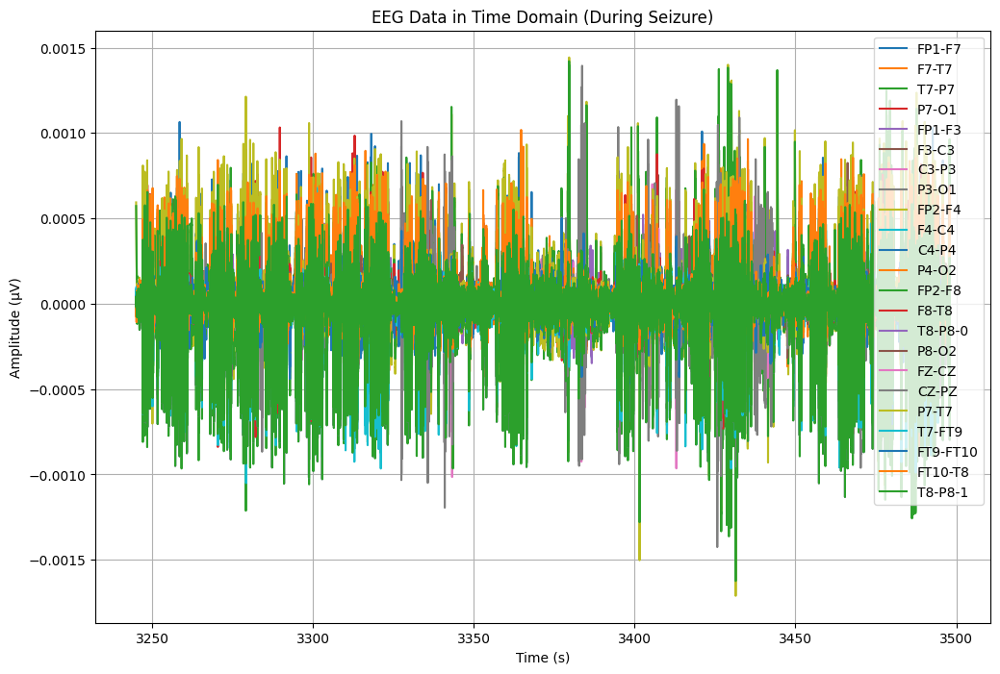

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA20['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA20.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA20[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


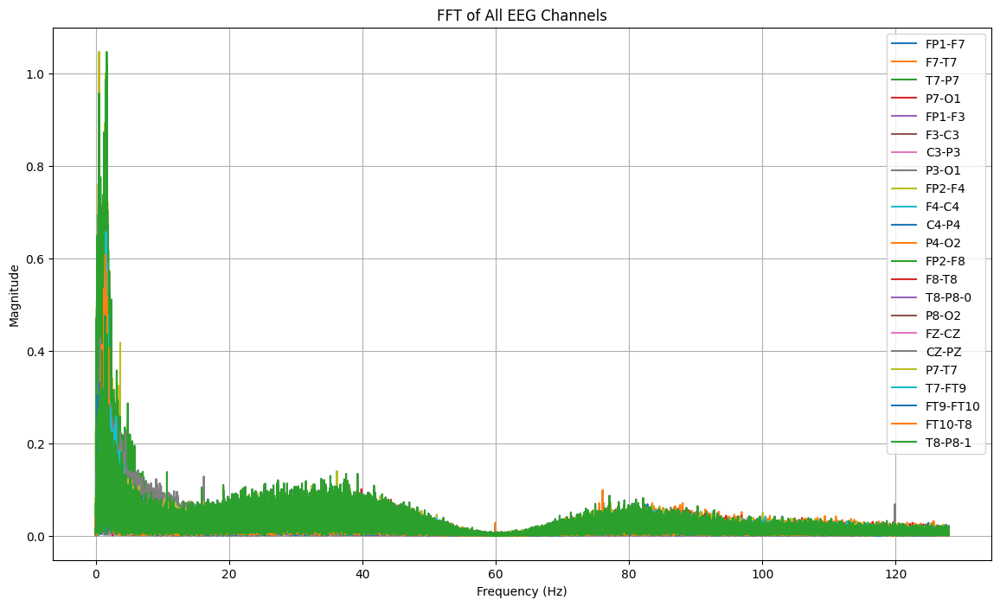

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA20[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 3365:
        return "tidak kejang"
    elif 3365 <= row['Time'] < 3378:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_20 = TA20.copy()
TA_20['seizure'] = TA_20.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_20[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7         T7-P7     P7-O1  \
0  3245.000000  tidak kejang  0.000031 -0.000065  1.035409e-05  0.000023   
1  3245.003906  tidak kejang  0.000031 -0.000059 -4.884005e-06  0.000029   
2  3245.007812  tidak kejang  0.000021 -0.000053  1.953602e-07  0.000025   
3  3245.011719  tidak kejang  0.000026 -0.000046  9.181929e-06  0.000023   
4  3245.015625  tidak kejang  0.000046 -0.000028  6.056166e-06  0.000034   

     FP1-F3         F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0  0.000025 -1.035409e-05 -0.000003 -0.000010  ... -0.000010  0.000033   
1  0.000023 -1.230769e-05 -0.000008 -0.000005  ...  0.000013  0.000011   
2  0.000024 -9.572650e-06 -0.000007 -0.000012  ... -0.000008  0.000033   
3  0.000034  1.953602e-07 -0.000003 -0.000016  ... -0.000006  0.000042   
4  0.000053  1.426129e-05 -0.000002 -0.000005  ...  0.000012  0.000015   

      P8-O2         FZ-CZ     CZ-PZ         P7-T7    T7-FT9  FT9-FT10  \
0 -0.000002  1.035409e-05

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_20['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,3328


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_20)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 253.0 detik


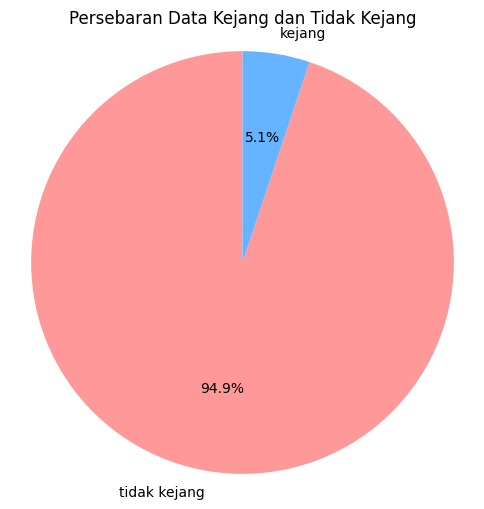

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_20['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_20.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb02_19.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_20.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_20['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       1.00      0.54      0.70       717
tidak kejang       0.97      1.00      0.99     12237

    accuracy                           0.97     12954
   macro avg       0.99      0.77      0.84     12954
weighted avg       0.98      0.97      0.97     12954

Akurasi: 0.9745252431681334
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       1.00      0.54      0.70       717
tidak kejang       0.97      1.00      0.99     12237

    accuracy                           0.97     12954
   macro avg       0.99      0.77      0.84     12954
weighted avg       0.98      0.97      0.97     12954



# DATA 21 (chb02_16+)
akurasi = 0,993

In [ ]:
# mengimport file edf
file21 = "/content/drive/MyDrive/TA/EDF/chb02_16+.edf"
data21 = mne.io.read_raw_edf(file21) # membaca file edf dan menyimpannya di data
data21


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb02_16+.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-271-cafab1f99e65>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data21 = mne.io.read_raw_edf(file21) # membaca file edf dan menyimpannya di data


<RawEDF | chb02_16+.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data21.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data21.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data21.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df21 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df21['Time'] = times  # Menambahkan kolom waktu
df21.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000063,-0.000134,0.000015,-1.830525e-04,-0.000376,4.077167e-04,-2.619780e-04,-8.009768e-06,-6.388278e-05,-1.748474e-04,...,-4.065446e-04,0.000652,-1.365568e-04,-1.099878e-04,-0.000014,0.000215,-2.858120e-04,-0.000307,-4.065446e-04,0.000000
1,0.000002,-0.000001,0.000002,5.860806e-07,0.000003,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,0.000001,1.953602e-07,1.953602e-07,-0.000001,0.000002,1.953602e-07,-0.000001,5.860806e-07,0.003906
2,-0.000009,0.000010,-0.000010,-9.768010e-07,-0.000012,1.758242e-06,-9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-2.148962e-06,-0.000007,5.860806e-07,-1.953602e-07,0.000011,-0.000010,-5.860806e-07,0.000011,-2.148962e-06,0.007812
3,-0.000027,0.000028,-0.000023,-9.963370e-06,-0.000036,1.152625e-05,-5.274725e-06,-2.148962e-06,1.953602e-07,-1.367521e-06,...,-6.837607e-06,-0.000022,5.860806e-07,-1.367521e-06,0.000024,-0.000022,-8.009768e-06,0.000024,-6.837607e-06,0.011719
4,0.000059,-0.000062,0.000068,9.768010e-07,0.000067,-5.860806e-07,3.711844e-06,-4.884005e-06,-2.930403e-06,-1.758242e-06,...,1.152625e-05,0.000057,-7.228327e-06,9.768010e-07,-0.000067,0.000070,1.953602e-07,-0.000077,1.152625e-05,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df21.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df21.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.841316e-07,2.309108e-07,1.428563e-07,5.782581e-07,2.012672e-07,-8.908688e-08,-1.124042e-07,6.079285e-07,2.080777e-07,1.520257e-07,...,6.619480e-08,1.355053e-07,2.355727e-07,1.975249e-07,2.478641e-07,1.512969e-07,1.334003e-07,2.164513e-07,6.619480e-08,1799.998047
std,1.399491e-04,1.383175e-04,1.281117e-04,1.097497e-04,1.353201e-04,1.032285e-04,9.024136e-05,9.806553e-05,7.227180e-05,6.619689e-05,...,6.642087e-05,1.639537e-04,6.132116e-05,6.588496e-05,1.281117e-04,1.519580e-04,1.030040e-04,1.317392e-04,6.642087e-05,1039.231048
min,-2.189011e-03,-2.466422e-03,-2.312479e-03,-2.390232e-03,-2.412112e-03,-2.418755e-03,-2.380855e-03,-2.528547e-03,-1.777582e-03,-1.795946e-03,...,-2.024518e-03,-2.770794e-03,-1.752186e-03,-1.818608e-03,-2.299194e-03,-2.416801e-03,-2.333968e-03,-2.661001e-03,-2.024518e-03,0.000000
25%,-6.036630e-05,-5.880342e-05,-5.763126e-05,-6.349206e-05,-5.802198e-05,-4.669109e-05,-2.793651e-05,-3.731380e-05,-3.184371e-05,-2.754579e-05,...,-2.754579e-05,-6.974359e-05,-3.145299e-05,-2.871795e-05,-6.153846e-05,-6.427350e-05,-4.278388e-05,-6.818071e-05,-2.754579e-05,899.999023
50%,-1.367521e-06,-1.953602e-07,1.758242e-06,-5.860806e-07,-2.148962e-06,1.953602e-07,9.768010e-07,-2.148962e-06,-5.860806e-07,1.953602e-07,...,9.768010e-07,9.768010e-07,1.953602e-07,1.953602e-07,-1.367521e-06,1.953602e-07,5.860806e-07,1.367521e-06,9.768010e-07,1799.998047
75%,5.997558e-05,5.684982e-05,6.192918e-05,5.684982e-05,5.528694e-05,4.747253e-05,2.989011e-05,3.340659e-05,3.028083e-05,2.871795e-05,...,2.949939e-05,6.857143e-05,3.223443e-05,2.910867e-05,5.802198e-05,6.349206e-05,4.434676e-05,7.130647e-05,2.949939e-05,2699.997070
max,2.533236e-03,2.299585e-03,2.299585e-03,2.001856e-03,2.355067e-03,2.421099e-03,2.457827e-03,2.100317e-03,1.827595e-03,1.962784e-03,...,1.752967e-03,2.992723e-03,1.946764e-03,1.517753e-03,2.312869e-03,2.381636e-03,2.575824e-03,2.530501e-03,1.752967e-03,3599.996094


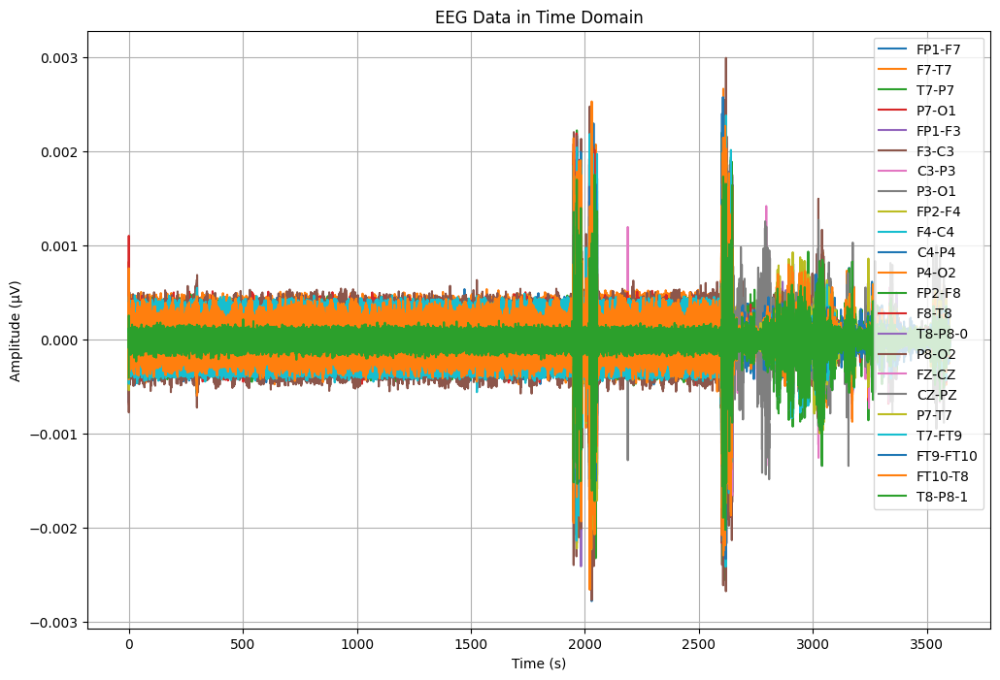

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df21['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df21[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


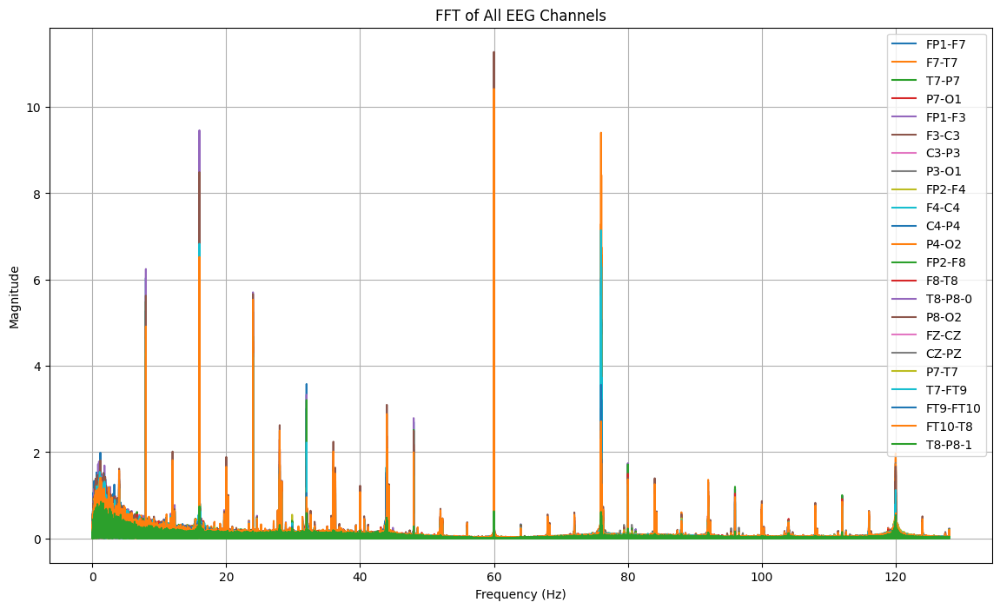

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df21[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_16+.csv"
df21.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_16+.csv


In [ ]:
#Import Data CSV
dataTA21 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_16+.csv")
dataTA21


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000063,-0.000134,0.000015,-1.830525e-04,-0.000376,4.077167e-04,-2.619780e-04,-8.009768e-06,-6.388278e-05,-1.748474e-04,...,-4.065446e-04,6.515263e-04,-1.365568e-04,-1.099878e-04,-0.000014,2.150916e-04,-2.858120e-04,-0.000307,-4.065446e-04,0.000000
1,0.000002,-0.000001,0.000002,5.860806e-07,0.000003,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.367521e-06,1.953602e-07,1.953602e-07,-0.000001,1.758242e-06,1.953602e-07,-0.000001,5.860806e-07,0.003906
2,-0.000009,0.000010,-0.000010,-9.768010e-07,-0.000012,1.758242e-06,-9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-2.148962e-06,-7.228327e-06,5.860806e-07,-1.953602e-07,0.000011,-1.035409e-05,-5.860806e-07,0.000011,-2.148962e-06,0.007812
3,-0.000027,0.000028,-0.000023,-9.963370e-06,-0.000036,1.152625e-05,-5.274725e-06,-2.148962e-06,1.953602e-07,-1.367521e-06,...,-6.837607e-06,-2.168498e-05,5.860806e-07,-1.367521e-06,0.000024,-2.168498e-05,-8.009768e-06,0.000024,-6.837607e-06,0.011719
4,0.000059,-0.000062,0.000068,9.768010e-07,0.000067,-5.860806e-07,3.711844e-06,-4.884005e-06,-2.930403e-06,-1.758242e-06,...,1.152625e-05,5.724054e-05,-7.228327e-06,9.768010e-07,-0.000067,7.013431e-05,1.953602e-07,-0.000077,1.152625e-05,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-0.000001,-0.000013,0.000003,4.102564e-06,-0.000028,2.285714e-05,2.129426e-05,-2.442002e-05,-8.009768e-06,2.168498e-05,...,-4.884005e-06,2.148962e-06,2.989011e-05,4.493284e-06,-0.000003,7.228327e-06,1.894994e-05,0.000013,-4.884005e-06,3599.980469
921596,-0.000009,0.000042,-0.000031,-6.837607e-06,-0.000021,3.418803e-05,1.582418e-05,-3.575092e-05,-5.274725e-06,2.090354e-05,...,-3.711844e-06,-1.367521e-06,2.949939e-05,1.367521e-06,0.000032,-5.059829e-05,3.653236e-05,0.000013,-3.711844e-06,3599.984375
921597,-0.000010,-0.000009,0.000030,-9.572650e-06,-0.000025,4.512821e-05,1.152625e-05,-3.145299e-05,-6.056166e-06,2.090354e-05,...,-1.582418e-05,9.768010e-07,3.223443e-05,-5.860806e-07,-0.000029,2.207570e-05,2.363858e-05,0.000015,-1.582418e-05,3599.988281
921598,-0.000007,-0.000021,0.000031,-8.009768e-06,-0.000029,4.864469e-05,6.446886e-06,-3.028083e-05,-4.493284e-06,1.934066e-05,...,-1.816850e-05,-3.321123e-06,3.184371e-05,2.539683e-06,-0.000031,3.145299e-05,2.715507e-05,0.000013,-1.816850e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA21[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA21[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA21[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, dataTA21, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: P8-O2, Max Frequency: 59.99 Hz, Magnitude: 11.278090, Time: 2619.132812 s
Channel: FT10-T8, Max Frequency: 59.99 Hz, Magnitude: 10.422252, Time: 2021.601562 s
Channel: F8-T8, Max Frequency: 59.99 Hz, Magnitude: 10.057232, Time: 2028.800781 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 9.461570, Time: 1983.156250 s
Channel: P4-O2, Max Frequency: 75.99 Hz, Magnitude: 9.406121, Time: 2607.312500 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 9.074247, Time: 2614.316406 s
Channel: FP2-F8, Max Frequency: 16.00 Hz, Magnitude: 8.261306, Time: 2609.707031 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 8.153494, Time: 2030.125000 s
Channel: F7-T7, Max Frequency: 59.99 Hz, Magnitude: 8.124088, Time: 2614.320312 s
Channel: T7-FT9, Max Frequency: 59.99 Hz, Magnitude: 7.585212, Time: 2617.886719 s
Channel: P7-T7, Max Frequency: 59.99 Hz, Magnitude: 6.707974, Time: 2606.554688 s
Channel: T

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP2-F4, Max Frequency: 16.00 Hz, Magnitude: 1.220192, Time: 1950.765625 s
Channel: FZ-CZ, Max Frequency: 59.99 Hz, Magnitude: 1.578107, Time: 1964.914062 s
Channel: CZ-PZ, Max Frequency: 0.83 Hz, Magnitude: 0.968105, Time: 1964.914062 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 9.461570, Time: 1983.156250 s
Channel: FT10-T8, Max Frequency: 59.99 Hz, Magnitude: 10.422252, Time: 2021.601562 s
Channel: F8-T8, Max Frequency: 59.99 Hz, Magnitude: 10.057232, Time: 2028.800781 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 8.153494, Time: 2030.125000 s
Channel: FT9-FT10, Max Frequency: 75.98 Hz, Magnitude: 3.561822, Time: 2605.730469 s
Channel: T7-P7, Max Frequency: 59.99 Hz, Magnitude: 6.707974, Time: 2606.554688 s
Channel: P7-T7, Max Frequency: 59.99 Hz, Magnitude: 6.707974, Time: 2606.554688 s
Channel: F4-C4, Max Frequency: 1.39 Hz, Magnitude: 0.944927, Ti

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2485   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2739    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut21 = dataTA21.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut21.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb02_16+.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA21 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb02_16+.csv")
TA21.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000061,0.000127,-0.000160,0.000071,0.000035,-0.000085,0.000022,0.000004,0.000027,-0.000109,...,-0.000070,0.000090,-0.000053,-1.934066e-05,0.000161,-0.000139,0.000050,-0.000007,-0.000070,2485.000000
1,0.000109,-0.000133,0.000137,-0.000018,0.000121,0.000043,-0.000040,-0.000030,-0.000002,-0.000066,...,-0.000039,0.000047,0.000044,-1.367521e-06,-0.000137,0.000254,-0.000124,-0.000077,-0.000039,2485.003906
2,-0.000181,0.000160,-0.000029,-0.000135,-0.000131,0.000071,-0.000034,-0.000090,-0.000001,-0.000064,...,-0.000044,-0.000158,0.000088,-9.768010e-07,0.000029,-0.000039,-0.000059,0.000171,-0.000044,2485.007812
3,-0.000327,0.000394,-0.000391,0.000108,-0.000205,-0.000117,0.000047,0.000056,0.000032,-0.000063,...,-0.000016,-0.000126,0.000046,-2.715507e-05,0.000392,-0.000433,0.000088,0.000238,-0.000016,2485.011719
4,-0.000068,0.000098,-0.000143,0.000135,-0.000030,-0.000037,-0.000005,0.000094,0.000053,-0.000101,...,-0.000035,0.000049,0.000092,-3.340659e-05,0.000143,-0.000158,0.000052,0.000091,-0.000035,2485.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA21.shape

(65024, 24)

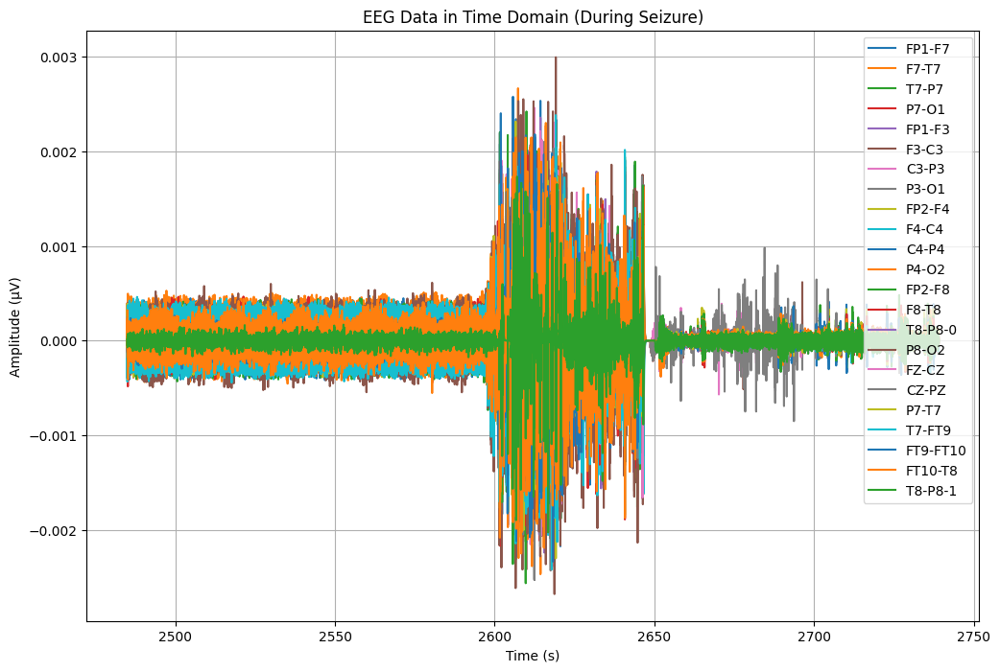

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA21['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA21.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA21[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


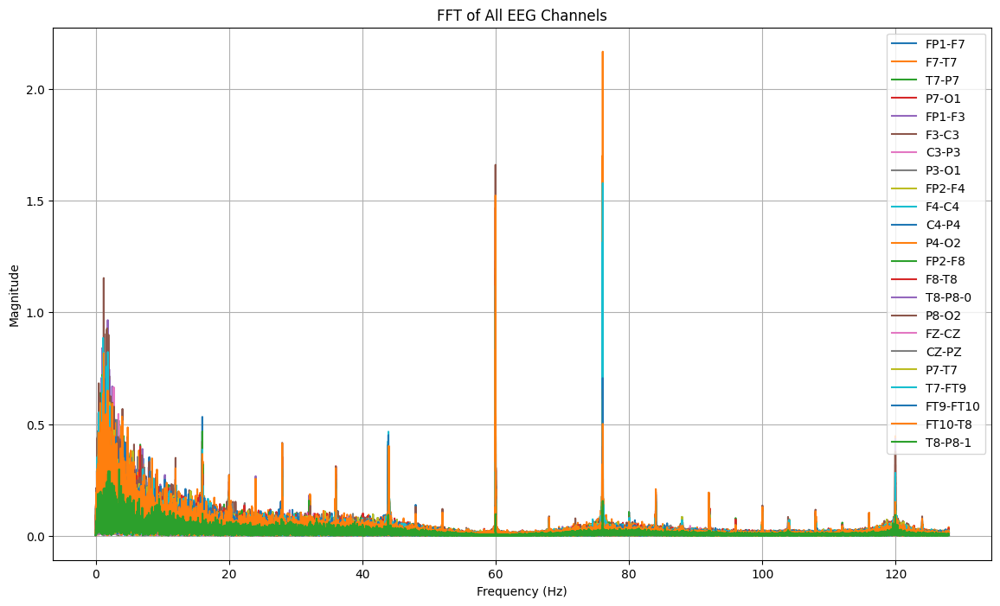

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA21[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2605:
        return "tidak kejang"
    elif 2605 <= row['Time'] < 2619:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_21 = TA21.copy()
TA_21['seizure'] = TA_21.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_21[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2485.000000  tidak kejang -0.000061  0.000127 -0.000160  0.000071   
1  2485.003906  tidak kejang  0.000109 -0.000133  0.000137 -0.000018   
2  2485.007812  tidak kejang -0.000181  0.000160 -0.000029 -0.000135   
3  2485.011719  tidak kejang -0.000327  0.000394 -0.000391  0.000108   
4  2485.015625  tidak kejang -0.000068  0.000098 -0.000143  0.000135   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000035 -0.000085  0.000022  0.000004  ...  0.000050 -0.000070  0.000090   
1  0.000121  0.000043 -0.000040 -0.000030  ... -0.000142 -0.000039  0.000047   
2 -0.000131  0.000071 -0.000034 -0.000090  ...  0.000082 -0.000044 -0.000158   
3 -0.000205 -0.000117  0.000047  0.000056  ...  0.000313 -0.000016 -0.000126   
4 -0.000030 -0.000037 -0.000005  0.000094  ...  0.000114 -0.000035  0.000049   

      FZ-CZ         CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0 -0.000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_21['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,3584


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_21)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 254.0 detik


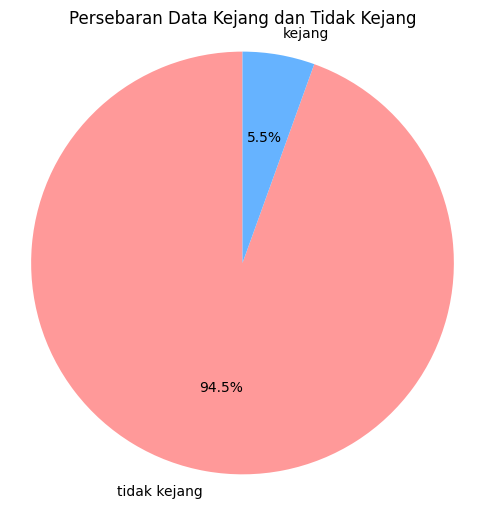

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_21['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_21.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb02_16+.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_21.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_21['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.92      0.94       733
tidak kejang       1.00      1.00      1.00     12272

    accuracy                           0.99     13005
   macro avg       0.98      0.96      0.97     13005
weighted avg       0.99      0.99      0.99     13005

Akurasi: 0.9932333717800845
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.92      0.94       733
tidak kejang       1.00      1.00      1.00     12272

    accuracy                           0.99     13005
   macro avg       0.98      0.96      0.97     13005
weighted avg       0.99      0.99      0.99     13005



# DATA 22 (chb03_01) visualisainya kecil, gausah dipake

In [ ]:
# mengimport file edf
file22 = "/content/drive/MyDrive/TA/EDF/chb03_01.edf"
data22 = mne.io.read_raw_edf(file22) # membaca file edf dan menyimpannya di data
data22


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-295-3a8085e769bc>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data22 = mne.io.read_raw_edf(file22) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_01.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data22.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data22.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data22.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df22 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df22['Time'] = times  # Menambahkan kolom waktu
df22.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,4.200244e-05,1.934066e-05,6.056166e-06,-1.426129e-05,3.106227e-05,-1.699634e-05,3.340659e-05,5.665446e-06,1.953602e-07,-4.864469e-05,...,2.148962e-06,-6.056166e-06,-2.324786e-05,2.676435e-05,-5.665446e-06,-5.665446e-06,-1.035409e-05,-1.308913e-05,2.148962e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df22.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df22.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.509849e-07,2.478734e-07,1.343110e-07,2.072382e-07,2.727691e-07,2.164585e-07,1.975550e-07,2.035837e-07,2.776553e-07,2.244883e-07,...,1.427991e-07,2.124300e-07,2.427876e-07,1.950808e-07,2.564094e-07,1.596531e-07,1.987760e-07,2.332341e-07,1.427991e-07,1799.998047
std,8.803233e-05,7.081758e-05,3.241781e-05,2.348533e-05,7.974790e-05,3.606677e-05,2.720907e-05,2.104380e-05,7.619692e-05,3.188271e-05,...,2.981836e-05,1.872055e-05,2.825703e-05,2.004083e-05,3.241781e-05,3.297355e-05,5.890299e-05,3.235178e-05,2.981836e-05,1039.231048
min,-2.330061e-03,-1.617778e-03,-1.525177e-03,-1.887375e-03,-2.640293e-03,-1.706471e-03,-2.437509e-03,-1.749060e-03,-8.097680e-04,-1.647473e-03,...,-9.551160e-04,-1.383346e-03,-1.514628e-03,-7.210745e-04,-1.356777e-03,-1.643565e-03,-1.829939e-03,-1.559170e-03,-9.551160e-04,0.000000
25%,-1.973138e-05,-1.973138e-05,-9.963370e-06,-7.619048e-06,-2.090354e-05,-1.074481e-05,-6.446886e-06,-5.665446e-06,-1.973138e-05,-9.181929e-06,...,-9.572650e-06,-6.837607e-06,-9.572650e-06,-7.228327e-06,-1.113553e-05,-9.963370e-06,-1.543346e-05,-9.572650e-06,-9.572650e-06,899.999023
50%,-5.860806e-07,-5.860806e-07,1.953602e-07,1.953602e-07,-9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.738706e-05,1.777778e-05,1.152625e-05,8.009768e-06,1.621490e-05,1.035409e-05,6.837607e-06,6.056166e-06,1.543346e-05,8.791209e-06,...,1.074481e-05,7.228327e-06,8.791209e-06,7.619048e-06,1.035409e-05,1.113553e-05,1.582418e-05,9.181929e-06,1.074481e-05,2699.997070
max,1.563858e-03,1.826813e-03,1.357167e-03,1.954188e-03,1.563858e-03,2.786813e-03,1.627546e-03,1.907692e-03,1.415775e-03,2.517998e-03,...,1.480635e-03,1.660366e-03,1.101636e-03,1.391160e-03,1.525568e-03,1.628718e-03,1.726789e-03,1.695140e-03,1.480635e-03,3599.996094


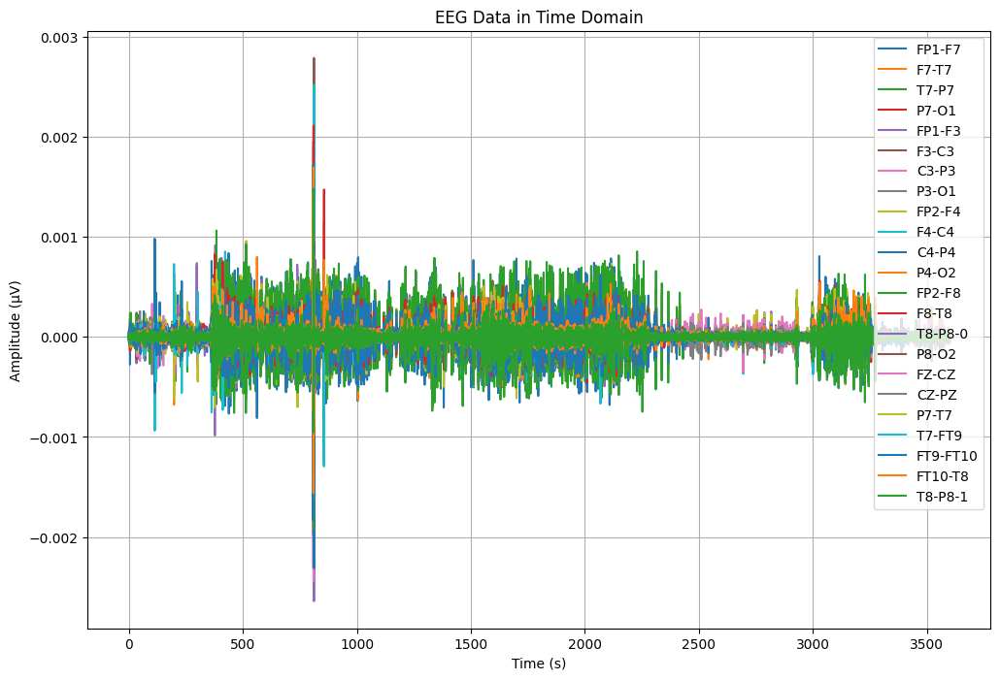

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df22['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df22[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


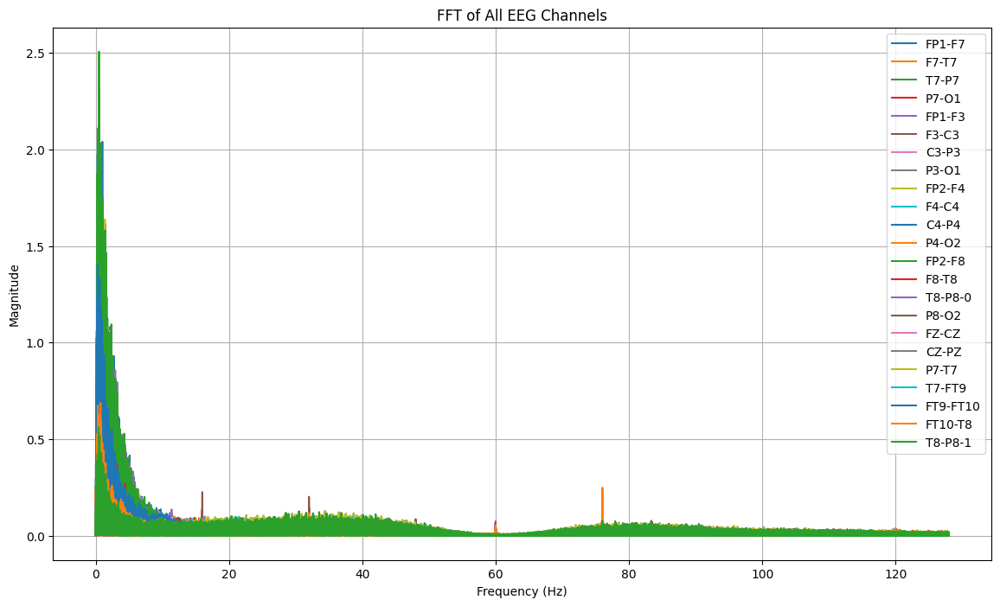

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df22[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_01.csv"
df22.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_01.csv


In [ ]:
#Import Data CSV
dataTA22 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_01.csv")
dataTA22


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,4.200244e-05,1.934066e-05,6.056166e-06,-1.426129e-05,3.106227e-05,-1.699634e-05,3.340659e-05,5.665446e-06,1.953602e-07,-4.864469e-05,...,2.148962e-06,-6.056166e-06,-2.324786e-05,2.676435e-05,-5.665446e-06,-5.665446e-06,-1.035409e-05,-1.308913e-05,2.148962e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,2.051282e-05,-1.308913e-05,-2.442002e-05,-1.191697e-05,1.308913e-05,-1.113553e-05,-1.621490e-05,-1.465201e-05,-1.426129e-05,1.308913e-05,...,1.953602e-07,2.539683e-06,5.665446e-06,-3.321123e-06,2.481074e-05,-4.884005e-06,-2.520147e-05,-2.539683e-06,1.953602e-07,3599.980469
921596,1.816850e-05,-9.181929e-06,-2.481074e-05,-1.269841e-05,9.963370e-06,-1.269841e-05,-1.191697e-05,-1.426129e-05,-8.400488e-06,8.400488e-06,...,-5.860806e-07,6.056166e-06,2.930403e-06,-1.758242e-06,2.520147e-05,-1.035409e-05,-3.067155e-05,-1.953602e-07,-5.860806e-07,3599.984375
921597,1.582418e-05,-2.148962e-06,-3.028083e-05,-1.230769e-05,8.009768e-06,-1.152625e-05,-4.884005e-06,-2.051282e-05,5.860806e-07,3.321123e-06,...,1.953602e-07,4.493284e-06,1.953602e-07,-1.758242e-06,3.067155e-05,-1.504274e-05,-3.536020e-05,2.930403e-06,1.953602e-07,3599.988281
921598,1.582418e-05,1.758242e-06,-2.676435e-05,-1.582418e-05,4.493284e-06,-6.446886e-06,-2.930403e-06,-1.973138e-05,3.711844e-06,1.367521e-06,...,2.148962e-06,4.884005e-06,-9.768010e-07,-1.758242e-06,2.715507e-05,-1.191697e-05,-3.536020e-05,-3.711844e-06,2.148962e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA22[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA22[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA22[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data22, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP2-F8, Max Frequency: 0.49 Hz, Magnitude: 2.506845, Time: 810.093750 s
Channel: FP1-F7, Max Frequency: 0.52 Hz, Magnitude: 2.309519, Time: 812.093750 s
Channel: FP2-F4, Max Frequency: 0.49 Hz, Magnitude: 1.987210, Time: 809.734375 s
Channel: FP1-F3, Max Frequency: 0.49 Hz, Magnitude: 1.825145, Time: 812.097656 s
Channel: F7-T7, Max Frequency: 0.74 Hz, Magnitude: 1.561799, Time: 810.375000 s
Channel: FT9-FT10, Max Frequency: 0.29 Hz, Magnitude: 1.403873, Time: 807.164062 s
Channel: F8-T8, Max Frequency: 0.57 Hz, Magnitude: 1.272776, Time: 810.093750 s
Channel: F3-C3, Max Frequency: 1.00 Hz, Magnitude: 0.711357, Time: 812.101562 s
Channel: T7-FT9, Max Frequency: 0.73 Hz, Magnitude: 0.702479, Time: 810.078125 s
Channel: FT10-T8, Max Frequency: 0.72 Hz, Magnitude: 0.687750, Time: 810.105469 s
Channel: F4-C4, Max Frequency: 1.00 Hz, Magnitude: 0.642365, Time: 812.105469 s
Channel: FZ-CZ, Max Frequency: 

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT9-FT10, Max Frequency: 0.29 Hz, Magnitude: 1.403873, Time: 807.164062 s
Channel: FZ-CZ, Max Frequency: 1.00 Hz, Magnitude: 0.582803, Time: 809.718750 s
Channel: T8-P8-0, Max Frequency: 0.45 Hz, Magnitude: 0.560924, Time: 809.730469 s
Channel: T8-P8-1, Max Frequency: 0.45 Hz, Magnitude: 0.560924, Time: 809.730469 s
Channel: FP2-F4, Max Frequency: 0.49 Hz, Magnitude: 1.987210, Time: 809.734375 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 0.225984, Time: 809.765625 s
Channel: P7-O1, Max Frequency: 0.73 Hz, Magnitude: 0.372440, Time: 809.792969 s
Channel: P4-O2, Max Frequency: 0.47 Hz, Magnitude: 0.241514, Time: 809.792969 s
Channel: T7-P7, Max Frequency: 0.73 Hz, Magnitude: 0.519310, Time: 810.058594 s
Channel: P7-T7, Max Frequency: 0.73 Hz, Magnitude: 0.519310, Time: 810.058594 s
Channel: CZ-PZ, Max Frequency: 1.08 Hz, Magnitude: 0.321159, Time: 810.066406 s
Ch

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 242   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 534    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut22 = dataTA22.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut22.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_01.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA22 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_01.csv")
TA22.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000015,1.953602e-07,0.000006,-1.367521e-06,-5.860806e-07,-0.000013,-0.000003,0.000008,-0.000004,-2.539683e-06,...,-0.000019,0.000032,-0.000013,0.000008,-0.000006,-5.274725e-06,6.056166e-06,0.000013,-0.000019,242.000000
1,-0.000009,-1.777778e-05,0.000035,-4.102564e-06,5.860806e-07,-0.000008,0.000003,0.000007,-0.000002,1.758242e-06,...,-0.000004,0.000030,-0.000011,0.000013,-0.000035,6.446886e-06,1.230769e-05,0.000004,-0.000004,242.003906
2,-0.000007,-7.619048e-06,0.000024,-1.953602e-07,9.768010e-07,-0.000008,0.000007,0.000009,-0.000004,5.860806e-07,...,-0.000004,0.000031,-0.000011,0.000016,-0.000024,1.953602e-07,-1.953602e-07,0.000009,-0.000004,242.007812
3,-0.000007,-3.321123e-06,0.000010,1.035409e-05,-1.758242e-06,-0.000010,0.000009,0.000011,-0.000008,1.953602e-07,...,0.000014,0.000029,-0.000011,0.000015,-0.000010,5.274725e-06,-1.230769e-05,-0.000014,0.000014,242.011719
4,-0.000004,-7.228327e-06,0.000013,8.009768e-06,-2.148962e-06,-0.000010,0.000011,0.000009,-0.000010,9.768010e-07,...,0.000021,0.000019,-0.000010,0.000014,-0.000012,1.426129e-05,-1.582418e-05,-0.000029,0.000021,242.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA22.shape

(74752, 24)

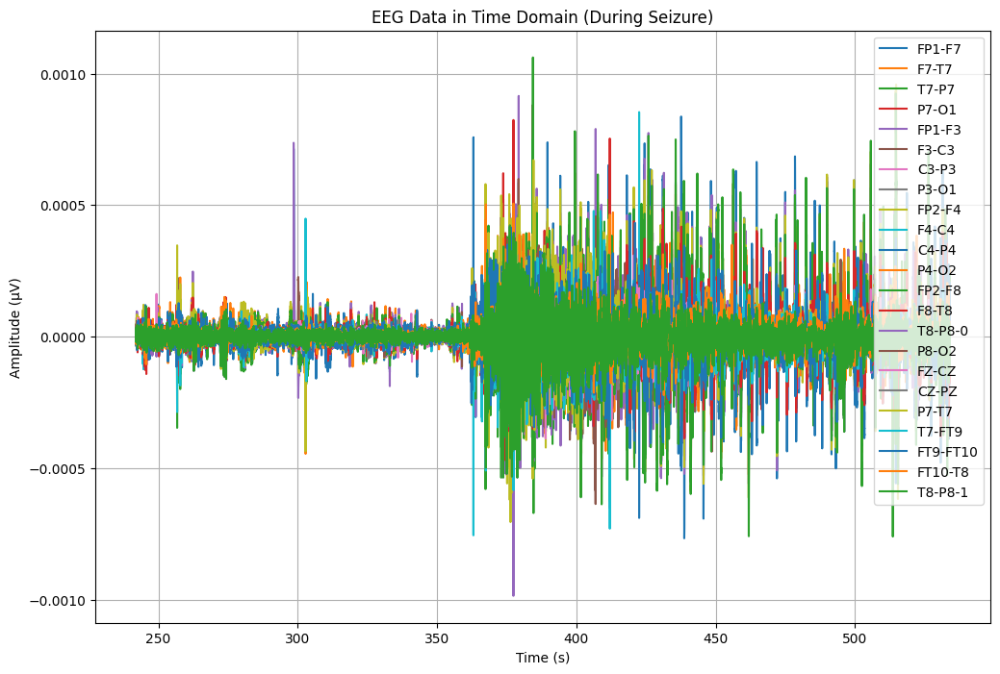

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA22['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA22.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA22[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


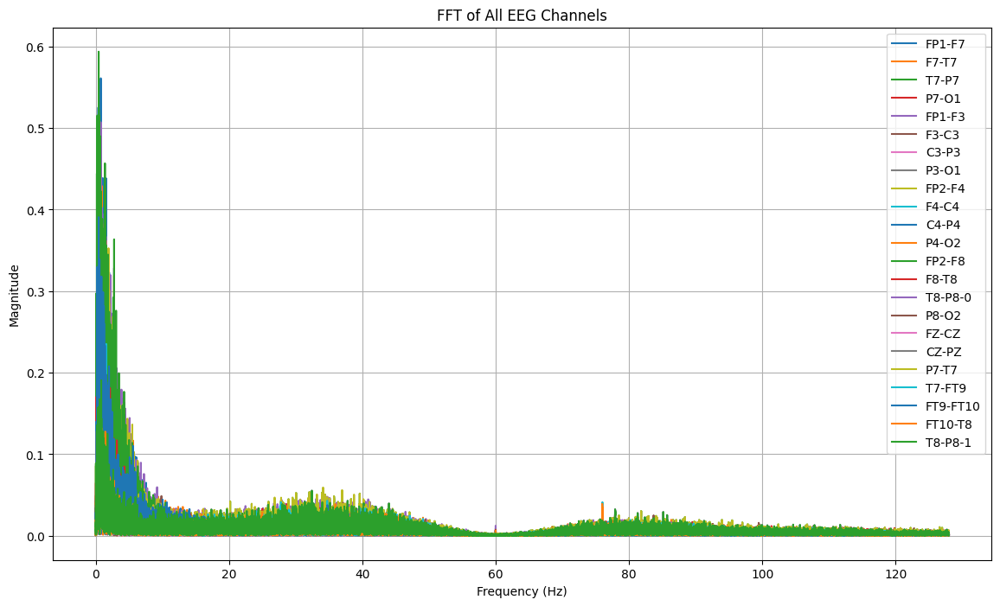

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA22[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 362:
        return "tidak kejang"
    elif 362 <= row['Time'] < 414:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_22 = TA22.copy()
TA_22['seizure'] = TA_22.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_22[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7         F7-T7     T7-P7         P7-O1  \
0  242.000000  tidak kejang -0.000015  1.953602e-07  0.000006 -1.367521e-06   
1  242.003906  tidak kejang -0.000009 -1.777778e-05  0.000035 -4.102564e-06   
2  242.007812  tidak kejang -0.000007 -7.619048e-06  0.000024 -1.953602e-07   
3  242.011719  tidak kejang -0.000007 -3.321123e-06  0.000010  1.035409e-05   
4  242.015625  tidak kejang -0.000004 -7.228327e-06  0.000013  8.009768e-06   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...         F8-T8   T8-P8-0  \
0 -5.860806e-07 -0.000013 -0.000003  0.000008  ...  7.228327e-06 -0.000019   
1  5.860806e-07 -0.000008  0.000003  0.000007  ...  2.148962e-06 -0.000004   
2  9.768010e-07 -0.000008  0.000007  0.000009  ...  9.768010e-07 -0.000004   
3 -1.758242e-06 -0.000010  0.000009  0.000011  ... -2.051282e-05  0.000014   
4 -2.148962e-06 -0.000010  0.000011  0.000009  ... -2.871795e-05  0.000021   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7        T7-FT9 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_22['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,13312


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_22)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 292.0 detik


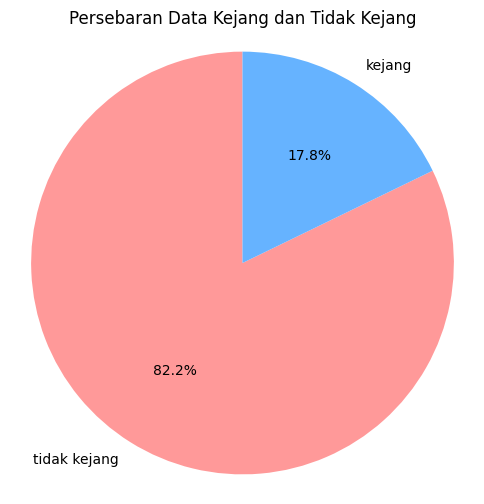

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_22['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_22.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_01.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_22.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_22['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.95      0.90      0.92      2717
tidak kejang       0.98      0.99      0.98     12234

    accuracy                           0.97     14951
   macro avg       0.96      0.94      0.95     14951
weighted avg       0.97      0.97      0.97     14951

Akurasi: 0.9734465922011906
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.95      0.90      0.92      2717
tidak kejang       0.98      0.99      0.98     12234

    accuracy                           0.97     14951
   macro avg       0.96      0.94      0.95     14951
weighted avg       0.97      0.97      0.97     14951



# DATA 24 (chb03_03) udah dicoba dan akurasinya jelek jadi gausah diambil

In [ ]:
# mengimport file edf
file24 = "/content/drive/MyDrive/TA/EDF/chb03_03.edf"
data24 = mne.io.read_raw_edf(file24) # membaca file edf dan menyimpannya di data
data24


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-343-b36d0199dac4>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data24 = mne.io.read_raw_edf(file24) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_03.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data24.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data24.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data24.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df24 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df24['Time'] = times  # Menambahkan kolom waktu
df24.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.880342e-05,1.855922e-05,4.122100e-05,-1.953602e-07,-2.207570e-05,-1.934066e-05,3.731380e-05,4.884005e-06,-4.590965e-05,7.619048e-06,...,3.340659e-05,1.973138e-05,-2.246642e-05,2.989011e-05,-4.083028e-05,-4.102564e-06,-2.207570e-05,1.582418e-05,3.340659e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,0.011719
4,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,-5.860806e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df24.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df24.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.475109e-07,3.398008e-07,1.737595e-08,1.833851e-07,2.831311e-07,1.602229e-07,1.418948e-07,1.787927e-07,2.987536e-07,1.924832e-07,...,1.275014e-08,1.520740e-07,2.194050e-07,1.721099e-07,3.733444e-07,8.866080e-08,1.981719e-07,3.036219e-07,1.275014e-08,1799.998047
std,8.546639e-05,7.848231e-05,7.886638e-05,2.849821e-05,8.204562e-05,3.608752e-05,3.771188e-05,2.569033e-05,8.050491e-05,2.844311e-05,...,8.162632e-05,2.560236e-05,2.330957e-05,1.724482e-05,7.886638e-05,7.790976e-05,6.089271e-05,9.905901e-05,8.162632e-05,1039.231048
min,-7.843712e-04,-7.992186e-04,-1.370842e-03,-5.335287e-04,-8.285226e-04,-8.785348e-04,-6.780952e-04,-4.350672e-04,-8.515751e-04,-6.464469e-04,...,-1.363028e-03,-7.769475e-04,-3.178510e-04,-2.865934e-04,-8.711111e-04,-1.202442e-03,-7.636630e-04,-4.917216e-04,-1.363028e-03,0.000000
25%,-2.324786e-05,-2.481074e-05,-1.035409e-05,-6.446886e-06,-2.676435e-05,-1.191697e-05,-5.274725e-06,-4.884005e-06,-2.481074e-05,-9.572650e-06,...,-9.963370e-06,-6.446886e-06,-8.400488e-06,-6.446886e-06,-1.582418e-05,-1.269841e-05,-1.426129e-05,-1.465201e-05,-9.963370e-06,899.999023
50%,-5.860806e-07,-2.148962e-06,1.758242e-06,1.953602e-07,-2.148962e-06,1.953602e-07,5.860806e-07,1.953602e-07,-2.148962e-06,1.953602e-07,...,1.758242e-06,5.860806e-07,1.953602e-07,1.953602e-07,-1.367521e-06,9.768010e-07,1.953602e-07,-5.860806e-07,1.758242e-06,1799.998047
75%,1.934066e-05,1.738706e-05,1.621490e-05,7.619048e-06,1.934066e-05,1.230769e-05,7.228327e-06,5.665446e-06,1.660562e-05,9.572650e-06,...,1.582418e-05,7.619048e-06,8.009768e-06,7.619048e-06,1.074481e-05,1.621490e-05,1.465201e-05,1.152625e-05,1.582418e-05,2699.997070
max,1.065690e-03,1.142662e-03,8.715018e-04,8.851770e-04,8.695482e-04,4.928938e-04,8.250061e-04,8.324298e-04,7.589744e-04,4.475702e-04,...,1.028571e-03,9.082295e-04,2.307204e-04,1.893040e-04,1.371233e-03,5.081319e-04,7.394383e-04,1.352088e-03,1.028571e-03,3599.996094


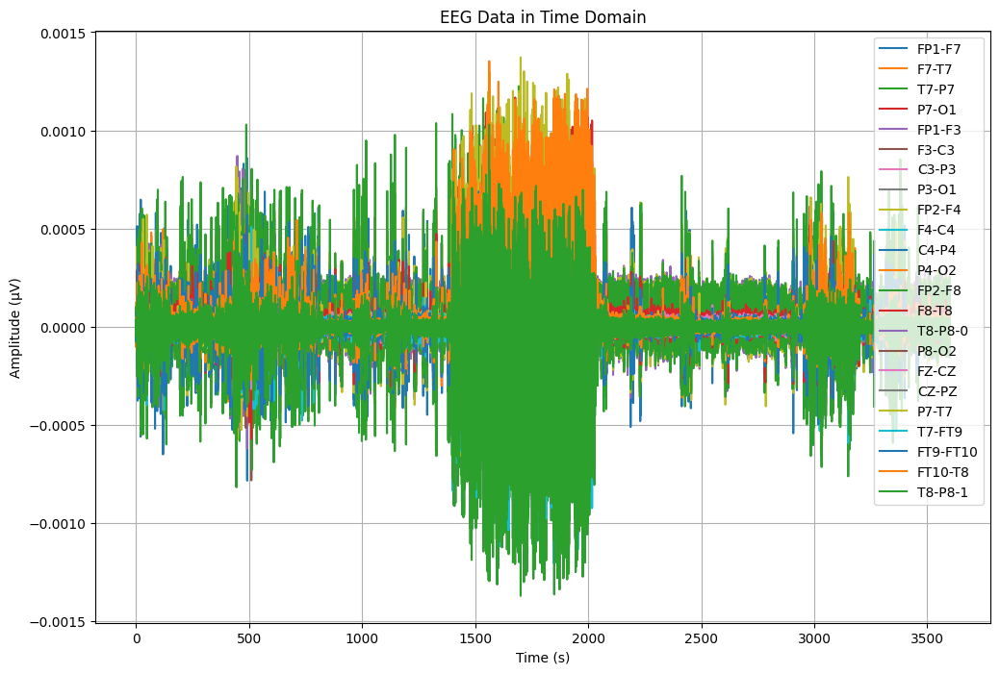

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df24['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df24[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


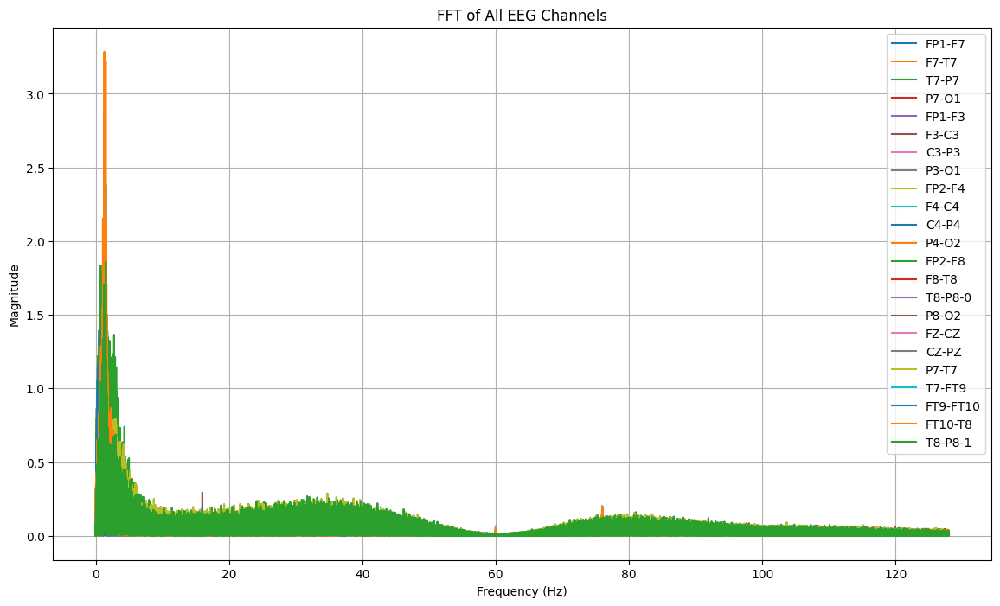

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df24[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_03.csv"
df24.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_03.csv


In [ ]:
#Import Data CSV
dataTA24 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_03.csv")
dataTA24


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.880342e-05,1.855922e-05,4.122100e-05,-1.953602e-07,-2.207570e-05,-1.934066e-05,3.731380e-05,4.884005e-06,-4.590965e-05,7.619048e-06,...,3.340659e-05,1.973138e-05,-2.246642e-05,2.989011e-05,-4.083028e-05,-4.102564e-06,-2.207570e-05,1.582418e-05,3.340659e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,0.011719
4,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,-5.860806e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-2.363858e-05,1.367521e-06,1.953602e-07,6.837607e-06,-1.855922e-05,2.539683e-06,3.711844e-06,-2.148962e-06,-1.113553e-05,1.465201e-05,...,1.465201e-05,3.711844e-06,4.884005e-06,1.953602e-07,1.953602e-07,-1.758242e-06,6.446886e-06,-5.274725e-06,1.465201e-05,3599.980469
921596,-5.860806e-07,-1.699634e-05,1.113553e-05,1.465201e-05,1.367521e-06,2.539683e-06,1.953602e-07,3.321123e-06,-9.181929e-06,1.699634e-05,...,1.660562e-05,1.953602e-07,5.665446e-06,-5.860806e-07,-1.074481e-05,2.090354e-05,5.665446e-06,-9.181929e-06,1.660562e-05,3599.984375
921597,8.400488e-06,-2.676435e-05,1.738706e-05,1.738706e-05,2.285714e-05,-8.400488e-06,-4.102564e-06,7.228327e-06,9.963370e-06,1.738706e-05,...,1.777778e-05,1.367521e-06,7.228327e-06,-1.367521e-06,-1.699634e-05,2.871795e-05,6.056166e-06,-5.274725e-06,1.777778e-05,3599.988281
921598,9.768010e-07,-2.285714e-05,1.230769e-05,1.191697e-05,2.520147e-05,-1.699634e-05,-2.148962e-06,-9.768010e-07,2.285714e-05,8.400488e-06,...,-3.321123e-06,-2.148962e-06,4.493284e-06,-3.321123e-06,-1.191697e-05,2.285714e-05,8.400488e-06,1.347985e-05,-3.321123e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA24[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA24[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA24[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, dataTA24, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT10-T8, Max Frequency: 1.29 Hz, Magnitude: 3.286121, Time: 1562.289062 s
Channel: T7-FT9, Max Frequency: 1.51 Hz, Magnitude: 2.380135, Time: 1846.570312 s
Channel: FP2-F8, Max Frequency: 1.51 Hz, Magnitude: 2.379991, Time: 1692.769531 s
Channel: F8-T8, Max Frequency: 1.29 Hz, Magnitude: 2.118198, Time: 1677.179688 s
Channel: T8-P8-0, Max Frequency: 1.51 Hz, Magnitude: 1.860859, Time: 1850.027344 s
Channel: T8-P8-1, Max Frequency: 1.51 Hz, Magnitude: 1.860859, Time: 1850.027344 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.830261, Time: 1993.679688 s
Channel: FP1-F3, Max Frequency: 1.37 Hz, Magnitude: 1.659769, Time: 447.710938 s
Channel: FP2-F4, Max Frequency: 1.37 Hz, Magnitude: 1.640429, Time: 1442.222656 s
Channel: T7-P7, Max Frequency: 1.51 Hz, Magnitude: 1.566094, Time: 1701.183594 s
Channel: P7-T7, Max Frequency: 1.51 Hz, Magnitude: 1.566094, Time: 1701.183594 s
Channel: FP1-F7, Max 

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP1-F3, Max Frequency: 1.37 Hz, Magnitude: 1.659769, Time: 447.710938 s
Channel: CZ-PZ, Max Frequency: 1.51 Hz, Magnitude: 0.396855, Time: 485.531250 s
Channel: FZ-CZ, Max Frequency: 1.45 Hz, Magnitude: 0.502698, Time: 509.894531 s
Channel: FP2-F4, Max Frequency: 1.37 Hz, Magnitude: 1.640429, Time: 1442.222656 s
Channel: F4-C4, Max Frequency: 1.16 Hz, Magnitude: 0.470995, Time: 1540.367188 s
Channel: FT10-T8, Max Frequency: 1.29 Hz, Magnitude: 3.286121, Time: 1562.289062 s
Channel: P7-O1, Max Frequency: 1.81 Hz, Magnitude: 0.357197, Time: 1614.800781 s
Channel: P3-O1, Max Frequency: 1.51 Hz, Magnitude: 0.395415, Time: 1614.800781 s
Channel: P4-O2, Max Frequency: 1.51 Hz, Magnitude: 0.506197, Time: 1614.800781 s
Channel: P8-O2, Max Frequency: 1.26 Hz, Magnitude: 0.332841, Time: 1614.800781 s
Channel: FT9-FT10, Max Frequency: 0.62 Hz, Magnitude: 1.393132, Time: 1617.71093

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1332   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2113    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut24 = dataTA24.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut24.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb03_03.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA24 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb03_03.csv")
TA24.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000033,0.000004,-0.000011,-0.000008,-0.000054,0.000018,-0.000011,-1.367521e-06,-0.000024,-0.000007,...,-0.000010,-5.665446e-06,-0.000005,-1.074481e-05,0.000011,-0.000022,0.000006,0.000008,-0.000010,1332.000000
1,-0.000031,-0.000006,-0.000003,-0.000009,-0.000052,0.000017,-0.000012,-2.148962e-06,-0.000047,0.000002,...,-0.000022,-7.228327e-06,-0.000004,-6.056166e-06,0.000003,-0.000012,0.000006,0.000028,-0.000022,1332.003906
2,-0.000038,-0.000011,-0.000005,-0.000005,-0.000063,0.000014,-0.000011,1.953602e-07,-0.000053,-0.000008,...,0.000007,1.953602e-07,-0.000011,-2.148962e-06,0.000005,-0.000015,0.000003,0.000001,0.000007,1332.007812
3,-0.000022,0.000004,-0.000009,-0.000009,-0.000044,0.000018,-0.000009,-1.758242e-06,-0.000039,-0.000006,...,0.000019,-2.930403e-06,-0.000008,1.953602e-07,0.000009,-0.000017,0.000002,-0.000011,0.000019,1332.011719
4,0.000002,0.000015,-0.000016,-0.000007,0.000006,-0.000003,-0.000013,1.758242e-06,-0.000036,-0.000009,...,0.000017,-1.953602e-07,-0.000010,9.768010e-07,0.000017,-0.000021,0.000005,-0.000019,0.000017,1332.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA24.shape

(199936, 24)

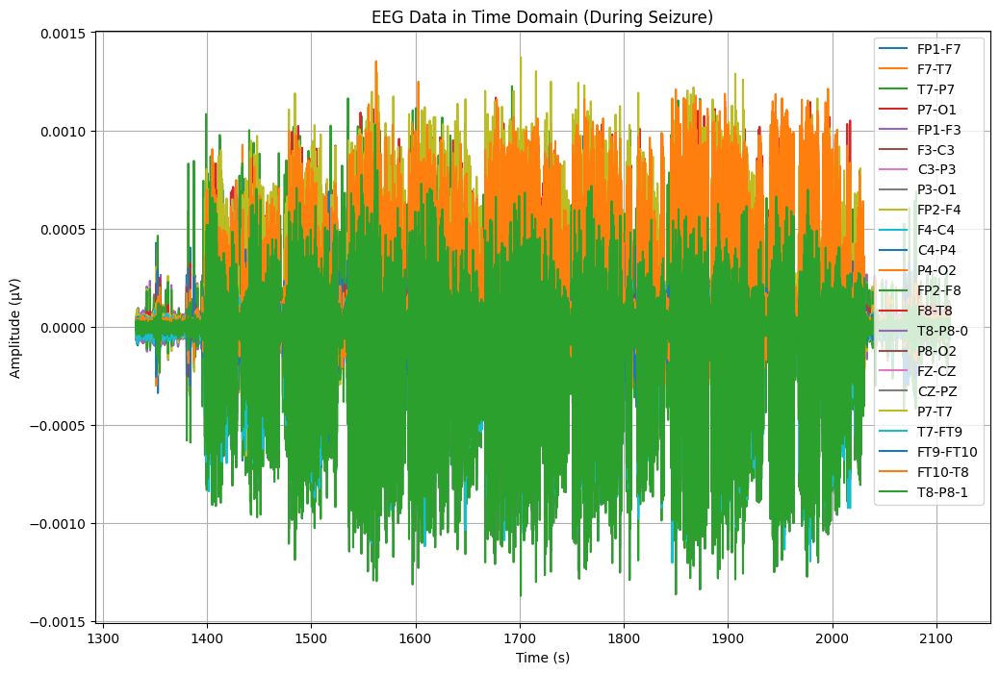

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA24['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA24.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA24[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


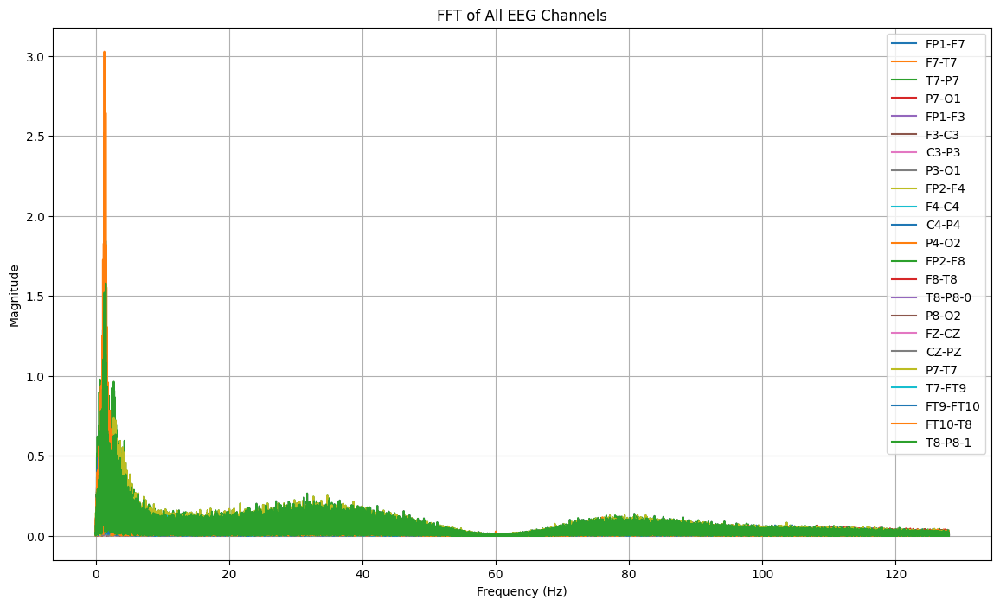

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA24[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1442:
        return "tidak kejang"
    elif 1442 <= row['Time'] < 1993:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_24 = TA24.copy()
TA_24['seizure'] = TA_24.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_24[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1332.000000  tidak kejang -0.000033  0.000004 -0.000011 -0.000008   
1  1332.003906  tidak kejang -0.000031 -0.000006 -0.000003 -0.000009   
2  1332.007812  tidak kejang -0.000038 -0.000011 -0.000005 -0.000005   
3  1332.011719  tidak kejang -0.000022  0.000004 -0.000009 -0.000009   
4  1332.015625  tidak kejang  0.000002  0.000015 -0.000016 -0.000007   

     FP1-F3     F3-C3     C3-P3         P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000054  0.000018 -0.000011 -1.367521e-06  ... -0.000003 -0.000010   
1 -0.000052  0.000017 -0.000012 -2.148962e-06  ...  0.000017 -0.000022   
2 -0.000063  0.000014 -0.000011  1.953602e-07  ... -0.000018  0.000007   
3 -0.000044  0.000018 -0.000009 -1.758242e-06  ... -0.000028  0.000019   
4  0.000006 -0.000003 -0.000013  1.758242e-06  ... -0.000028  0.000017   

          P8-O2     FZ-CZ         CZ-PZ     P7-T7    T7-FT9  FT9-FT10  \
0 -5.665446e-06 -0.000005 -1.074481e-05  0.000011

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_24['seizure'].value_counts()


,count
seizure,
kejang,141056
tidak kejang,58880


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_24)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 781.0 detik


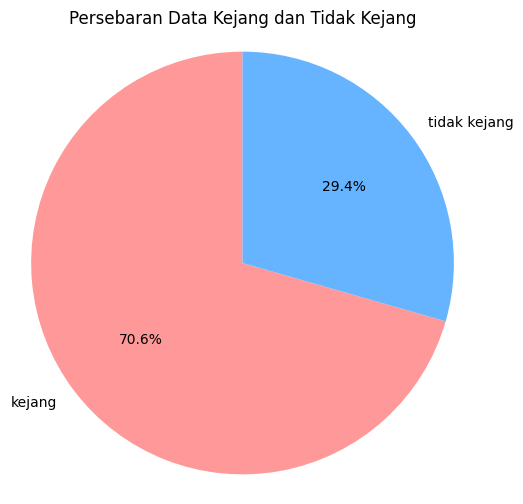

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_24['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_24.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb03_03.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_24.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_24['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.90      0.97      0.93     28341
tidak kejang       0.90      0.73      0.80     11647

    accuracy                           0.90     39988
   macro avg       0.90      0.85      0.87     39988
weighted avg       0.90      0.90      0.89     39988

Akurasi: 0.8966439931979594
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.90      0.97      0.93     28341
tidak kejang       0.90      0.73      0.80     11647

    accuracy                           0.90     39988
   macro avg       0.90      0.85      0.87     39988
weighted avg       0.90      0.90      0.89     39988



# DATA 25 (chb03_04) gak jelas

In [ ]:
# mengimport file edf
file25 = "/content/drive/MyDrive/TA/EDF/chb03_04.edf"
data25 = mne.io.read_raw_edf(file25) # membaca file edf dan menyimpannya di data
data25


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-367-c9b5be9492ba>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data25 = mne.io.read_raw_edf(file25) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_04.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data25.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data25.ch_names  # Mendapatkan nama Channel



In [ ]:
# melihat channel pada data
channels = data25.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df25 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df25['Time'] = times  # Menambahkan kolom waktu
df25.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,9.181929e-06,-1.347985e-05,-1.426129e-05,2.148962e-06,-2.246642e-05,-8.009768e-06,2.539683e-06,-5.274725e-06,-2.676435e-05,...,-4.395604e-05,-1.543346e-05,-2.481074e-05,-7.619048e-06,1.387057e-05,-7.228327e-06,2.012210e-05,2.832723e-05,-4.395604e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,0.011719
4,9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df25.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df25.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.333507e-07,2.734135e-07,1.356253e-07,2.041056e-07,2.377260e-07,2.014364e-07,2.060749e-07,1.932124e-07,2.434884e-07,2.377925e-07,...,1.194593e-07,1.933311e-07,2.327351e-07,2.044681e-07,2.550951e-07,1.448175e-07,2.042989e-07,2.588667e-07,1.194593e-07,1799.998047
std,5.934635e-05,4.772490e-05,1.978461e-05,1.446144e-05,6.044245e-05,2.459552e-05,1.162464e-05,9.659314e-06,5.908849e-05,1.828432e-05,...,1.899296e-05,1.254842e-05,1.876034e-05,1.297622e-05,1.978461e-05,2.100780e-05,3.638499e-05,1.962121e-05,1.899296e-05,1039.231048
min,-6.273016e-04,-4.479609e-04,-5.417338e-04,-2.811233e-04,-5.159463e-04,-5.210256e-04,-2.342369e-04,-2.678388e-04,-5.413431e-04,-3.123810e-04,...,-4.589011e-04,-3.819292e-04,-2.400977e-04,-2.084493e-04,-3.178510e-04,-8.988523e-04,-4.210012e-04,-2.803419e-04,-4.589011e-04,0.000000
25%,-1.699634e-05,-1.582418e-05,-8.400488e-06,-5.665446e-06,-1.973138e-05,-1.074481e-05,-4.493284e-06,-4.102564e-06,-1.816850e-05,-8.009768e-06,...,-8.400488e-06,-5.665446e-06,-7.228327e-06,-5.665446e-06,-8.791209e-06,-9.181929e-06,-9.963370e-06,-9.181929e-06,-8.400488e-06,899.999023
50%,-5.860806e-07,-5.860806e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.465201e-05,1.387057e-05,9.181929e-06,6.056166e-06,1.660562e-05,9.963370e-06,4.884005e-06,4.493284e-06,1.504274e-05,7.619048e-06,...,9.572650e-06,6.056166e-06,6.837607e-06,6.056166e-06,8.791209e-06,9.963370e-06,9.963370e-06,9.181929e-06,9.572650e-06,2699.997070
max,7.382662e-04,6.147985e-04,3.182418e-04,3.358242e-04,7.949206e-04,4.999267e-04,2.537729e-04,8.007814e-04,6.589499e-04,6.073748e-04,...,2.815140e-04,4.280342e-04,6.288645e-04,1.783639e-04,5.421245e-04,3.026129e-04,7.871062e-04,3.209768e-04,2.815140e-04,3599.996094


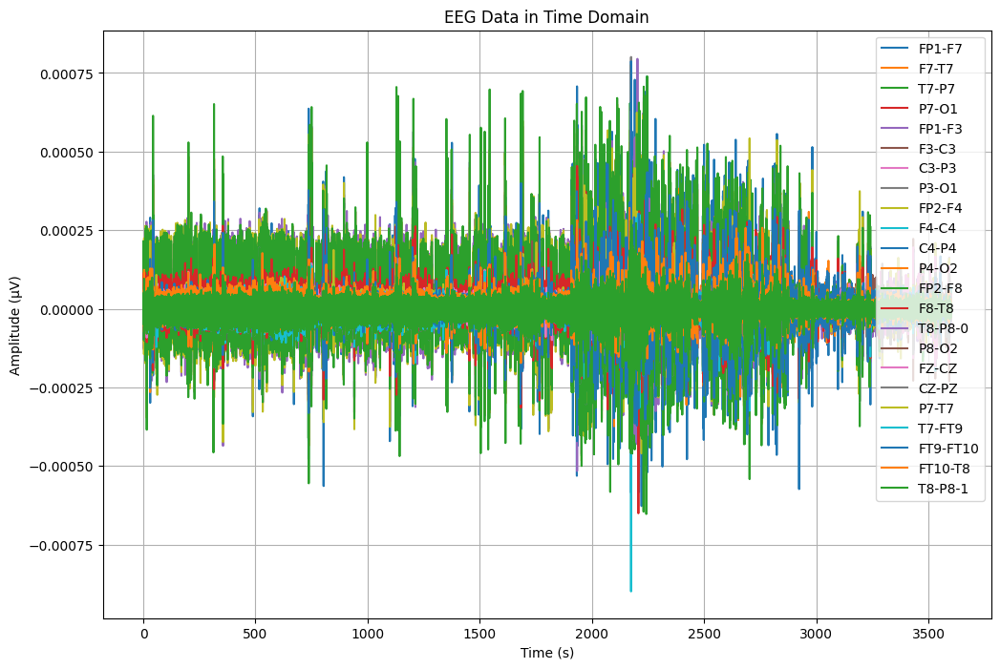

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df25['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df25[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


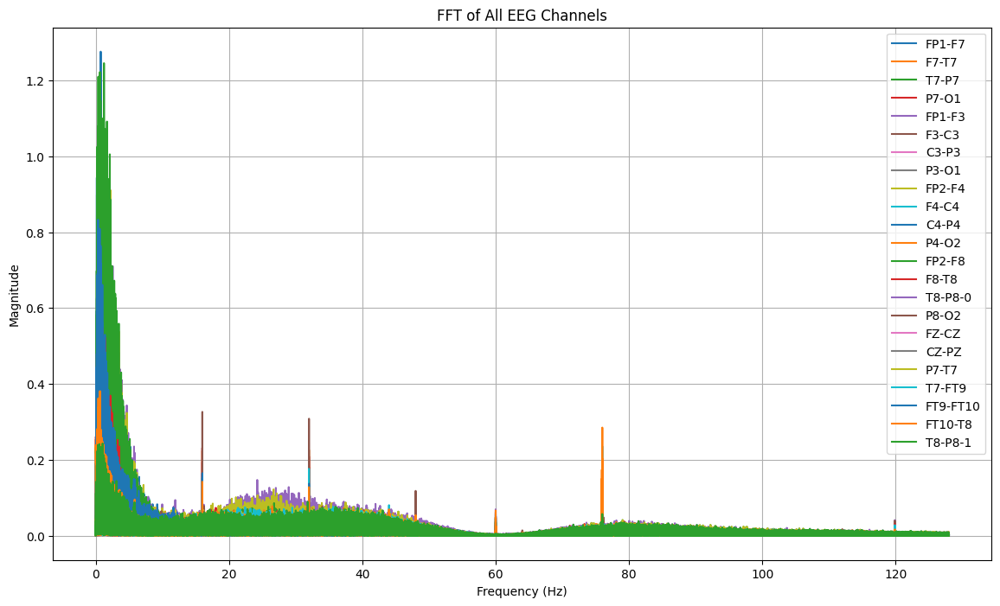

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df25[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_04.csv"
df25.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_04.csv


In [ ]:
#Import Data CSV
dataTA25 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_04.csv")
dataTA25


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,9.181929e-06,-1.347985e-05,-1.426129e-05,2.148962e-06,-2.246642e-05,-8.009768e-06,2.539683e-06,-5.274725e-06,-2.676435e-05,...,-4.395604e-05,-1.543346e-05,-2.481074e-05,-7.619048e-06,1.387057e-05,-7.228327e-06,2.012210e-05,2.832723e-05,-4.395604e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,0.011719
4,9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.035409e-05,2.148962e-06,-4.884005e-06,-1.347985e-05,-2.676435e-05,1.758242e-06,5.860806e-07,-4.102564e-06,-2.832723e-05,-6.056166e-06,...,-9.572650e-06,-1.758242e-06,-9.572650e-06,9.963370e-06,5.274725e-06,1.758242e-06,4.102564e-06,-1.738706e-05,-9.572650e-06,3599.980469
921596,-9.181929e-06,6.056166e-06,-4.884005e-06,-1.660562e-05,-2.402930e-05,3.711844e-06,1.758242e-06,-7.619048e-06,-2.559219e-05,-3.321123e-06,...,-8.400488e-06,-3.321123e-06,-9.572650e-06,6.446886e-06,5.274725e-06,1.953602e-07,3.711844e-06,-1.465201e-05,-8.400488e-06,3599.984375
921597,-7.228327e-06,6.056166e-06,-1.367521e-06,-1.543346e-05,-2.324786e-05,9.181929e-06,2.539683e-06,-6.837607e-06,-2.520147e-05,-9.768010e-07,...,-6.056166e-06,5.860806e-07,-6.837607e-06,6.446886e-06,1.758242e-06,3.711844e-06,7.228327e-06,-2.090354e-05,-6.056166e-06,3599.988281
921598,-8.791209e-06,9.181929e-06,-9.768010e-07,-1.269841e-05,-2.832723e-05,1.582418e-05,3.711844e-06,-6.056166e-06,-2.324786e-05,-2.148962e-06,...,-5.274725e-06,6.837607e-06,-6.056166e-06,1.113553e-05,1.367521e-06,1.953602e-07,9.572650e-06,-1.894994e-05,-5.274725e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA25[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA25[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA25[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data25, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP1-F7, Max Frequency: 0.76 Hz, Magnitude: 1.275716, Time: 2244.203125 s
Channel: FP2-F8, Max Frequency: 1.25 Hz, Magnitude: 1.245335, Time: 2246.386719 s
Channel: FP2-F4, Max Frequency: 0.77 Hz, Magnitude: 1.037994, Time: 2231.015625 s
Channel: FP1-F3, Max Frequency: 0.66 Hz, Magnitude: 1.030489, Time: 2202.925781 s
Channel: F7-T7, Max Frequency: 0.31 Hz, Magnitude: 0.940299, Time: 2209.449219 s
Channel: FT9-FT10, Max Frequency: 0.35 Hz, Magnitude: 0.832658, Time: 2174.453125 s
Channel: F8-T8, Max Frequency: 0.40 Hz, Magnitude: 0.657704, Time: 2207.031250 s
Channel: F3-C3, Max Frequency: 0.18 Hz, Magnitude: 0.493660, Time: 2207.031250 s
Channel: F4-C4, Max Frequency: 0.22 Hz, Magnitude: 0.383403, Time: 2231.769531 s
Channel: FT10-T8, Max Frequency: 0.64 Hz, Magnitude: 0.381186, Time: 2167.156250 s
Channel: T7-FT9, Max Frequency: 0.86 Hz, Magnitude: 0.377603, Time: 2174.453125 s
Channel: FZ-CZ, Max 

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT10-T8, Max Frequency: 0.64 Hz, Magnitude: 0.381186, Time: 2167.156250 s
Channel: P3-O1, Max Frequency: 0.00 Hz, Magnitude: 0.178065, Time: 2174.453125 s
Channel: C4-P4, Max Frequency: 0.00 Hz, Magnitude: 0.188146, Time: 2174.453125 s
Channel: P4-O2, Max Frequency: 0.00 Hz, Magnitude: 0.181126, Time: 2174.453125 s
Channel: FZ-CZ, Max Frequency: 1.22 Hz, Magnitude: 0.342825, Time: 2174.453125 s
Channel: T7-FT9, Max Frequency: 0.86 Hz, Magnitude: 0.377603, Time: 2174.453125 s
Channel: FT9-FT10, Max Frequency: 0.35 Hz, Magnitude: 0.832658, Time: 2174.453125 s
Channel: T8-P8-0, Max Frequency: 1.04 Hz, Magnitude: 0.243363, Time: 2174.496094 s
Channel: T8-P8-1, Max Frequency: 1.04 Hz, Magnitude: 0.243363, Time: 2174.496094 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 0.326434, Time: 2180.031250 s
Channel: P7-O1, Max Frequency: 1.11 Hz, Magnitude: 0.224141, Time: 218

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2042   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2334    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut25 = dataTA25.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut25.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_04.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA25 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_04.csv")
TA25.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000008,-0.000026,-0.000010,-7.619048e-06,-0.000020,-0.000011,-3.321123e-06,-5.860806e-07,-0.000006,5.860806e-07,...,0.000012,-0.000019,-9.181929e-06,0.000004,0.000011,-5.860806e-07,-0.000020,0.000016,0.000012,2042.000000
1,0.000012,-0.000026,-0.000023,-9.768010e-07,-0.000018,-0.000010,-4.493284e-06,-4.102564e-06,-0.000003,1.953602e-07,...,0.000015,-0.000010,-6.837607e-06,0.000007,0.000024,8.009768e-06,-0.000038,0.000015,0.000015,2042.003906
2,0.000010,-0.000033,-0.000013,1.953602e-07,-0.000017,-0.000012,-3.321123e-06,-1.758242e-06,-0.000003,1.953602e-07,...,0.000012,-0.000003,-3.321123e-06,0.000006,0.000013,9.572650e-06,-0.000023,0.000006,0.000012,2042.007812
3,0.000008,-0.000027,-0.000005,2.148962e-06,-0.000017,-0.000008,1.953602e-07,4.884005e-06,-0.000003,-1.953602e-07,...,0.000015,0.000020,-1.953602e-07,0.000012,0.000005,2.930403e-06,-0.000031,0.000010,0.000015,2042.011719
4,0.000003,-0.000024,-0.000004,1.953602e-07,-0.000018,-0.000006,1.953602e-07,1.953602e-07,-0.000002,-5.860806e-07,...,0.000012,0.000004,9.768010e-07,0.000009,0.000005,1.953602e-07,-0.000021,0.000016,0.000012,2042.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA25.shape

(74752, 24)

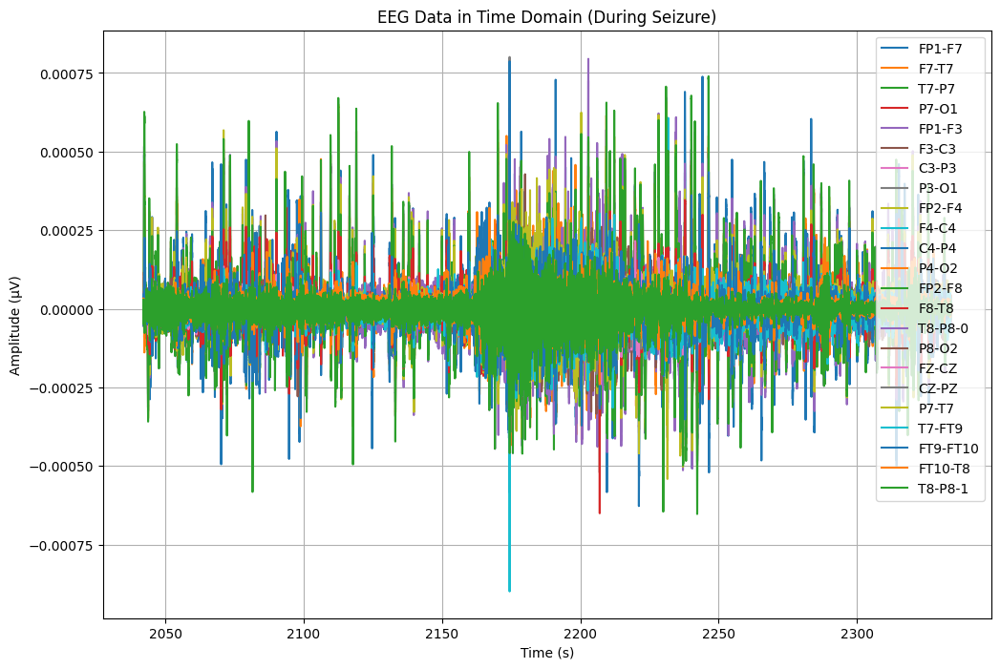

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA25['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA25.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA25[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


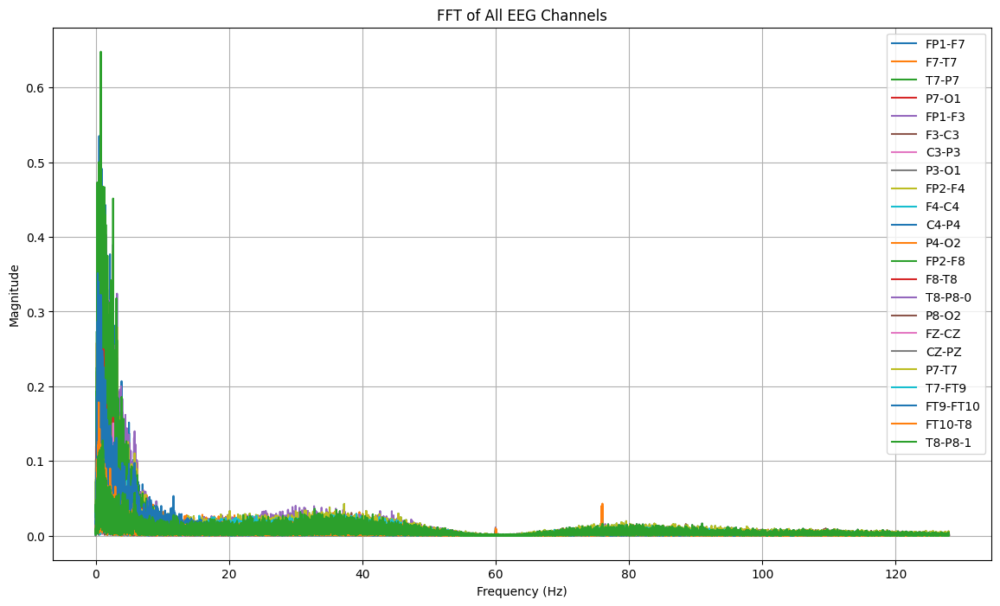

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA25[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2162:
        return "tidak kejang"
    elif 2162 <= row['Time'] < 2214:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_25 = TA25.copy()
TA_25['seizure'] = TA_25.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_25[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7         P7-O1  \
0  2042.000000  tidak kejang  0.000008 -0.000026 -0.000010 -7.619048e-06   
1  2042.003906  tidak kejang  0.000012 -0.000026 -0.000023 -9.768010e-07   
2  2042.007812  tidak kejang  0.000010 -0.000033 -0.000013  1.953602e-07   
3  2042.011719  tidak kejang  0.000008 -0.000027 -0.000005  2.148962e-06   
4  2042.015625  tidak kejang  0.000003 -0.000024 -0.000004  1.953602e-07   

     FP1-F3     F3-C3         C3-P3         P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000020 -0.000011 -3.321123e-06 -5.860806e-07  ...  0.000051  0.000012   
1 -0.000018 -0.000010 -4.493284e-06 -4.102564e-06  ...  0.000043  0.000015   
2 -0.000017 -0.000012 -3.321123e-06 -1.758242e-06  ...  0.000040  0.000012   
3 -0.000017 -0.000008  1.953602e-07  4.884005e-06  ...  0.000035  0.000015   
4 -0.000018 -0.000006  1.953602e-07  1.953602e-07  ...  0.000028  0.000012   

      P8-O2         FZ-CZ     CZ-PZ     P7-T7        T7-FT9  FT9-FT10  \
0

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_25['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,13312


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_25)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 292.0 detik


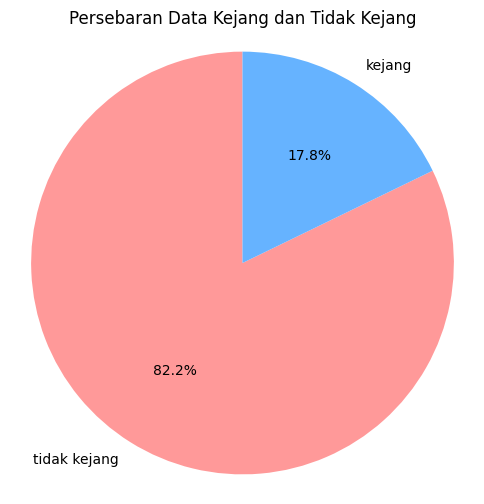

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_25['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_25.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_04.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_25.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_25['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.91      0.93      2717
tidak kejang       0.98      0.99      0.99     12234

    accuracy                           0.98     14951
   macro avg       0.97      0.95      0.96     14951
weighted avg       0.98      0.98      0.98     14951

Akurasi: 0.9763895391612601
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.91      0.93      2717
tidak kejang       0.98      0.99      0.99     12234

    accuracy                           0.98     14951
   macro avg       0.97      0.95      0.96     14951
weighted avg       0.98      0.98      0.98     14951



# DATA 27 (chb03_35) udah dicoba jelek akurasinya

In [ ]:
# mengimport file edf
file27 = "/content/drive/MyDrive/TA/EDF/chb03_35.edf"
data27 = mne.io.read_raw_edf(file27) # membaca file edf dan menyimpannya di data
data27


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_35.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-235-e248f049c79b>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data27 = mne.io.read_raw_edf(file27) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_35.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data27.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data27.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data27.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df27 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df27['Time'] = times  # Menambahkan kolom waktu
df27.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,4.493284e-06,-1.504274e-05,1.699634e-05,-8.654457e-05,-1.230769e-05,-4.493284e-06,-5.489621e-05,-8.400488e-06,-9.963370e-06,-5.372405e-05,...,-3.731380e-05,4.825397e-05,1.582418e-05,-1.611722e-04,-1.660562e-05,-4.864469e-05,-3.457875e-05,4.630037e-05,-3.731380e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,...,1.953602e-07,1.953602e-07,-5.860806e-07,-4.102564e-06,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,-9.768010e-07,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-4.493284e-06,...,1.953602e-07,5.860806e-07,-2.539683e-06,-1.347985e-05,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,2.148962e-06,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,8.400488e-06,...,5.860806e-07,-9.768010e-07,5.665446e-06,2.676435e-05,-1.758242e-06,1.953602e-07,-1.953602e-07,5.860806e-07,5.860806e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df27.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df27.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.172704e-07,2.083974e-07,1.246210e-07,2.700185e-07,1.963544e-07,2.175591e-07,2.076486e-07,1.970013e-07,2.113362e-07,2.099185e-07,...,1.830251e-07,2.030394e-07,1.939442e-07,2.046428e-07,2.660994e-07,1.594869e-07,1.973363e-07,2.060618e-07,1.830251e-07,1799.998047
std,5.079673e-05,4.932996e-05,4.877081e-05,4.293701e-05,5.003014e-05,4.219873e-05,2.752505e-05,3.148684e-05,5.213646e-05,6.889772e-05,...,3.846530e-05,2.749159e-05,4.868721e-05,8.168052e-05,4.877081e-05,3.887911e-05,3.466835e-05,3.519029e-05,3.846530e-05,1039.231048
min,-7.714774e-04,-7.136508e-04,-1.237998e-03,-1.058266e-03,-7.562393e-04,-5.897924e-04,-5.374359e-04,-7.652259e-04,-1.291526e-03,-1.450940e-03,...,-9.992674e-04,-7.585836e-04,-1.572845e-03,-1.701392e-03,-1.208303e-03,-7.644444e-04,-8.957265e-04,-7.992186e-04,-9.992674e-04,0.000000
25%,-1.387057e-05,-1.855922e-05,-1.699634e-05,-1.894994e-05,-1.894994e-05,-1.894994e-05,-1.035409e-05,-1.035409e-05,-1.894994e-05,-1.738706e-05,...,-1.308913e-05,-1.191697e-05,-1.855922e-05,-3.067155e-05,-2.012210e-05,-1.191697e-05,-1.426129e-05,-1.113553e-05,-1.308913e-05,899.999023
50%,1.953602e-07,1.953602e-07,1.367521e-06,-9.768010e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.387057e-05,1.855922e-05,2.051282e-05,1.660562e-05,1.894994e-05,1.894994e-05,1.074481e-05,1.074481e-05,1.855922e-05,1.777778e-05,...,1.426129e-05,1.191697e-05,1.894994e-05,3.106227e-05,1.738706e-05,1.347985e-05,1.465201e-05,1.074481e-05,1.426129e-05,2699.997070
max,9.281563e-04,8.382906e-04,1.208694e-03,1.034823e-03,1.050452e-03,4.690598e-04,6.034676e-04,1.078584e-03,8.718926e-04,1.821343e-03,...,7.183394e-04,6.886447e-04,1.311062e-03,1.951844e-03,1.238388e-03,5.784615e-04,6.905983e-04,8.504029e-04,7.183394e-04,3599.996094


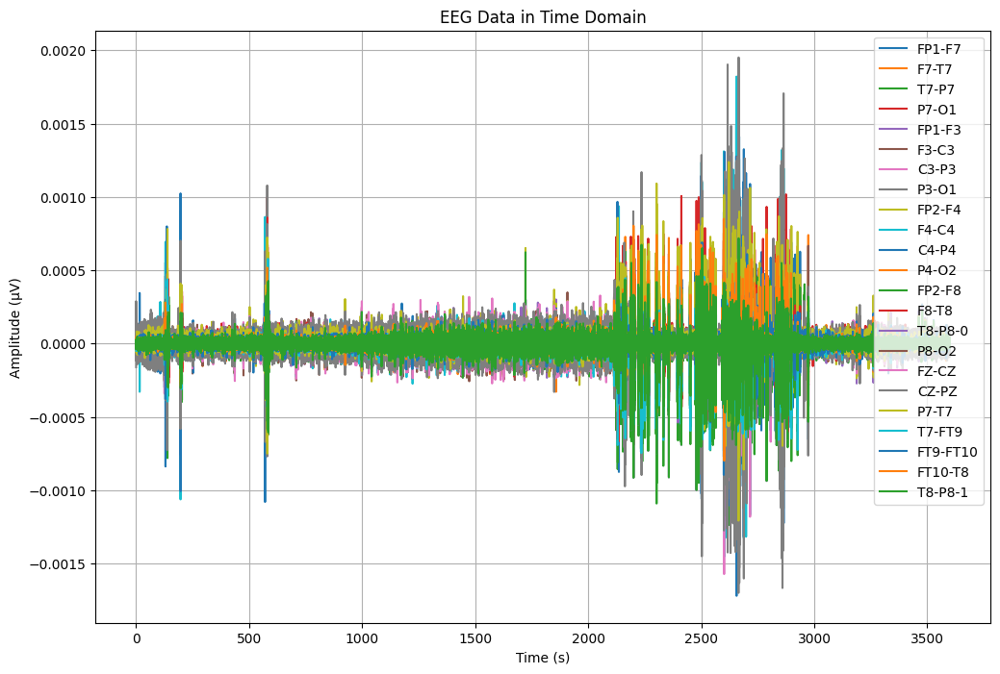

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df27['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df27[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


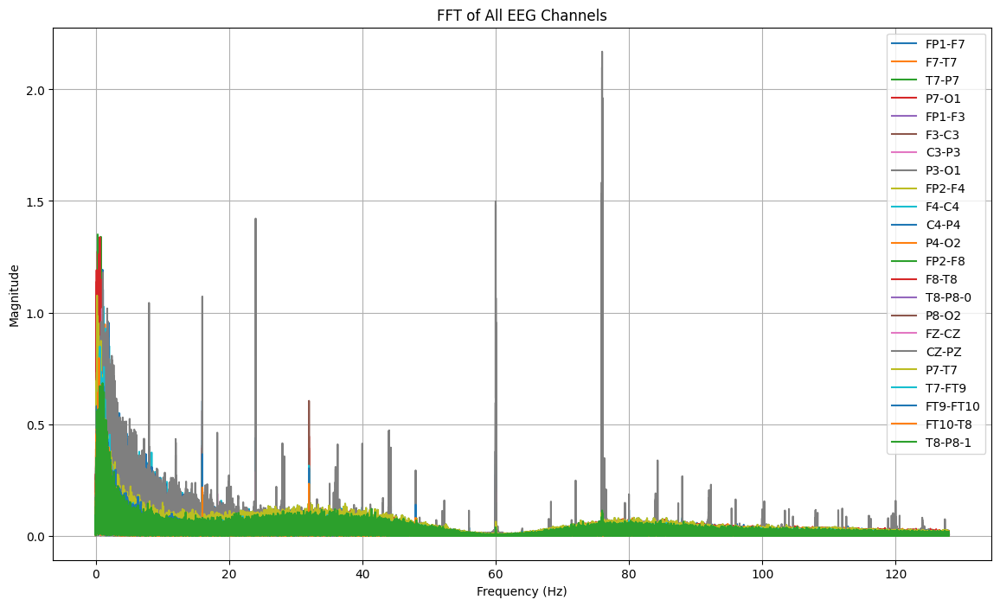

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df27[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_35.csv"
df27.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_35.csv


In [ ]:
#Import Data CSV
dataTA27 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_35.csv")
dataTA27


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,4.493284e-06,-1.504274e-05,1.699634e-05,-8.654457e-05,-1.230769e-05,-4.493284e-06,-5.489621e-05,-8.400488e-06,-9.963370e-06,-5.372405e-05,...,-3.731380e-05,4.825397e-05,1.582418e-05,-1.611722e-04,-1.660562e-05,-4.864469e-05,-3.457875e-05,4.630037e-05,-3.731380e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,...,1.953602e-07,1.953602e-07,-5.860806e-07,-4.102564e-06,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,-9.768010e-07,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-4.493284e-06,...,1.953602e-07,5.860806e-07,-2.539683e-06,-1.347985e-05,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,2.148962e-06,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,8.400488e-06,...,5.860806e-07,-9.768010e-07,5.665446e-06,2.676435e-05,-1.758242e-06,1.953602e-07,-1.953602e-07,5.860806e-07,5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-8.791209e-06,-2.930403e-06,-1.953602e-07,-3.321123e-06,-1.113553e-05,-5.860806e-07,-5.860806e-07,-2.930403e-06,-5.665446e-06,2.539683e-06,...,-1.504274e-05,-1.973138e-05,-2.989011e-05,-1.035409e-05,5.860806e-07,7.619048e-06,2.207570e-05,6.056166e-06,-1.504274e-05,3599.980469
921596,-5.665446e-06,-2.930403e-06,1.953602e-07,-2.539683e-06,-1.230769e-05,2.930403e-06,5.860806e-07,-3.711844e-06,-4.102564e-06,5.860806e-07,...,-1.152625e-05,-2.012210e-05,-2.442002e-05,-9.768010e-07,1.953602e-07,9.572650e-06,2.442002e-05,4.884005e-06,-1.152625e-05,3599.984375
921597,-6.056166e-06,-3.321123e-06,-9.768010e-07,1.758242e-06,-1.504274e-05,9.768010e-07,1.758242e-06,1.758242e-06,-4.884005e-06,1.543346e-05,...,-5.665446e-06,-1.660562e-05,-1.426129e-05,2.442002e-05,1.367521e-06,8.009768e-06,2.129426e-05,5.665446e-06,-5.665446e-06,3599.988281
921598,-7.228327e-06,-6.056166e-06,-9.768010e-07,7.228327e-06,-1.660562e-05,-9.768010e-07,9.768010e-07,8.400488e-06,-9.572650e-06,7.228327e-06,...,-4.884005e-06,-6.446886e-06,-2.285714e-05,-1.855922e-05,1.367521e-06,7.619048e-06,1.855922e-05,6.446886e-06,-4.884005e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA27[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA27[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA27[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, dataTA27, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: CZ-PZ, Max Frequency: 75.98 Hz, Magnitude: 2.169183, Time: 2665.648438 s
Channel: FP2-F8, Max Frequency: 0.31 Hz, Magnitude: 1.350210, Time: 2603.699219 s
Channel: F8-T8, Max Frequency: 0.62 Hz, Magnitude: 1.337853, Time: 2875.347656 s
Channel: P7-O1, Max Frequency: 0.28 Hz, Magnitude: 1.274769, Time: 2665.292969 s
Channel: FP2-F4, Max Frequency: 0.33 Hz, Magnitude: 1.271642, Time: 2600.097656 s
Channel: C4-P4, Max Frequency: 1.04 Hz, Magnitude: 1.192014, Time: 2656.460938 s
Channel: F4-C4, Max Frequency: 1.02 Hz, Magnitude: 1.104471, Time: 2656.457031 s
Channel: T7-P7, Max Frequency: 0.21 Hz, Magnitude: 1.076194, Time: 2622.566406 s
Channel: P7-T7, Max Frequency: 0.21 Hz, Magnitude: 1.076194, Time: 2622.566406 s
Channel: F7-T7, Max Frequency: 1.04 Hz, Magnitude: 1.058799, Time: 2702.699219 s
Channel: FP1-F3, Max Frequency: 0.22 Hz, Magnitude: 1.024851, Time: 2600.078125 s
Channel: FZ-CZ, Max Freque

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: P3-O1, Max Frequency: 0.98 Hz, Magnitude: 0.667766, Time: 579.921875 s
Channel: F3-C3, Max Frequency: 1.01 Hz, Magnitude: 0.945632, Time: 581.500000 s
Channel: C3-P3, Max Frequency: 0.92 Hz, Magnitude: 0.580012, Time: 581.515625 s
Channel: P8-O2, Max Frequency: 32.00 Hz, Magnitude: 0.604456, Time: 2235.921875 s
Channel: T8-P8-0, Max Frequency: 1.04 Hz, Magnitude: 0.683837, Time: 2479.078125 s
Channel: T8-P8-1, Max Frequency: 1.04 Hz, Magnitude: 0.683837, Time: 2479.078125 s
Channel: T7-FT9, Max Frequency: 0.63 Hz, Magnitude: 0.848138, Time: 2488.921875 s
Channel: FT10-T8, Max Frequency: 0.50 Hz, Magnitude: 0.796206, Time: 2599.769531 s
Channel: FT9-FT10, Max Frequency: 1.13 Hz, Magnitude: 0.670742, Time: 2599.777344 s
Channel: FP1-F7, Max Frequency: 0.45 Hz, Magnitude: 0.996172, Time: 2600.078125 s
Channel: FP1-F3, Max Frequency: 0.22 Hz, Magnitude: 1.024851, Time: 2600

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2359   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2995    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut27 = dataTA27.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut27.to_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb03_35.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA27 = pd.read_csv("/content/drive/MyDrive/TA/ikutiwaktu/datacutTA_chb03_35.csv")
TA27.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000026,-1.758242e-06,-0.000024,1.953602e-07,-0.000017,-0.000017,-0.000009,-0.000007,-0.000023,-0.000028,...,-0.000029,-0.000010,-1.426129e-05,-0.000068,0.000024,3.321123e-06,-3.321123e-06,-1.953602e-07,-0.000029,2359.000000
1,-0.000021,-1.367521e-06,-0.000018,-3.711844e-06,-0.000013,-0.000015,-0.000005,-0.000009,-0.000018,-0.000010,...,-0.000019,-0.000010,5.860806e-07,0.000012,0.000019,1.367521e-06,-3.711844e-06,1.758242e-06,-0.000019,2359.003906
2,-0.000024,-5.860806e-07,-0.000017,1.758242e-06,-0.000015,-0.000015,-0.000003,-0.000005,-0.000025,-0.000005,...,-0.000013,-0.000008,2.148962e-06,-0.000003,0.000017,1.953602e-07,5.860806e-07,5.274725e-06,-0.000013,2359.007812
3,-0.000025,-2.930403e-06,-0.000022,9.572650e-06,-0.000019,-0.000010,-0.000003,-0.000007,-0.000033,-0.000015,...,-0.000005,-0.000014,-9.572650e-06,-0.000064,0.000022,1.953602e-07,8.400488e-06,1.152625e-05,-0.000005,2359.011719
4,-0.000030,9.768010e-07,-0.000002,5.860806e-07,-0.000022,-0.000003,0.000007,-0.000012,-0.000044,-0.000008,...,0.000002,-0.000012,1.367521e-06,-0.000008,0.000003,-9.768010e-07,1.308913e-05,1.308913e-05,0.000002,2359.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA27.shape

(162816, 24)

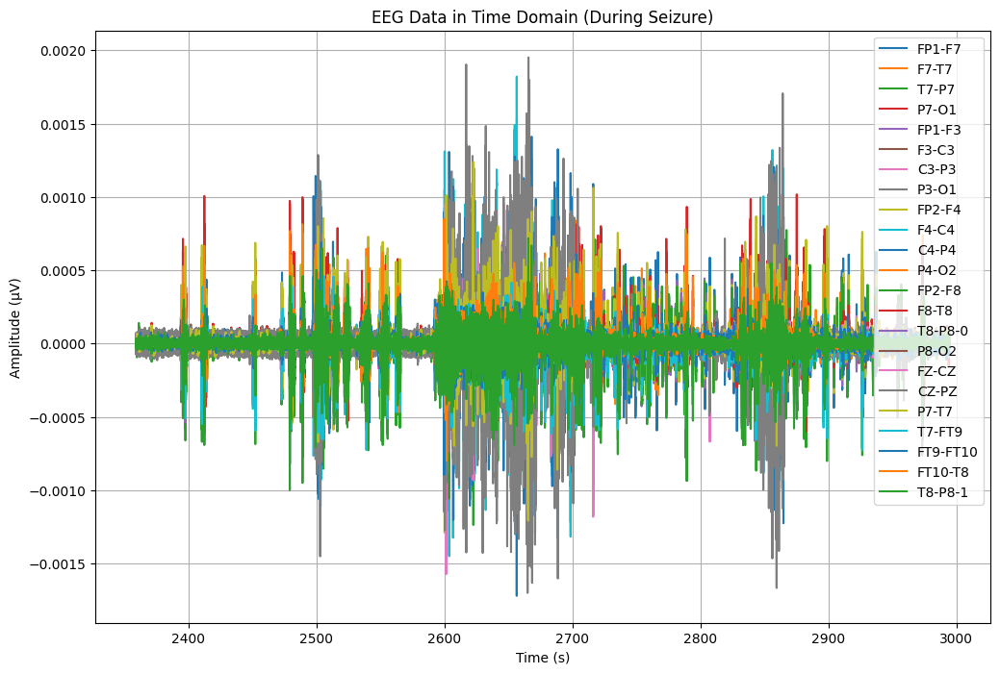

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA27['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA27.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA27[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


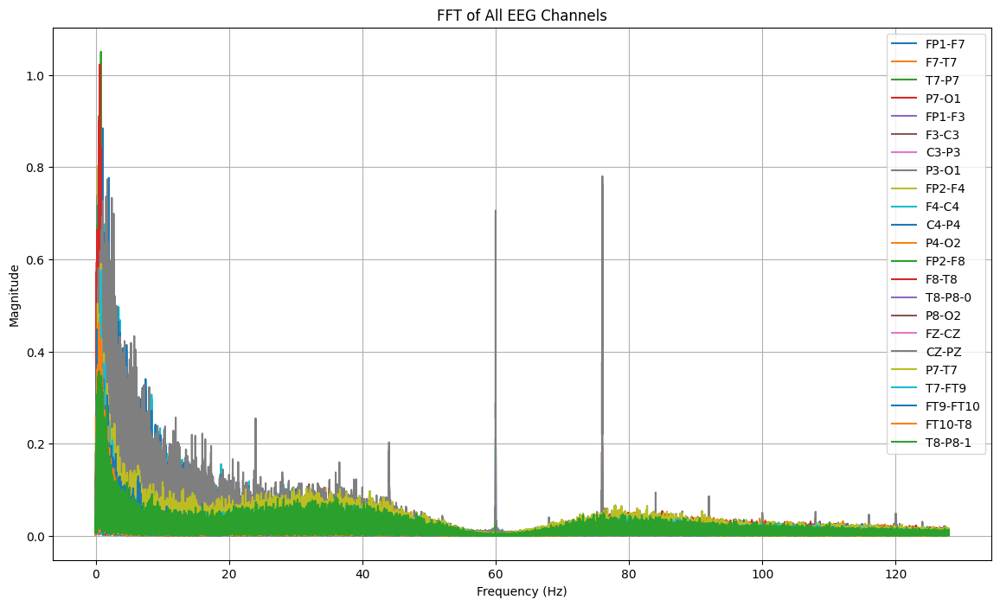

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA27[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2479:
        return "tidak kejang"
    elif 2479 <= row['Time'] < 2875:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_27 = TA27.copy()
TA_27['seizure'] = TA_27.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_27[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7         F7-T7     T7-P7         P7-O1  \
0  2359.000000  tidak kejang -0.000026 -1.758242e-06 -0.000024  1.953602e-07   
1  2359.003906  tidak kejang -0.000021 -1.367521e-06 -0.000018 -3.711844e-06   
2  2359.007812  tidak kejang -0.000024 -5.860806e-07 -0.000017  1.758242e-06   
3  2359.011719  tidak kejang -0.000025 -2.930403e-06 -0.000022  9.572650e-06   
4  2359.015625  tidak kejang -0.000030  9.768010e-07 -0.000002  5.860806e-07   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000017 -0.000017 -0.000009 -0.000007  ... -0.000052 -0.000029 -0.000010   
1 -0.000013 -0.000015 -0.000005 -0.000009  ... -0.000050 -0.000019 -0.000010   
2 -0.000015 -0.000015 -0.000003 -0.000005  ... -0.000046 -0.000013 -0.000008   
3 -0.000019 -0.000010 -0.000003 -0.000007  ... -0.000038 -0.000005 -0.000014   
4 -0.000022 -0.000003  0.000007 -0.000012  ... -0.000034  0.000002 -0.000012   

          FZ-CZ     CZ-PZ     P7-T7   

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_27['seizure'].value_counts()


,count
seizure,
kejang,101376
tidak kejang,61440


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_27)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 636.0 detik


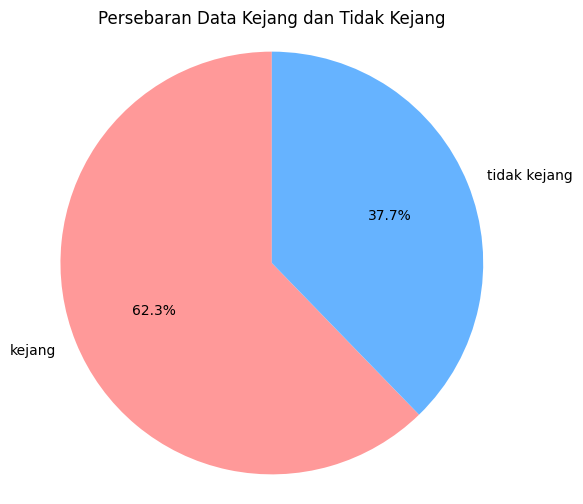

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_27['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_27.to_csv("/content/drive/MyDrive/TA/seizure ikutiwaktu/seizure_chb03_35.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_27.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_27['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.93      0.92      0.92     20388
tidak kejang       0.87      0.88      0.88     12176

    accuracy                           0.91     32564
   macro avg       0.90      0.90      0.90     32564
weighted avg       0.91      0.91      0.91     32564

Akurasi: 0.9061847438889571
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.93      0.92      0.92     20388
tidak kejang       0.87      0.88      0.88     12176

    accuracy                           0.91     32564
   macro avg       0.90      0.90      0.90     32564
weighted avg       0.91      0.91      0.91     32564



# DATA 28 (chb03_36) berantakan gausah diambil

In [ ]:
# mengimport file edf
file28 = "/content/drive/MyDrive/TA/EDF/chb03_36.edf"
data28 = mne.io.read_raw_edf(file28) # membaca file edf dan menyimpannya di data
data28


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_36.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-439-7af6d2db691a>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data28 = mne.io.read_raw_edf(file28) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_36.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data28.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data28.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data28.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df28 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df28['Time'] = times  # Menambahkan kolom waktu
df28.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.738706e-05,-8.068376e-05,1.248352e-04,3.223443e-05,-9.181929e-06,9.553114e-05,-5.880342e-05,3.145299e-05,6.192918e-05,9.084249e-05,...,1.582418e-05,-1.035409e-05,4.551893e-05,1.467155e-04,-1.244444e-04,8.341880e-05,-1.973138e-05,6.427350e-05,1.582418e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,2.539683e-06,...,1.953602e-07,1.953602e-07,1.367521e-06,7.228327e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-2.930403e-06,...,1.953602e-07,1.953602e-07,-2.539683e-06,-8.791209e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df28.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df28.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.727403e-07,2.256911e-07,1.518048e-07,2.239579e-07,2.345815e-07,2.011031e-07,2.294779e-07,2.238727e-07,2.205582e-07,2.057468e-07,...,2.049298e-07,1.947175e-07,1.820746e-07,1.934570e-07,2.389156e-07,1.524903e-07,1.813640e-07,2.152930e-07,2.049298e-07,1799.998047
std,5.338790e-05,5.107524e-05,4.682578e-05,4.505983e-05,4.308981e-05,3.342880e-05,3.297056e-05,3.865227e-05,5.026193e-05,8.040608e-05,...,3.580196e-05,2.974376e-05,4.850510e-05,9.196463e-05,4.682578e-05,4.086165e-05,4.264270e-05,3.600288e-05,3.580196e-05,1039.231048
min,-8.121123e-04,-1.062173e-03,-7.656166e-04,-9.625397e-04,-8.175824e-04,-8.437607e-04,-1.119609e-03,-7.585836e-04,-1.168840e-03,-1.502515e-03,...,-8.937729e-04,-1.053968e-03,-1.488059e-03,-1.736557e-03,-9.703541e-04,-7.488156e-04,-7.804640e-04,-5.776801e-04,-8.937729e-04,0.000000
25%,-1.816850e-05,-1.934066e-05,-1.387057e-05,-1.426129e-05,-1.269841e-05,-1.113553e-05,-8.400488e-06,-9.181929e-06,-1.582418e-05,-1.816850e-05,...,-1.230769e-05,-1.035409e-05,-1.543346e-05,-4.043956e-05,-1.582418e-05,-9.181929e-06,-1.582418e-05,-9.181929e-06,-1.230769e-05,899.999023
50%,-9.768010e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.660562e-05,1.855922e-05,1.621490e-05,1.387057e-05,1.152625e-05,1.152625e-05,8.400488e-06,9.572650e-06,1.504274e-05,1.816850e-05,...,1.269841e-05,1.074481e-05,1.543346e-05,4.043956e-05,1.426129e-05,1.074481e-05,1.621490e-05,8.791209e-06,1.269841e-05,2699.997070
max,1.007473e-03,7.804640e-04,9.707448e-04,9.984860e-04,8.468864e-04,7.417827e-04,1.122344e-03,1.227448e-03,1.103199e-03,1.852210e-03,...,1.161416e-03,1.064518e-03,1.593162e-03,1.960440e-03,7.660073e-04,8.328205e-04,8.367277e-04,8.429792e-04,1.161416e-03,3599.996094


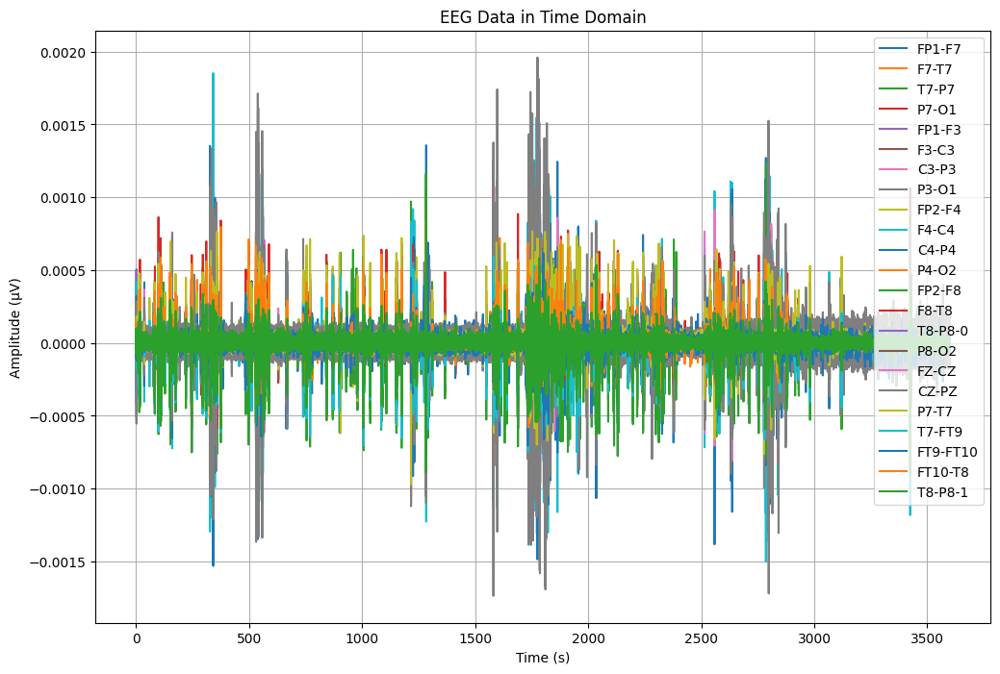

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df28['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df28[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


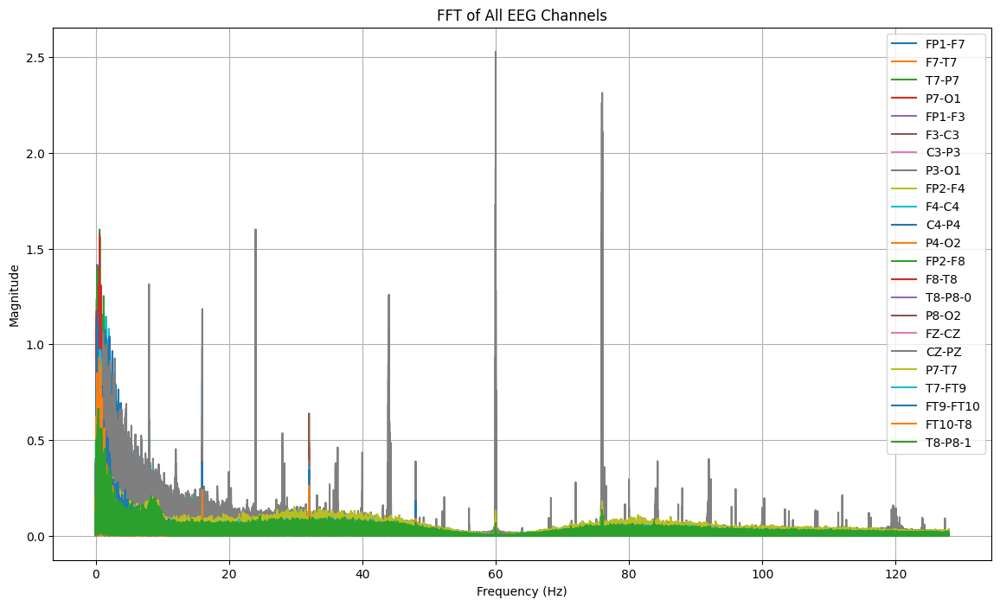

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df28[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_36.csv"
df28.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_36.csv


In [ ]:
#Import Data CSV
dataTA28 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_36.csv")
dataTA28


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.738706e-05,-8.068376e-05,1.248352e-04,3.223443e-05,-9.181929e-06,9.553114e-05,-5.880342e-05,3.145299e-05,6.192918e-05,9.084249e-05,...,1.582418e-05,-1.035409e-05,4.551893e-05,1.467155e-04,-1.244444e-04,8.341880e-05,-1.973138e-05,6.427350e-05,1.582418e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,2.539683e-06,...,1.953602e-07,1.953602e-07,1.367521e-06,7.228327e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-2.930403e-06,...,1.953602e-07,1.953602e-07,-2.539683e-06,-8.791209e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.367521e-06,1.953602e-07,2.539683e-06,-1.953602e-07,-1.113553e-05,-8.791209e-06,1.347985e-05,7.228327e-06,-5.665446e-06,-1.973138e-05,...,5.860806e-07,-2.930403e-06,-2.324786e-05,2.207570e-05,-2.148962e-06,4.884005e-06,-7.228327e-06,2.930403e-06,5.860806e-07,3599.980469
921596,5.274725e-06,2.930403e-06,-9.768010e-07,-6.837607e-06,-4.884005e-06,-6.056166e-06,1.660562e-05,-2.930403e-06,-3.321123e-06,-2.246642e-05,...,-1.953602e-07,-8.791209e-06,-2.148962e-06,-1.973138e-05,1.367521e-06,4.493284e-06,-6.056166e-06,2.930403e-06,-1.953602e-07,3599.984375
921597,1.367521e-06,-4.884005e-06,-6.446886e-06,7.228327e-06,-6.446886e-06,-1.347985e-05,1.035409e-05,7.228327e-06,-8.400488e-06,1.953602e-07,...,2.930403e-06,-5.860806e-07,5.860806e-07,-5.137973e-05,6.837607e-06,5.665446e-06,-1.230769e-05,3.321123e-06,2.930403e-06,3599.988281
921598,1.367521e-06,-1.035409e-05,-1.621490e-05,1.816850e-05,-8.400488e-06,-1.660562e-05,4.493284e-06,1.387057e-05,-1.582418e-05,-3.887668e-05,...,1.953602e-07,8.009768e-06,-4.903541e-05,-8.537241e-05,1.660562e-05,4.102564e-06,-1.152625e-05,2.930403e-06,1.953602e-07,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA28[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA28[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA28[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data28, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: CZ-PZ, Max Frequency: 60.01 Hz, Magnitude: 2.528758, Time: 1775.808594 s
Channel: FP2-F8, Max Frequency: 0.58 Hz, Magnitude: 1.600398, Time: 2786.988281 s
Channel: F8-T8, Max Frequency: 0.58 Hz, Magnitude: 1.577474, Time: 1689.257812 s
Channel: FP1-F7, Max Frequency: 0.22 Hz, Magnitude: 1.415741, Time: 1804.628906 s
Channel: F7-T7, Max Frequency: 0.31 Hz, Magnitude: 1.369207, Time: 1216.097656 s
Channel: FP2-F4, Max Frequency: 0.18 Hz, Magnitude: 1.231380, Time: 2786.695312 s
Channel: C4-P4, Max Frequency: 0.60 Hz, Magnitude: 1.187349, Time: 341.144531 s
Channel: F4-C4, Max Frequency: 0.71 Hz, Magnitude: 1.180021, Time: 341.144531 s
Channel: FT9-FT10, Max Frequency: 0.33 Hz, Magnitude: 1.165196, Time: 1283.558594 s
Channel: FZ-CZ, Max Frequency: 75.98 Hz, Magnitude: 1.004468, Time: 538.625000 s
Channel: T7-FT9, Max Frequency: 0.65 Hz, Magnitude: 0.971777, Time: 1216.093750 s
Channel: FT10-T8, Max Fr

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F4-C4, Max Frequency: 0.71 Hz, Magnitude: 1.180021, Time: 341.144531 s
Channel: C4-P4, Max Frequency: 0.60 Hz, Magnitude: 1.187349, Time: 341.144531 s
Channel: FZ-CZ, Max Frequency: 75.98 Hz, Magnitude: 1.004468, Time: 538.625000 s
Channel: C3-P3, Max Frequency: 0.54 Hz, Magnitude: 0.666246, Time: 540.152344 s
Channel: T7-FT9, Max Frequency: 0.65 Hz, Magnitude: 0.971777, Time: 1216.093750 s
Channel: F7-T7, Max Frequency: 0.31 Hz, Magnitude: 1.369207, Time: 1216.097656 s
Channel: T7-P7, Max Frequency: 0.78 Hz, Magnitude: 0.878311, Time: 1216.097656 s
Channel: P7-T7, Max Frequency: 0.78 Hz, Magnitude: 0.878311, Time: 1216.097656 s
Channel: FT10-T8, Max Frequency: 0.54 Hz, Magnitude: 0.932931, Time: 1281.964844 s
Channel: T8-P8-0, Max Frequency: 0.40 Hz, Magnitude: 0.663232, Time: 1282.960938 s
Channel: T8-P8-1, Max Frequency: 0.40 Hz, Magnitude: 0.663232, Time: 1282.96093

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1605   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1898    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut28 = dataTA28.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut28.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_36.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA28 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_36.csv")
TA28.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000071,-0.000062,-0.000096,0.000051,-0.000110,0.000028,-0.000045,-0.000049,-0.000034,-0.000077,...,-0.000026,-1.387057e-05,0.000011,-0.000006,0.000096,-0.000057,0.000117,-0.000038,-0.000026,1605.000000
1,0.000003,-0.000262,0.000133,0.000019,-0.000104,0.000097,-0.000050,-0.000047,-0.000013,-0.000051,...,-0.000045,2.637363e-05,0.000013,-0.000057,-0.000133,0.000041,0.000129,-0.000001,-0.000045,1605.003906
2,0.000028,-0.000185,0.000042,0.000027,-0.000081,0.000077,-0.000035,-0.000047,-0.000009,-0.000048,...,-0.000060,1.777778e-05,0.000021,-0.000033,-0.000041,-0.000003,0.000137,-0.000009,-0.000060,1605.007812
3,-0.000042,-0.000117,0.000026,0.000043,-0.000055,0.000087,-0.000072,-0.000049,-0.000010,-0.000037,...,-0.000055,1.855922e-05,0.000037,0.000035,-0.000026,-0.000005,0.000137,-0.000016,-0.000055,1605.011719
4,-0.000088,-0.000055,0.000065,-0.000015,-0.000023,0.000066,-0.000047,-0.000087,-0.000010,-0.000027,...,-0.000055,1.953602e-07,0.000015,-0.000056,-0.000065,-0.000014,0.000129,-0.000013,-0.000055,1605.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA28.shape

(75008, 24)

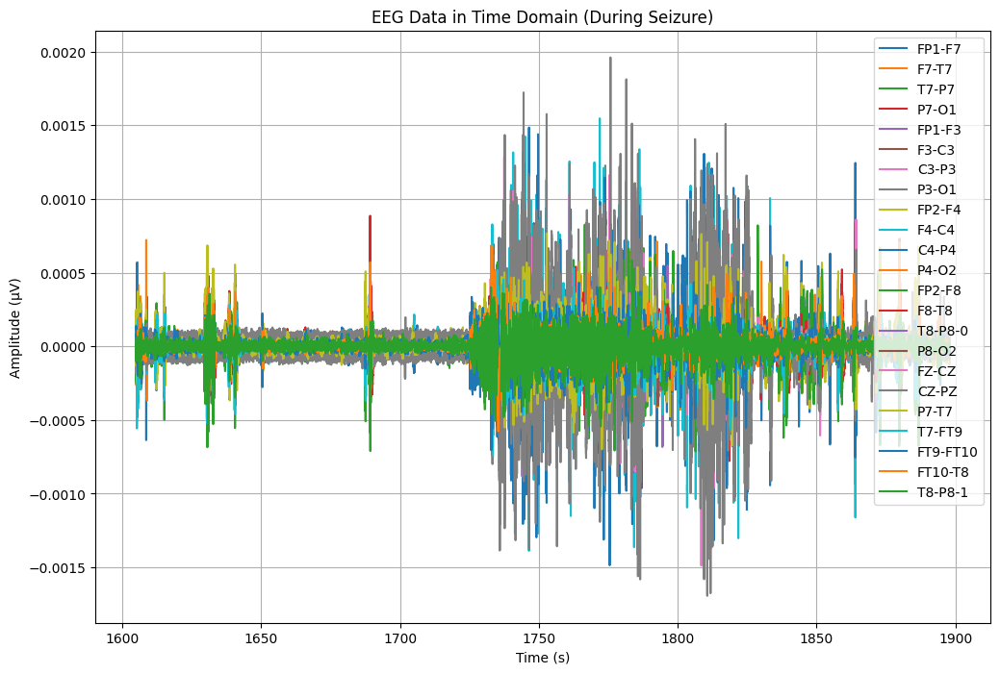

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA28['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA28.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA28[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


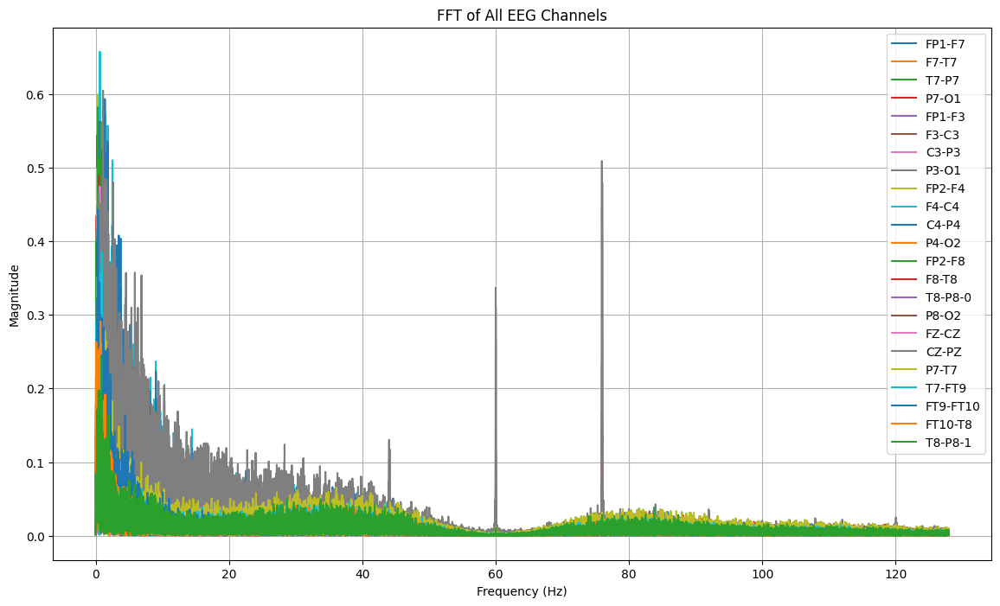

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA28[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1725:
        return "tidak kejang"
    elif 1725 <= row['Time'] < 1778:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_28 = TA28.copy()
TA_28['seizure'] = TA_28.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_28[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1605.000000  tidak kejang -0.000071 -0.000062 -0.000096  0.000051   
1  1605.003906  tidak kejang  0.000003 -0.000262  0.000133  0.000019   
2  1605.007812  tidak kejang  0.000028 -0.000185  0.000042  0.000027   
3  1605.011719  tidak kejang -0.000042 -0.000117  0.000026  0.000043   
4  1605.015625  tidak kejang -0.000088 -0.000055  0.000065 -0.000015   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000110  0.000028 -0.000045 -0.000049  ... -0.000024 -0.000026   
1 -0.000104  0.000097 -0.000050 -0.000047  ...  0.000002 -0.000045   
2 -0.000081  0.000077 -0.000035 -0.000047  ...  0.000007 -0.000060   
3 -0.000055  0.000087 -0.000072 -0.000049  ... -0.000017 -0.000055   
4 -0.000023  0.000066 -0.000047 -0.000087  ... -0.000008 -0.000055   

          P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0 -1.387057e-05  0.000011 -0.000006  0.000096 -0.000057  0.000117 -

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_28['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,13568


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_28)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 293.0 detik


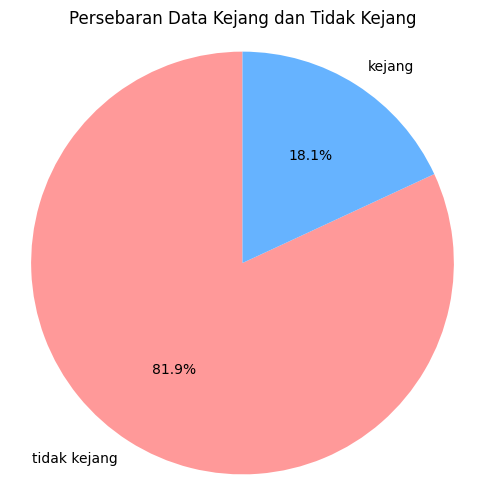

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_28['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_28.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_36.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_28.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_28['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.90      0.93      2804
tidak kejang       0.98      0.99      0.98     12198

    accuracy                           0.98     15002
   macro avg       0.97      0.95      0.96     15002
weighted avg       0.98      0.98      0.98     15002

Akurasi: 0.975403279562725
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.90      0.93      2804
tidak kejang       0.98      0.99      0.98     12198

    accuracy                           0.98     15002
   macro avg       0.97      0.95      0.96     15002
weighted avg       0.98      0.98      0.98     15002



# DATA 29 (chb08_21) sama semua gak bisa diambil

In [ ]:
# mengimport file edf
file29 = "/content/drive/MyDrive/TA/EDF/chb08_21.edf"
data29 = mne.io.read_raw_edf(file29) # membaca file edf dan menyimpannya di data
data29


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb08_21.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-463-2d1375caa9a4>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data29 = mne.io.read_raw_edf(file29) # membaca file edf dan menyimpannya di data


<RawEDF | chb08_21.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data29.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data29.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data29.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df29 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df29['Time'] = times  # Menambahkan kolom waktu
df29.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.123321e-04,-8.459096e-05,6.857143e-05,-7.208791e-05,5.841270e-05,-2.090354e-05,2.832723e-05,-4.161172e-05,1.426129e-05,8.732601e-05,...,-6.231990e-05,1.467155e-04,-1.152625e-05,6.896215e-05,-6.818071e-05,4.395604e-05,-2.654945e-04,2.147009e-04,-6.231990e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,-5.860806e-07,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.367521e-06,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,5.860806e-07,9.768010e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-1.758242e-06,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.758242e-06,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df29.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df29.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.364732e-07,2.566947e-07,1.428970e-07,2.238888e-07,2.248486e-07,1.870370e-07,2.012032e-07,1.970420e-07,2.422030e-07,1.845145e-07,...,1.653244e-07,2.038008e-07,1.876297e-07,1.805280e-07,2.478234e-07,1.080535e-07,1.728722e-07,2.563077e-07,1.653244e-07,1799.998047
std,1.053965e-04,7.904019e-05,8.693799e-05,8.174784e-05,1.071778e-04,6.266178e-05,5.618378e-05,7.090911e-05,9.232203e-05,5.474596e-05,...,7.918807e-05,7.702430e-05,5.156143e-05,5.180599e-05,8.693799e-05,6.313818e-05,8.575314e-05,5.188747e-05,7.918807e-05,1039.231048
min,-1.504078e-03,-1.232137e-03,-8.695482e-04,-1.044591e-03,-1.495092e-03,-1.037167e-03,-8.965079e-04,-1.086789e-03,-8.429792e-04,-6.386325e-04,...,-7.722589e-04,-9.797314e-04,-1.205568e-03,-9.949695e-04,-9.187790e-04,-1.121563e-03,-8.738462e-04,-6.816117e-04,-7.722589e-04,0.000000
25%,-3.418803e-05,-4.200244e-05,-4.981685e-05,-4.278388e-05,-4.122100e-05,-3.262515e-05,-2.754579e-05,-3.653236e-05,-3.262515e-05,-2.363858e-05,...,-4.043956e-05,-4.004884e-05,-2.363858e-05,-2.559219e-05,-5.137973e-05,-3.106227e-05,-3.028083e-05,-2.559219e-05,-4.043956e-05,899.999023
50%,-9.768010e-07,-9.768010e-07,1.367521e-06,1.953602e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.758242e-06,9.768010e-07,-5.860806e-07,5.860806e-07,1799.998047
75%,2.910867e-05,4.043956e-05,5.177045e-05,4.356532e-05,3.575092e-05,3.340659e-05,2.754579e-05,3.731380e-05,2.754579e-05,2.442002e-05,...,4.161172e-05,4.004884e-05,2.402930e-05,2.598291e-05,5.020757e-05,3.418803e-05,3.223443e-05,2.481074e-05,4.161172e-05,2699.997070
max,1.165714e-03,1.138364e-03,9.191697e-04,8.910379e-04,1.147741e-03,7.722589e-04,9.922344e-04,9.301099e-04,1.191111e-03,7.070085e-04,...,7.871062e-04,9.672283e-04,1.450159e-03,6.124542e-04,8.699389e-04,1.152039e-03,8.152381e-04,8.085958e-04,7.871062e-04,3599.996094


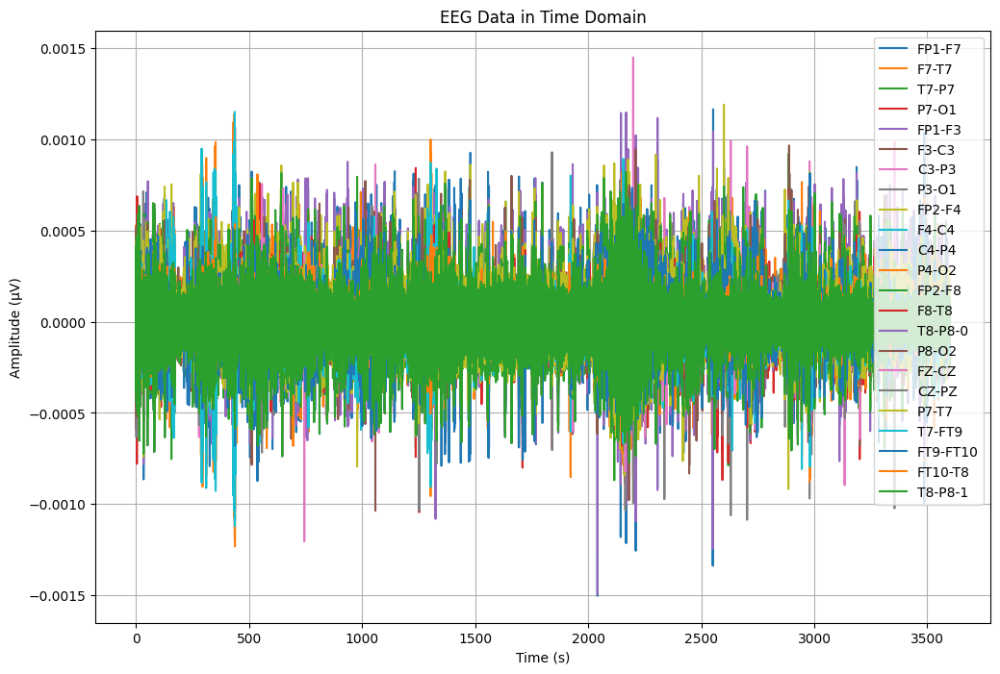

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df29['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df29[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


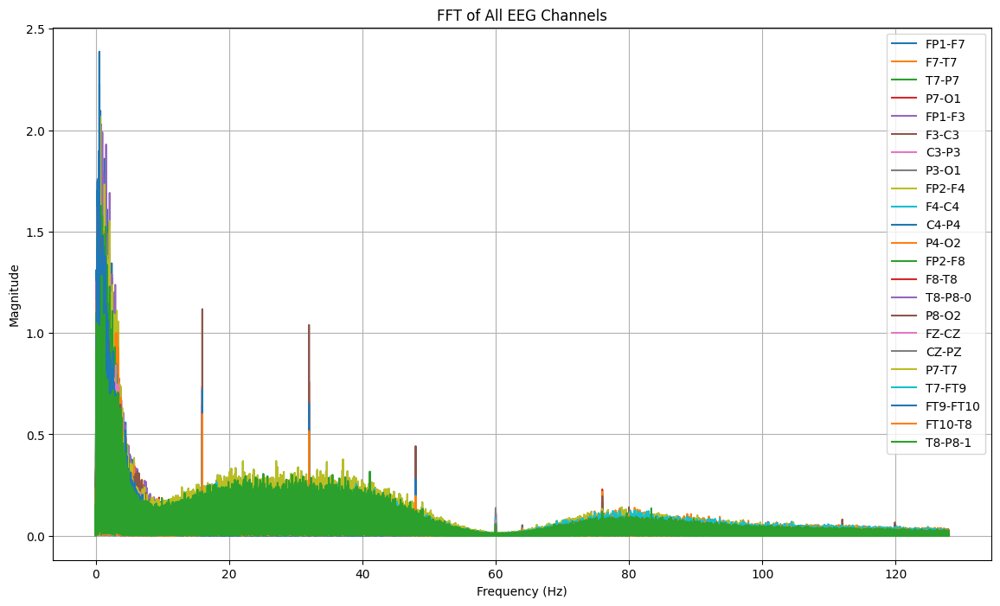

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df29[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_21.csv"
df29.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_21.csv


In [ ]:
#Import Data CSV
dataTA29 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_21.csv")
dataTA29


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.123321e-04,-8.459096e-05,6.857143e-05,-7.208791e-05,5.841270e-05,-2.090354e-05,2.832723e-05,-4.161172e-05,1.426129e-05,8.732601e-05,...,-6.231990e-05,1.467155e-04,-1.152625e-05,6.896215e-05,-6.818071e-05,4.395604e-05,-2.654945e-04,2.147009e-04,-6.231990e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,-5.860806e-07,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.367521e-06,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,5.860806e-07,9.768010e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-1.758242e-06,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.758242e-06,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.699634e-05,2.520147e-05,-6.466422e-05,1.230769e-05,-8.302808e-05,5.802198e-05,2.539683e-06,-2.324786e-05,-1.347985e-05,4.903541e-05,...,-6.114774e-05,-2.402930e-05,2.324786e-05,-6.837607e-06,6.505495e-05,-5.372405e-05,3.770452e-05,6.935287e-05,-6.114774e-05,3599.980469
921596,-1.738706e-05,-2.871795e-05,-3.418803e-05,3.223443e-05,-8.302808e-05,5.997558e-05,5.274725e-06,-3.223443e-05,-1.894994e-05,5.411477e-05,...,-2.168498e-05,-2.715507e-05,2.598291e-05,-9.963370e-06,3.457875e-05,1.758242e-06,3.770452e-05,2.520147e-05,-2.168498e-05,3599.984375
921597,-5.860806e-07,-9.787546e-05,6.837607e-06,5.684982e-05,-6.388278e-05,5.724054e-05,-4.102564e-06,-2.442002e-05,-3.457875e-05,5.059829e-05,...,-2.148962e-06,-1.035409e-05,1.934066e-05,-9.963370e-06,-6.446886e-06,6.935287e-05,3.184371e-05,-5.274725e-06,-2.148962e-06,3599.988281
921598,5.528694e-05,-7.013431e-05,9.045177e-05,-5.450549e-05,4.200244e-05,8.009768e-06,-7.619048e-06,-2.207570e-05,-4.473748e-05,5.137973e-05,...,1.269841e-05,-1.465201e-05,1.816850e-05,-7.228327e-06,-9.006105e-05,4.903541e-05,2.559219e-05,-2.285714e-05,1.269841e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA29[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA29[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA29[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data29, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.55 Hz, Magnitude: 2.387162, Time: 536.652344 s
Channel: FP1-F7, Max Frequency: 0.57 Hz, Magnitude: 2.226245, Time: 2041.539062 s
Channel: FP2-F4, Max Frequency: 0.71 Hz, Magnitude: 2.067120, Time: 2600.257812 s
Channel: FP1-F3, Max Frequency: 0.81 Hz, Magnitude: 2.019904, Time: 2041.539062 s
Channel: P3-O1, Max Frequency: 0.83 Hz, Magnitude: 1.638892, Time: 2702.996094 s
Channel: FP2-F8, Max Frequency: 0.84 Hz, Magnitude: 1.627379, Time: 2167.023438 s
Channel: P4-O2, Max Frequency: 0.30 Hz, Magnitude: 1.600402, Time: 2979.292969 s
Channel: P8-O2, Max Frequency: 0.83 Hz, Magnitude: 1.474255, Time: 2180.042969 s
Channel: P7-O1, Max Frequency: 0.48 Hz, Magnitude: 1.433452, Time: 1252.289062 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.338749, Time: 437.101562 s
Channel: T8-P8-0, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: T8-P8-1, Max Fr

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-FT9, Max Frequency: 0.47 Hz, Magnitude: 0.891269, Time: 436.414062 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.338749, Time: 437.101562 s
Channel: T8-P8-0, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: T8-P8-1, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: F8-T8, Max Frequency: 0.51 Hz, Magnitude: 1.206019, Time: 536.609375 s
Channel: FT9-FT10, Max Frequency: 0.55 Hz, Magnitude: 2.387162, Time: 536.652344 s
Channel: FT10-T8, Max Frequency: 0.43 Hz, Magnitude: 0.774595, Time: 536.671875 s
Channel: C4-P4, Max Frequency: 0.80 Hz, Magnitude: 1.194796, Time: 542.144531 s
Channel: F3-C3, Max Frequency: 0.55 Hz, Magnitude: 1.107217, Time: 1058.417969 s
Channel: P7-O1, Max Frequency: 0.48 Hz, Magnitude: 1.433452, Time: 1252.289062 s
Channel: FP1-F7, Max Frequency: 0.57 Hz, Magnitude: 2.226245, Time: 2041.539062

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1963   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2467    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut29 = dataTA29.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut29.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_21.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA29 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_21.csv")
TA29.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000049,-0.000045,-0.000031,-0.000015,-0.000134,0.000051,-0.000032,-0.000027,-0.000003,0.000010,...,0.000017,-0.000063,0.000053,-0.000035,0.000032,0.000035,-0.000020,-0.000051,0.000017,1963.000000
1,-0.000060,-0.000067,0.000007,-0.000031,-0.000132,0.000048,-0.000036,-0.000032,0.000004,0.000021,...,-0.000006,-0.000074,0.000066,-0.000049,-0.000006,0.000064,-0.000022,-0.000015,-0.000006,1963.003906
2,-0.000057,-0.000048,-0.000003,-0.000042,-0.000105,0.000027,-0.000031,-0.000042,0.000008,0.000029,...,-0.000004,-0.000075,0.000070,-0.000061,0.000003,0.000047,-0.000017,-0.000017,-0.000004,1963.007812
3,-0.000039,-0.000055,-0.000015,-0.000023,-0.000065,0.000004,-0.000043,-0.000028,0.000012,0.000030,...,-0.000025,-0.000071,0.000070,-0.000064,0.000015,0.000053,-0.000018,-0.000004,-0.000025,1963.011719
4,-0.000042,-0.000096,0.000011,-0.000009,-0.000074,0.000012,-0.000053,-0.000021,0.000023,0.000033,...,-0.000055,-0.000074,0.000072,-0.000069,-0.000011,0.000097,-0.000029,0.000044,-0.000055,1963.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA29.shape

(129024, 24)

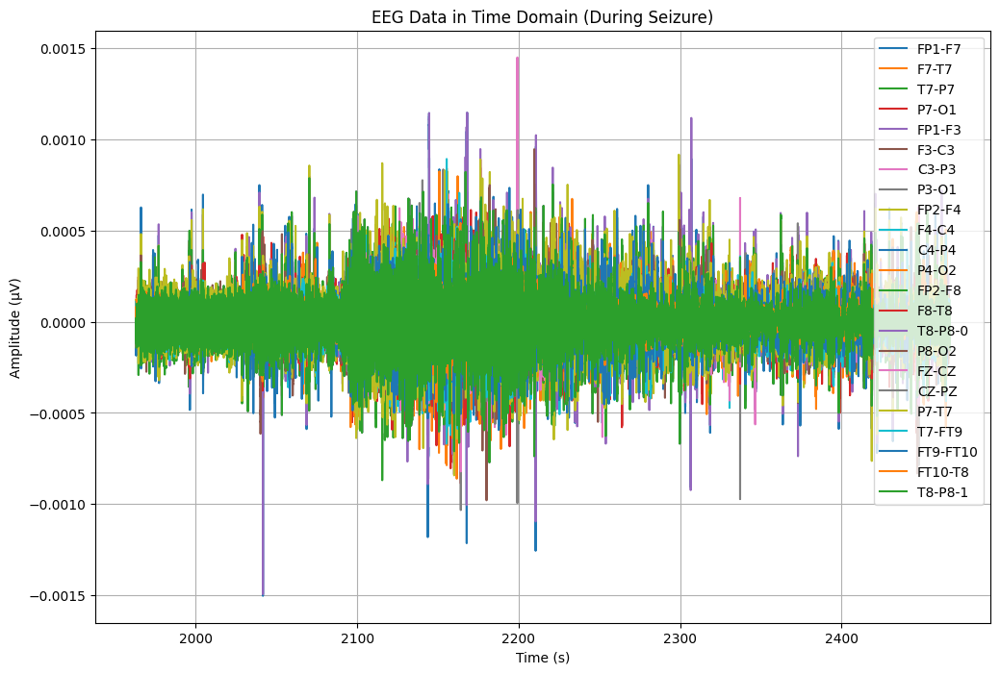

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA29['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA29.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA29[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


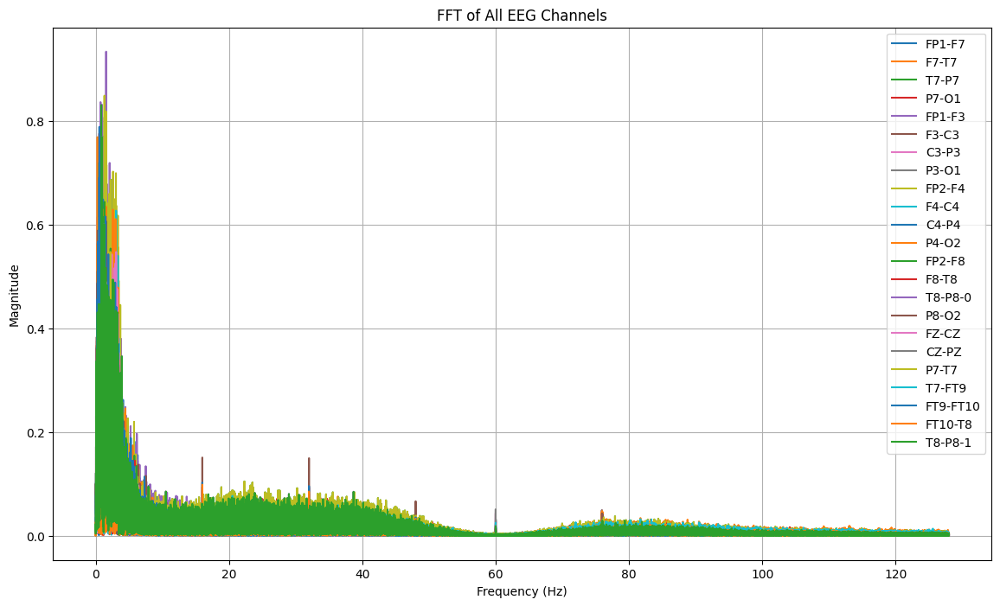

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA29[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2083:
        return "tidak kejang"
    elif 2083 <= row['Time'] < 2347:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_29 = TA29.copy()
TA_29['seizure'] = TA_29.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_29[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1963.000000  tidak kejang -0.000049 -0.000045 -0.000031 -0.000015   
1  1963.003906  tidak kejang -0.000060 -0.000067  0.000007 -0.000031   
2  1963.007812  tidak kejang -0.000057 -0.000048 -0.000003 -0.000042   
3  1963.011719  tidak kejang -0.000039 -0.000055 -0.000015 -0.000023   
4  1963.015625  tidak kejang -0.000042 -0.000096  0.000011 -0.000009   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000134  0.000051 -0.000032 -0.000027  ... -0.000076  0.000017 -0.000063   
1 -0.000132  0.000048 -0.000036 -0.000032  ... -0.000050 -0.000006 -0.000074   
2 -0.000105  0.000027 -0.000031 -0.000042  ... -0.000040 -0.000004 -0.000075   
3 -0.000065  0.000004 -0.000043 -0.000028  ... -0.000035 -0.000025 -0.000071   
4 -0.000074  0.000012 -0.000053 -0.000021  ...  0.000004 -0.000055 -0.000074   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0  0.000053 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_29['seizure'].value_counts()


,count
seizure,
kejang,67584
tidak kejang,61440


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_29)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 504.0 detik


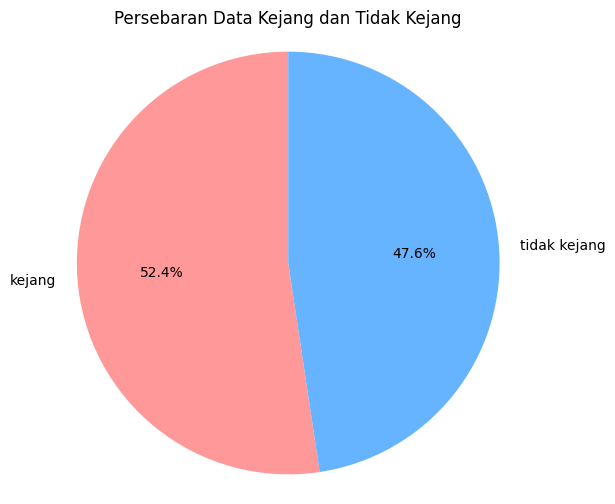

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_29['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_29.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb08_21.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_29.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_29['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.97      0.94      0.96     13709
tidak kejang       0.94      0.97      0.95     12096

    accuracy                           0.96     25805
   macro avg       0.96      0.96      0.96     25805
weighted avg       0.96      0.96      0.96     25805

Akurasi: 0.9568300716915327
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.94      0.96     13709
tidak kejang       0.94      0.97      0.95     12096

    accuracy                           0.96     25805
   macro avg       0.96      0.96      0.96     25805
weighted avg       0.96      0.96      0.96     25805



# ini data bukan epilepsi

In [ ]:
# mengimport file edf
file30 = "/content/drive/MyDrive/TA/EDF/chb01_02.edf"
data30 = mne.io.read_raw_edf(file30) # membaca file edf dan menyimpannya di data
data30


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-3-cb73ded512f6>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data30 = mne.io.read_raw_edf(file30) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_02.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data30.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data30.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data30.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df30 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df30['Time'] = times  # Menambahkan kolom waktu
df30.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.504274e-05,1.504274e-05,2.832723e-05,-1.347985e-05,4.083028e-05,-1.230769e-05,-1.230769e-05,2.871795e-05,1.387057e-05,-7.619048e-06,...,-2.715507e-05,6.056166e-06,-3.262515e-05,-2.637363e-05,-2.793651e-05,-4.786325e-05,-2.559219e-05,5.489621e-05,-2.715507e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,-1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,...,5.860806e-07,-5.274725e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.758242e-06,5.860806e-07,5.860806e-07,5.860806e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df30.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df30.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.200155e-07,2.160248e-07,1.745328e-07,1.597574e-07,2.146707e-07,1.971425e-07,2.074901e-07,1.803805e-07,2.317155e-07,2.059994e-07,...,1.506309e-07,2.135735e-07,1.975817e-07,1.957413e-07,2.161876e-07,1.856571e-07,2.202919e-07,2.285252e-07,1.506309e-07,1799.998047
std,7.778483e-05,3.828569e-05,2.568332e-05,2.208063e-05,7.366818e-05,2.569792e-05,1.991057e-05,2.492784e-05,5.950875e-05,2.502229e-05,...,2.961667e-05,5.421599e-05,2.446029e-05,2.399820e-05,2.568332e-05,2.739201e-05,6.196577e-05,2.836913e-05,2.961667e-05,1039.231048
min,-8.484493e-04,-6.878632e-04,-6.214408e-04,-5.897924e-04,-1.053187e-03,-2.819048e-04,-1.386081e-03,-8.652503e-04,-8.332112e-04,-2.979243e-04,...,-7.394383e-04,-1.276679e-03,-3.686447e-04,-1.051233e-03,-5.714286e-04,-5.479853e-04,-7.417827e-04,-9.086203e-04,-7.394383e-04,0.000000
25%,-2.012210e-05,-1.387057e-05,-1.308913e-05,-1.035409e-05,-2.207570e-05,-1.387057e-05,-1.074481e-05,-1.308913e-05,-1.934066e-05,-1.387057e-05,...,-1.504274e-05,-1.660562e-05,-1.387057e-05,-1.387057e-05,-1.308913e-05,-1.152625e-05,-1.894994e-05,-1.191697e-05,-1.504274e-05,899.999023
50%,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-5.860806e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1799.998047
75%,1.816850e-05,1.347985e-05,1.347985e-05,1.152625e-05,1.973138e-05,1.387057e-05,1.074481e-05,1.426129e-05,1.660562e-05,1.347985e-05,...,1.621490e-05,1.621490e-05,1.426129e-05,1.426129e-05,1.347985e-05,1.230769e-05,1.934066e-05,1.191697e-05,1.621490e-05,2699.997070
max,9.008059e-04,5.386081e-04,5.718193e-04,5.722100e-04,8.785348e-04,1.156728e-03,4.249084e-04,4.018559e-04,6.991941e-04,7.202930e-04,...,5.132112e-04,1.166886e-03,1.167277e-03,6.054212e-04,6.218315e-04,8.074237e-04,6.374603e-04,4.936752e-04,5.132112e-04,3599.996094


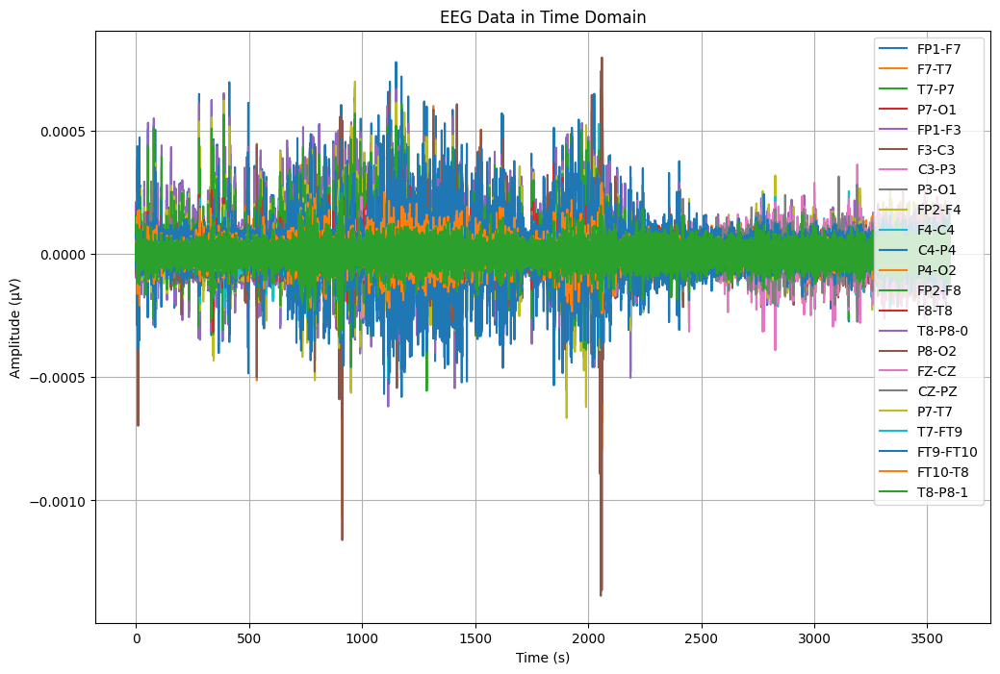

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df30['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df30[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


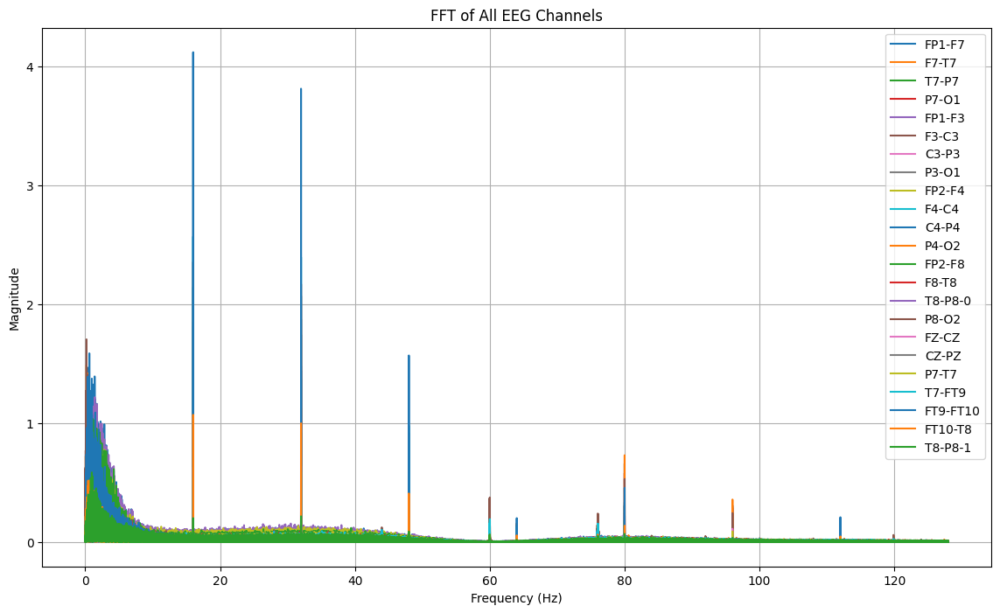

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df30[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV /ekstrak_chb01_05.csv"
df30.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV /ekstrak_chb01_05.csv


In [ ]:
#Import Data CSV
dataTA29 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_21.csv")
dataTA29


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.123321e-04,-8.459096e-05,6.857143e-05,-7.208791e-05,5.841270e-05,-2.090354e-05,2.832723e-05,-4.161172e-05,1.426129e-05,8.732601e-05,...,-6.231990e-05,1.467155e-04,-1.152625e-05,6.896215e-05,-6.818071e-05,4.395604e-05,-2.654945e-04,2.147009e-04,-6.231990e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,-5.860806e-07,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.367521e-06,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,5.860806e-07,9.768010e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-1.758242e-06,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.758242e-06,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.699634e-05,2.520147e-05,-6.466422e-05,1.230769e-05,-8.302808e-05,5.802198e-05,2.539683e-06,-2.324786e-05,-1.347985e-05,4.903541e-05,...,-6.114774e-05,-2.402930e-05,2.324786e-05,-6.837607e-06,6.505495e-05,-5.372405e-05,3.770452e-05,6.935287e-05,-6.114774e-05,3599.980469
921596,-1.738706e-05,-2.871795e-05,-3.418803e-05,3.223443e-05,-8.302808e-05,5.997558e-05,5.274725e-06,-3.223443e-05,-1.894994e-05,5.411477e-05,...,-2.168498e-05,-2.715507e-05,2.598291e-05,-9.963370e-06,3.457875e-05,1.758242e-06,3.770452e-05,2.520147e-05,-2.168498e-05,3599.984375
921597,-5.860806e-07,-9.787546e-05,6.837607e-06,5.684982e-05,-6.388278e-05,5.724054e-05,-4.102564e-06,-2.442002e-05,-3.457875e-05,5.059829e-05,...,-2.148962e-06,-1.035409e-05,1.934066e-05,-9.963370e-06,-6.446886e-06,6.935287e-05,3.184371e-05,-5.274725e-06,-2.148962e-06,3599.988281
921598,5.528694e-05,-7.013431e-05,9.045177e-05,-5.450549e-05,4.200244e-05,8.009768e-06,-7.619048e-06,-2.207570e-05,-4.473748e-05,5.137973e-05,...,1.269841e-05,-1.465201e-05,1.816850e-05,-7.228327e-06,-9.006105e-05,4.903541e-05,2.559219e-05,-2.285714e-05,1.269841e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA29[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA29[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA29[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data29, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.55 Hz, Magnitude: 2.387162, Time: 536.652344 s
Channel: FP1-F7, Max Frequency: 0.57 Hz, Magnitude: 2.226245, Time: 2041.539062 s
Channel: FP2-F4, Max Frequency: 0.71 Hz, Magnitude: 2.067120, Time: 2600.257812 s
Channel: FP1-F3, Max Frequency: 0.81 Hz, Magnitude: 2.019904, Time: 2041.539062 s
Channel: P3-O1, Max Frequency: 0.83 Hz, Magnitude: 1.638892, Time: 2702.996094 s
Channel: FP2-F8, Max Frequency: 0.84 Hz, Magnitude: 1.627379, Time: 2167.023438 s
Channel: P4-O2, Max Frequency: 0.30 Hz, Magnitude: 1.600402, Time: 2979.292969 s
Channel: P8-O2, Max Frequency: 0.83 Hz, Magnitude: 1.474255, Time: 2180.042969 s
Channel: P7-O1, Max Frequency: 0.48 Hz, Magnitude: 1.433452, Time: 1252.289062 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.338749, Time: 437.101562 s
Channel: T8-P8-0, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: T8-P8-1, Max Fr

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-FT9, Max Frequency: 0.47 Hz, Magnitude: 0.891269, Time: 436.414062 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.338749, Time: 437.101562 s
Channel: T8-P8-0, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: T8-P8-1, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: F8-T8, Max Frequency: 0.51 Hz, Magnitude: 1.206019, Time: 536.609375 s
Channel: FT9-FT10, Max Frequency: 0.55 Hz, Magnitude: 2.387162, Time: 536.652344 s
Channel: FT10-T8, Max Frequency: 0.43 Hz, Magnitude: 0.774595, Time: 536.671875 s
Channel: C4-P4, Max Frequency: 0.80 Hz, Magnitude: 1.194796, Time: 542.144531 s
Channel: F3-C3, Max Frequency: 0.55 Hz, Magnitude: 1.107217, Time: 1058.417969 s
Channel: P7-O1, Max Frequency: 0.48 Hz, Magnitude: 1.433452, Time: 1252.289062 s
Channel: FP1-F7, Max Frequency: 0.57 Hz, Magnitude: 2.226245, Time: 2041.539062

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1963   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2467    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut29 = dataTA29.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut29.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_21.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA29 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_21.csv")
TA29.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000049,-0.000045,-0.000031,-0.000015,-0.000134,0.000051,-0.000032,-0.000027,-0.000003,0.000010,...,0.000017,-0.000063,0.000053,-0.000035,0.000032,0.000035,-0.000020,-0.000051,0.000017,1963.000000
1,-0.000060,-0.000067,0.000007,-0.000031,-0.000132,0.000048,-0.000036,-0.000032,0.000004,0.000021,...,-0.000006,-0.000074,0.000066,-0.000049,-0.000006,0.000064,-0.000022,-0.000015,-0.000006,1963.003906
2,-0.000057,-0.000048,-0.000003,-0.000042,-0.000105,0.000027,-0.000031,-0.000042,0.000008,0.000029,...,-0.000004,-0.000075,0.000070,-0.000061,0.000003,0.000047,-0.000017,-0.000017,-0.000004,1963.007812
3,-0.000039,-0.000055,-0.000015,-0.000023,-0.000065,0.000004,-0.000043,-0.000028,0.000012,0.000030,...,-0.000025,-0.000071,0.000070,-0.000064,0.000015,0.000053,-0.000018,-0.000004,-0.000025,1963.011719
4,-0.000042,-0.000096,0.000011,-0.000009,-0.000074,0.000012,-0.000053,-0.000021,0.000023,0.000033,...,-0.000055,-0.000074,0.000072,-0.000069,-0.000011,0.000097,-0.000029,0.000044,-0.000055,1963.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA29.shape

(129024, 24)

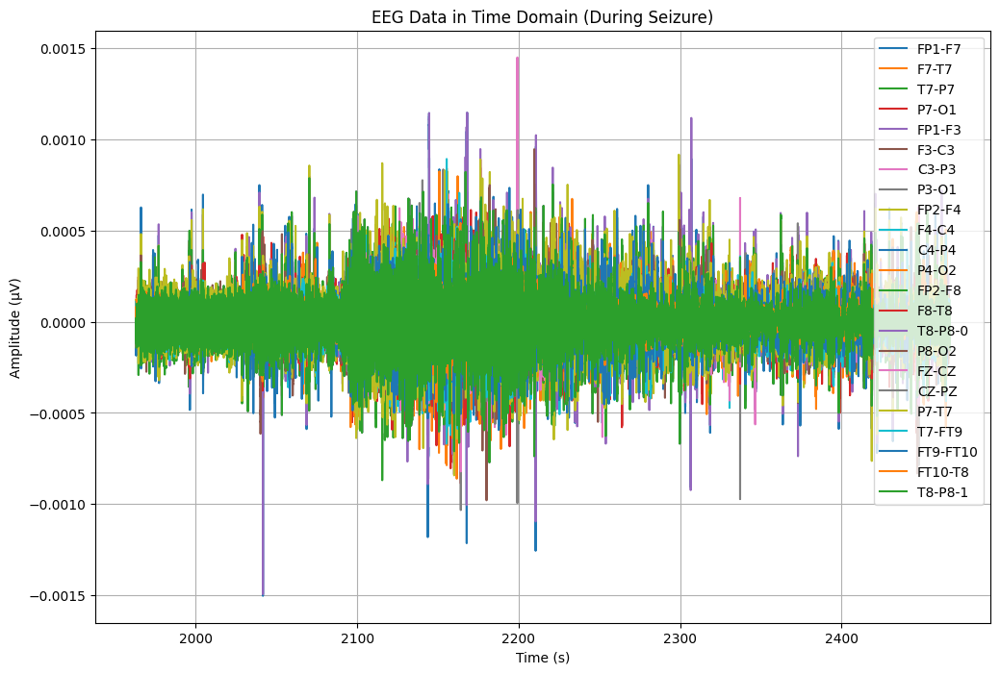

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA29['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA29.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA29[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


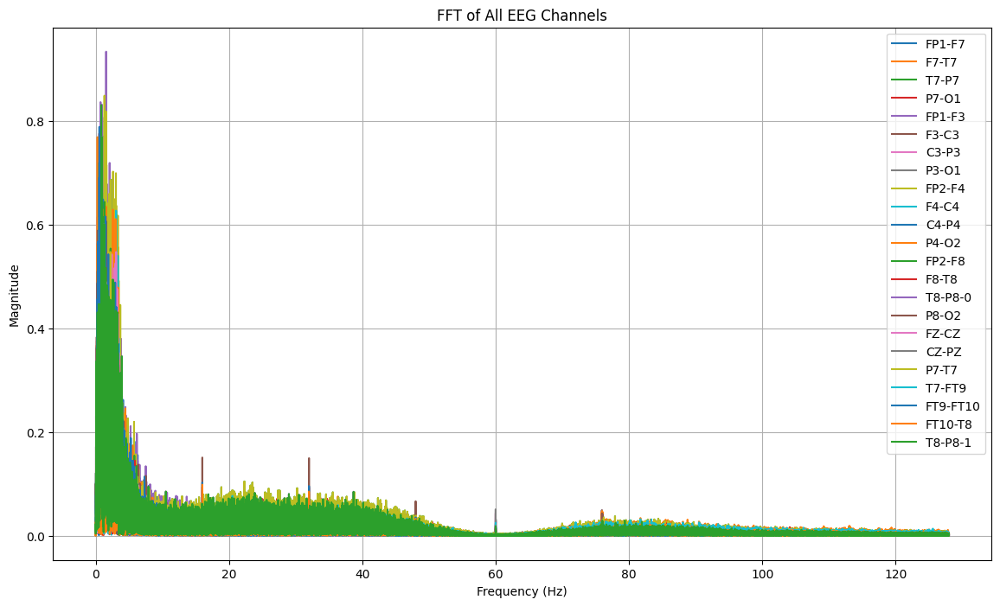

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA29[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2083:
        return "tidak kejang"
    elif 2083 <= row['Time'] < 2347:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_29 = TA29.copy()
TA_29['seizure'] = TA_29.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_29[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1963.000000  tidak kejang -0.000049 -0.000045 -0.000031 -0.000015   
1  1963.003906  tidak kejang -0.000060 -0.000067  0.000007 -0.000031   
2  1963.007812  tidak kejang -0.000057 -0.000048 -0.000003 -0.000042   
3  1963.011719  tidak kejang -0.000039 -0.000055 -0.000015 -0.000023   
4  1963.015625  tidak kejang -0.000042 -0.000096  0.000011 -0.000009   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000134  0.000051 -0.000032 -0.000027  ... -0.000076  0.000017 -0.000063   
1 -0.000132  0.000048 -0.000036 -0.000032  ... -0.000050 -0.000006 -0.000074   
2 -0.000105  0.000027 -0.000031 -0.000042  ... -0.000040 -0.000004 -0.000075   
3 -0.000065  0.000004 -0.000043 -0.000028  ... -0.000035 -0.000025 -0.000071   
4 -0.000074  0.000012 -0.000053 -0.000021  ...  0.000004 -0.000055 -0.000074   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0  0.000053 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_29['seizure'].value_counts()


,count
seizure,
kejang,67584
tidak kejang,61440


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_29)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 504.0 detik


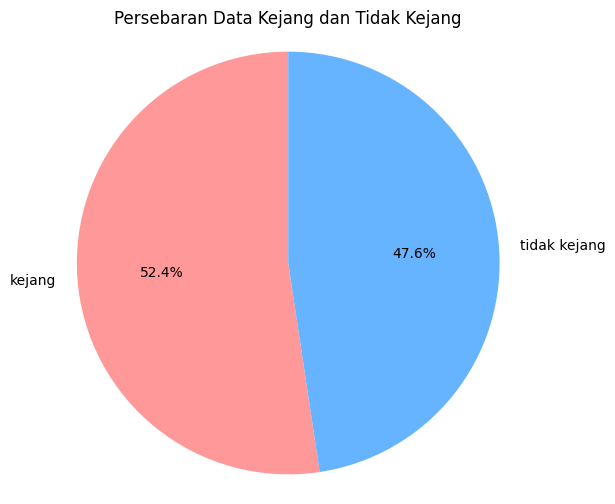

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_29['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_29.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb08_21.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_29.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_29['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.97      0.94      0.96     13709
tidak kejang       0.94      0.97      0.95     12096

    accuracy                           0.96     25805
   macro avg       0.96      0.96      0.96     25805
weighted avg       0.96      0.96      0.96     25805

Akurasi: 0.9568300716915327
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.94      0.96     13709
tidak kejang       0.94      0.97      0.95     12096

    accuracy                           0.96     25805
   macro avg       0.96      0.96      0.96     25805
weighted avg       0.96      0.96      0.96     25805

